# Описание

## Задачи
_Испольуется три задачи:_
- DM -- двухальтернативный выбор
- Romo -- сравнение двух сигнало через задержку
- CtxDM -- DM с контекстом
Вход состоит из одного контекстного входа, одного стимула, 6 входов, кодирующих задачи. Выход как и раньше состоит из трех частей: контекстный выход, выходы принятия решения.

## Сеть
 Сеть состоит из lif AdEx нейронов

# Импорт всех необходимых библиотек

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
from cgtasknet.instruments.instrument_accuracy_network import CorrectAnswerNetwork
from cgtasknet.tasks.reduce import (
    CtxDMTaskParameters,
    DMTaskParameters,
    DMTaskRandomModParameters,
    GoDlTaskParameters,
    GoDlTaskRandomModParameters,
    GoRtTaskParameters,
    GoRtTaskRandomModParameters,
    GoTaskParameters,
    GoTaskRandomModParameters,
    MultyReduceTasks,
    RomoTaskParameters,
    RomoTaskRandomModParameters,
)
from tqdm import tqdm

# Определяем устройство

In [2]:
device = torch.device("cuda:2" if torch.cuda.is_available() else "cpu")
print(f"{device}")

cuda:2


# Функция построения входов и выходов

In [3]:
import os


def plot_results(inputs, target_outputs, outputs):
    if isinstance(inputs, torch.Tensor) and isinstance(target_outputs, torch.Tensor):
        inputs, t_outputs = (
            inputs.detach().cpu().numpy(),
            target_outputs.detach().cpu().numpy(),
        )
    for bath in range(min(batch_size, 20)):
        fig = plt.figure(figsize=(15, 3))
        ax1 = fig.add_subplot(141)
        plt.title("Inputs")
        plt.xlabel("$time, ms$")
        plt.ylabel("$Magnitude$")
        for i in range(3):
            plt.plot(inputs[:, bath, i].T, label=rf"$in_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax2 = fig.add_subplot(142)
        plt.title("Task code (context)")
        plt.xticks(np.arange(1, len(tasks) + 1), sorted(tasks), rotation=90)
        plt.yticks([])
        for i in range(3, inputs.shape[-1]):
            plt.plot([i - 2] * 2, [0, inputs[0, bath, i]])
        plt.tight_layout()

        ax3 = fig.add_subplot(143)
        plt.title("Target output")
        plt.xlabel("$time, ms$")
        for i in range(t_outputs.shape[-1]):
            plt.plot(t_outputs[:, bath, i], label=rf"$out_{i + 1}$")
        plt.legend()
        plt.tight_layout()

        ax4 = fig.add_subplot(144)
        plt.title("Real output")
        plt.xlabel("$time, ms$")
        for i in range(outputs.shape[-1]):
            plt.plot(
                outputs.detach().cpu().numpy()[:, bath, i], label=rf"$out_{i + 1}$"
            )
        plt.legend()
        plt.tight_layout()
        if not os.path.exists("figures"):
            os.mkdir("figures")
        plt.savefig(f"figures{os.sep}network_outputs_{name}_batch_{bath}.pdf")
        plt.show()
        plt.close()

# Определяем датасет
Датасет будет состоять из трех типов задач:
- DM задача;
- Romo задача;
- CtxDM задача.
_Параметры для последней задачи аналогичны DM задаче_
***
## Параметры датасета:

In [4]:
batch_size = 32
number_of_epochs = 3000
number_of_tasks = 1

go_task_list_values = np.linspace(0, 1, 8)

romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.2,
        positive_shift_delay_time=1.5,
        trial_time=0.2,
        positive_shift_trial_time=0.4,
        answer_time=0.25,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.3, positive_shift_trial_time=1.5, answer_time=0.25)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        value=go_task_list_values,
        answer_time=0.25,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go_rt=GoRtTaskParameters(
        trial_time=0.3,
        positive_shift_trial_time=1.5,
        answer_time=1.5,
        value=go_task_list_values,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(
            trial_time=0.2,
            positive_shift_trial_time=0.4,
            answer_time=0.25,
            value=go_task_list_values,
        ),
        delay=0.2,
        positive_shift_delay_time=1.5,
    )
)

## Датасет

In [5]:
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}
Task = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
)

print("Task parameters:")
for key in task_dict:
    print(f"{key}:\n{task_dict[key]}\n")

print(f"inputs/outputs: {Task.feature_and_act_size[0]}/{Task.feature_and_act_size[1]}")

Task parameters:
RomoTask1:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

RomoTask2:
RomoTaskRandomModParameters(romo=RomoTaskParameters(dt=0.001, trial_time=0.2, answer_time=0.25, value=(None, None), delay=0.2, negative_shift_trial_time=0, positive_shift_trial_time=0.4, negative_shift_delay_time=0, positive_shift_delay_time=1.5), n_mods=2)

DMTask1:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

DMTask2:
DMTaskRandomModParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3, answer_time=0.25, value=None, negative_shift_trial_time=0, positive_shift_trial_time=1.5), n_mods=2)

CtxDMTask1:
CtxDMTaskParameters(dm=DMTaskParameters(dt=0.001, trial_time=0.3,

In [6]:
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)

# Инициализация сети и выгрузка на device

In [7]:
from cgtasknet.net import SNNlifadex
from norse.torch import LIFAdExParameters

feature_size, output_size = Task.feature_and_act_size
hidden_size = 256

neuron_parameters = LIFAdExParameters(
    v_th=torch.as_tensor(0.65),
    tau_ada_inv=torch.as_tensor(1 / 2.0),
    alpha=100,
    method="super",
    # rho_reset = torch.as_tensor(5)
)
model = SNNlifadex(
    feature_size,
    hidden_size,
    output_size,
    neuron_parameters=neuron_parameters,
    tau_filter_inv=50,
    save_states=True,
    return_spiking=True
    
).to(device)
for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        initial_parameters = torch.clone(param.detach().cpu())


inputs, _ = Task.dataset(1)
inputs *= 0
additionalCurrent = 0.1 * torch.randn((1, hidden_size)).to(device) + 1.4
inputs = torch.from_numpy(inputs[-1000:]).type(torch.float).to(device)
outputs, states = model(inputs, additional_current = additionalCurrent)
outputs = outputs.detach().cpu()
plt.plot(outputs[:, 0, 0])
plt.show()
plt.close()

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr == 0, '.')

mean_fr = torch.zeros((hidden_size))

for i in range(len(states)):
    mean_fr += torch.mean(states[i].z.detach().cpu(), axis=0)
mean_fr /= len(states)
plt.plot(mean_fr, '.')

# Критерий и функция ошибки

In [8]:
learning_rate = 5e-3
reg_freq = 1e-4 #1e3 for square #for 600 1e5
class RMSELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()

    def forward(self, yhat, y):
        return torch.sqrt(self.mse(yhat, y))


class MaskedMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedMSELoss, self).__init__()

    def forward(self, input, target, mask):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
            mask
        )
        result = torch.sum(diff2) / torch.sum(mask)
        return result

class MaskedAndFrRegMSELoss(torch.nn.Module):
    def __init__(self):
        super(MaskedAndFrRegMSELoss, self).__init__()
        
    def forward(self, input, target, mask, state):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
        mask)
        result = torch.sum(diff2) / torch.sum(mask)
        s = []
        for i in range(len(state)):
            s.append(state[i])
        s = torch.stack(s)
        fr_neurons_mean = torch.mean(torch.mean(s, axis=0), axis=0)
        coefs = ((fr_neurons_mean > .01)).detach()
        fr_neurons_mean *= coefs
        fr_neurons_mean = torch.mean(fr_neurons_mean)
        result += fr_neurons_mean  * reg_freq
        return result
    
class MaskedAndFrBinsRegMSELoss(torch.nn.Module):
    
    def __init__(self):
        super(MaskedAndFrBinsRegMSELoss, self).__init__()
        
    def forward(self, input, target, mask, state, window=10):
        diff2 = (torch.flatten(input) - torch.flatten(target)) ** 2.0 * torch.flatten(
        mask)
        result = torch.sum(diff2) / torch.sum(mask)
        s = []
        for i in range(len(state)):
            s.append(state[i])
        s = torch.stack(s)
        time_series = len(s)
        mant = len(s) % window
        mant_ind = bool(mant)
        Nbin = time_series // window + int(mant_ind)
        s_bin = torch.zeros((Nbin, s.shape[1], s.shape[2]), requires_grad = True).to(device)
        
        for i in range(Nbin - 1):
            s_bin[i, ...] = torch.mean(s[i * window: (i + 1) * window, ...], axis=0)
        if not mant_ind:
            s_bin[-1, ...] = torch.mean(s[-window:, ...], axis=0)
        else:
            s_bin[-1, ...] = torch.mean(s[-mant:, ...], axis=0)
        
        #s_bin = torch.mean(s_bin, axis=[1, 2]) ** 2
        #coefs = ((s_bin > .01)).detach()
        #s_bin *= coefs
        s_bin = torch.max(s_bin, axis=0).values
        coefs = ((s_bin > .01)).detach()
        s_bin *= coefs
        result += reg_freq * torch.sum(s_bin)
        return result

criterion = MaskedAndFrBinsRegMSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

## Генерация всех эпох
> Если память не позволяет, то необходимо генерировать каждую эпоху в основном цикле обучения

In [9]:
if False:
    list_inputs = []
    list_t_outputs = []
    for i in tqdm(range(number_of_epochs)):
        temp_input, temp_t_output = Task.dataset()
        temp_input.astype(dtype=np.float16)
        temp_t_output.astype(dtype=np.float16)
        temp_input[:, :, :] += np.random.normal(0, sigma, size=temp_input.shape)
        list_inputs.append(temp_input)
        list_t_outputs.append(temp_t_output)

# JIT numba generator (test)
TODO: Необходимо добавить в cgtasknet и вызывать оттуда

In [10]:
#from numba import njit, prange


#@njit(cache=True, parallel=True)
def every_bath_generator(
        start_sigma: float,
        stop_sigma: float,
        times: int = 1,
        batches: int = 1,
        actions: int = 1,
):
    data = np.zeros((times, batches, actions))
    for i in range(batches):
        data[:, i, :] = np.random.normal(
            0, np.random.uniform(start_sigma, stop_sigma), size=(times, actions)
        )
    return data

In [11]:
torch.cuda.empty_cache()


In [12]:
from norse.torch import LIFAdExState
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=0
)
def check_mean_fr():
    init_state = LIFAdExState(
            torch.zeros(batch_size, hidden_size).to(device),
            torch.rand(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
            torch.zeros(batch_size, hidden_size).to(device),
        )
    inputs, target_outputs = Task_test.dataset(1)

    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    result = model(inputs, init_state,)
    #del inputs, init_state
    torch.cuda.empty_cache()
    states = result[-1]
    spikes = []
    for state in states:
        spikes.append(state.detach().cpu())

    last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
    s = torch.stack(spikes)[last_fix:, ...]
    freq_sequence_new = torch.sort(
        torch.mean(torch.mean(s, axis=0), axis=0), dim=0
    ).values
    for i in range(len(freq_sequence_new)):
        plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")
    plt.show()
    plt.close()
    index=0
    plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
    plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
    plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

    plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
            )
    plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
            )
    plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )
    plt.show()
    plt.close()

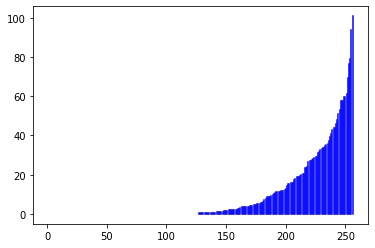

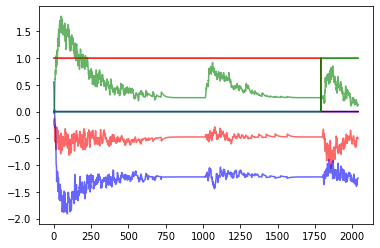

In [13]:
check_mean_fr()

# Основной цикл обучения

  0%|▏                                                                                                                                                               | 4/3000 [00:47<9:37:07, 11.56s/it]

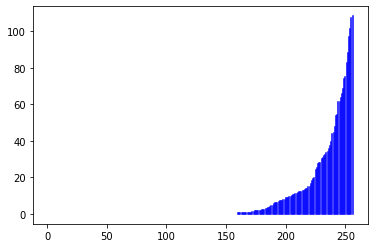

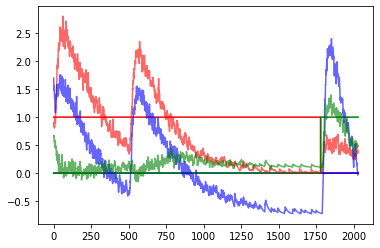

  0%|▍                                                                                                                                                               | 9/3000 [01:41<9:08:56, 11.01s/it]

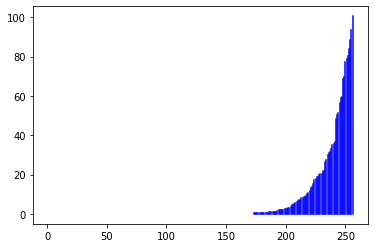

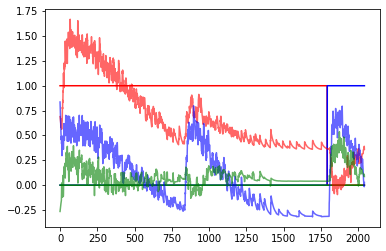

  0%|▋                                                                                                                                                              | 14/3000 [02:38<8:54:53, 10.75s/it]

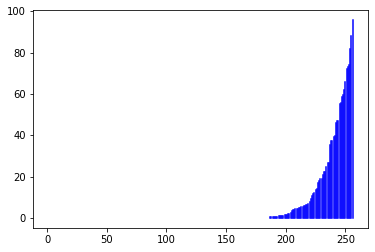

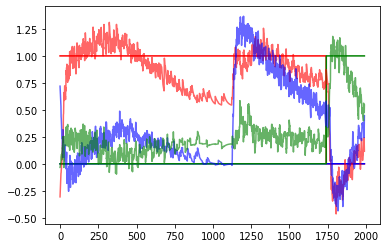

  1%|█                                                                                                                                                              | 19/3000 [03:33<8:59:50, 10.87s/it]

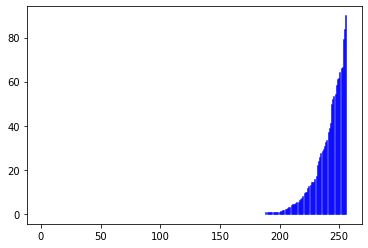

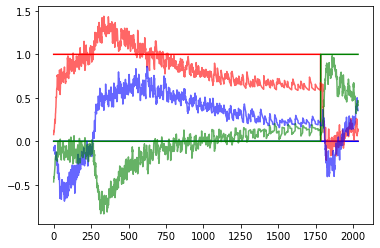

  1%|█▎                                                                                                                                                             | 24/3000 [04:31<8:55:07, 10.79s/it]

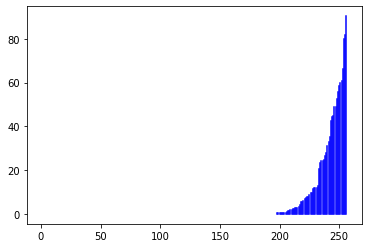

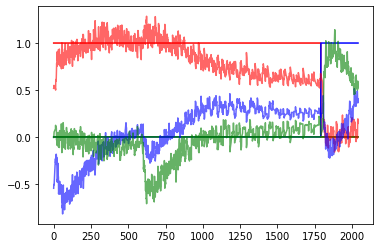

  1%|█▌                                                                                                                                                             | 29/3000 [05:30<9:11:00, 11.13s/it]

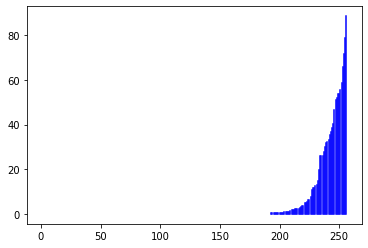

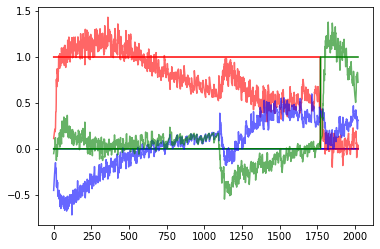

  1%|█▊                                                                                                                                                             | 34/3000 [06:28<9:03:09, 10.99s/it]

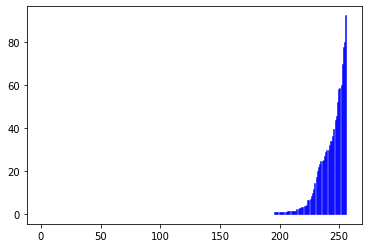

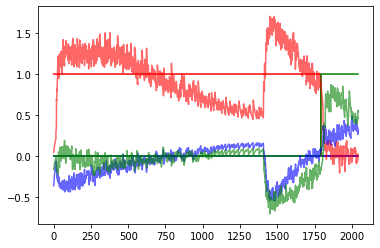

  1%|██                                                                                                                                                             | 39/3000 [07:27<9:14:31, 11.24s/it]

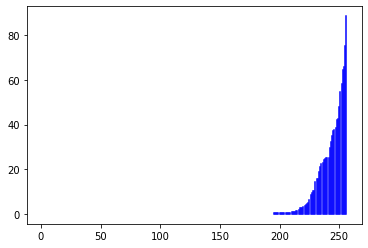

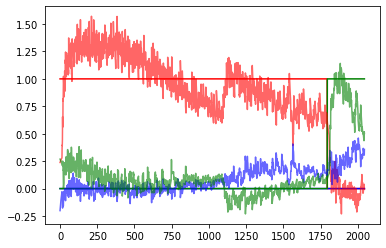

  1%|██▎                                                                                                                                                            | 44/3000 [08:23<9:03:11, 11.03s/it]

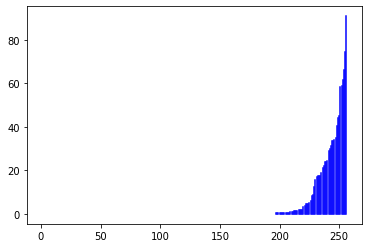

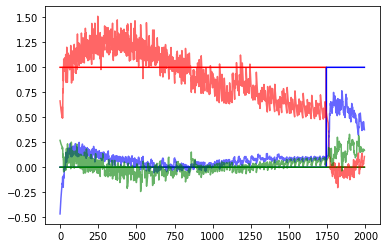

  2%|██▌                                                                                                                                                            | 49/3000 [09:21<9:09:59, 11.18s/it]

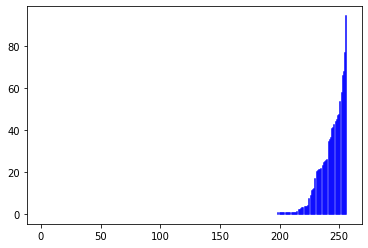

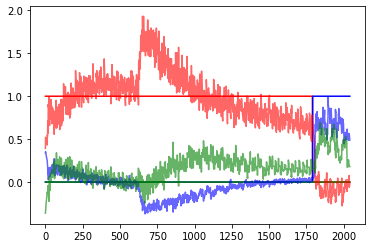

  2%|██▊                                                                                                                                                           | 54/3000 [11:03<11:07:12, 13.59s/it]

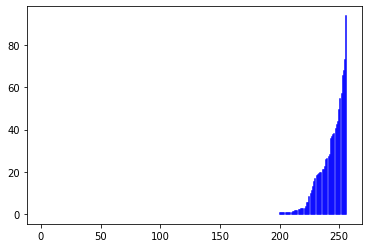

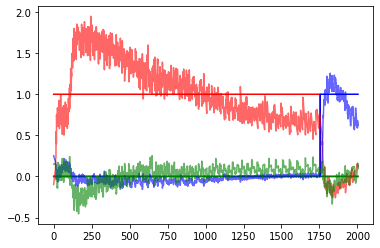

  2%|███▏                                                                                                                                                           | 59/3000 [11:59<9:10:10, 11.22s/it]

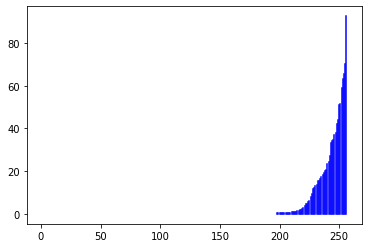

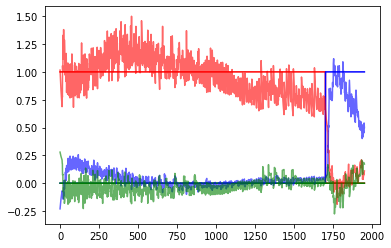

  2%|███▍                                                                                                                                                           | 64/3000 [12:55<8:49:35, 10.82s/it]

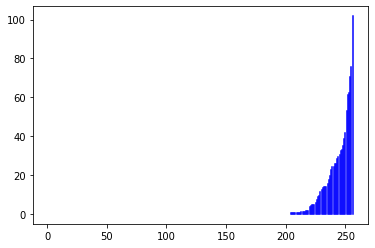

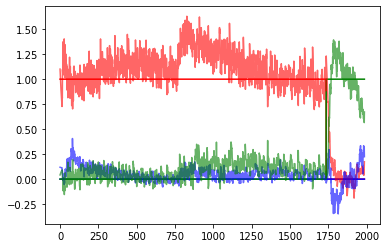

  2%|███▋                                                                                                                                                           | 69/3000 [13:52<8:49:28, 10.84s/it]

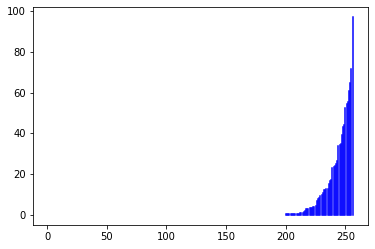

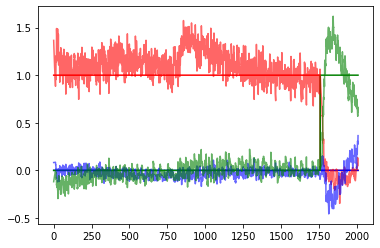

  2%|███▉                                                                                                                                                           | 74/3000 [14:45<8:02:26,  9.89s/it]

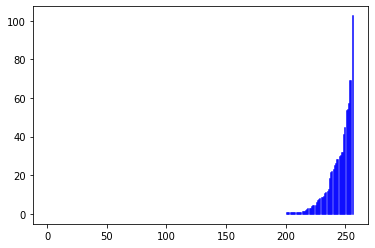

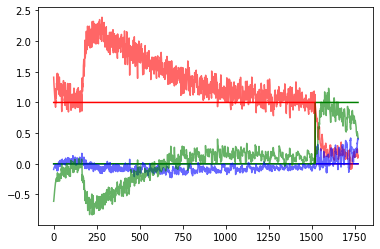

  3%|████▏                                                                                                                                                          | 79/3000 [15:39<8:34:52, 10.58s/it]

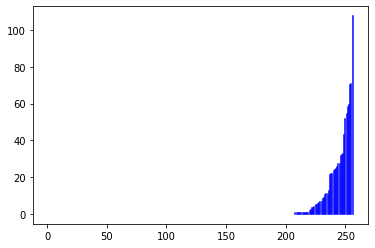

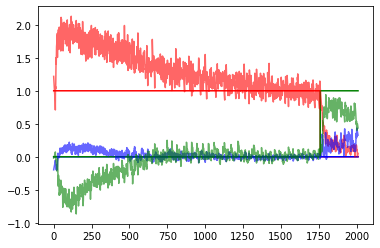

  3%|████▍                                                                                                                                                          | 84/3000 [16:35<8:46:57, 10.84s/it]

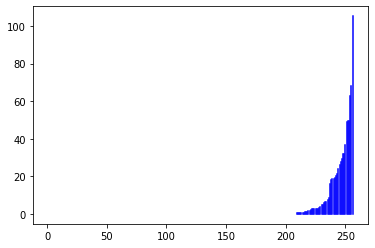

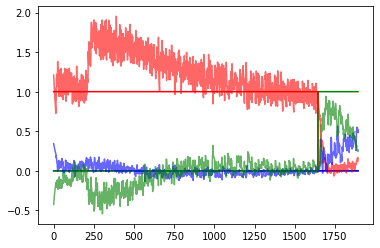

  3%|████▋                                                                                                                                                          | 89/3000 [17:26<7:56:46,  9.83s/it]

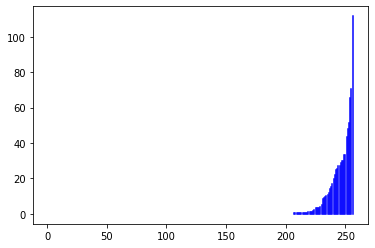

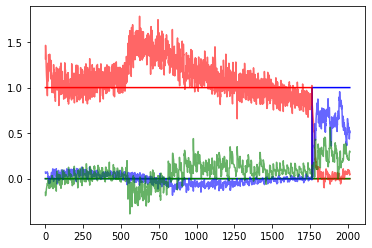

  3%|████▉                                                                                                                                                          | 94/3000 [18:24<8:46:48, 10.88s/it]

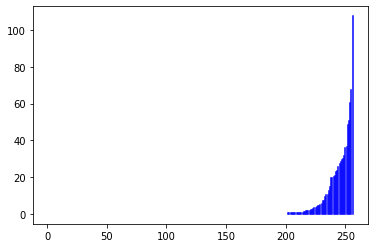

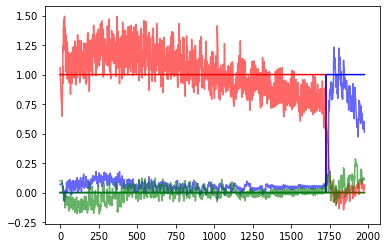

  3%|█████▏                                                                                                                                                         | 99/3000 [19:23<9:04:47, 11.27s/it]

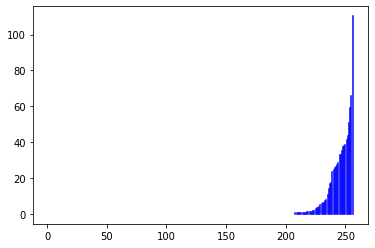

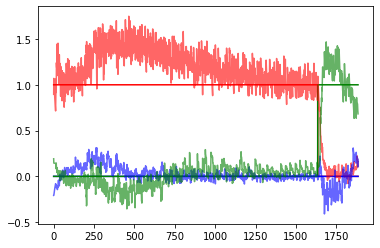

  3%|█████▍                                                                                                                                                       | 104/3000 [21:07<11:18:32, 14.06s/it]

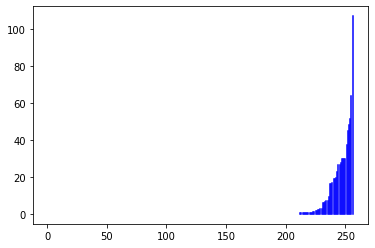

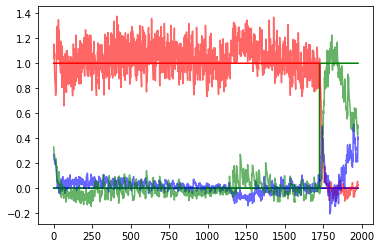

  4%|█████▋                                                                                                                                                        | 109/3000 [22:00<8:50:17, 11.01s/it]

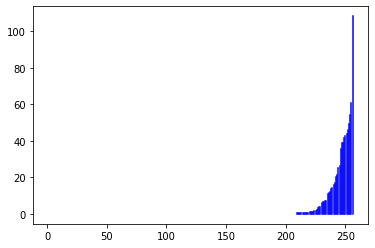

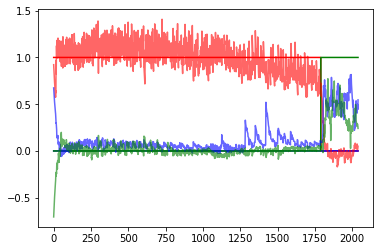

  4%|██████                                                                                                                                                        | 114/3000 [22:58<8:57:53, 11.18s/it]

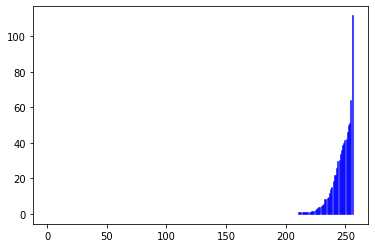

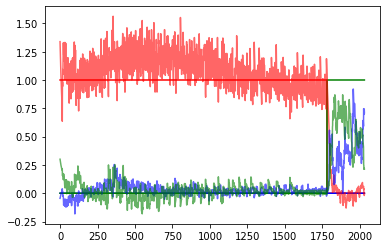

  4%|██████▎                                                                                                                                                       | 119/3000 [23:51<8:19:35, 10.40s/it]

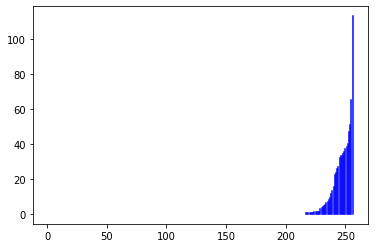

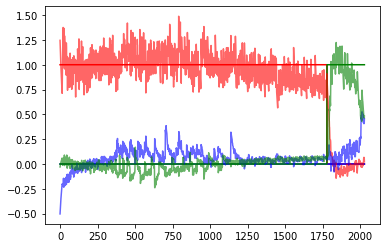

  4%|██████▌                                                                                                                                                       | 124/3000 [24:47<8:38:57, 10.83s/it]

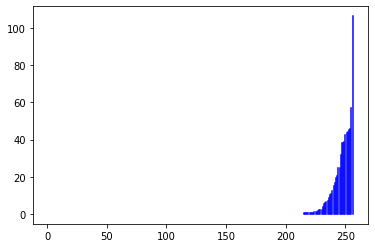

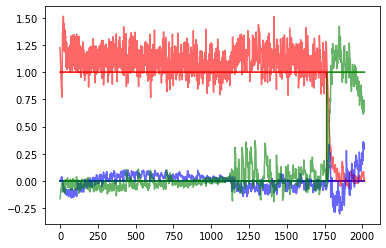

  4%|██████▊                                                                                                                                                       | 129/3000 [25:43<8:29:50, 10.66s/it]

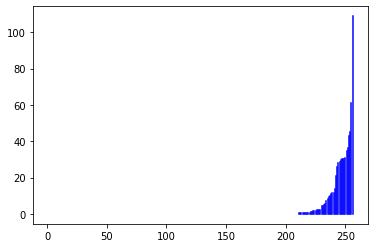

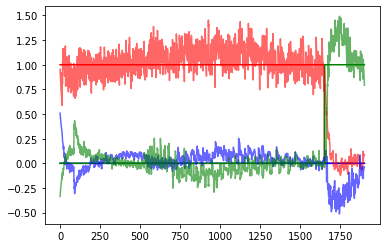

  4%|███████                                                                                                                                                       | 134/3000 [26:40<8:35:23, 10.79s/it]

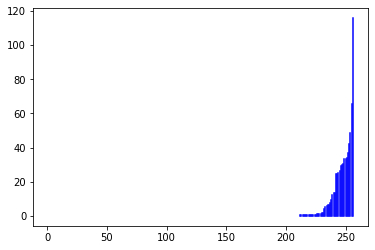

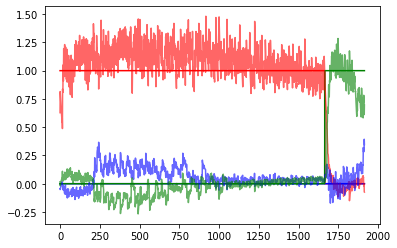

  5%|███████▎                                                                                                                                                      | 139/3000 [27:37<8:42:54, 10.97s/it]

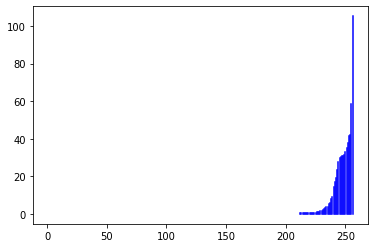

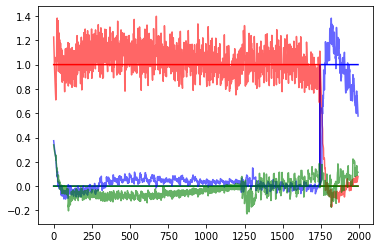

  5%|███████▌                                                                                                                                                      | 144/3000 [28:37<9:07:31, 11.50s/it]

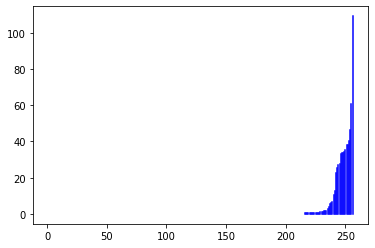

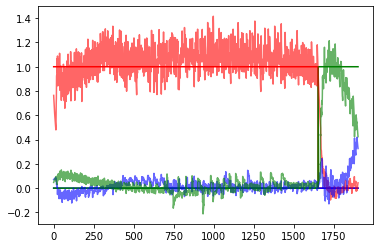

  5%|███████▊                                                                                                                                                      | 149/3000 [29:34<8:40:35, 10.96s/it]

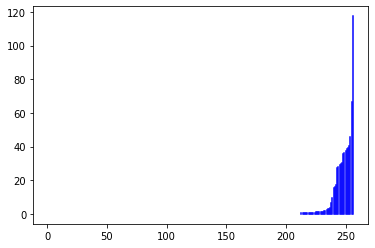

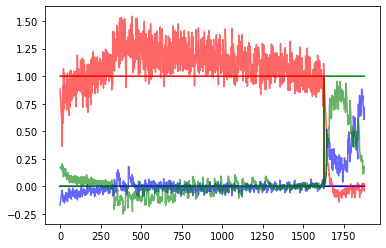

  5%|████████                                                                                                                                                     | 154/3000 [31:18<11:16:12, 14.26s/it]

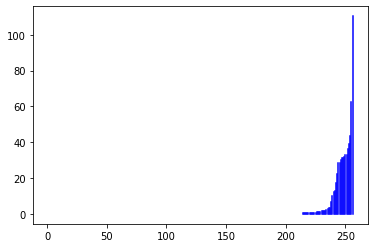

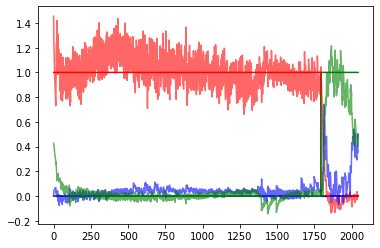

  5%|████████▎                                                                                                                                                     | 159/3000 [32:12<8:35:14, 10.88s/it]

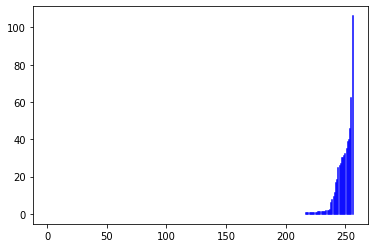

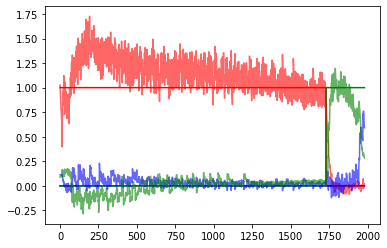

  5%|████████▋                                                                                                                                                     | 164/3000 [33:10<8:43:26, 11.07s/it]

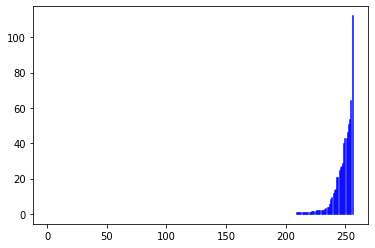

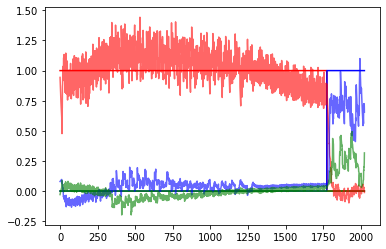

  6%|████████▉                                                                                                                                                     | 169/3000 [34:07<8:25:46, 10.72s/it]

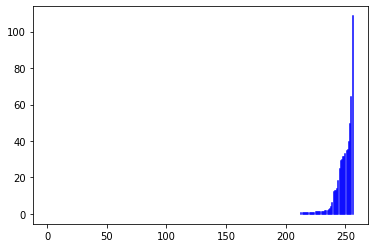

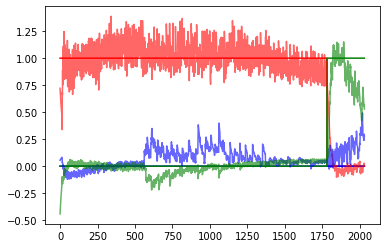

  6%|█████████▏                                                                                                                                                    | 174/3000 [35:02<8:11:38, 10.44s/it]

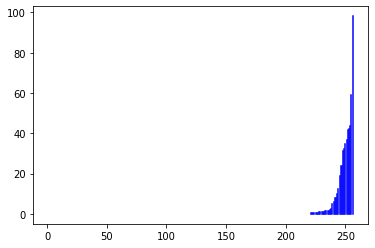

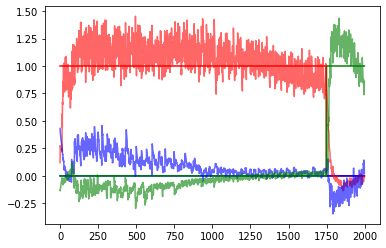

  6%|█████████▍                                                                                                                                                    | 179/3000 [35:57<8:12:35, 10.48s/it]

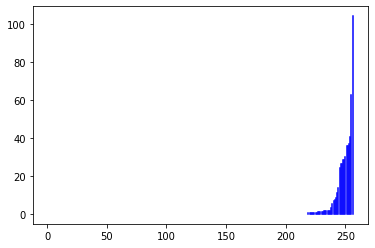

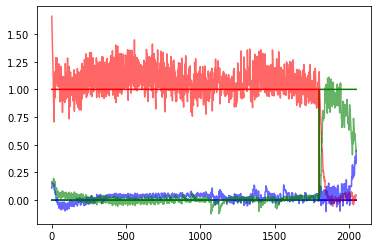

  6%|█████████▋                                                                                                                                                    | 184/3000 [36:54<8:31:43, 10.90s/it]

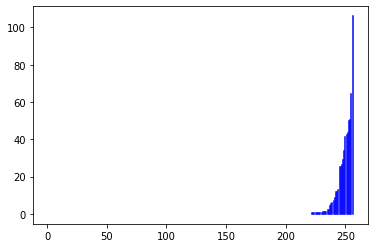

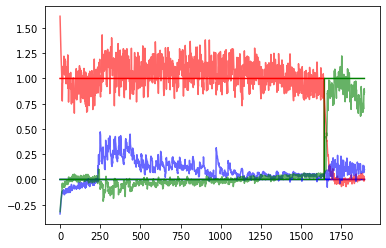

  6%|█████████▉                                                                                                                                                    | 189/3000 [37:50<8:25:55, 10.80s/it]

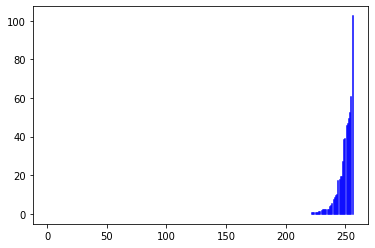

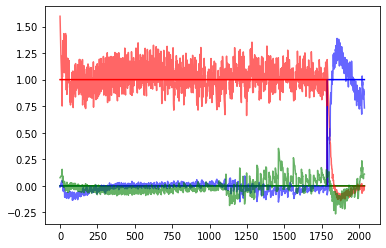

  6%|██████████▏                                                                                                                                                   | 194/3000 [38:46<8:30:00, 10.91s/it]

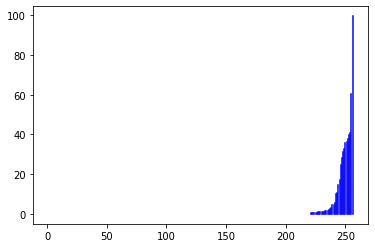

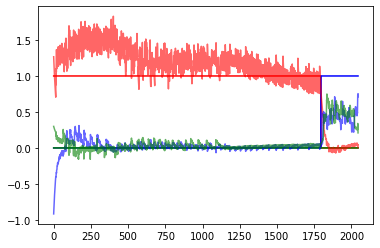

  7%|██████████▍                                                                                                                                                   | 199/3000 [39:45<8:51:45, 11.39s/it]

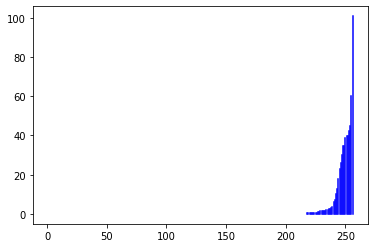

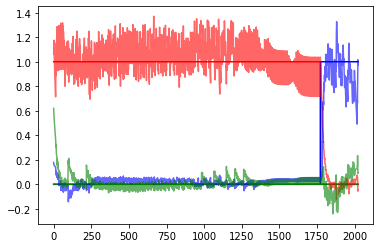

  7%|██████████▋                                                                                                                                                  | 204/3000 [41:28<10:45:08, 13.84s/it]

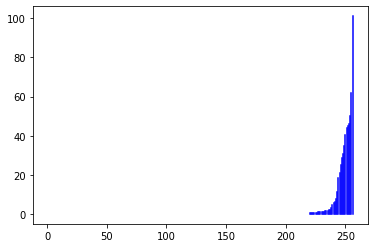

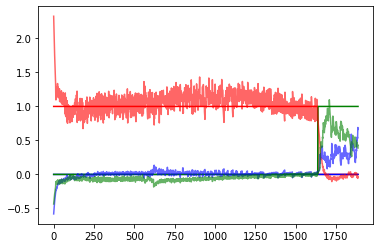

  7%|███████████                                                                                                                                                   | 209/3000 [42:26<8:55:00, 11.50s/it]

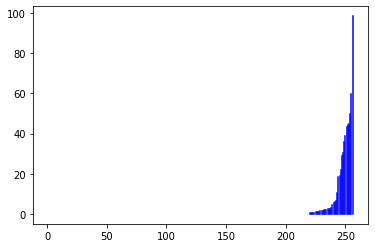

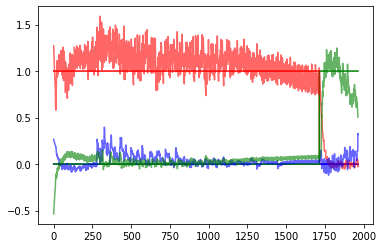

  7%|███████████▎                                                                                                                                                  | 214/3000 [43:23<8:15:35, 10.67s/it]

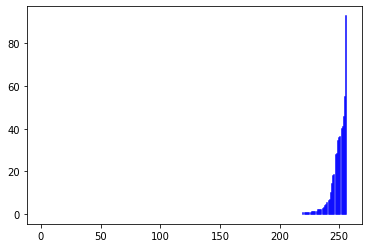

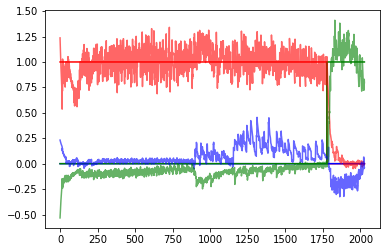

  7%|███████████▌                                                                                                                                                  | 219/3000 [44:20<8:28:32, 10.97s/it]

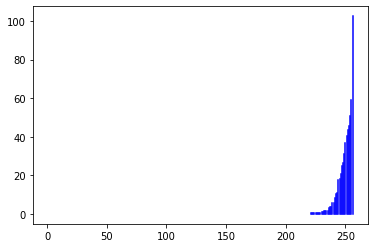

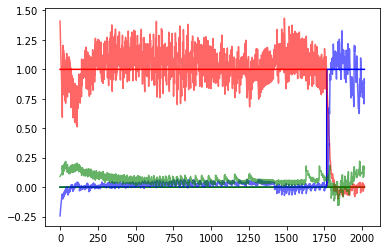

  7%|███████████▊                                                                                                                                                  | 224/3000 [45:19<8:39:58, 11.24s/it]

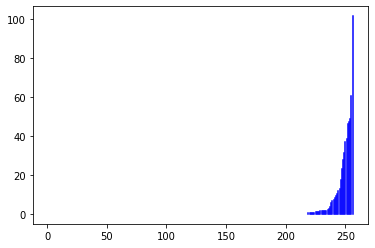

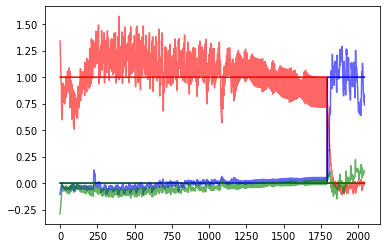

  8%|████████████                                                                                                                                                  | 229/3000 [46:15<8:17:40, 10.78s/it]

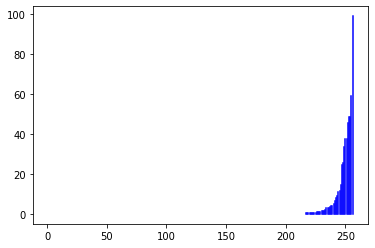

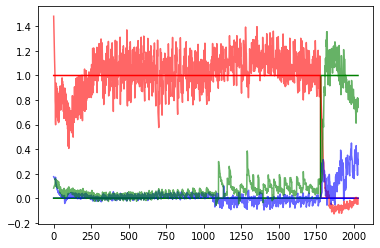

  8%|████████████▎                                                                                                                                                 | 234/3000 [47:16<8:51:22, 11.53s/it]

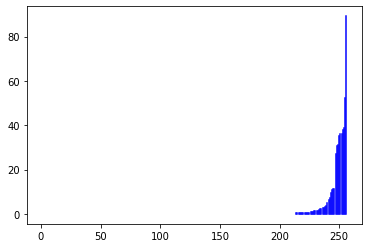

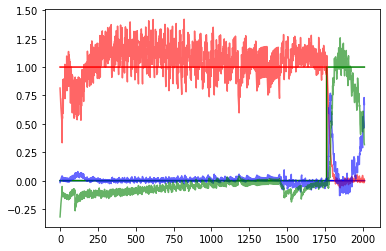

  8%|████████████▌                                                                                                                                                 | 239/3000 [48:15<8:42:05, 11.35s/it]

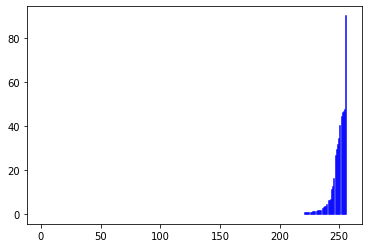

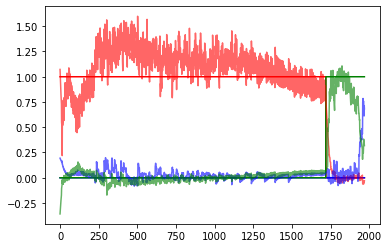

  8%|████████████▊                                                                                                                                                 | 244/3000 [49:12<8:24:02, 10.97s/it]

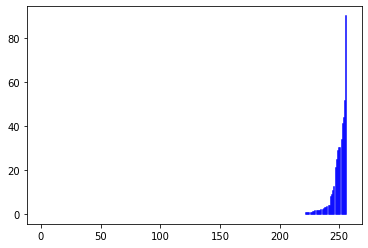

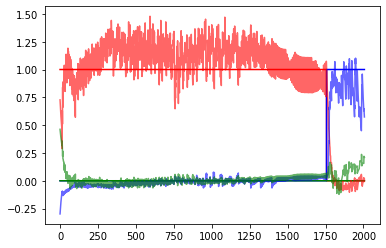

  8%|█████████████                                                                                                                                                 | 249/3000 [50:09<8:17:22, 10.85s/it]

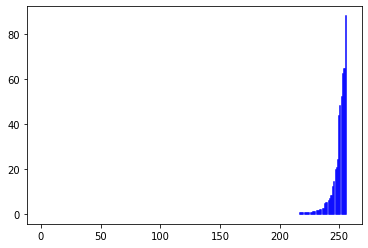

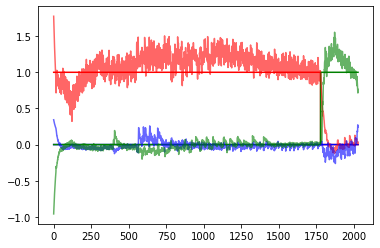

  8%|█████████████▎                                                                                                                                               | 254/3000 [51:51<10:40:08, 13.99s/it]

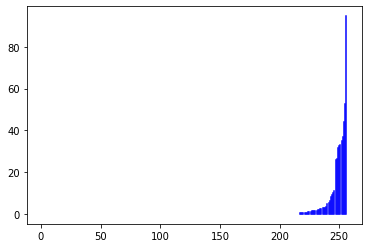

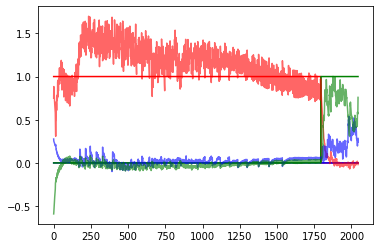

  9%|█████████████▋                                                                                                                                                | 259/3000 [52:49<8:37:45, 11.33s/it]

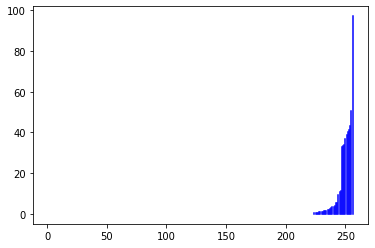

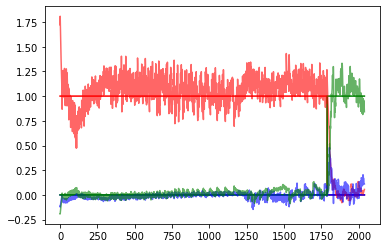

  9%|█████████████▉                                                                                                                                                | 264/3000 [53:47<8:31:27, 11.22s/it]

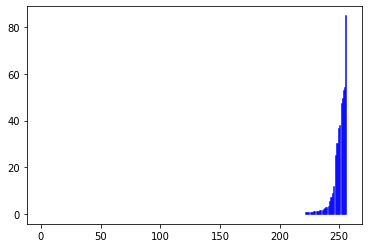

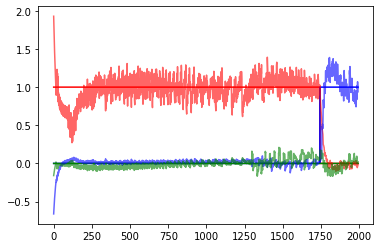

  9%|██████████████▏                                                                                                                                               | 269/3000 [54:41<8:13:59, 10.85s/it]

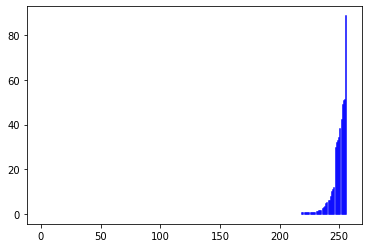

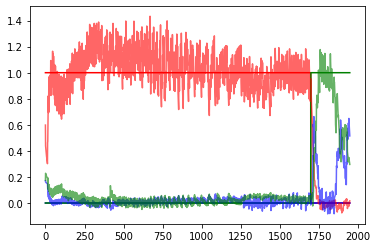

  9%|██████████████▍                                                                                                                                               | 274/3000 [55:38<8:05:49, 10.69s/it]

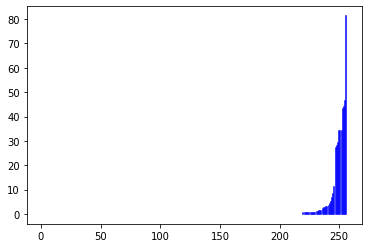

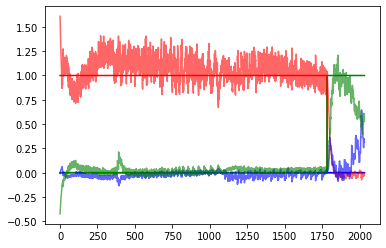

  9%|██████████████▋                                                                                                                                               | 279/3000 [56:28<7:26:43,  9.85s/it]

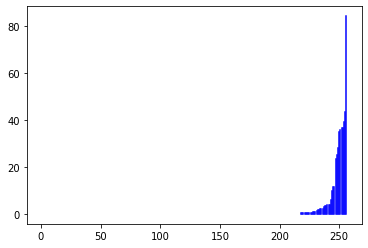

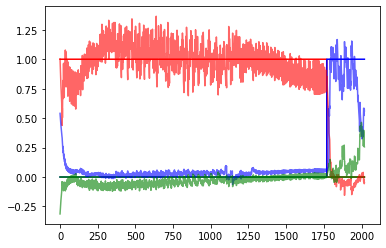

  9%|██████████████▉                                                                                                                                               | 284/3000 [57:23<7:36:37, 10.09s/it]

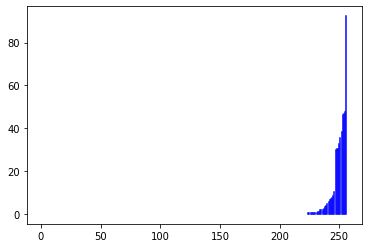

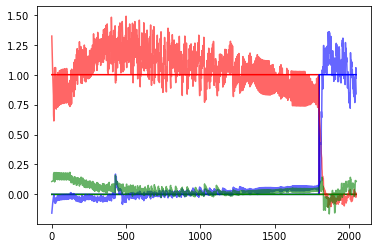

 10%|███████████████▏                                                                                                                                              | 289/3000 [58:19<8:04:44, 10.73s/it]

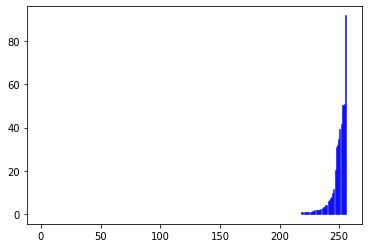

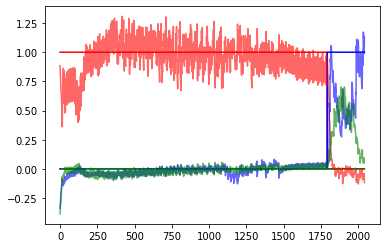

 10%|███████████████▍                                                                                                                                              | 294/3000 [59:15<8:07:51, 10.82s/it]

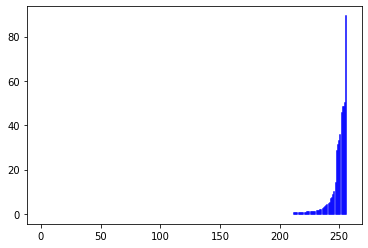

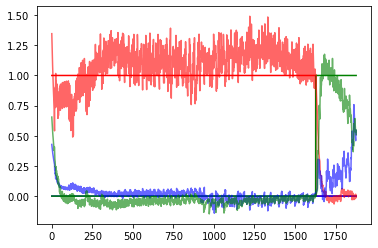

 10%|███████████████▌                                                                                                                                            | 299/3000 [1:00:11<8:07:25, 10.83s/it]

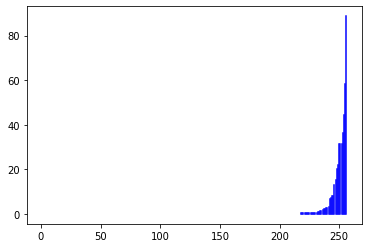

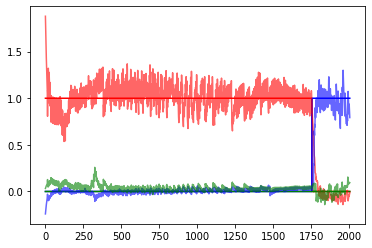

 10%|███████████████▋                                                                                                                                           | 304/3000 [1:01:54<10:37:42, 14.19s/it]

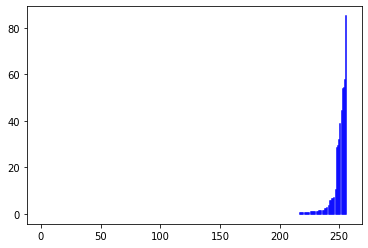

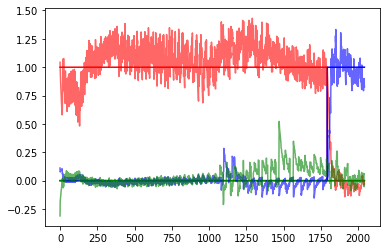

 10%|████████████████                                                                                                                                            | 309/3000 [1:02:51<8:23:41, 11.23s/it]

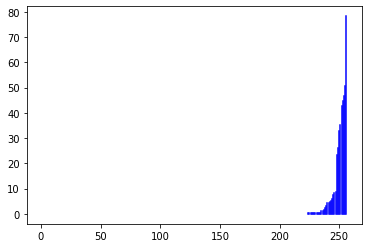

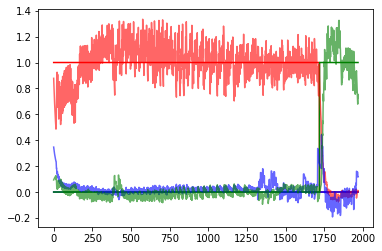

 10%|████████████████▎                                                                                                                                           | 314/3000 [1:03:49<8:25:13, 11.29s/it]

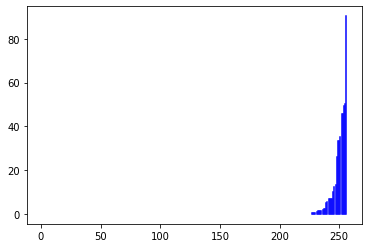

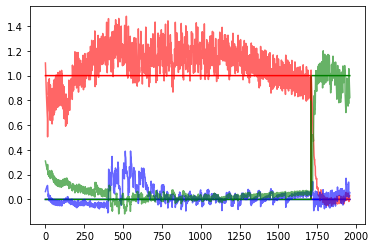

 11%|████████████████▌                                                                                                                                           | 319/3000 [1:04:44<8:04:05, 10.83s/it]

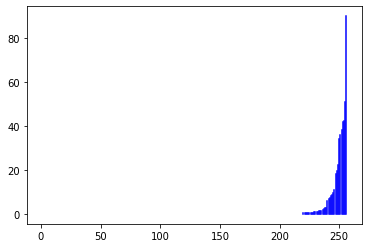

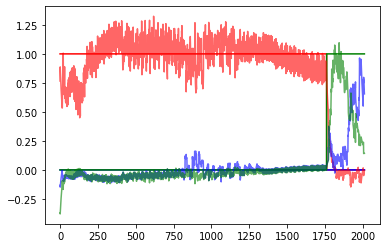

 11%|████████████████▊                                                                                                                                           | 324/3000 [1:05:40<8:00:13, 10.77s/it]

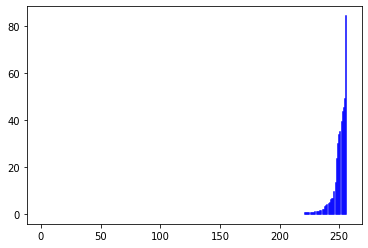

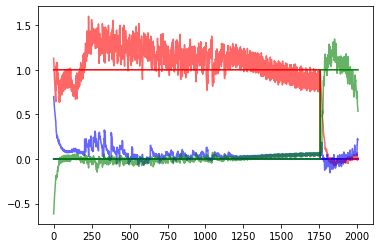

 11%|█████████████████                                                                                                                                           | 329/3000 [1:06:34<7:57:55, 10.74s/it]

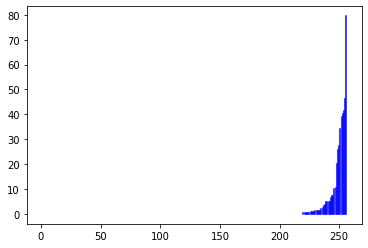

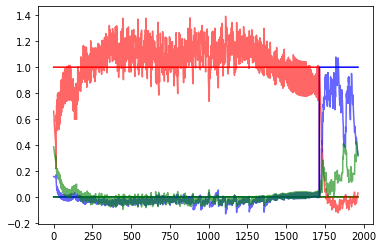

 11%|█████████████████▎                                                                                                                                          | 334/3000 [1:07:31<8:00:02, 10.80s/it]

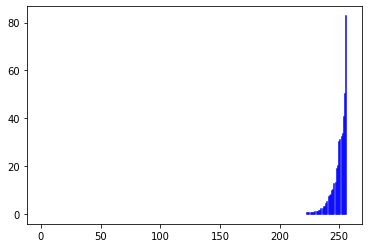

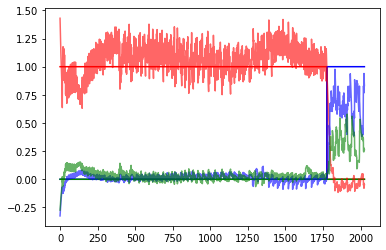

 11%|█████████████████▋                                                                                                                                          | 339/3000 [1:08:25<7:28:19, 10.11s/it]

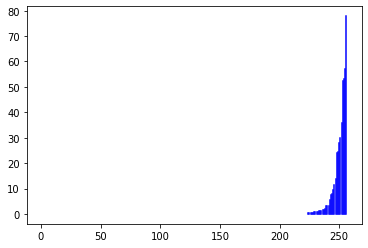

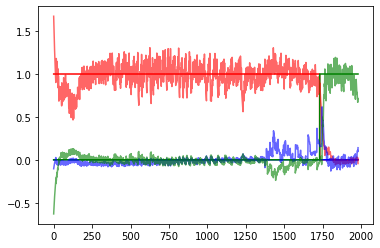

 11%|█████████████████▉                                                                                                                                          | 344/3000 [1:09:21<7:59:20, 10.83s/it]

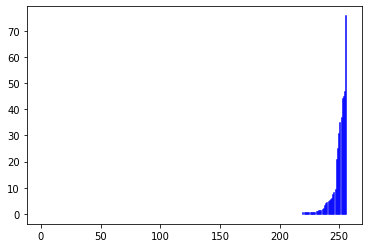

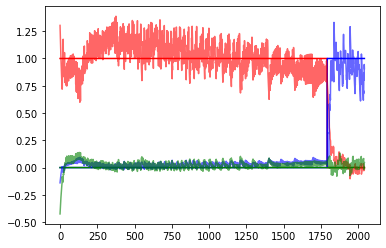

 12%|██████████████████▏                                                                                                                                         | 349/3000 [1:10:14<7:45:42, 10.54s/it]

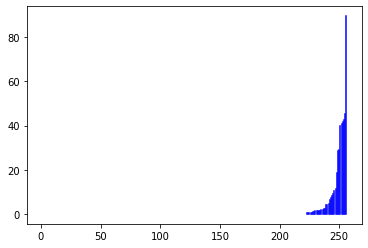

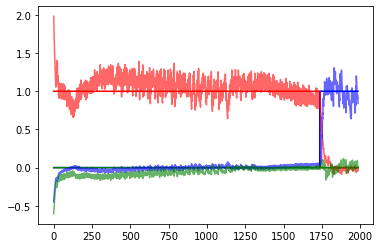

 12%|██████████████████▎                                                                                                                                        | 354/3000 [1:11:59<10:16:46, 13.99s/it]

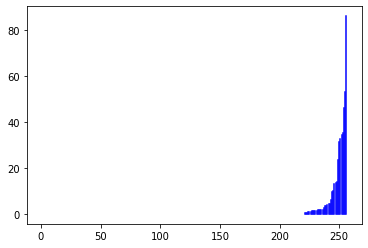

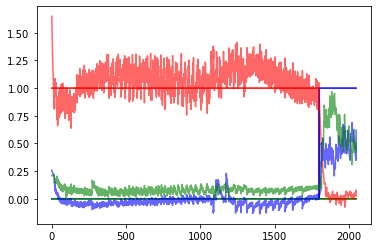

 12%|██████████████████▋                                                                                                                                         | 359/3000 [1:12:59<8:47:55, 11.99s/it]

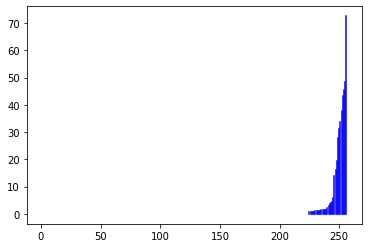

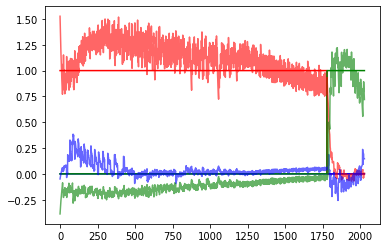

 12%|██████████████████▉                                                                                                                                         | 364/3000 [1:13:55<7:53:15, 10.77s/it]

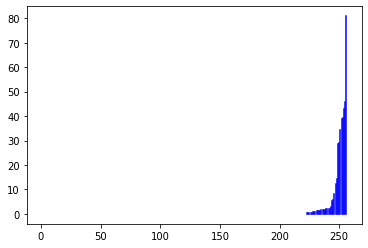

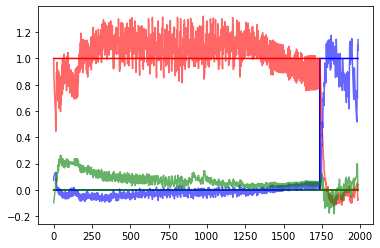

 12%|███████████████████▏                                                                                                                                        | 369/3000 [1:14:49<7:25:59, 10.17s/it]

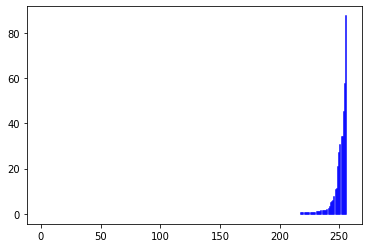

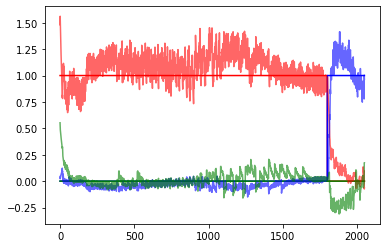

 12%|███████████████████▍                                                                                                                                        | 374/3000 [1:15:44<7:43:05, 10.58s/it]

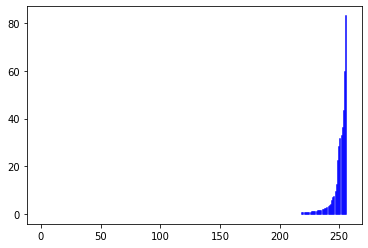

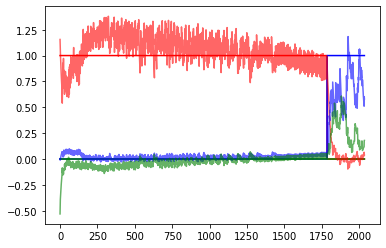

 13%|███████████████████▋                                                                                                                                        | 379/3000 [1:16:41<7:57:45, 10.94s/it]

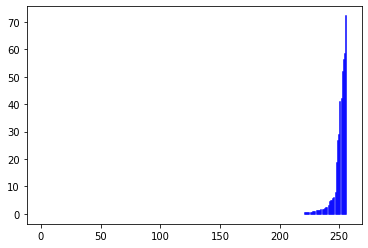

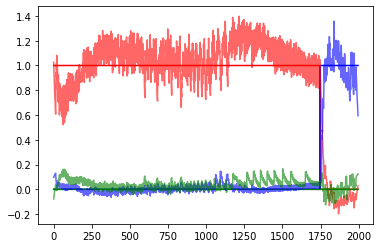

 13%|███████████████████▉                                                                                                                                        | 384/3000 [1:17:38<8:02:41, 11.07s/it]

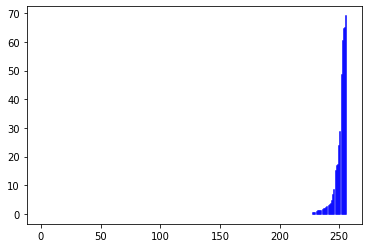

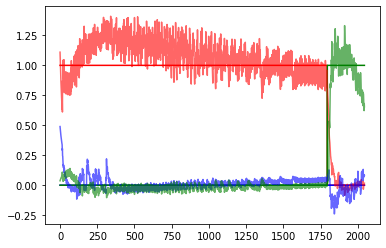

 13%|████████████████████▏                                                                                                                                       | 389/3000 [1:18:33<7:42:59, 10.64s/it]

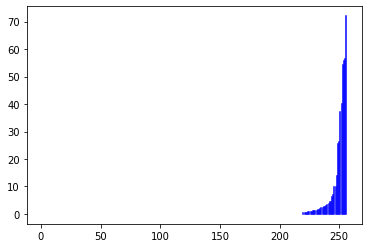

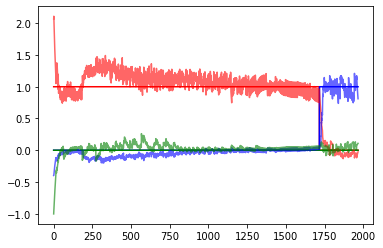

 13%|████████████████████▍                                                                                                                                       | 394/3000 [1:19:29<7:41:44, 10.63s/it]

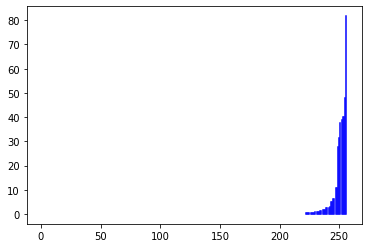

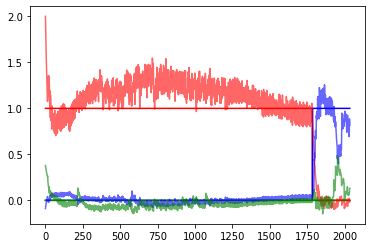

 13%|████████████████████▋                                                                                                                                       | 399/3000 [1:20:26<8:01:54, 11.12s/it]

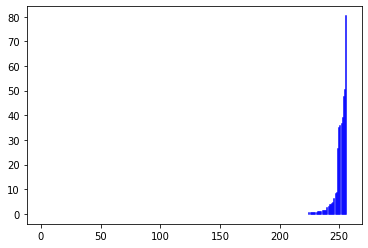

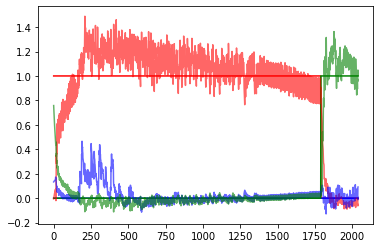

 13%|████████████████████▊                                                                                                                                      | 404/3000 [1:22:15<10:41:23, 14.82s/it]

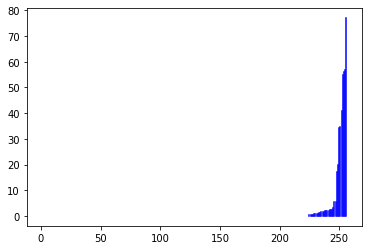

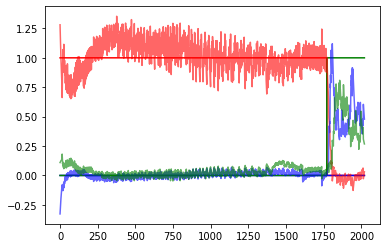

 14%|█████████████████████▎                                                                                                                                      | 409/3000 [1:23:12<8:08:10, 11.30s/it]

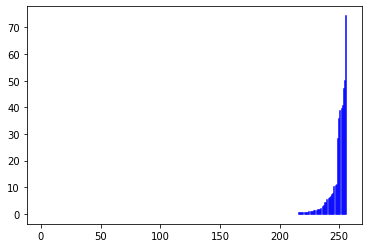

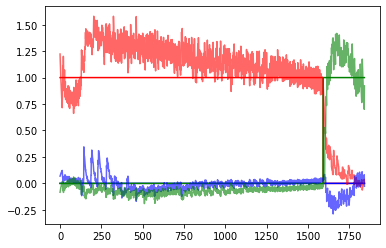

 14%|█████████████████████▌                                                                                                                                      | 414/3000 [1:24:07<7:52:27, 10.96s/it]

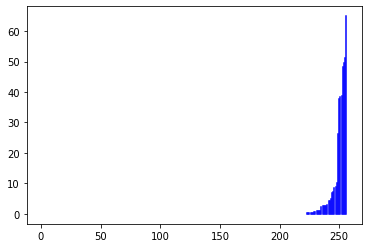

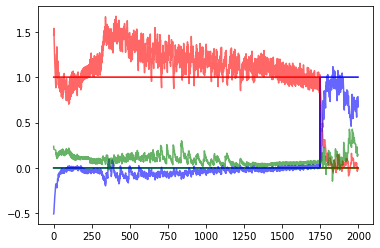

 14%|█████████████████████▊                                                                                                                                      | 419/3000 [1:25:04<7:43:24, 10.77s/it]

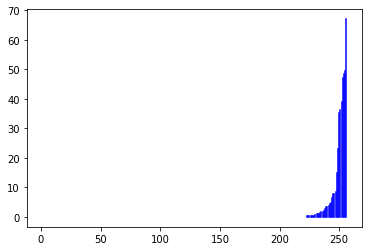

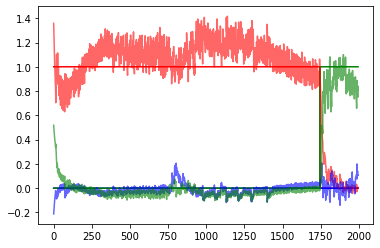

 14%|██████████████████████                                                                                                                                      | 424/3000 [1:25:59<7:28:35, 10.45s/it]

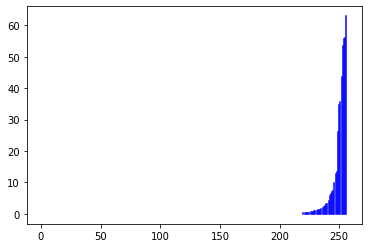

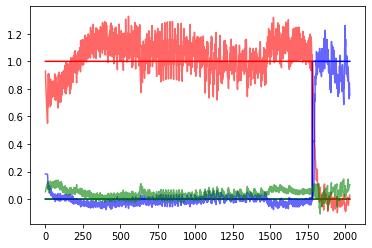

 14%|██████████████████████▎                                                                                                                                     | 429/3000 [1:26:56<7:49:14, 10.95s/it]

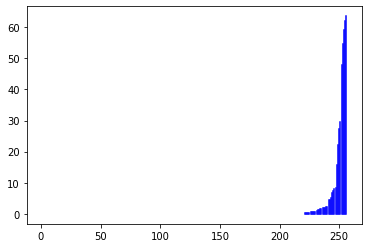

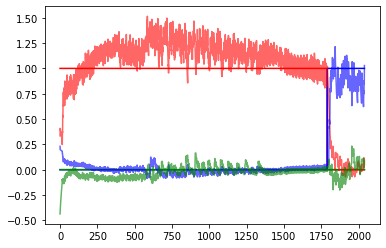

 14%|██████████████████████▌                                                                                                                                     | 434/3000 [1:27:53<7:46:24, 10.91s/it]

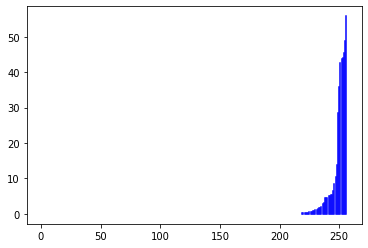

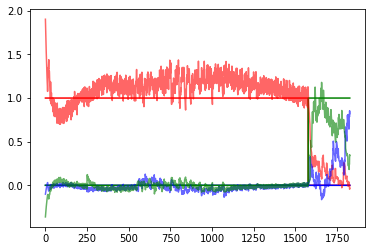

 15%|██████████████████████▊                                                                                                                                     | 439/3000 [1:28:53<8:03:47, 11.33s/it]

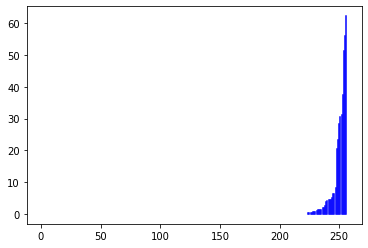

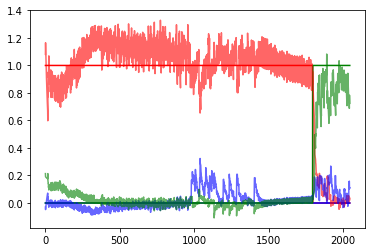

 15%|███████████████████████                                                                                                                                     | 444/3000 [1:29:52<7:58:04, 11.22s/it]

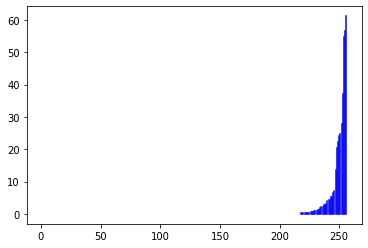

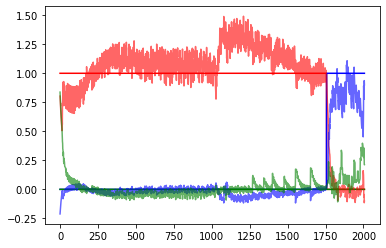

 15%|███████████████████████▎                                                                                                                                    | 449/3000 [1:30:50<7:49:07, 11.03s/it]

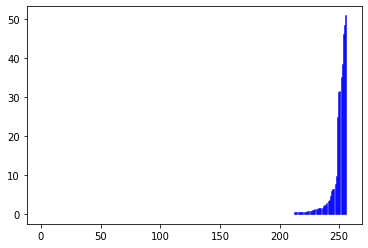

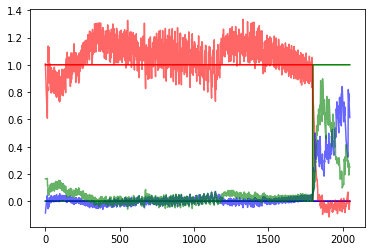

 15%|███████████████████████▍                                                                                                                                   | 454/3000 [1:32:35<10:17:51, 14.56s/it]

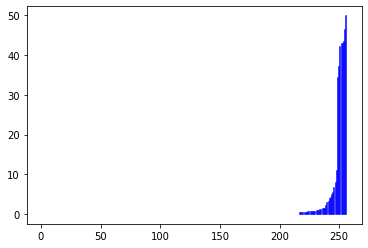

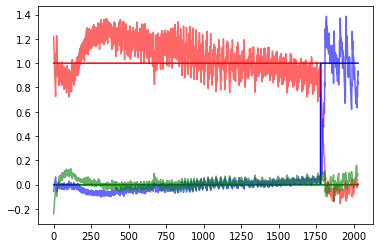

 15%|███████████████████████▊                                                                                                                                    | 459/3000 [1:33:33<8:23:22, 11.89s/it]

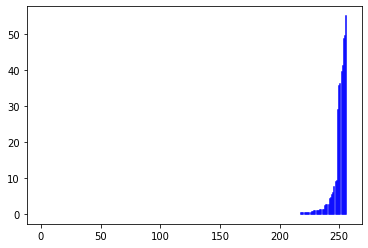

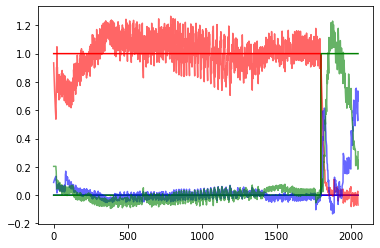

 15%|████████████████████████▏                                                                                                                                   | 464/3000 [1:34:29<7:39:14, 10.87s/it]

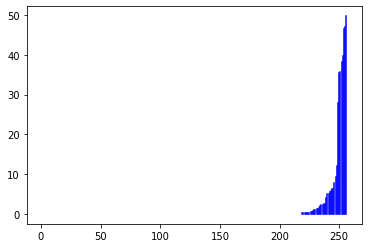

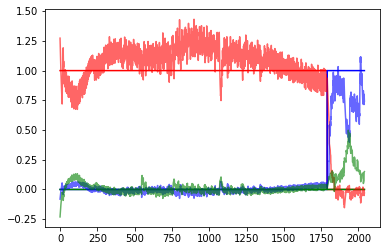

 16%|████████████████████████▍                                                                                                                                   | 469/3000 [1:35:26<7:53:36, 11.23s/it]

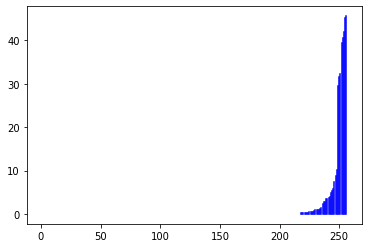

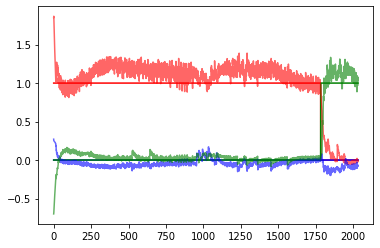

 16%|████████████████████████▋                                                                                                                                   | 474/3000 [1:36:22<7:31:19, 10.72s/it]

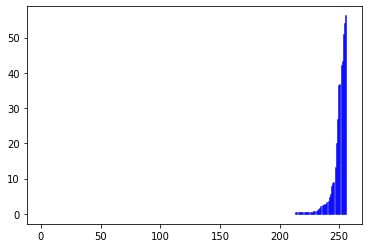

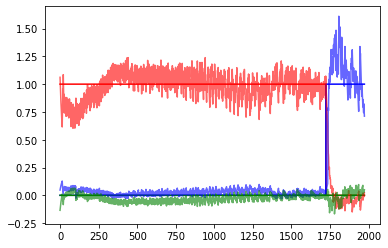

 16%|████████████████████████▉                                                                                                                                   | 479/3000 [1:37:18<7:14:50, 10.35s/it]

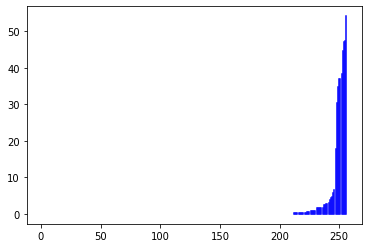

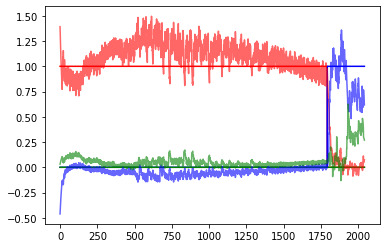

 16%|█████████████████████████▏                                                                                                                                  | 484/3000 [1:38:15<7:37:11, 10.90s/it]

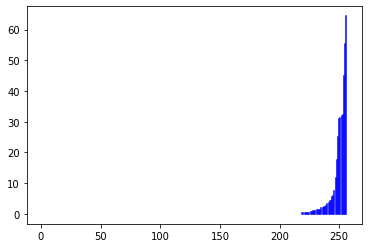

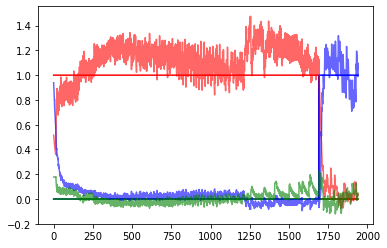

 16%|█████████████████████████▍                                                                                                                                  | 489/3000 [1:39:14<7:41:03, 11.02s/it]

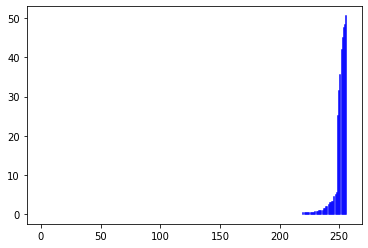

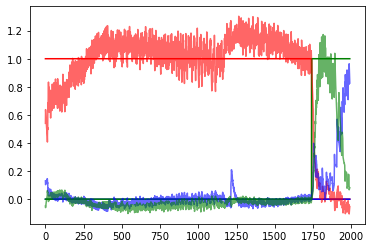

 16%|█████████████████████████▋                                                                                                                                  | 494/3000 [1:40:12<7:47:44, 11.20s/it]

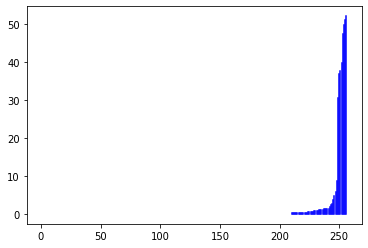

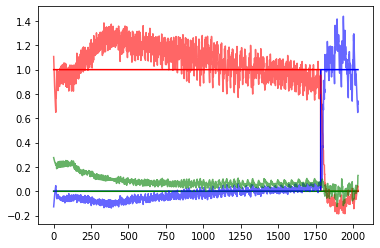

 17%|█████████████████████████▉                                                                                                                                  | 499/3000 [1:41:12<7:57:51, 11.46s/it]

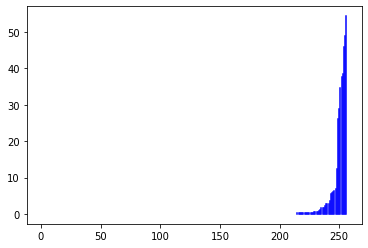

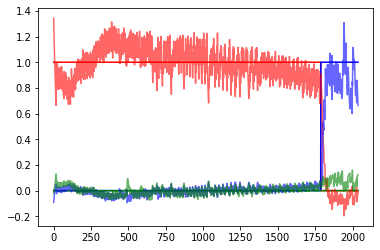

 17%|██████████████████████████                                                                                                                                 | 504/3000 [1:42:57<10:03:40, 14.51s/it]

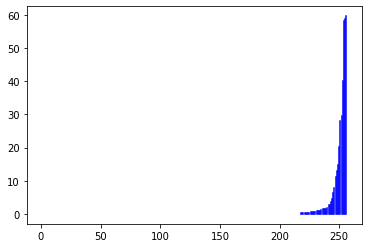

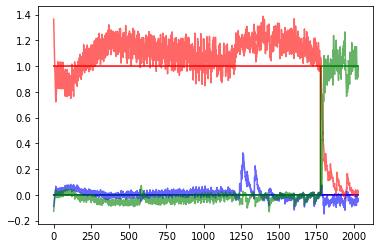

 17%|██████████████████████████▍                                                                                                                                 | 509/3000 [1:43:51<7:35:13, 10.96s/it]

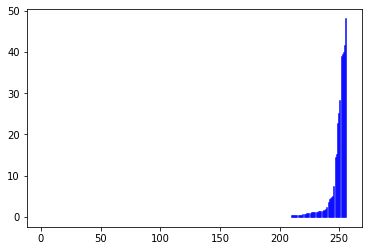

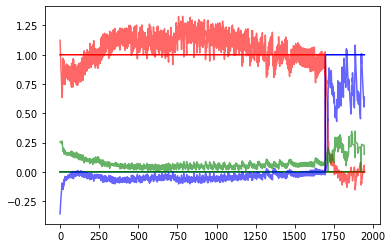

 17%|██████████████████████████▋                                                                                                                                 | 514/3000 [1:44:48<7:31:48, 10.90s/it]

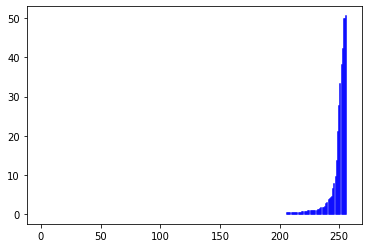

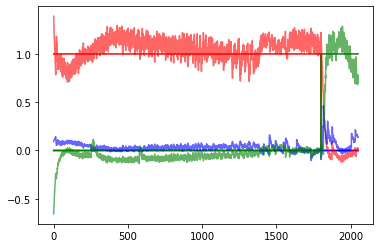

 17%|██████████████████████████▉                                                                                                                                 | 519/3000 [1:45:44<7:24:01, 10.74s/it]

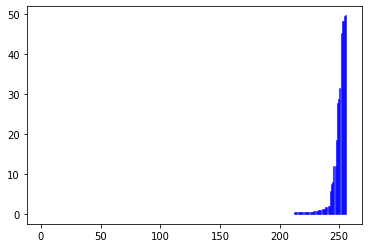

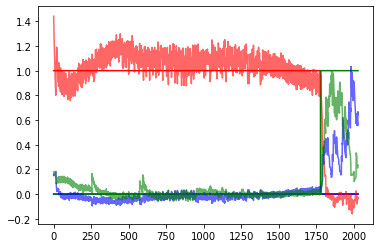

 17%|███████████████████████████▏                                                                                                                                | 524/3000 [1:46:41<7:24:14, 10.77s/it]

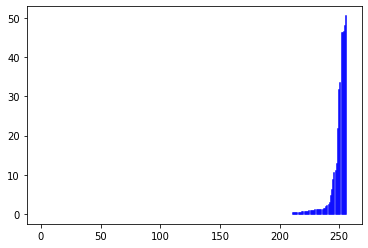

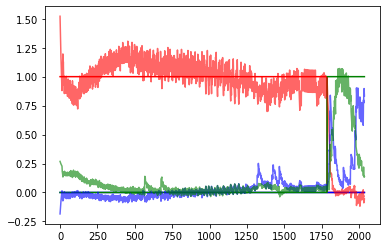

 18%|███████████████████████████▌                                                                                                                                | 529/3000 [1:47:39<7:34:10, 11.03s/it]

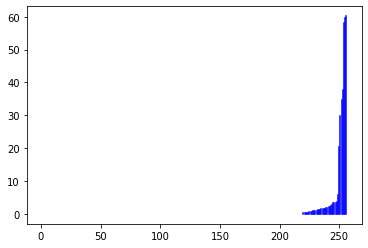

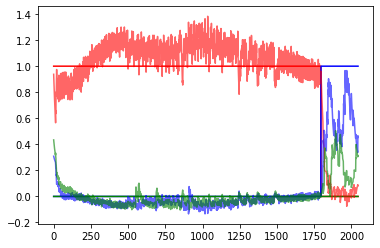

 18%|███████████████████████████▊                                                                                                                                | 534/3000 [1:48:35<7:27:00, 10.88s/it]

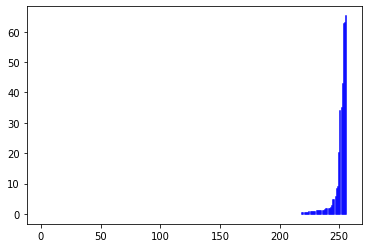

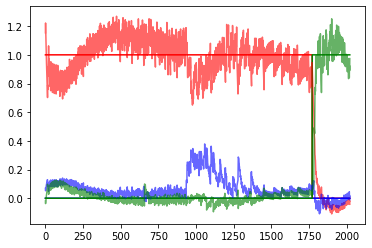

 18%|████████████████████████████                                                                                                                                | 539/3000 [1:49:31<7:10:24, 10.49s/it]

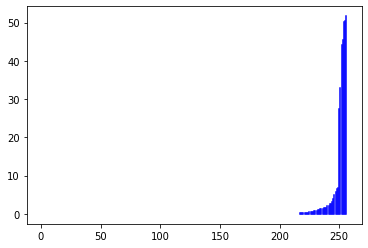

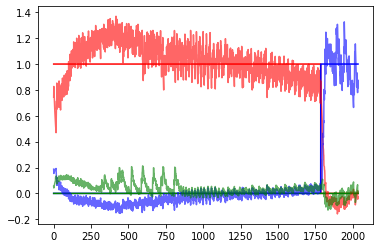

 18%|████████████████████████████▎                                                                                                                               | 544/3000 [1:50:28<7:31:25, 11.03s/it]

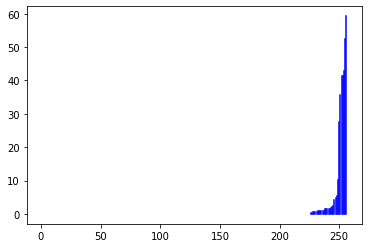

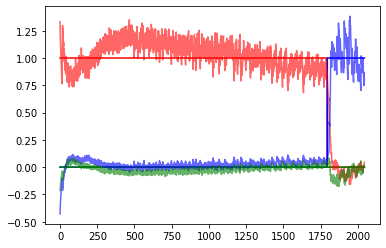

 18%|████████████████████████████▌                                                                                                                               | 549/3000 [1:51:23<7:07:59, 10.48s/it]

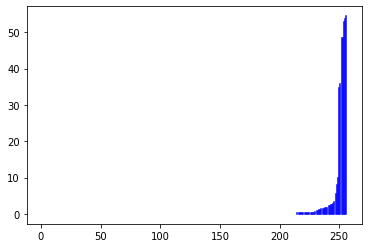

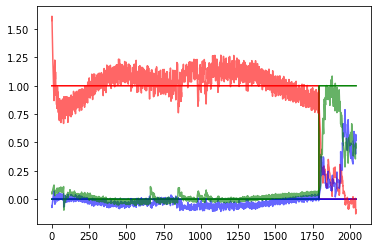

 18%|████████████████████████████▊                                                                                                                               | 554/3000 [1:53:09<9:36:59, 14.15s/it]

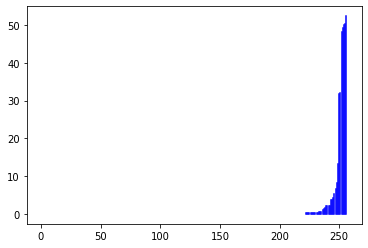

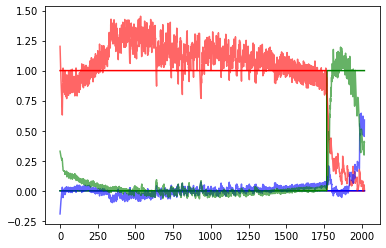

 19%|█████████████████████████████                                                                                                                               | 559/3000 [1:54:07<7:48:11, 11.51s/it]

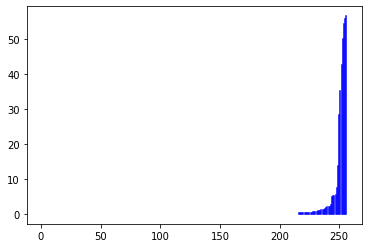

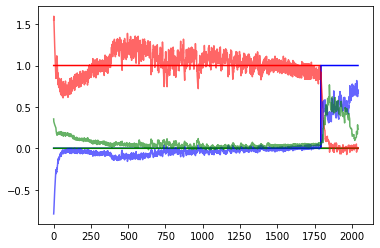

 19%|█████████████████████████████▎                                                                                                                              | 564/3000 [1:55:04<7:35:22, 11.22s/it]

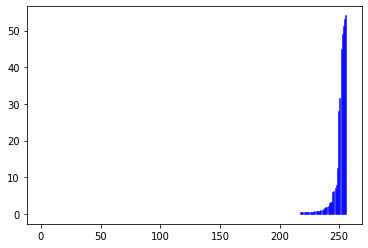

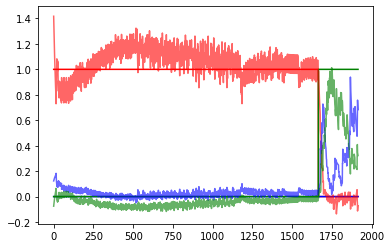

 19%|█████████████████████████████▌                                                                                                                              | 569/3000 [1:55:58<6:56:01, 10.27s/it]

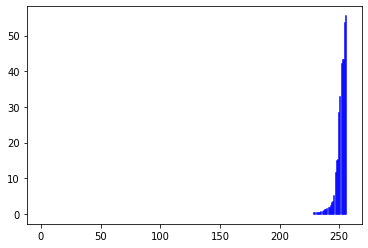

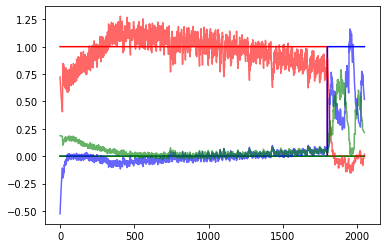

 19%|█████████████████████████████▊                                                                                                                              | 574/3000 [1:56:52<7:04:06, 10.49s/it]

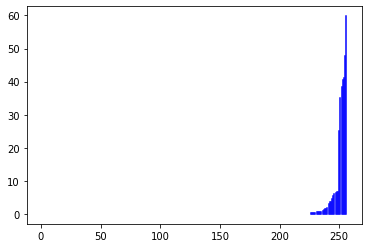

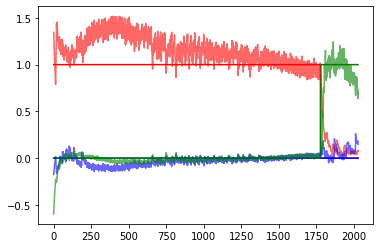

 19%|██████████████████████████████                                                                                                                              | 579/3000 [1:57:48<7:15:57, 10.80s/it]

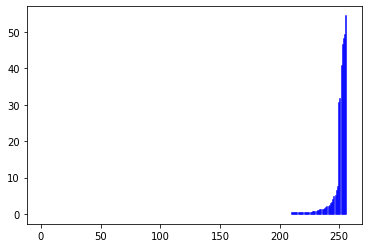

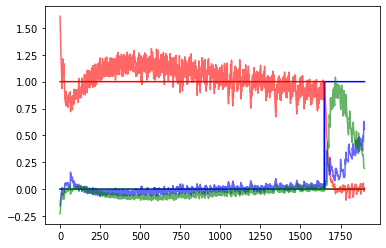

 19%|██████████████████████████████▎                                                                                                                             | 584/3000 [1:58:46<7:18:15, 10.88s/it]

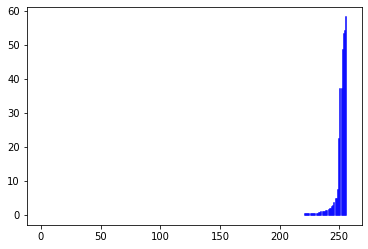

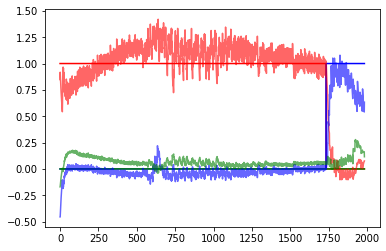

 20%|██████████████████████████████▋                                                                                                                             | 589/3000 [1:59:42<7:15:44, 10.84s/it]

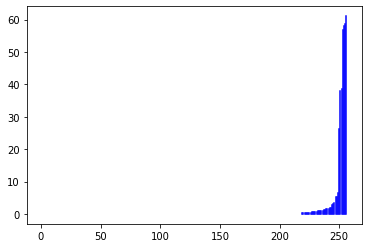

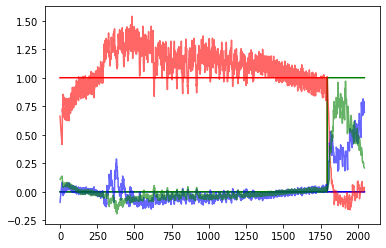

 20%|██████████████████████████████▉                                                                                                                             | 594/3000 [2:00:37<6:55:45, 10.37s/it]

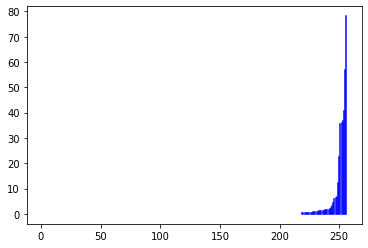

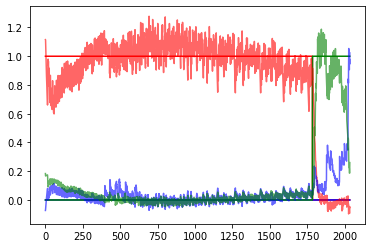

 20%|███████████████████████████████▏                                                                                                                            | 599/3000 [2:01:30<7:00:43, 10.51s/it]

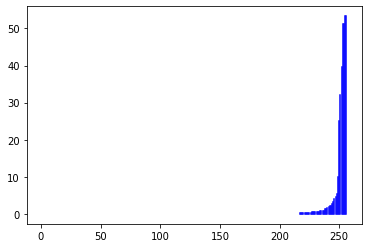

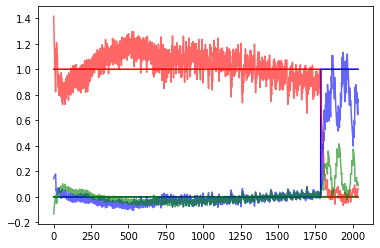

 20%|███████████████████████████████▍                                                                                                                            | 604/3000 [2:03:11<9:04:53, 13.65s/it]

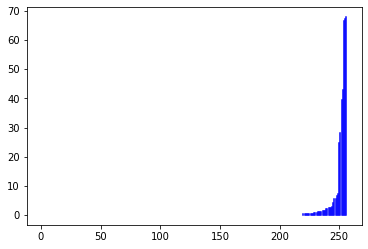

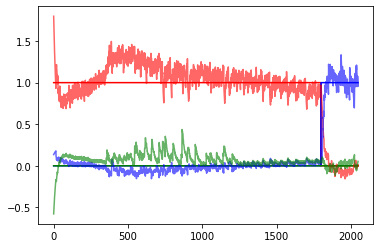

 20%|███████████████████████████████▋                                                                                                                            | 609/3000 [2:04:09<7:33:11, 11.37s/it]

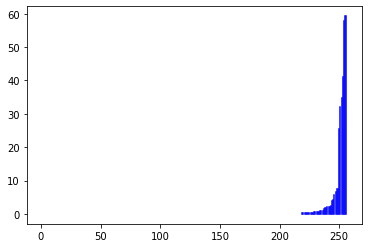

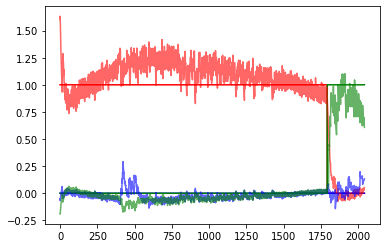

 20%|███████████████████████████████▉                                                                                                                            | 614/3000 [2:05:06<7:24:13, 11.17s/it]

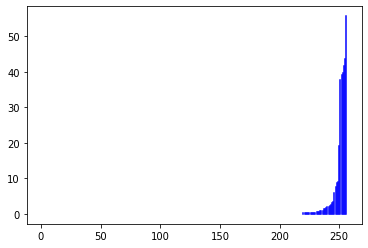

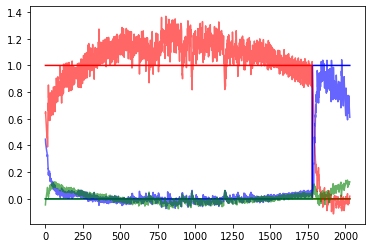

 21%|████████████████████████████████▏                                                                                                                           | 619/3000 [2:06:02<7:06:39, 10.75s/it]

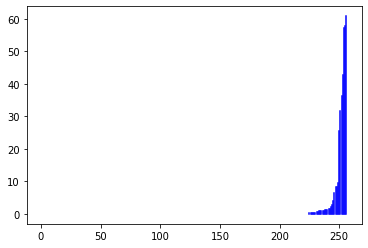

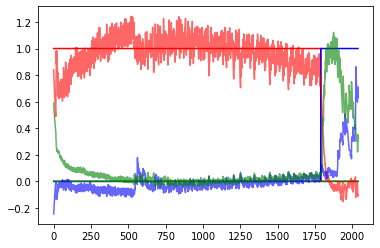

 21%|████████████████████████████████▍                                                                                                                           | 624/3000 [2:06:57<7:05:01, 10.73s/it]

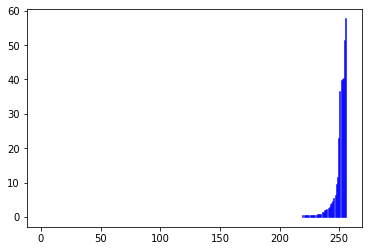

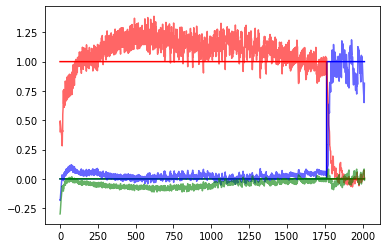

 21%|████████████████████████████████▋                                                                                                                           | 629/3000 [2:07:54<7:17:05, 11.06s/it]

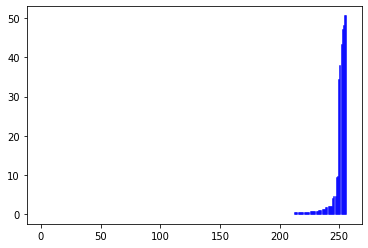

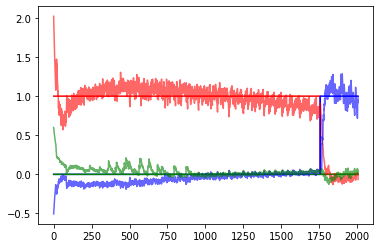

 21%|████████████████████████████████▉                                                                                                                           | 634/3000 [2:08:50<7:11:41, 10.95s/it]

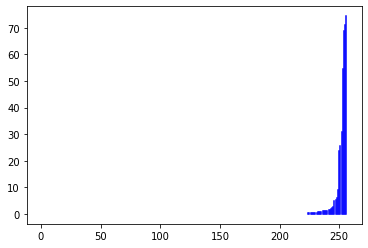

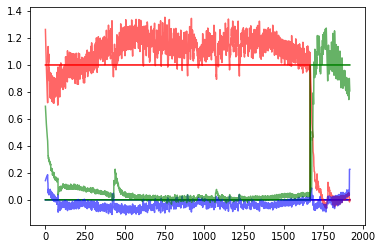

 21%|█████████████████████████████████▏                                                                                                                          | 639/3000 [2:09:44<6:45:51, 10.31s/it]

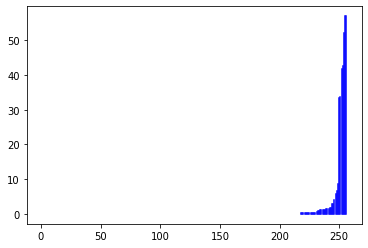

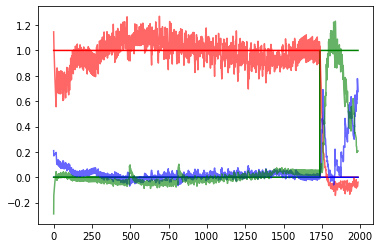

 21%|█████████████████████████████████▍                                                                                                                          | 644/3000 [2:10:39<6:57:43, 10.64s/it]

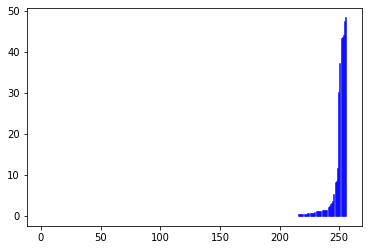

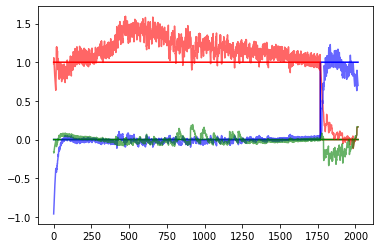

 22%|█████████████████████████████████▋                                                                                                                          | 649/3000 [2:11:35<7:06:51, 10.89s/it]

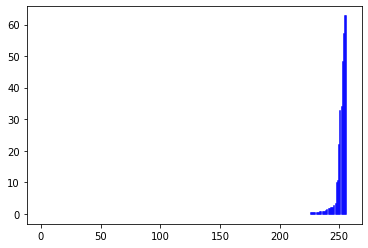

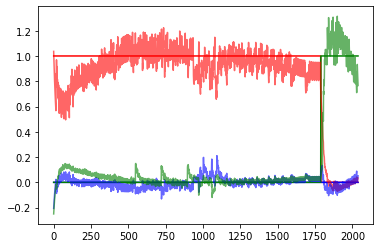

 22%|██████████████████████████████████                                                                                                                          | 654/3000 [2:13:17<9:19:13, 14.30s/it]

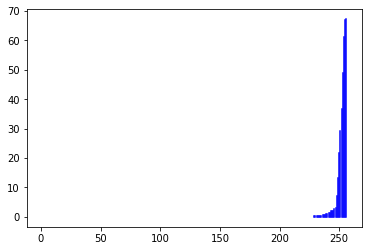

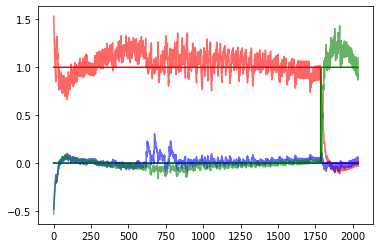

 22%|██████████████████████████████████▎                                                                                                                         | 659/3000 [2:14:09<6:53:21, 10.59s/it]

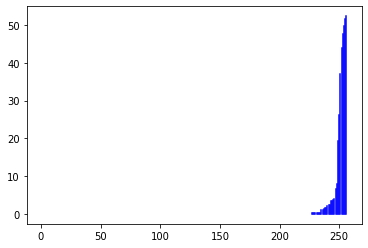

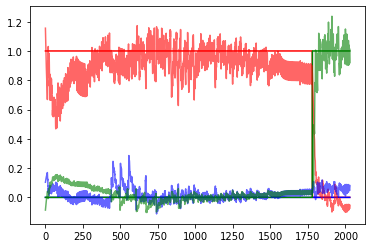

 22%|██████████████████████████████████▌                                                                                                                         | 664/3000 [2:15:05<6:47:27, 10.47s/it]

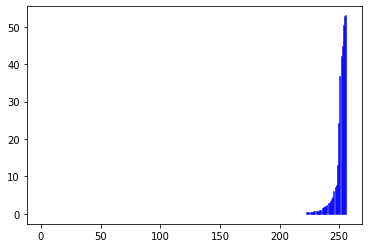

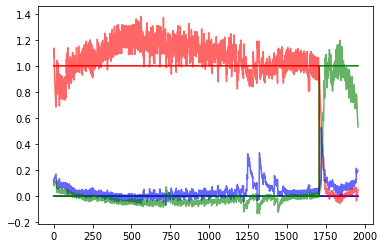

 22%|██████████████████████████████████▊                                                                                                                         | 669/3000 [2:16:03<7:11:21, 11.10s/it]

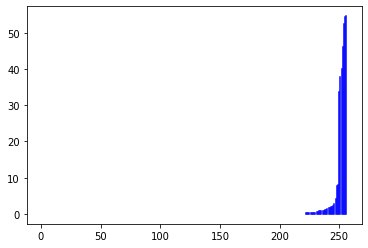

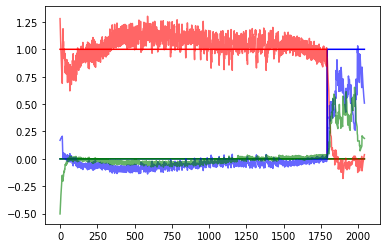

 22%|███████████████████████████████████                                                                                                                         | 674/3000 [2:17:01<7:11:19, 11.13s/it]

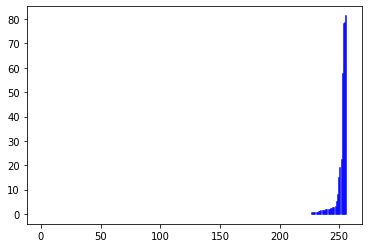

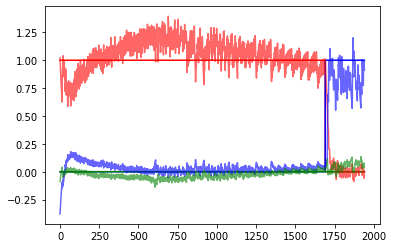

 23%|███████████████████████████████████▎                                                                                                                        | 679/3000 [2:17:57<6:50:51, 10.62s/it]

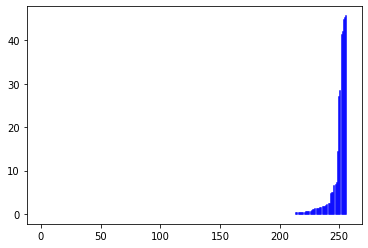

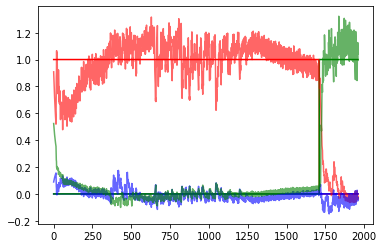

 23%|███████████████████████████████████▌                                                                                                                        | 684/3000 [2:18:52<6:46:00, 10.52s/it]

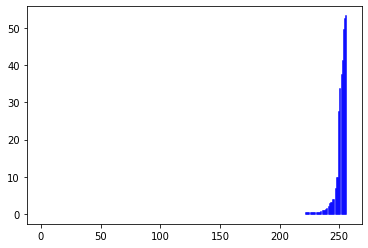

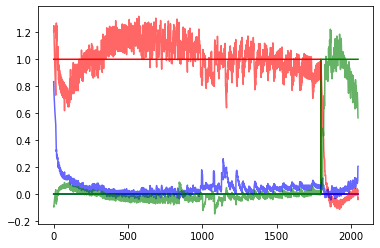

 23%|███████████████████████████████████▊                                                                                                                        | 689/3000 [2:19:45<6:31:05, 10.15s/it]

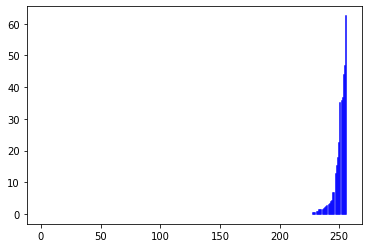

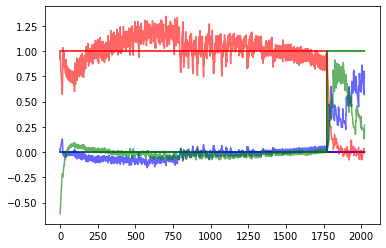

 23%|████████████████████████████████████                                                                                                                        | 694/3000 [2:20:44<7:01:13, 10.96s/it]

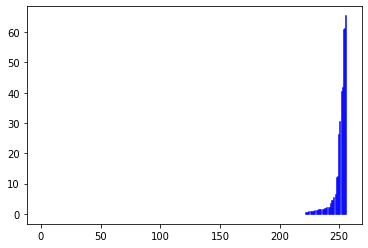

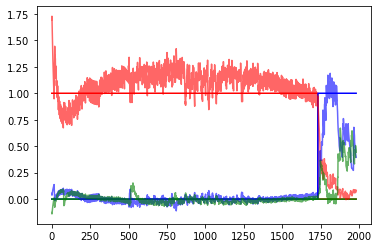

 23%|████████████████████████████████████▎                                                                                                                       | 699/3000 [2:21:42<7:09:42, 11.20s/it]

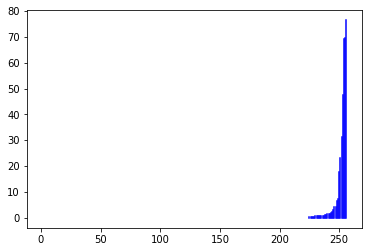

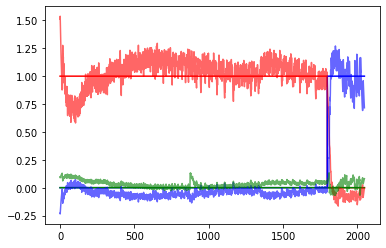

 23%|████████████████████████████████████▌                                                                                                                       | 704/3000 [2:23:27<9:14:20, 14.49s/it]

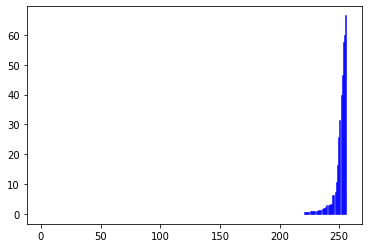

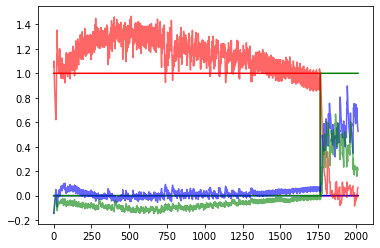

 24%|████████████████████████████████████▊                                                                                                                       | 709/3000 [2:24:23<7:17:34, 11.46s/it]

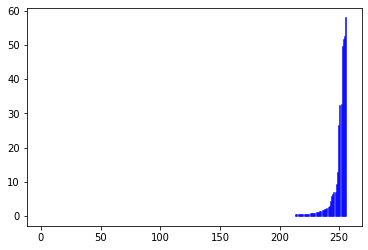

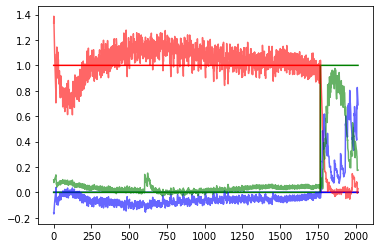

 24%|█████████████████████████████████████▏                                                                                                                      | 714/3000 [2:25:16<6:31:29, 10.28s/it]

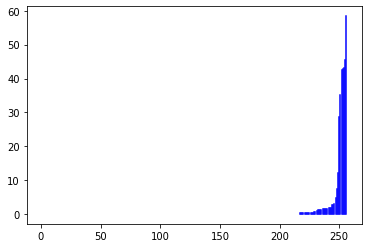

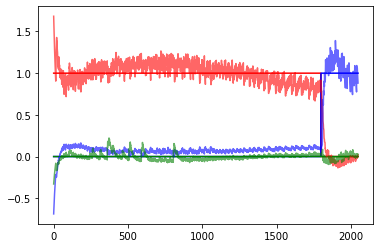

 24%|█████████████████████████████████████▍                                                                                                                      | 719/3000 [2:26:14<6:53:45, 10.88s/it]

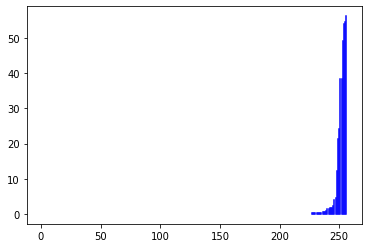

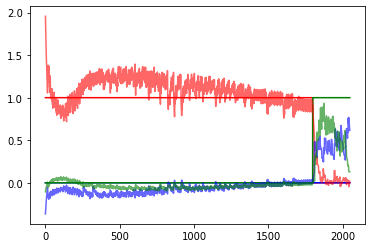

 24%|█████████████████████████████████████▋                                                                                                                      | 724/3000 [2:27:09<6:42:50, 10.62s/it]

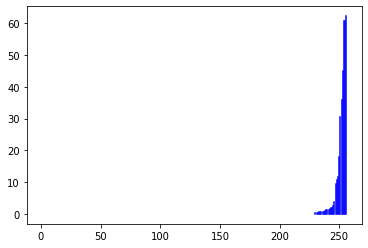

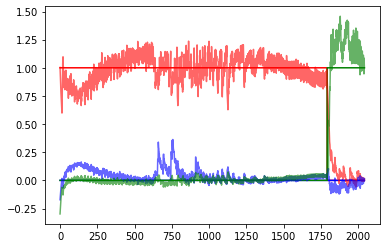

 24%|█████████████████████████████████████▉                                                                                                                      | 729/3000 [2:27:59<5:50:29,  9.26s/it]

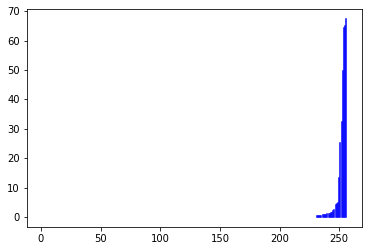

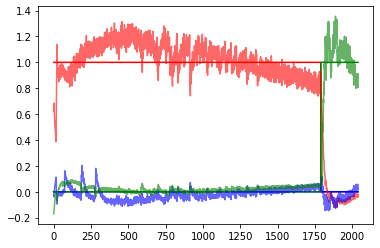

 24%|██████████████████████████████████████▏                                                                                                                     | 734/3000 [2:28:53<6:19:21, 10.04s/it]

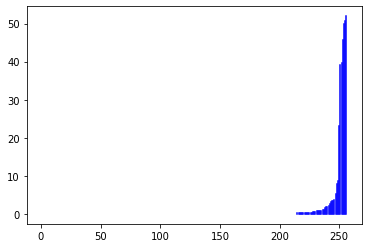

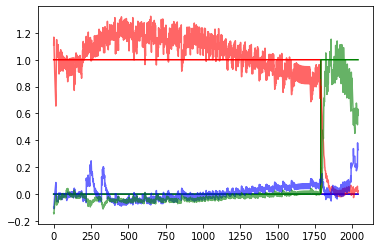

 25%|██████████████████████████████████████▍                                                                                                                     | 739/3000 [2:29:51<6:54:24, 11.00s/it]

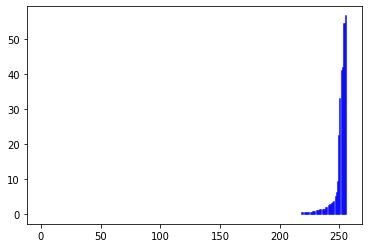

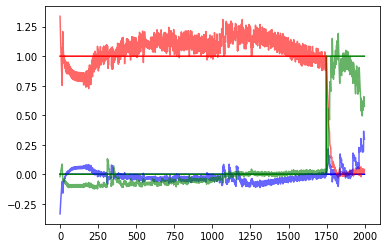

 25%|██████████████████████████████████████▋                                                                                                                     | 744/3000 [2:30:45<6:35:35, 10.52s/it]

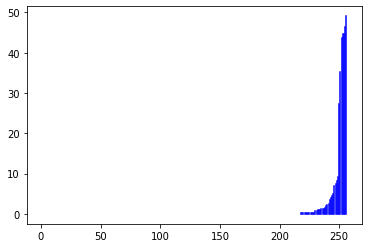

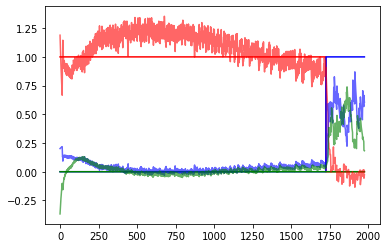

 25%|██████████████████████████████████████▉                                                                                                                     | 749/3000 [2:31:39<6:34:26, 10.51s/it]

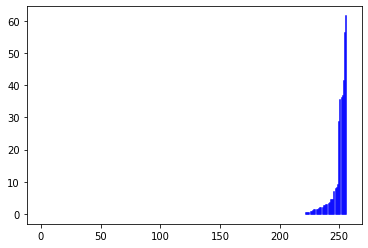

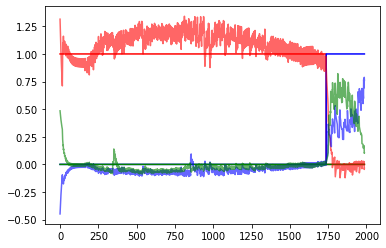

 25%|███████████████████████████████████████▏                                                                                                                    | 754/3000 [2:33:25<8:51:59, 14.21s/it]

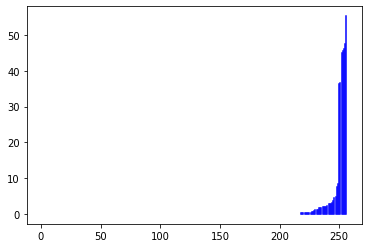

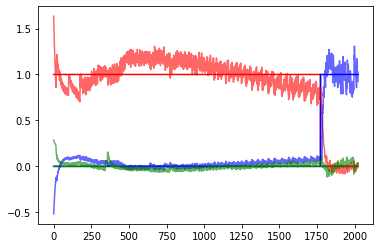

 25%|███████████████████████████████████████▍                                                                                                                    | 759/3000 [2:34:21<7:02:53, 11.32s/it]

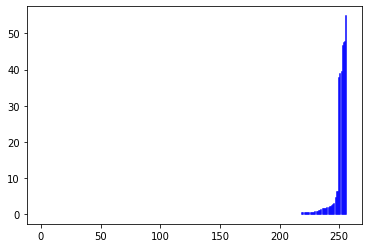

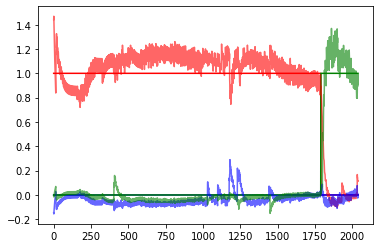

 25%|███████████████████████████████████████▋                                                                                                                    | 764/3000 [2:35:14<6:28:19, 10.42s/it]

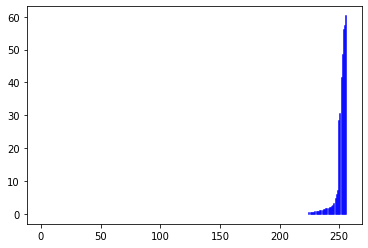

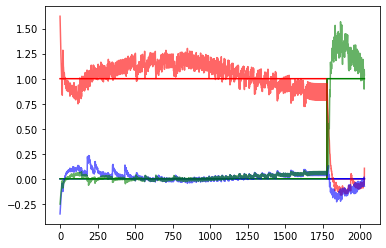

 26%|███████████████████████████████████████▉                                                                                                                    | 769/3000 [2:36:11<6:36:58, 10.68s/it]

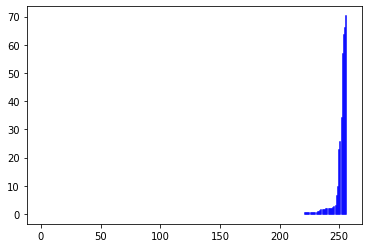

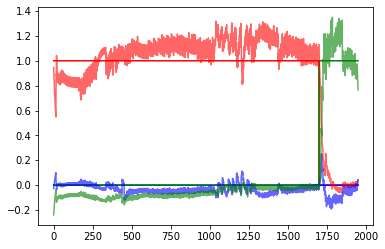

 26%|████████████████████████████████████████▏                                                                                                                   | 774/3000 [2:37:08<6:43:51, 10.89s/it]

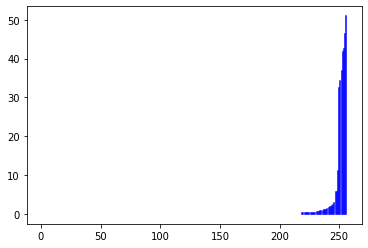

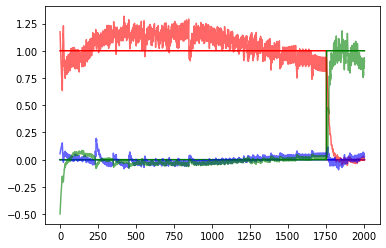

 26%|████████████████████████████████████████▌                                                                                                                   | 779/3000 [2:38:05<6:31:17, 10.57s/it]

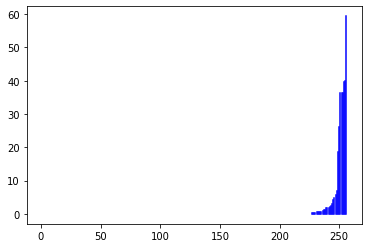

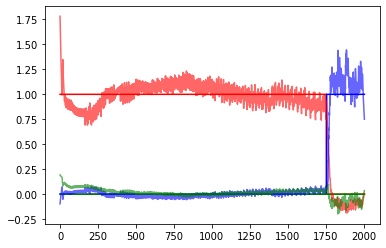

 26%|████████████████████████████████████████▊                                                                                                                   | 784/3000 [2:39:01<6:26:19, 10.46s/it]

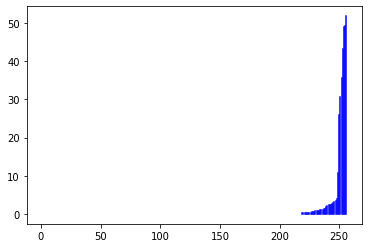

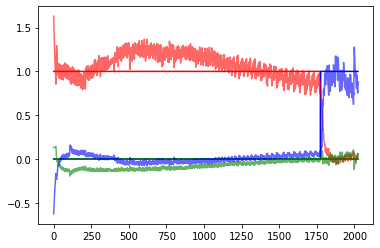

 26%|█████████████████████████████████████████                                                                                                                   | 789/3000 [2:39:59<6:54:21, 11.24s/it]

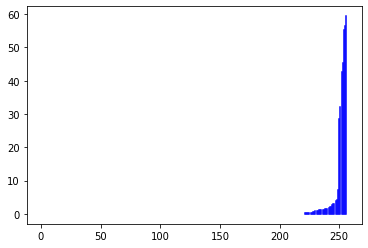

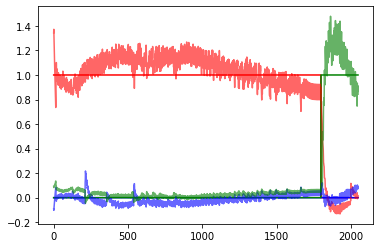

 26%|█████████████████████████████████████████▎                                                                                                                  | 794/3000 [2:40:59<7:03:21, 11.51s/it]

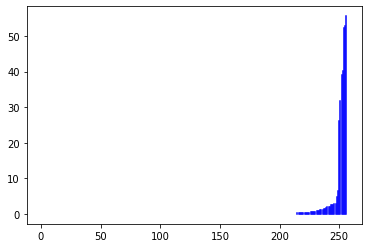

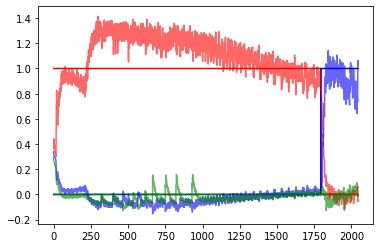

 27%|█████████████████████████████████████████▌                                                                                                                  | 799/3000 [2:41:57<6:53:50, 11.28s/it]

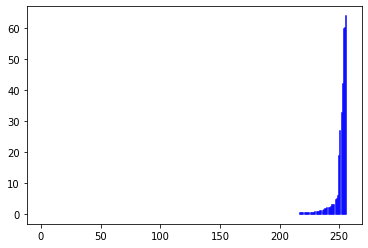

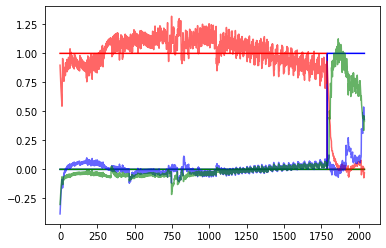

 27%|█████████████████████████████████████████▊                                                                                                                  | 804/3000 [2:43:45<8:54:33, 14.61s/it]

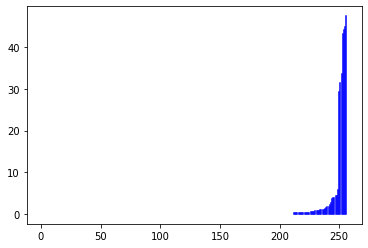

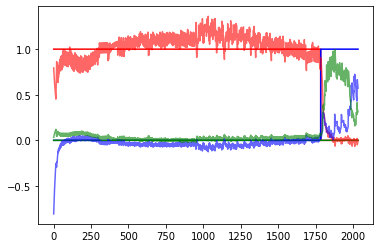

 27%|██████████████████████████████████████████                                                                                                                  | 809/3000 [2:44:43<7:11:17, 11.81s/it]

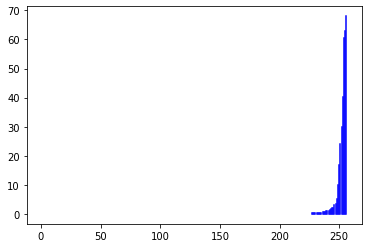

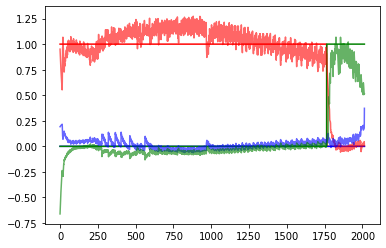

 27%|██████████████████████████████████████████▎                                                                                                                 | 814/3000 [2:45:39<6:30:57, 10.73s/it]

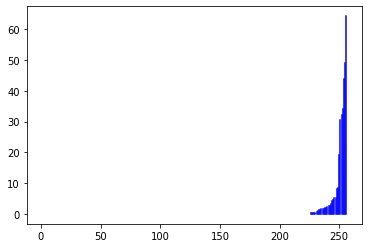

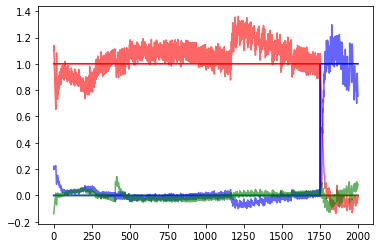

 27%|██████████████████████████████████████████▌                                                                                                                 | 819/3000 [2:46:34<6:17:34, 10.39s/it]

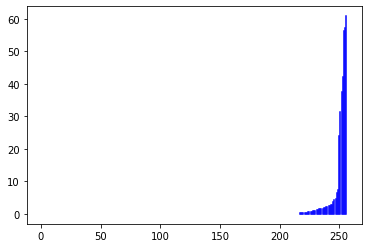

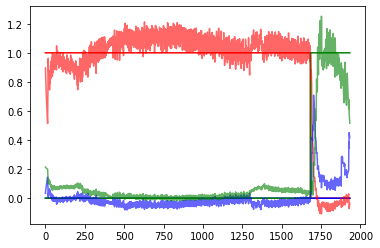

 27%|██████████████████████████████████████████▊                                                                                                                 | 824/3000 [2:47:32<6:45:57, 11.19s/it]

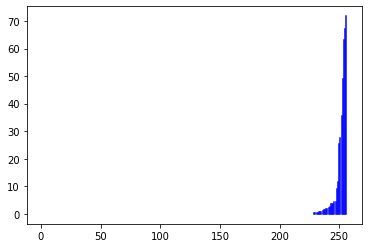

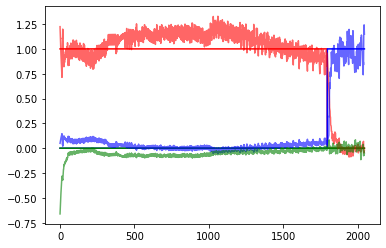

 28%|███████████████████████████████████████████                                                                                                                 | 829/3000 [2:48:29<6:39:02, 11.03s/it]

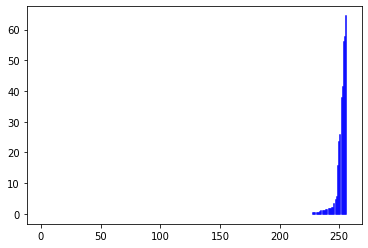

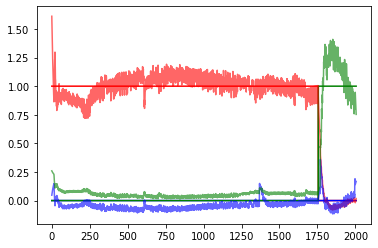

 28%|███████████████████████████████████████████▎                                                                                                                | 834/3000 [2:49:25<6:26:19, 10.70s/it]

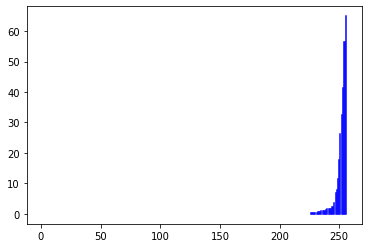

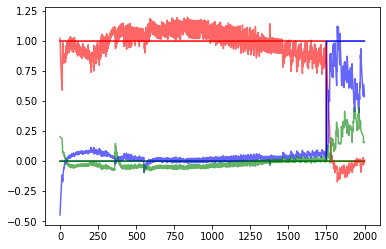

 28%|███████████████████████████████████████████▋                                                                                                                | 839/3000 [2:50:22<6:34:53, 10.96s/it]

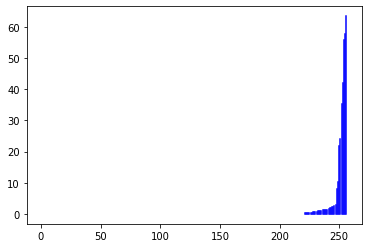

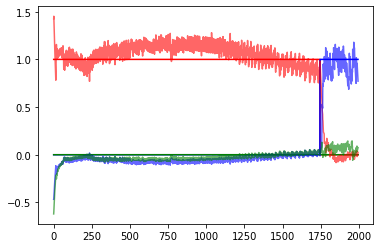

 28%|███████████████████████████████████████████▉                                                                                                                | 844/3000 [2:51:20<6:38:27, 11.09s/it]

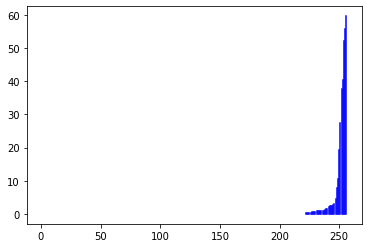

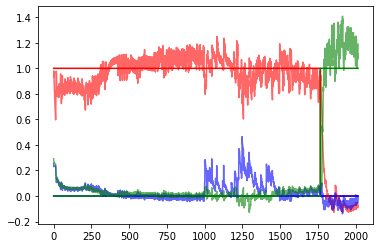

 28%|████████████████████████████████████████████▏                                                                                                               | 849/3000 [2:52:17<6:32:15, 10.94s/it]

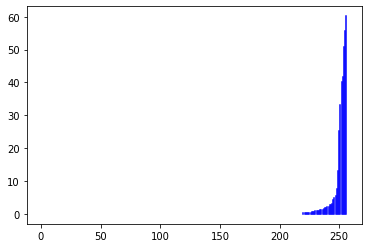

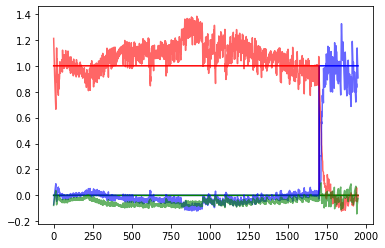

 28%|████████████████████████████████████████████▍                                                                                                               | 854/3000 [2:54:02<8:40:37, 14.56s/it]

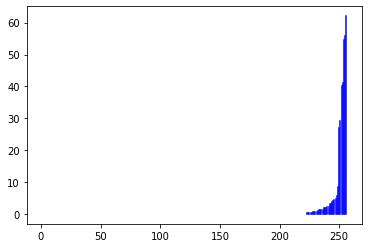

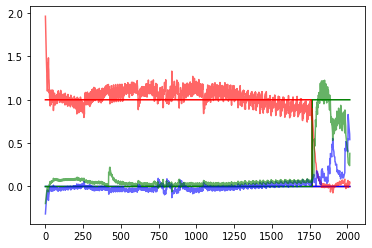

 29%|████████████████████████████████████████████▋                                                                                                               | 859/3000 [2:54:57<6:22:56, 10.73s/it]

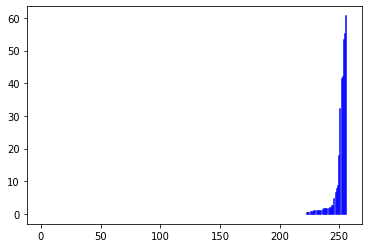

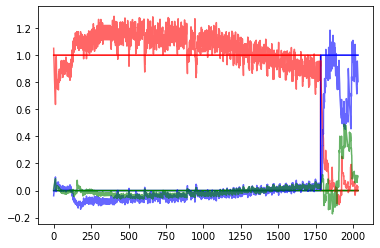

 29%|████████████████████████████████████████████▉                                                                                                               | 864/3000 [2:55:54<6:29:54, 10.95s/it]

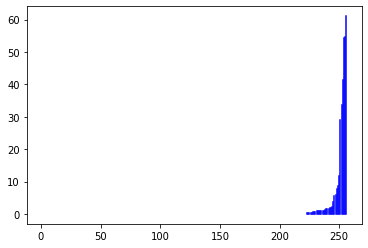

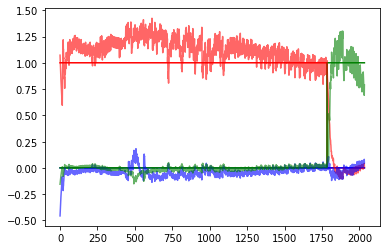

 29%|█████████████████████████████████████████████▏                                                                                                              | 869/3000 [2:56:52<6:31:43, 11.03s/it]

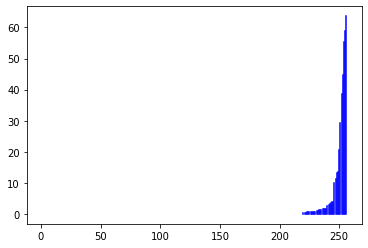

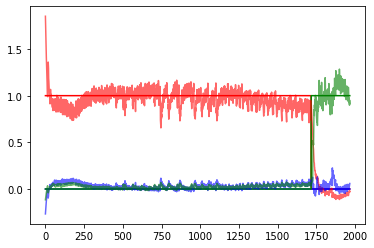

 29%|█████████████████████████████████████████████▍                                                                                                              | 874/3000 [2:57:47<6:14:55, 10.58s/it]

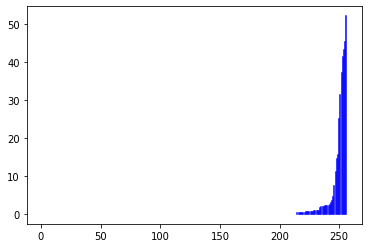

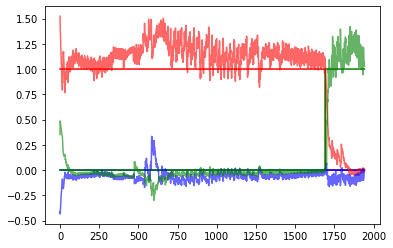

 29%|█████████████████████████████████████████████▋                                                                                                              | 879/3000 [2:58:42<6:12:24, 10.54s/it]

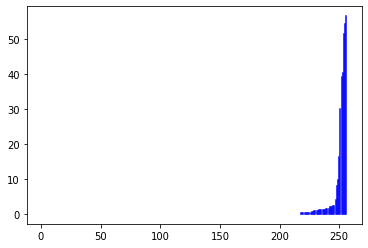

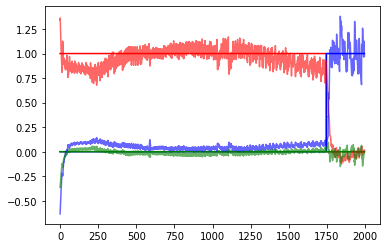

 29%|█████████████████████████████████████████████▉                                                                                                              | 884/3000 [2:59:37<5:56:40, 10.11s/it]

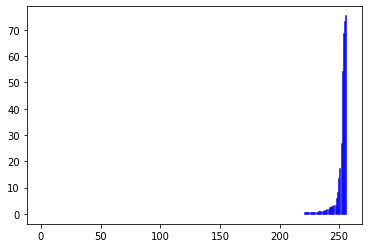

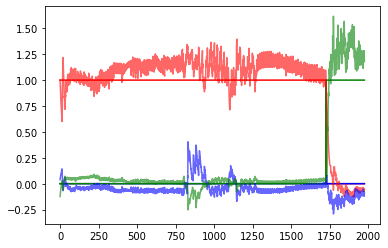

 30%|██████████████████████████████████████████████▏                                                                                                             | 889/3000 [3:00:35<6:23:53, 10.91s/it]

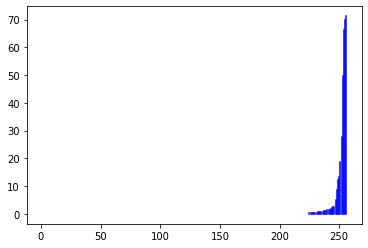

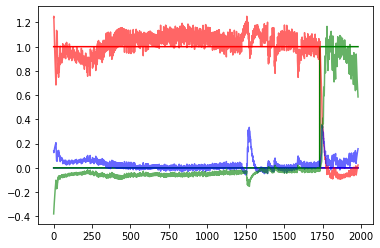

 30%|██████████████████████████████████████████████▍                                                                                                             | 894/3000 [3:01:32<6:29:52, 11.11s/it]

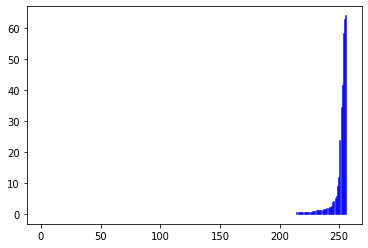

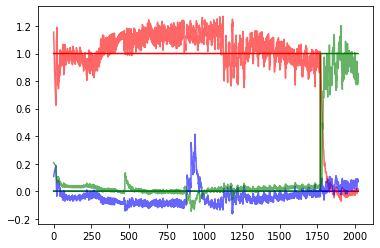

 30%|██████████████████████████████████████████████▋                                                                                                             | 899/3000 [3:02:28<6:23:18, 10.95s/it]

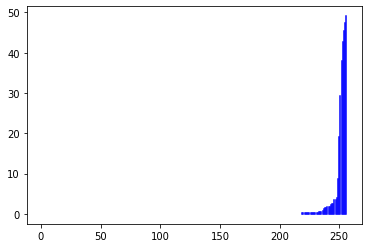

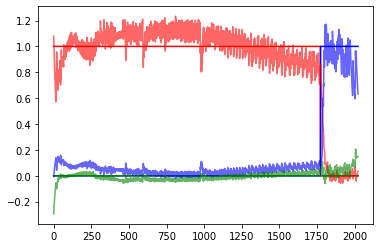

 30%|███████████████████████████████████████████████                                                                                                             | 904/3000 [3:04:13<8:24:16, 14.44s/it]

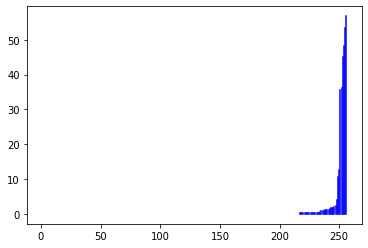

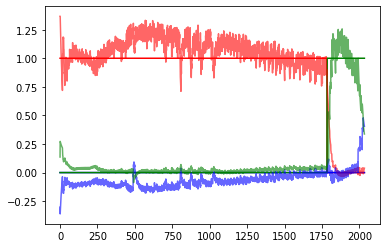

 30%|███████████████████████████████████████████████▎                                                                                                            | 909/3000 [3:05:08<6:31:52, 11.24s/it]

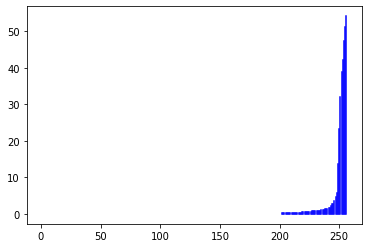

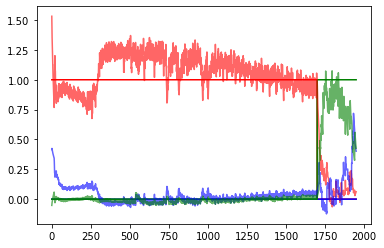

 30%|███████████████████████████████████████████████▌                                                                                                            | 914/3000 [3:06:04<6:09:59, 10.64s/it]

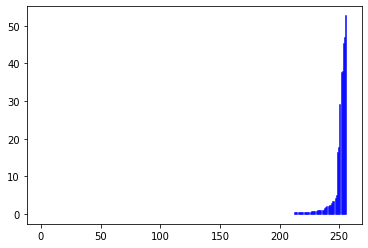

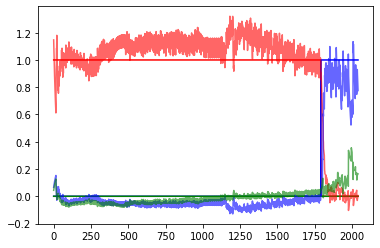

 31%|███████████████████████████████████████████████▊                                                                                                            | 919/3000 [3:07:00<6:14:04, 10.79s/it]

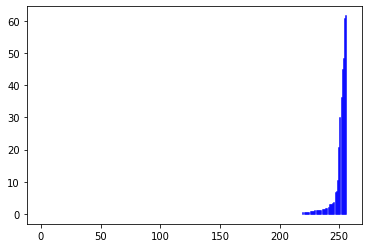

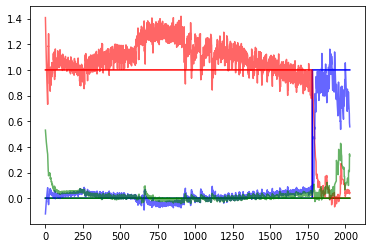

 31%|████████████████████████████████████████████████                                                                                                            | 924/3000 [3:07:57<6:17:36, 10.91s/it]

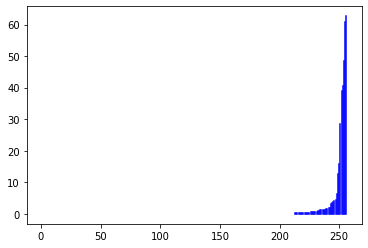

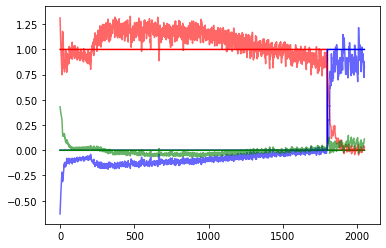

 31%|████████████████████████████████████████████████▎                                                                                                           | 929/3000 [3:08:51<6:02:16, 10.50s/it]

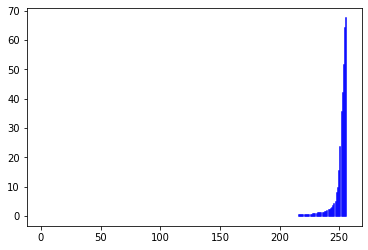

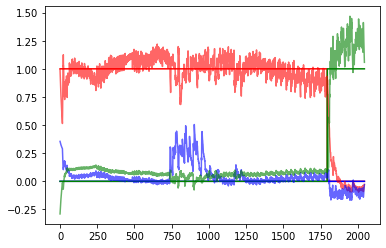

 31%|████████████████████████████████████████████████▌                                                                                                           | 934/3000 [3:09:49<6:14:40, 10.88s/it]

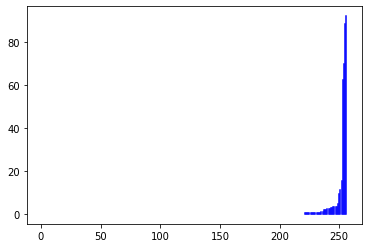

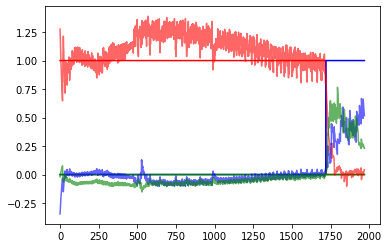

 31%|████████████████████████████████████████████████▊                                                                                                           | 939/3000 [3:10:47<6:16:30, 10.96s/it]

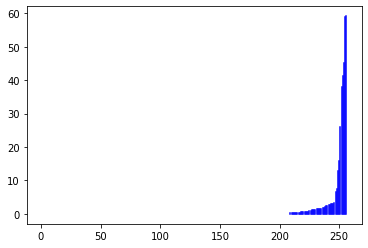

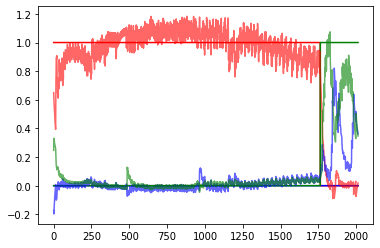

 31%|█████████████████████████████████████████████████                                                                                                           | 944/3000 [3:11:45<6:23:15, 11.18s/it]

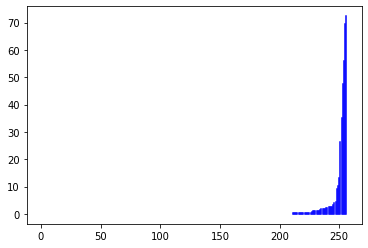

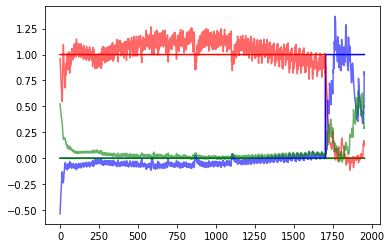

 32%|█████████████████████████████████████████████████▎                                                                                                          | 949/3000 [3:12:42<6:19:22, 11.10s/it]

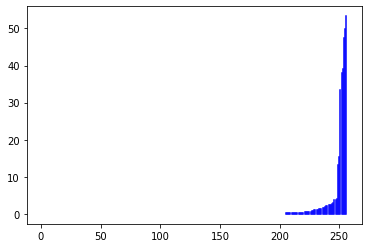

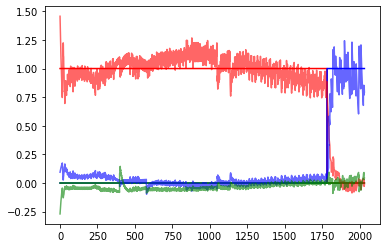

 32%|█████████████████████████████████████████████████▌                                                                                                          | 954/3000 [3:14:25<7:59:07, 14.05s/it]

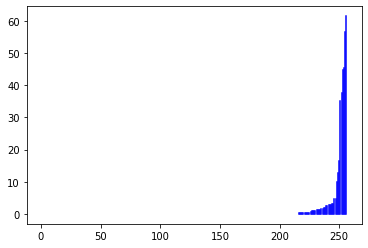

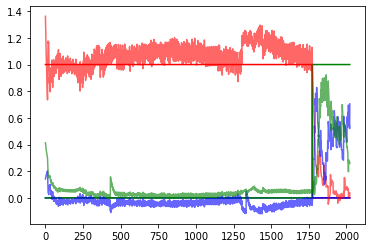

 32%|█████████████████████████████████████████████████▊                                                                                                          | 959/3000 [3:15:23<6:32:09, 11.53s/it]

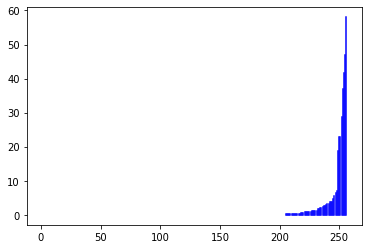

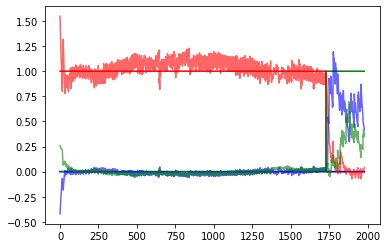

 32%|██████████████████████████████████████████████████▏                                                                                                         | 964/3000 [3:16:20<6:14:46, 11.04s/it]

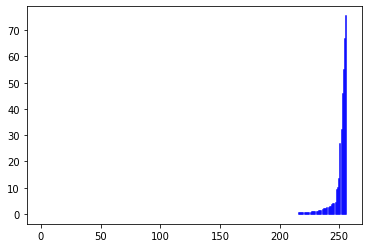

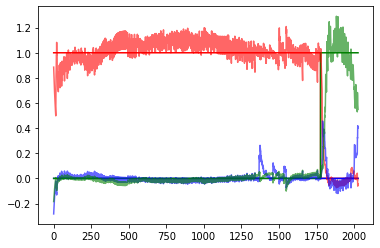

 32%|██████████████████████████████████████████████████▍                                                                                                         | 969/3000 [3:17:16<5:57:10, 10.55s/it]

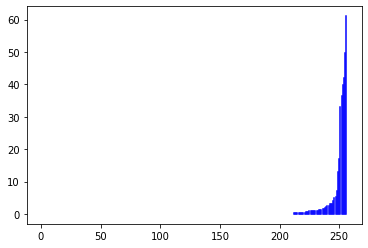

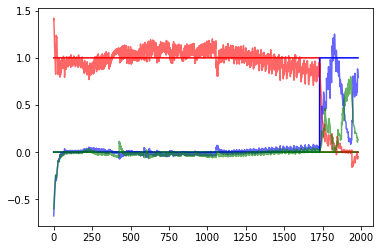

 32%|██████████████████████████████████████████████████▋                                                                                                         | 974/3000 [3:18:12<6:04:35, 10.80s/it]

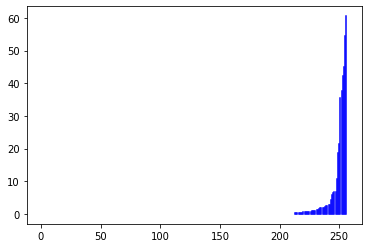

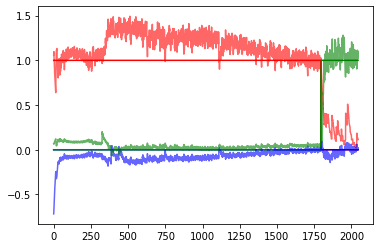

 33%|██████████████████████████████████████████████████▉                                                                                                         | 979/3000 [3:19:11<6:15:42, 11.15s/it]

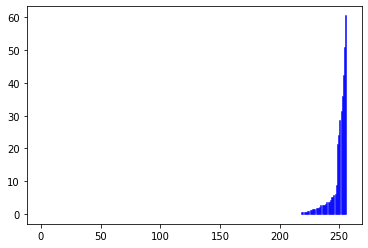

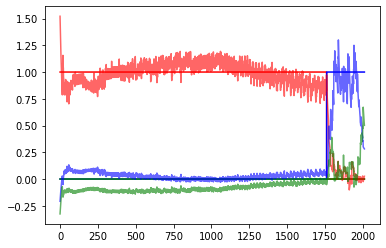

 33%|███████████████████████████████████████████████████▏                                                                                                        | 984/3000 [3:20:07<5:59:50, 10.71s/it]

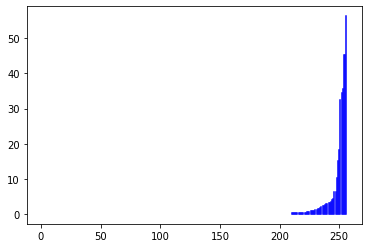

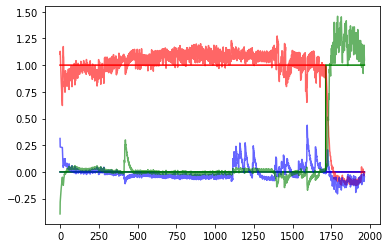

 33%|███████████████████████████████████████████████████▍                                                                                                        | 989/3000 [3:21:02<5:41:57, 10.20s/it]

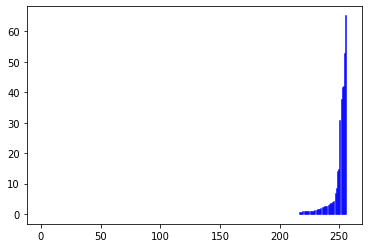

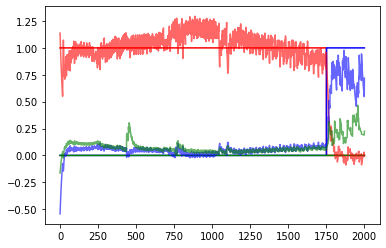

 33%|███████████████████████████████████████████████████▋                                                                                                        | 994/3000 [3:21:58<5:53:26, 10.57s/it]

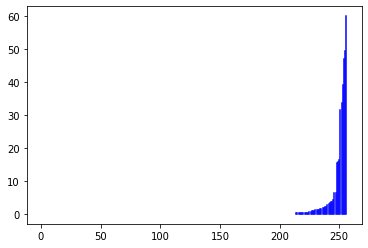

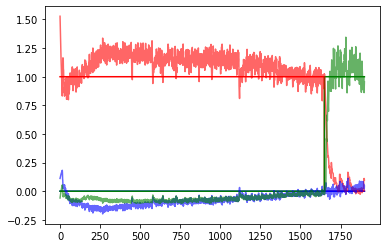

 33%|███████████████████████████████████████████████████▉                                                                                                        | 999/3000 [3:22:57<6:11:39, 11.14s/it]

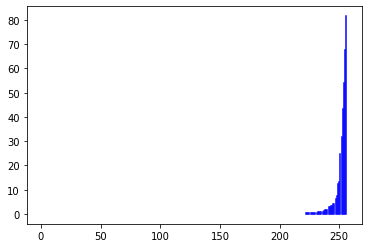

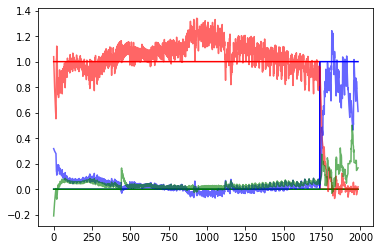

 33%|███████████████████████████████████████████████████▊                                                                                                       | 1004/3000 [3:24:43<8:02:38, 14.51s/it]

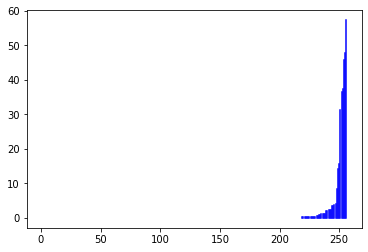

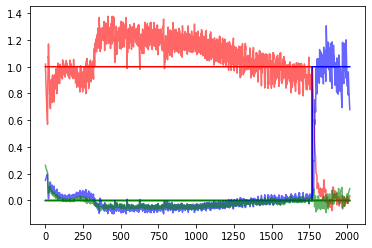

 34%|████████████████████████████████████████████████████▏                                                                                                      | 1009/3000 [3:25:40<6:23:29, 11.56s/it]

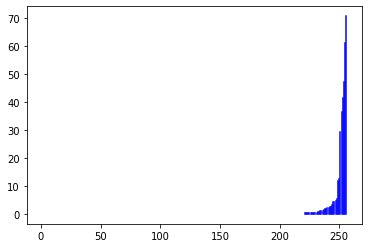

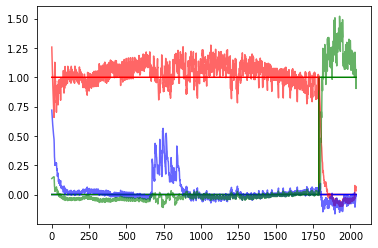

 34%|████████████████████████████████████████████████████▍                                                                                                      | 1014/3000 [3:26:32<5:36:00, 10.15s/it]

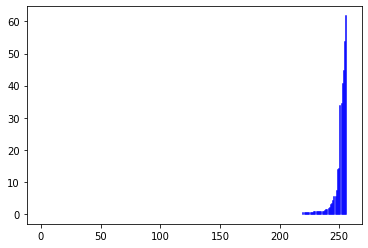

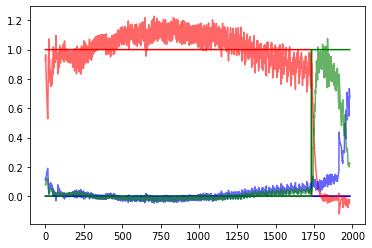

 34%|████████████████████████████████████████████████████▋                                                                                                      | 1019/3000 [3:27:29<5:39:51, 10.29s/it]

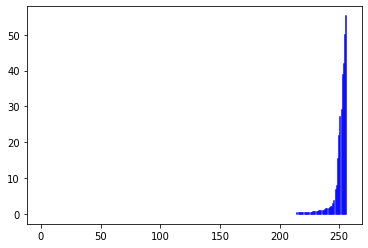

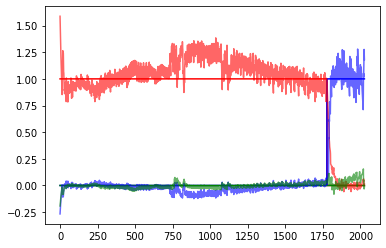

 34%|████████████████████████████████████████████████████▉                                                                                                      | 1024/3000 [3:28:25<5:59:21, 10.91s/it]

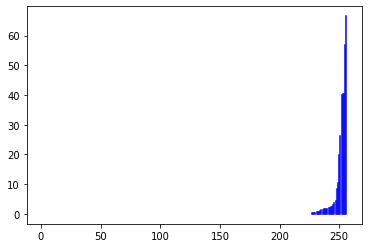

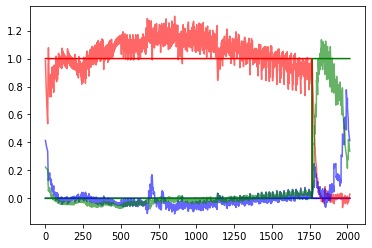

 34%|█████████████████████████████████████████████████████▏                                                                                                     | 1029/3000 [3:29:21<5:49:13, 10.63s/it]

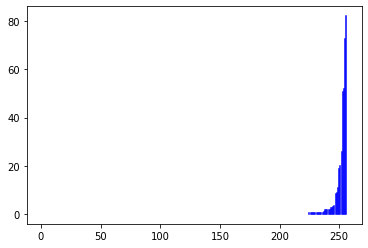

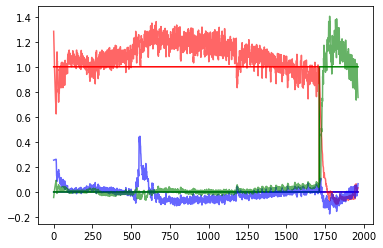

 34%|█████████████████████████████████████████████████████▍                                                                                                     | 1034/3000 [3:30:17<5:45:06, 10.53s/it]

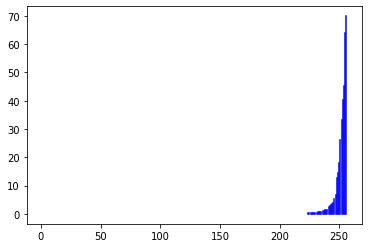

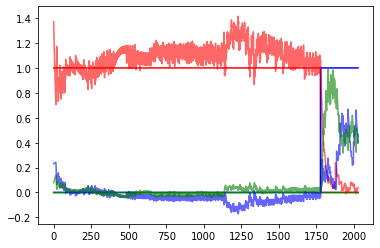

 35%|█████████████████████████████████████████████████████▋                                                                                                     | 1039/3000 [3:31:13<6:01:59, 11.08s/it]

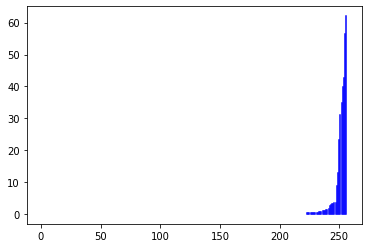

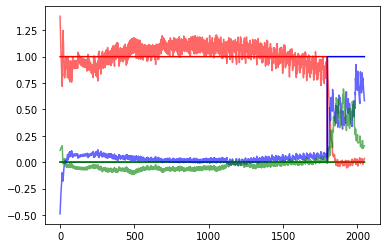

 35%|█████████████████████████████████████████████████████▉                                                                                                     | 1044/3000 [3:32:09<5:56:01, 10.92s/it]

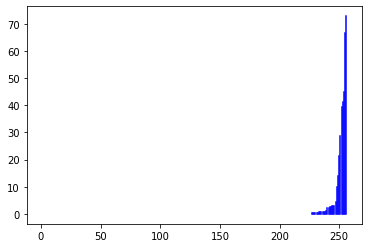

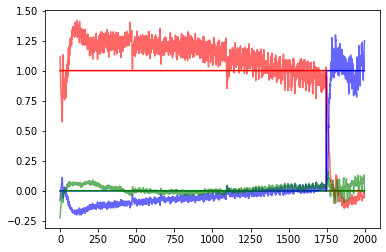

 35%|██████████████████████████████████████████████████████▏                                                                                                    | 1049/3000 [3:33:06<5:53:31, 10.87s/it]

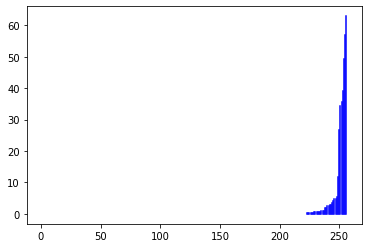

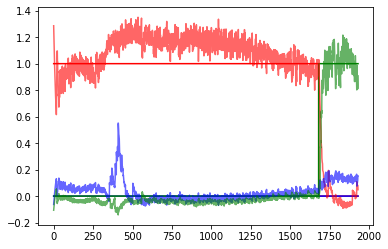

 35%|██████████████████████████████████████████████████████▍                                                                                                    | 1054/3000 [3:34:52<7:40:42, 14.20s/it]

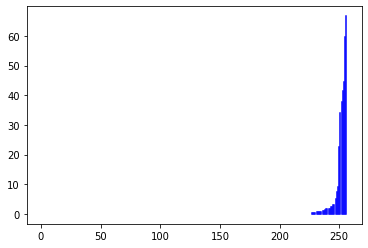

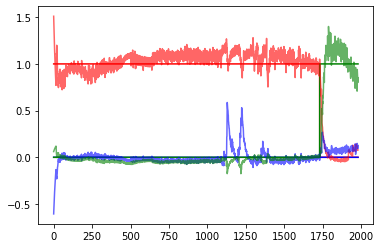

 35%|██████████████████████████████████████████████████████▋                                                                                                    | 1059/3000 [3:35:50<6:19:28, 11.73s/it]

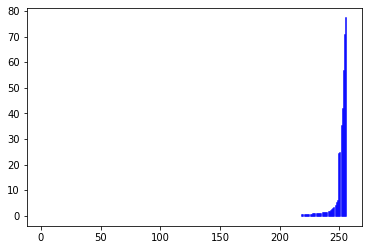

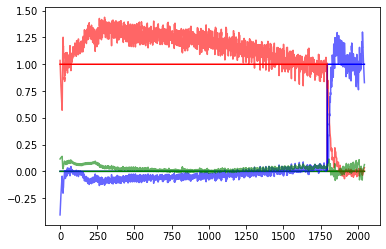

 35%|██████████████████████████████████████████████████████▉                                                                                                    | 1064/3000 [3:36:47<6:00:21, 11.17s/it]

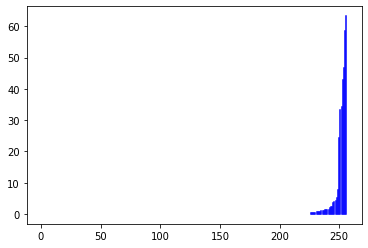

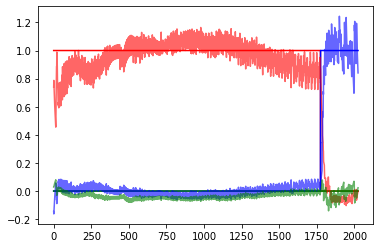

 36%|███████████████████████████████████████████████████████▏                                                                                                   | 1069/3000 [3:37:46<6:00:40, 11.21s/it]

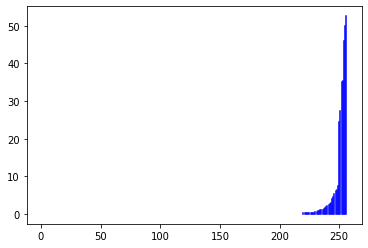

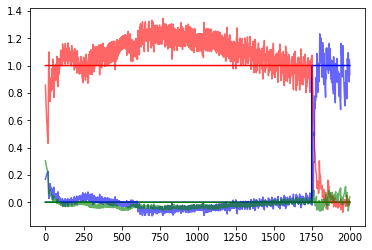

 36%|███████████████████████████████████████████████████████▍                                                                                                   | 1074/3000 [3:38:42<5:49:41, 10.89s/it]

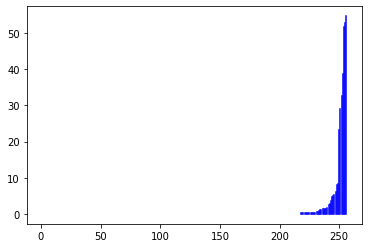

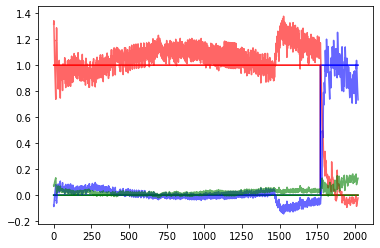

 36%|███████████████████████████████████████████████████████▋                                                                                                   | 1079/3000 [3:39:40<5:48:20, 10.88s/it]

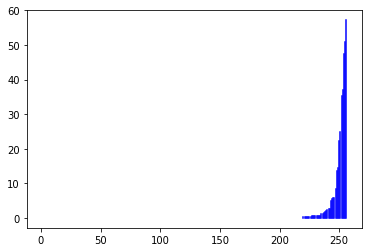

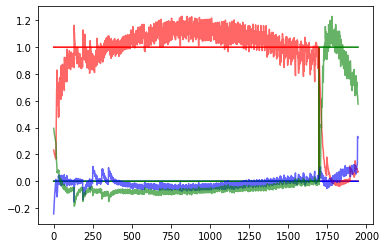

 36%|████████████████████████████████████████████████████████                                                                                                   | 1084/3000 [3:40:34<5:38:07, 10.59s/it]

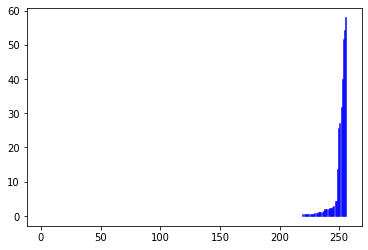

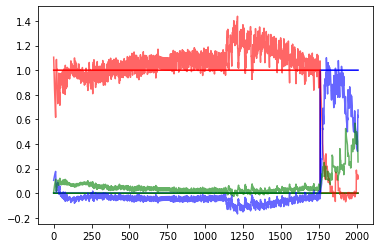

 36%|████████████████████████████████████████████████████████▎                                                                                                  | 1089/3000 [3:41:33<5:56:36, 11.20s/it]

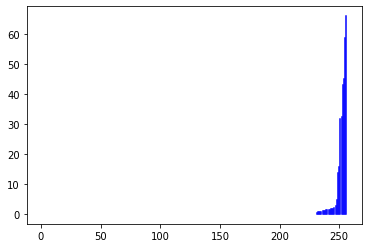

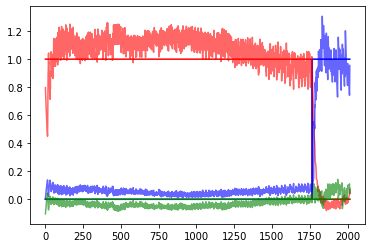

 36%|████████████████████████████████████████████████████████▌                                                                                                  | 1094/3000 [3:42:29<5:37:17, 10.62s/it]

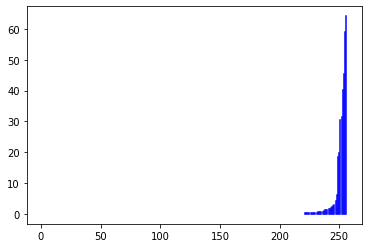

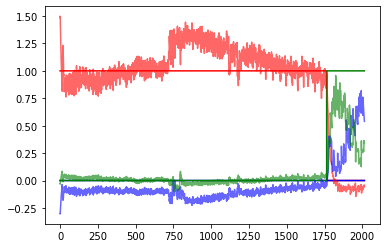

 37%|████████████████████████████████████████████████████████▊                                                                                                  | 1099/3000 [3:43:27<5:47:09, 10.96s/it]

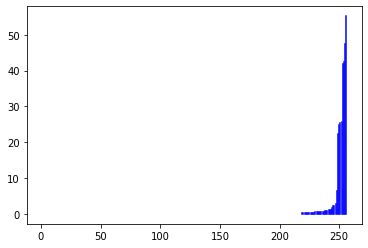

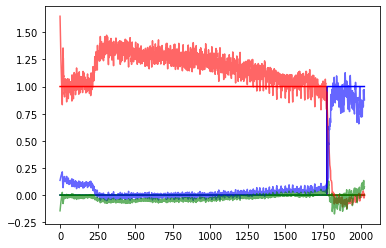

 37%|█████████████████████████████████████████████████████████                                                                                                  | 1104/3000 [3:45:13<7:38:08, 14.50s/it]

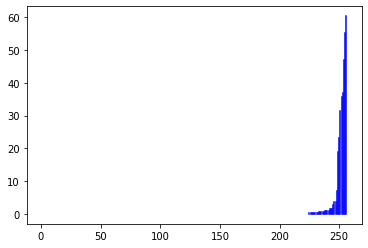

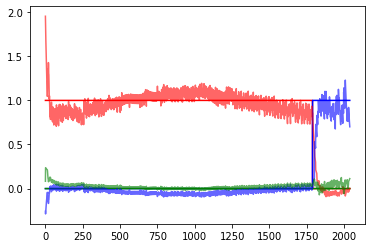

 37%|█████████████████████████████████████████████████████████▎                                                                                                 | 1109/3000 [3:46:09<5:46:56, 11.01s/it]

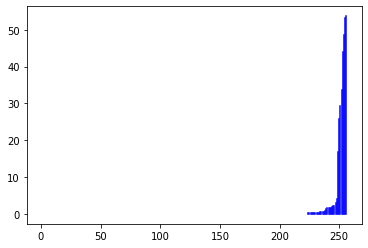

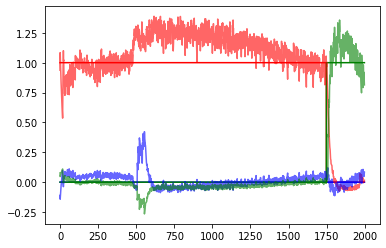

 37%|█████████████████████████████████████████████████████████▌                                                                                                 | 1114/3000 [3:47:05<5:41:53, 10.88s/it]

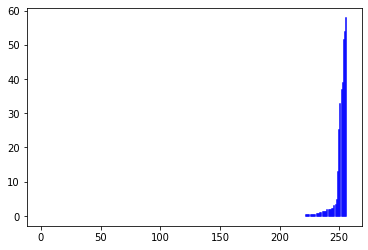

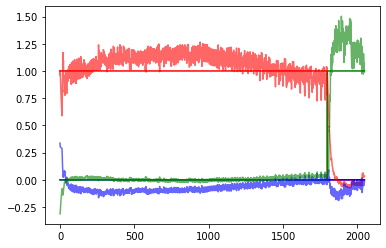

 37%|█████████████████████████████████████████████████████████▊                                                                                                 | 1119/3000 [3:48:02<5:43:41, 10.96s/it]

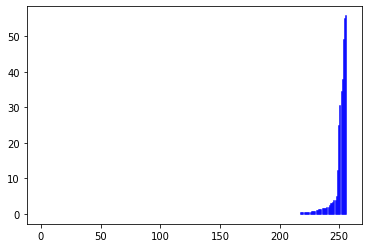

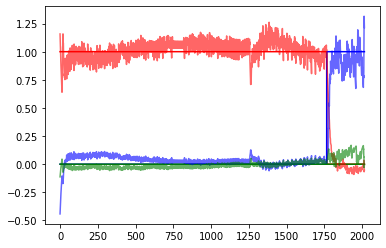

 37%|██████████████████████████████████████████████████████████                                                                                                 | 1124/3000 [3:48:58<5:41:58, 10.94s/it]

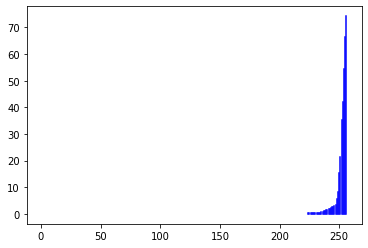

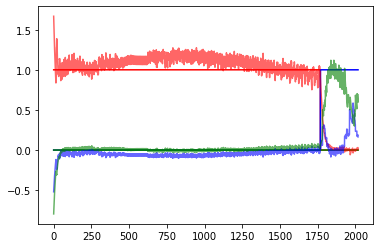

 38%|██████████████████████████████████████████████████████████▎                                                                                                | 1129/3000 [3:49:53<5:36:56, 10.81s/it]

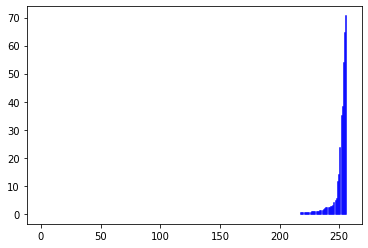

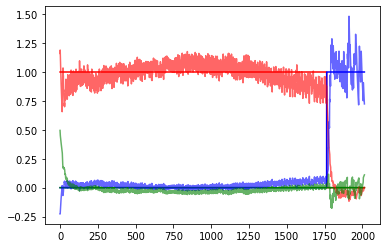

 38%|██████████████████████████████████████████████████████████▌                                                                                                | 1134/3000 [3:50:54<5:57:32, 11.50s/it]

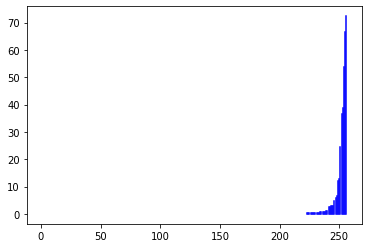

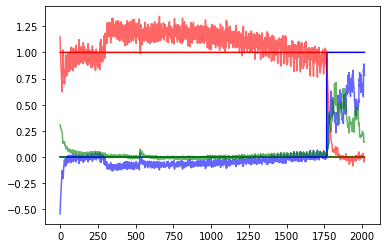

 38%|██████████████████████████████████████████████████████████▊                                                                                                | 1139/3000 [3:51:51<5:47:04, 11.19s/it]

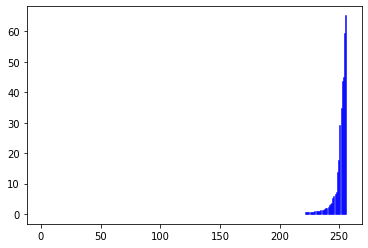

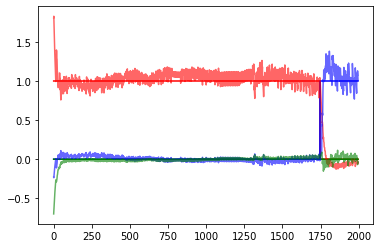

 38%|███████████████████████████████████████████████████████████                                                                                                | 1144/3000 [3:52:47<5:36:05, 10.86s/it]

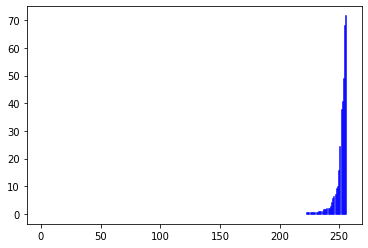

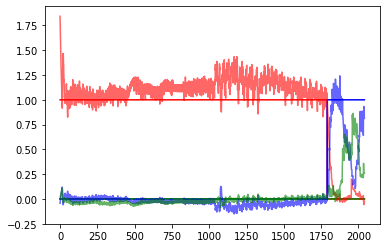

 38%|███████████████████████████████████████████████████████████▎                                                                                               | 1149/3000 [3:53:42<5:24:53, 10.53s/it]

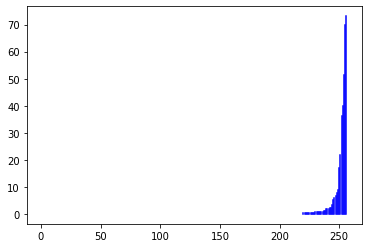

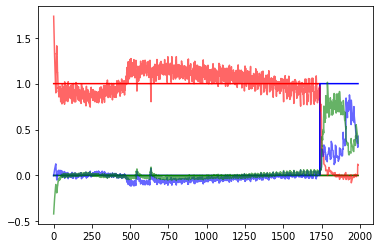

 38%|███████████████████████████████████████████████████████████▌                                                                                               | 1154/3000 [3:55:25<7:08:49, 13.94s/it]

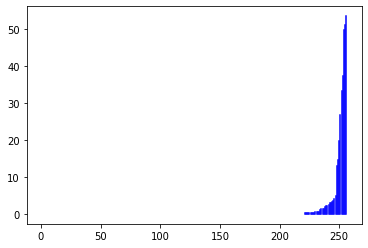

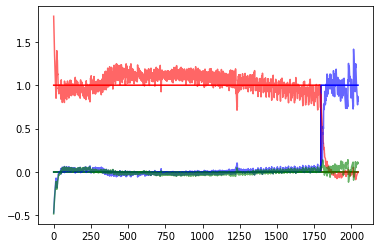

 39%|███████████████████████████████████████████████████████████▉                                                                                               | 1159/3000 [3:56:23<5:51:49, 11.47s/it]

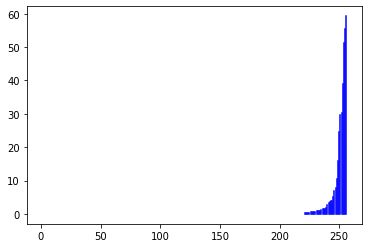

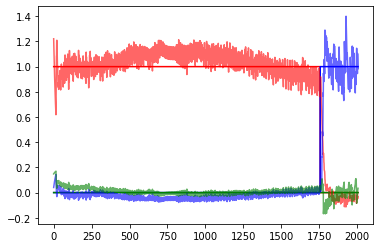

 39%|████████████████████████████████████████████████████████████▏                                                                                              | 1164/3000 [3:57:23<5:50:45, 11.46s/it]

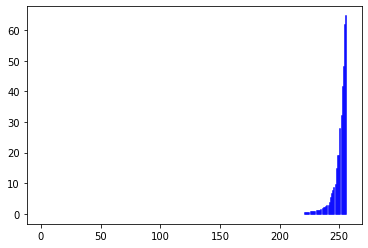

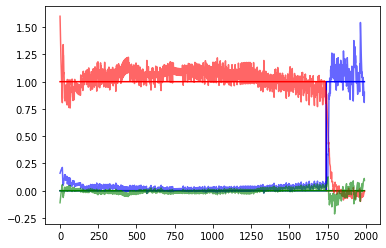

 39%|████████████████████████████████████████████████████████████▍                                                                                              | 1169/3000 [3:58:21<5:45:30, 11.32s/it]

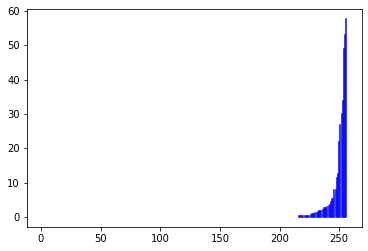

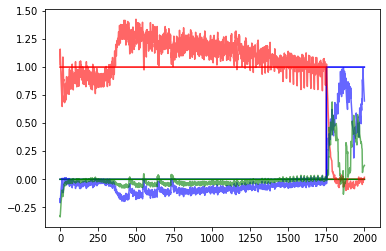

 39%|████████████████████████████████████████████████████████████▋                                                                                              | 1174/3000 [3:59:18<5:38:23, 11.12s/it]

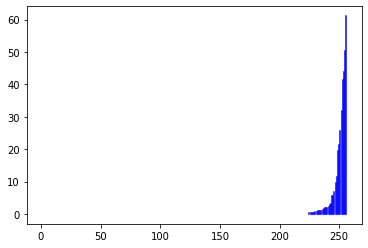

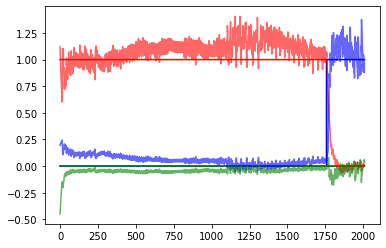

 39%|████████████████████████████████████████████████████████████▉                                                                                              | 1179/3000 [4:00:16<5:37:24, 11.12s/it]

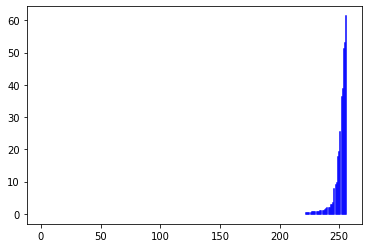

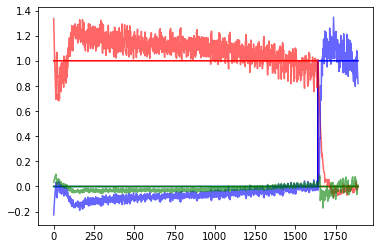

 39%|█████████████████████████████████████████████████████████████▏                                                                                             | 1184/3000 [4:01:11<5:32:18, 10.98s/it]

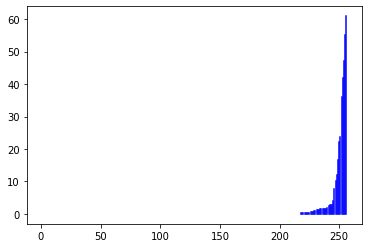

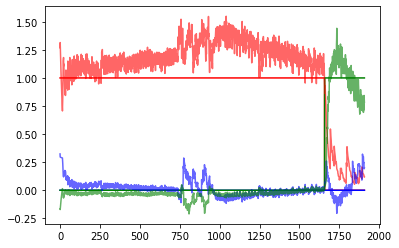

 40%|█████████████████████████████████████████████████████████████▍                                                                                             | 1189/3000 [4:02:04<5:12:04, 10.34s/it]

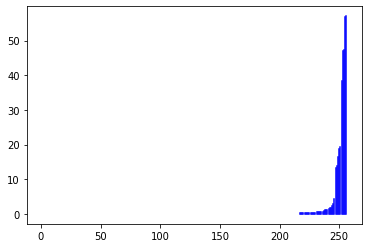

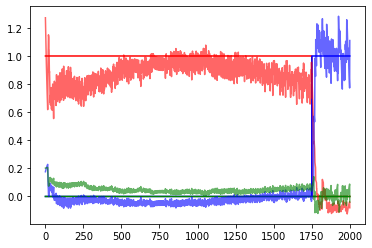

 40%|█████████████████████████████████████████████████████████████▋                                                                                             | 1194/3000 [4:03:01<5:26:13, 10.84s/it]

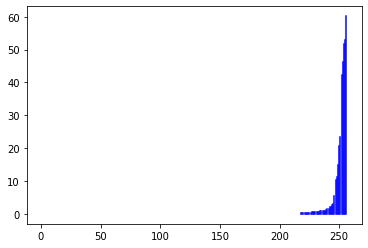

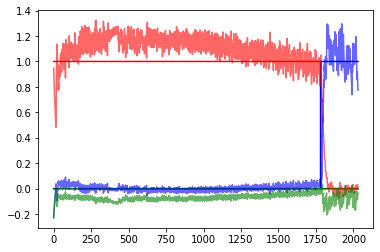

 40%|█████████████████████████████████████████████████████████████▉                                                                                             | 1199/3000 [4:03:57<5:30:03, 11.00s/it]

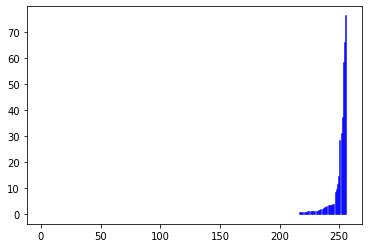

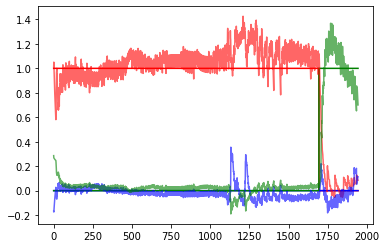

 40%|██████████████████████████████████████████████████████████████▏                                                                                            | 1204/3000 [4:05:43<7:10:09, 14.37s/it]

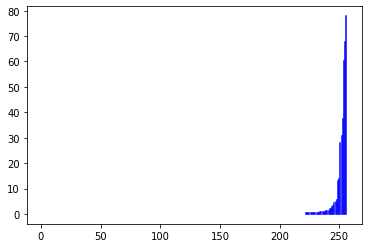

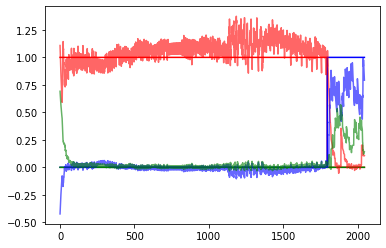

 40%|██████████████████████████████████████████████████████████████▍                                                                                            | 1209/3000 [4:06:38<5:34:24, 11.20s/it]

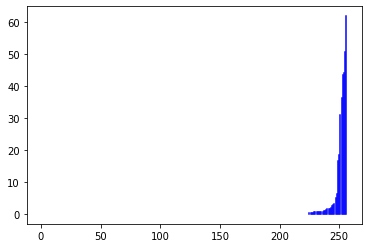

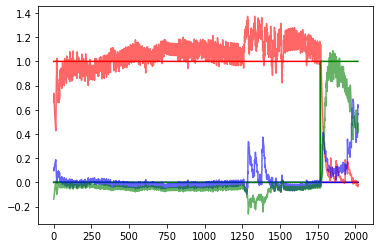

 40%|██████████████████████████████████████████████████████████████▋                                                                                            | 1214/3000 [4:07:34<5:24:34, 10.90s/it]

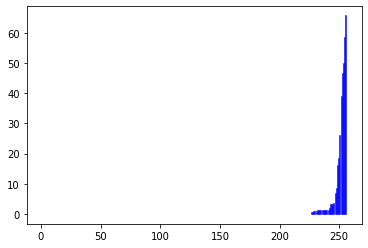

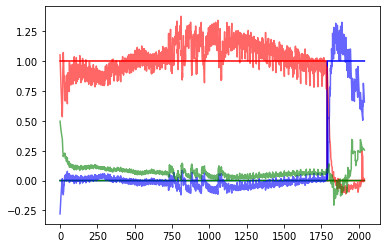

 41%|██████████████████████████████████████████████████████████████▉                                                                                            | 1219/3000 [4:08:27<4:53:22,  9.88s/it]

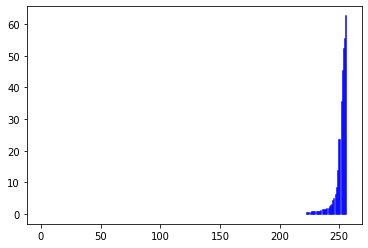

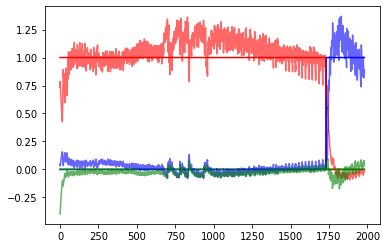

 41%|███████████████████████████████████████████████████████████████▏                                                                                           | 1224/3000 [4:09:23<5:13:27, 10.59s/it]

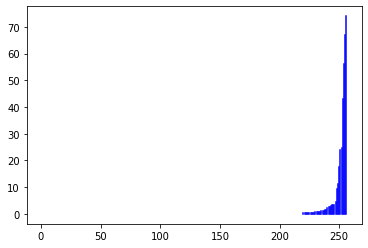

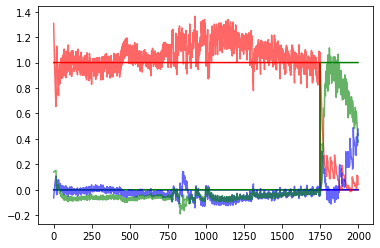

 41%|███████████████████████████████████████████████████████████████▍                                                                                           | 1229/3000 [4:10:20<5:20:31, 10.86s/it]

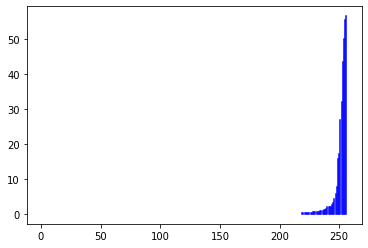

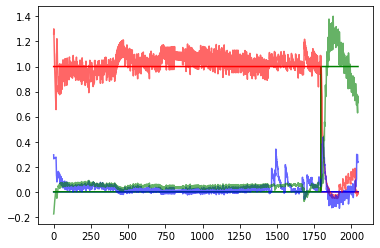

 41%|███████████████████████████████████████████████████████████████▊                                                                                           | 1234/3000 [4:11:13<5:05:20, 10.37s/it]

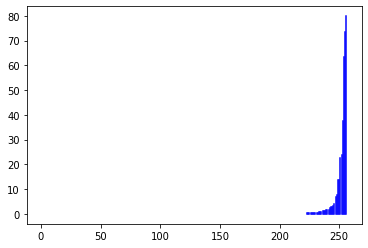

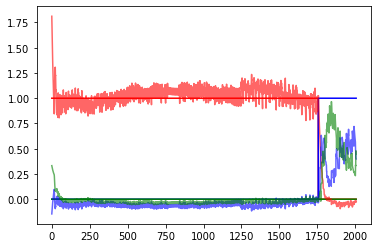

 41%|████████████████████████████████████████████████████████████████                                                                                           | 1239/3000 [4:12:12<5:23:13, 11.01s/it]

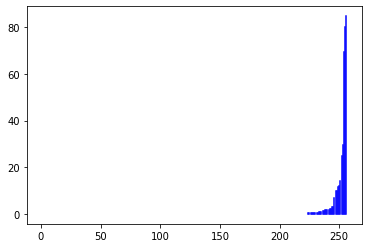

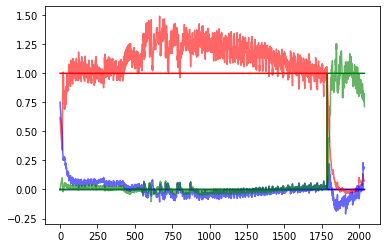

 41%|████████████████████████████████████████████████████████████████▎                                                                                          | 1244/3000 [4:13:10<5:20:16, 10.94s/it]

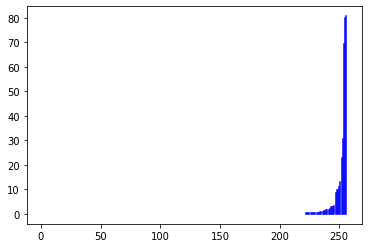

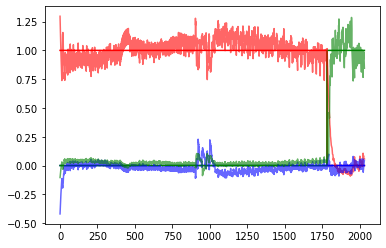

 42%|████████████████████████████████████████████████████████████████▌                                                                                          | 1249/3000 [4:14:06<5:12:35, 10.71s/it]

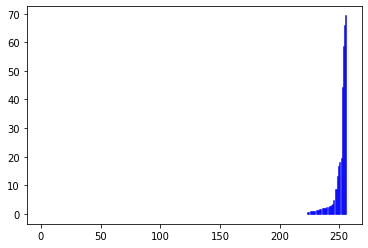

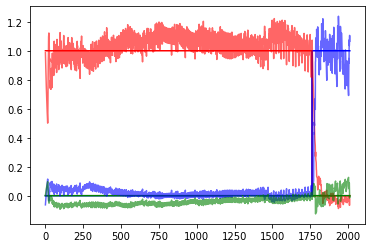

 42%|████████████████████████████████████████████████████████████████▊                                                                                          | 1254/3000 [4:15:51<6:55:22, 14.27s/it]

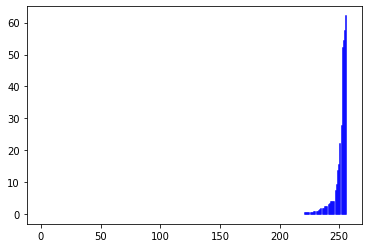

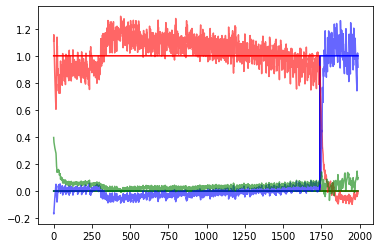

 42%|█████████████████████████████████████████████████████████████████                                                                                          | 1259/3000 [4:16:47<5:25:54, 11.23s/it]

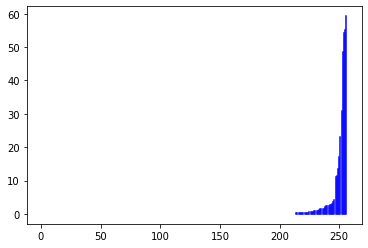

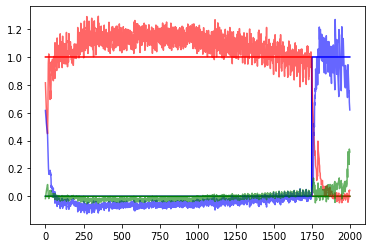

 42%|█████████████████████████████████████████████████████████████████▎                                                                                         | 1264/3000 [4:17:42<5:16:59, 10.96s/it]

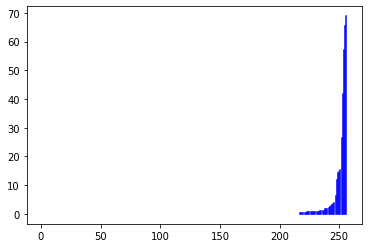

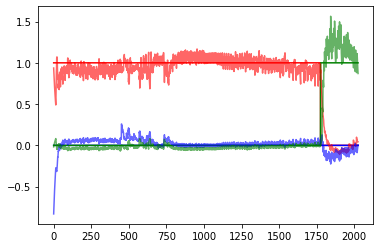

 42%|█████████████████████████████████████████████████████████████████▌                                                                                         | 1269/3000 [4:18:39<5:19:30, 11.07s/it]

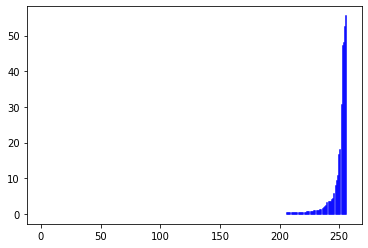

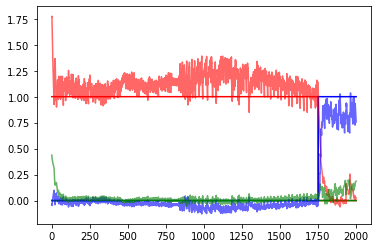

 42%|█████████████████████████████████████████████████████████████████▊                                                                                         | 1274/3000 [4:19:35<5:02:38, 10.52s/it]

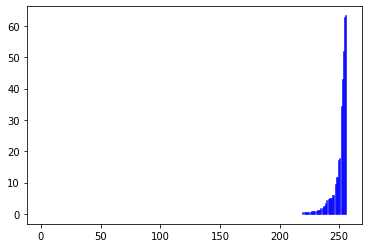

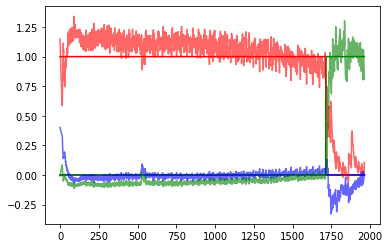

 43%|██████████████████████████████████████████████████████████████████                                                                                         | 1279/3000 [4:20:27<4:40:11,  9.77s/it]

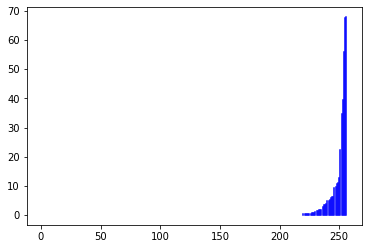

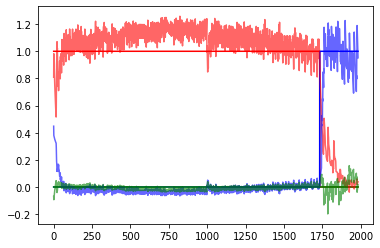

 43%|██████████████████████████████████████████████████████████████████▎                                                                                        | 1284/3000 [4:21:21<5:00:48, 10.52s/it]

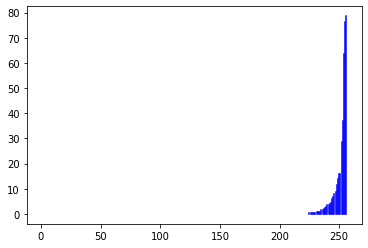

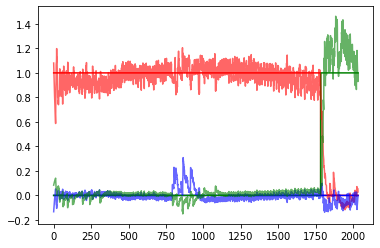

 43%|██████████████████████████████████████████████████████████████████▌                                                                                        | 1289/3000 [4:22:20<5:11:13, 10.91s/it]

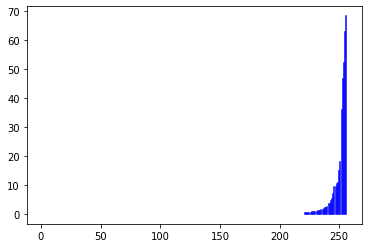

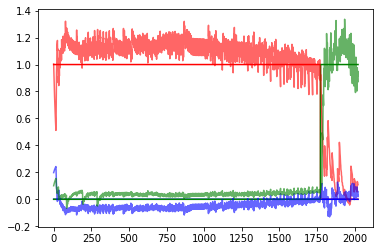

 43%|██████████████████████████████████████████████████████████████████▊                                                                                        | 1294/3000 [4:23:17<5:07:16, 10.81s/it]

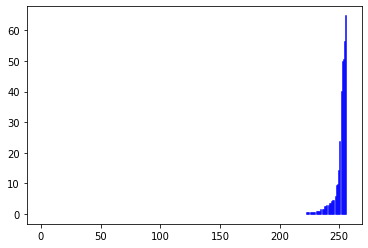

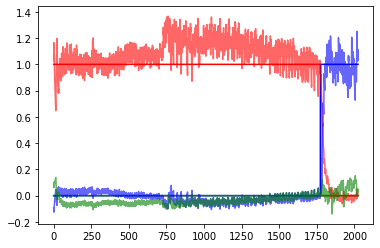

 43%|███████████████████████████████████████████████████████████████████                                                                                        | 1299/3000 [4:24:13<5:03:14, 10.70s/it]

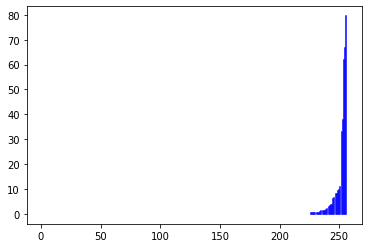

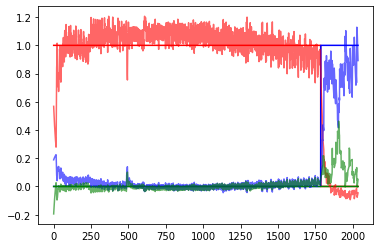

 43%|███████████████████████████████████████████████████████████████████▎                                                                                       | 1304/3000 [4:26:00<6:54:32, 14.67s/it]

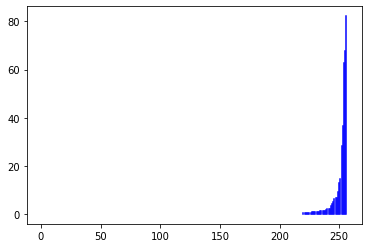

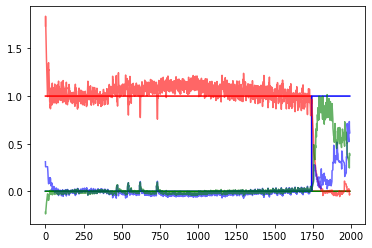

 44%|███████████████████████████████████████████████████████████████████▋                                                                                       | 1309/3000 [4:26:55<5:18:14, 11.29s/it]

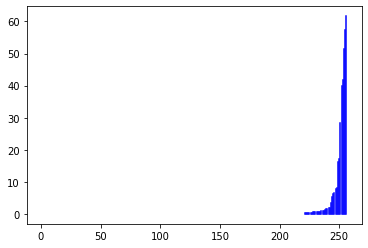

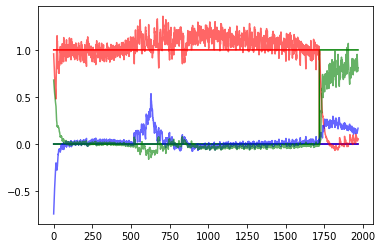

 44%|███████████████████████████████████████████████████████████████████▉                                                                                       | 1314/3000 [4:27:49<4:55:49, 10.53s/it]

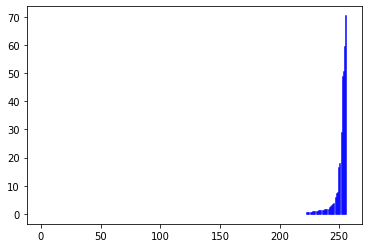

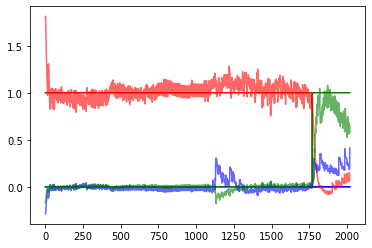

 44%|████████████████████████████████████████████████████████████████████▏                                                                                      | 1319/3000 [4:28:43<4:49:40, 10.34s/it]

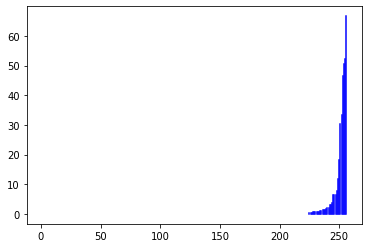

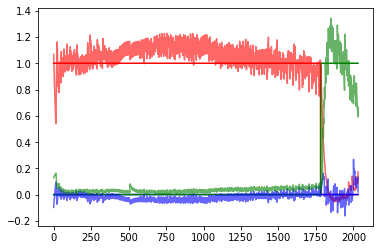

 44%|████████████████████████████████████████████████████████████████████▍                                                                                      | 1324/3000 [4:29:43<5:16:11, 11.32s/it]

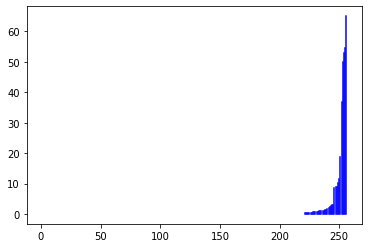

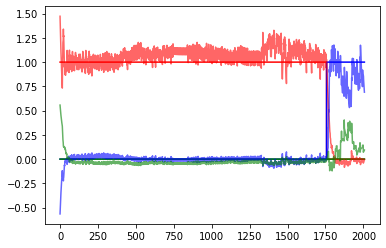

 44%|████████████████████████████████████████████████████████████████████▋                                                                                      | 1329/3000 [4:30:40<5:04:35, 10.94s/it]

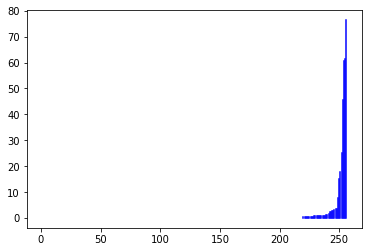

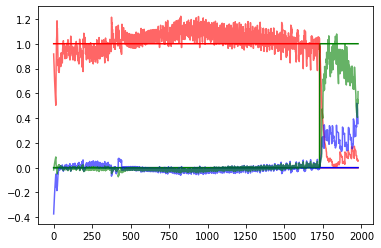

 44%|████████████████████████████████████████████████████████████████████▉                                                                                      | 1334/3000 [4:31:37<5:08:13, 11.10s/it]

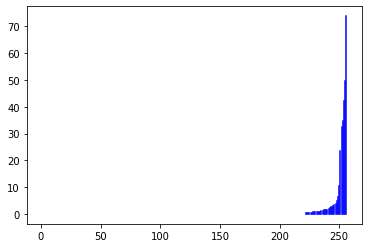

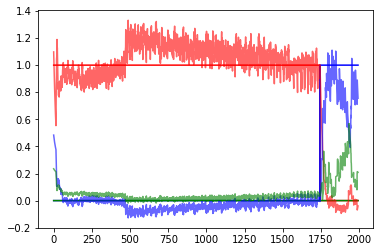

 45%|█████████████████████████████████████████████████████████████████████▏                                                                                     | 1339/3000 [4:32:27<4:21:28,  9.45s/it]

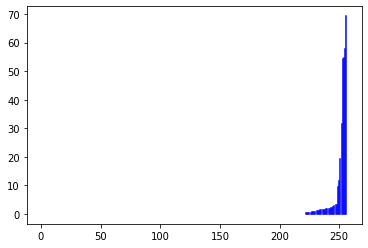

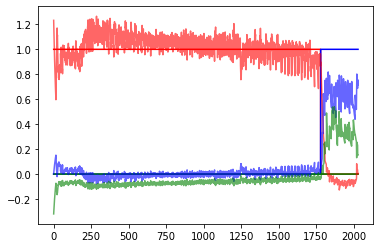

 45%|█████████████████████████████████████████████████████████████████████▍                                                                                     | 1344/3000 [4:33:23<4:52:49, 10.61s/it]

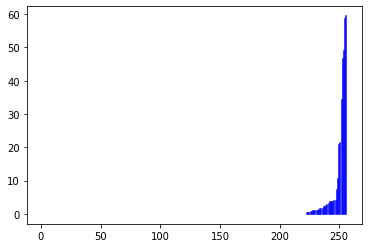

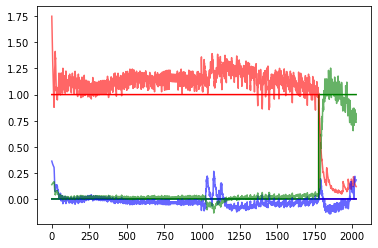

 45%|█████████████████████████████████████████████████████████████████████▋                                                                                     | 1349/3000 [4:34:18<4:53:11, 10.66s/it]

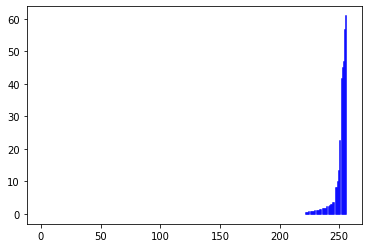

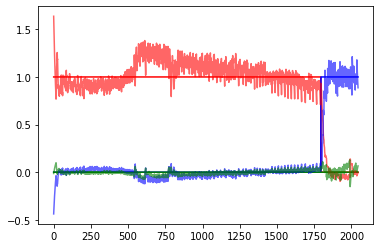

 45%|█████████████████████████████████████████████████████████████████████▉                                                                                     | 1354/3000 [4:36:04<6:27:40, 14.13s/it]

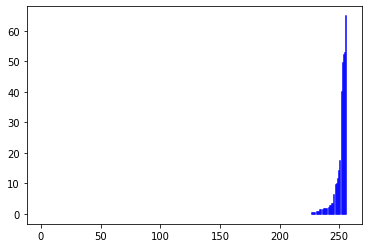

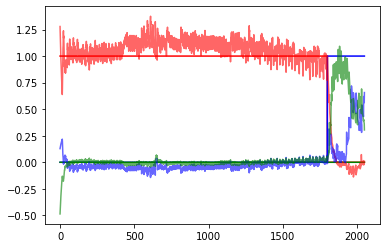

 45%|██████████████████████████████████████████████████████████████████████▏                                                                                    | 1359/3000 [4:37:03<5:24:29, 11.86s/it]

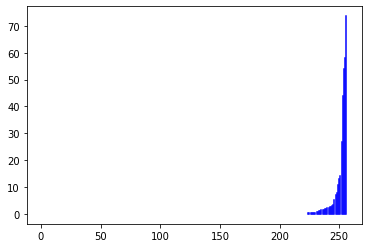

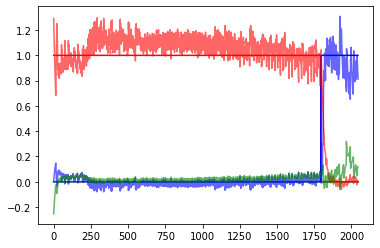

 45%|██████████████████████████████████████████████████████████████████████▍                                                                                    | 1364/3000 [4:38:01<5:06:39, 11.25s/it]

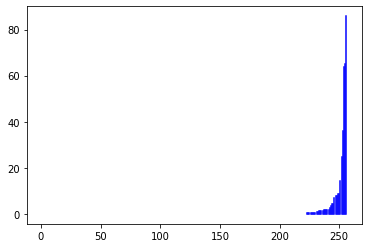

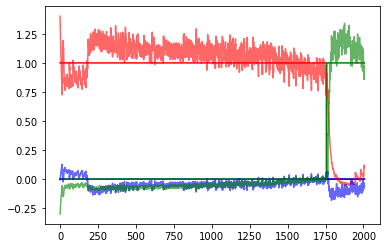

 46%|██████████████████████████████████████████████████████████████████████▋                                                                                    | 1369/3000 [4:38:59<5:01:21, 11.09s/it]

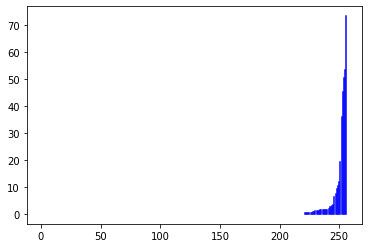

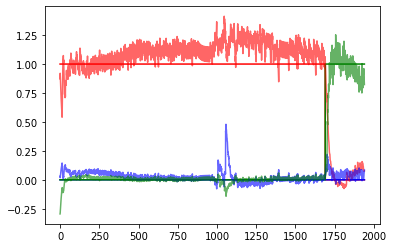

 46%|██████████████████████████████████████████████████████████████████████▉                                                                                    | 1374/3000 [4:39:56<4:53:20, 10.82s/it]

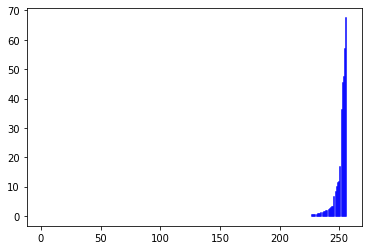

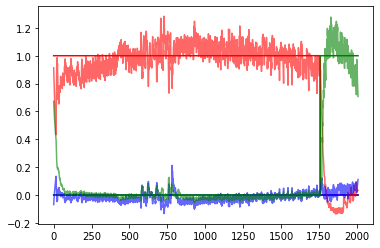

 46%|███████████████████████████████████████████████████████████████████████▏                                                                                   | 1379/3000 [4:40:52<4:58:16, 11.04s/it]

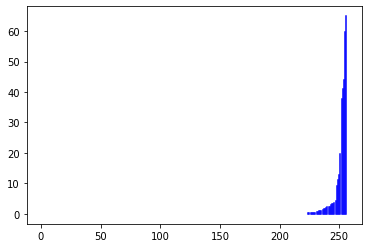

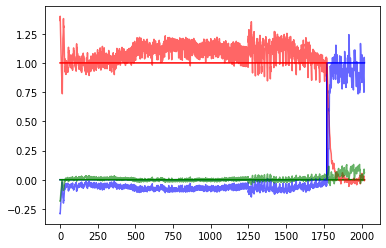

 46%|███████████████████████████████████████████████████████████████████████▌                                                                                   | 1384/3000 [4:41:48<4:50:32, 10.79s/it]

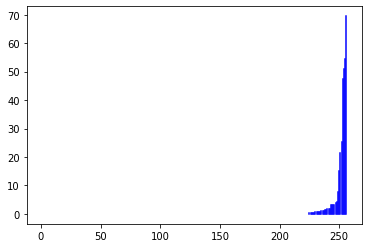

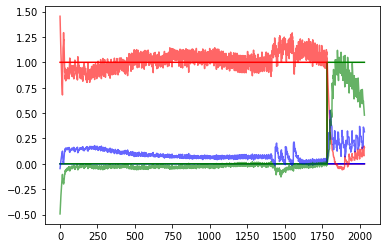

 46%|███████████████████████████████████████████████████████████████████████▊                                                                                   | 1389/3000 [4:42:43<4:34:48, 10.24s/it]

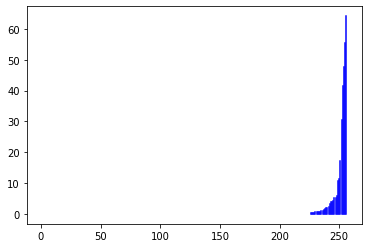

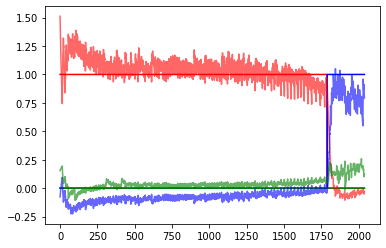

 46%|████████████████████████████████████████████████████████████████████████                                                                                   | 1394/3000 [4:43:42<4:58:29, 11.15s/it]

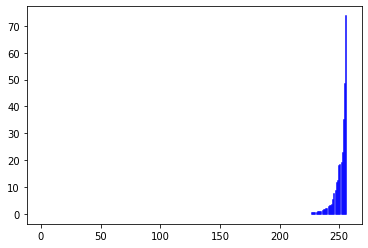

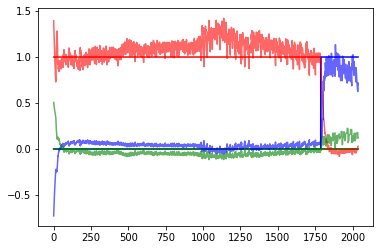

 47%|████████████████████████████████████████████████████████████████████████▎                                                                                  | 1399/3000 [4:44:38<4:49:15, 10.84s/it]

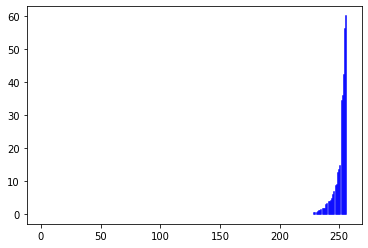

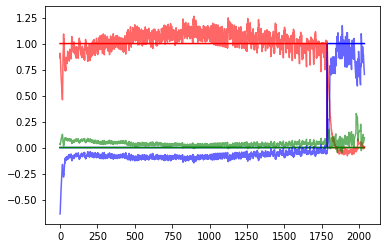

 47%|████████████████████████████████████████████████████████████████████████▌                                                                                  | 1404/3000 [4:46:20<6:14:19, 14.07s/it]

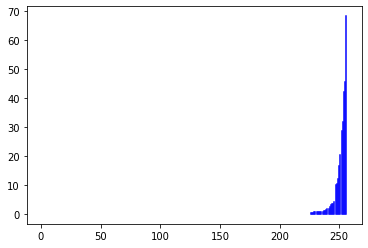

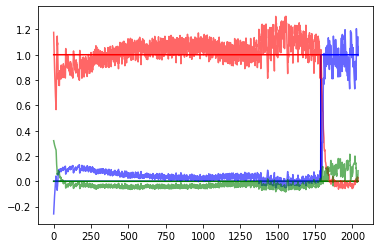

 47%|████████████████████████████████████████████████████████████████████████▊                                                                                  | 1409/3000 [4:47:19<5:12:52, 11.80s/it]

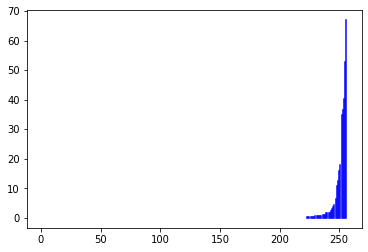

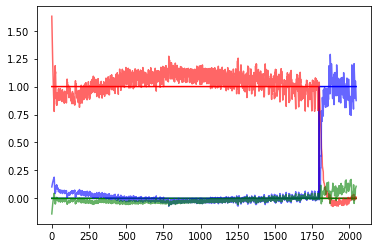

 47%|█████████████████████████████████████████████████████████████████████████                                                                                  | 1414/3000 [4:48:17<4:58:21, 11.29s/it]

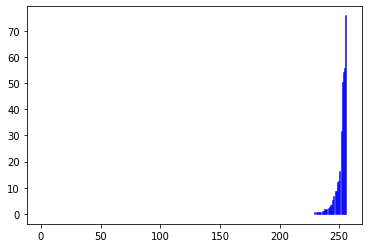

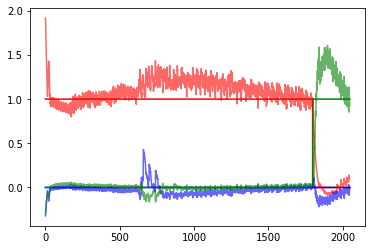

 47%|█████████████████████████████████████████████████████████████████████████▎                                                                                 | 1419/3000 [4:49:15<4:53:40, 11.15s/it]

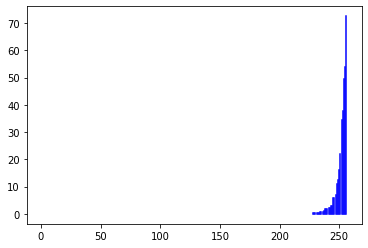

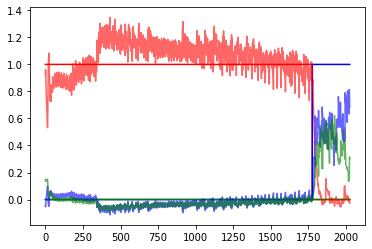

 47%|█████████████████████████████████████████████████████████████████████████▌                                                                                 | 1424/3000 [4:50:09<4:40:29, 10.68s/it]

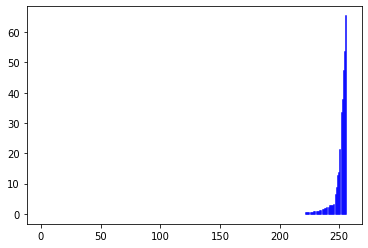

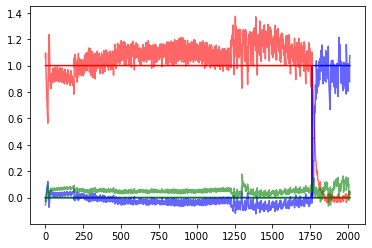

 48%|█████████████████████████████████████████████████████████████████████████▊                                                                                 | 1429/3000 [4:51:07<4:42:40, 10.80s/it]

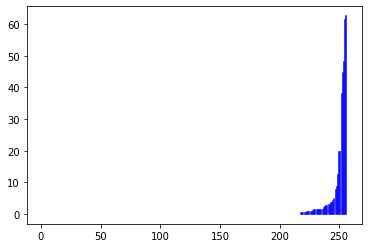

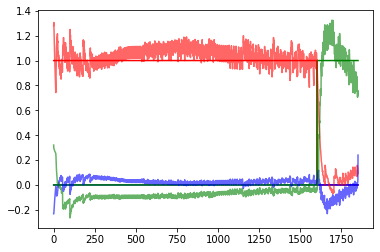

 48%|██████████████████████████████████████████████████████████████████████████                                                                                 | 1434/3000 [4:52:04<4:46:39, 10.98s/it]

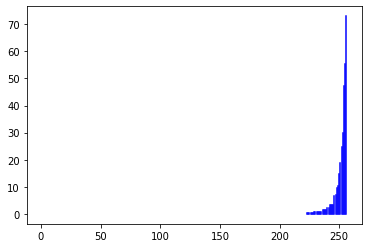

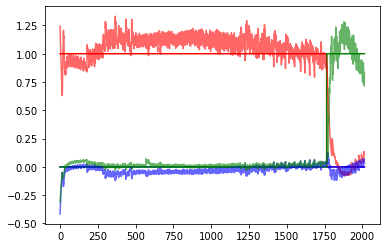

 48%|██████████████████████████████████████████████████████████████████████████▎                                                                                | 1439/3000 [4:53:00<4:45:03, 10.96s/it]

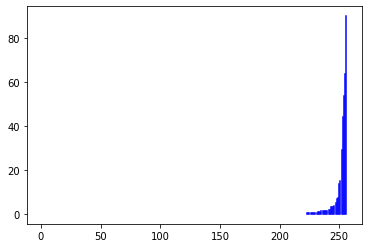

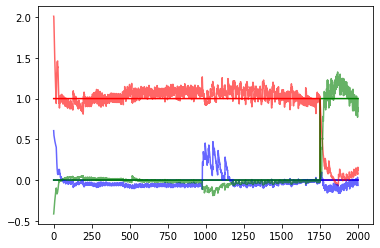

 48%|██████████████████████████████████████████████████████████████████████████▌                                                                                | 1444/3000 [4:53:56<4:43:55, 10.95s/it]

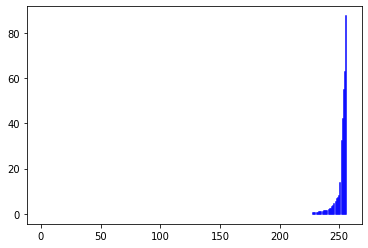

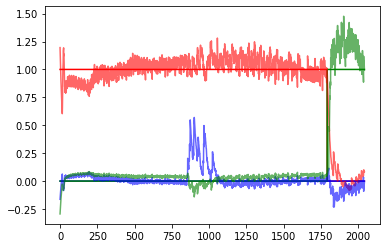

 48%|██████████████████████████████████████████████████████████████████████████▊                                                                                | 1449/3000 [4:54:53<4:43:22, 10.96s/it]

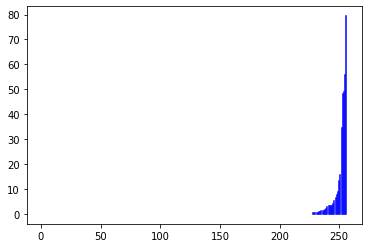

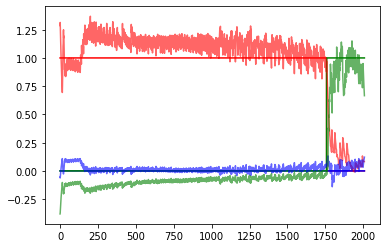

 48%|███████████████████████████████████████████████████████████████████████████                                                                                | 1454/3000 [4:56:40<6:14:16, 14.53s/it]

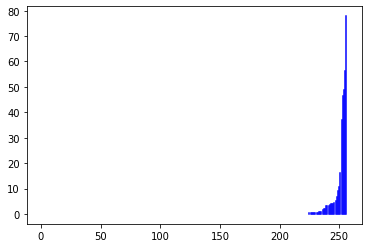

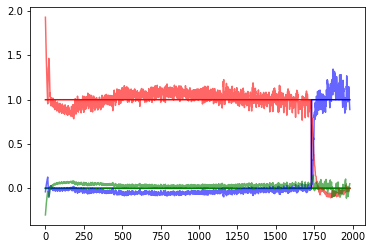

 49%|███████████████████████████████████████████████████████████████████████████▍                                                                               | 1459/3000 [4:57:40<5:07:58, 11.99s/it]

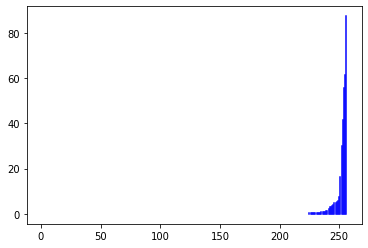

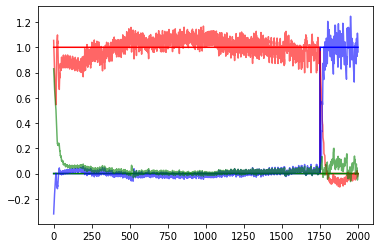

 49%|███████████████████████████████████████████████████████████████████████████▋                                                                               | 1464/3000 [4:58:35<4:41:43, 11.00s/it]

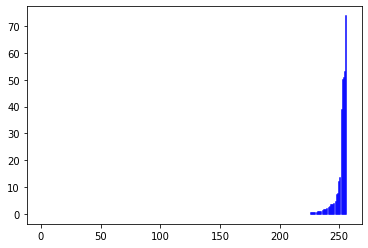

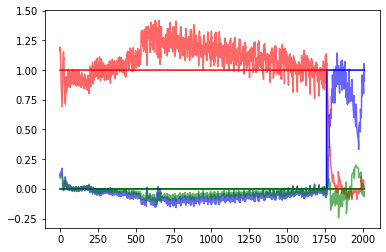

 49%|███████████████████████████████████████████████████████████████████████████▉                                                                               | 1469/3000 [4:59:30<4:38:29, 10.91s/it]

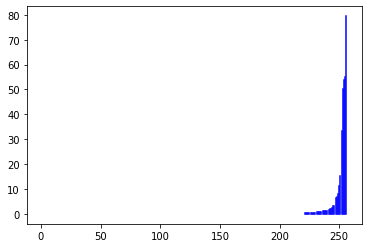

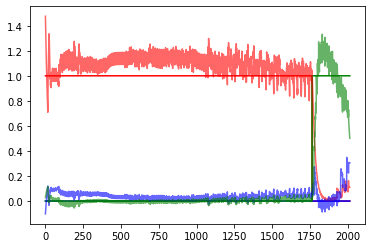

 49%|████████████████████████████████████████████████████████████████████████████▏                                                                              | 1474/3000 [5:00:30<4:51:07, 11.45s/it]

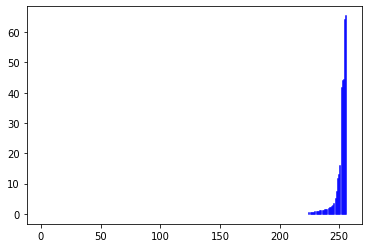

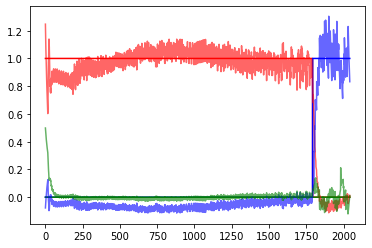

 49%|████████████████████████████████████████████████████████████████████████████▍                                                                              | 1479/3000 [5:01:26<4:29:07, 10.62s/it]

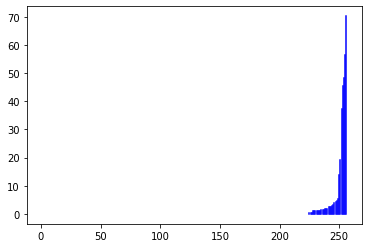

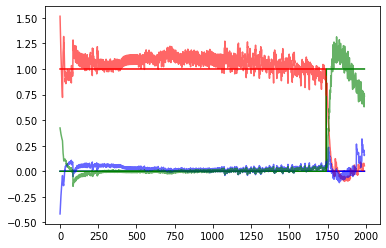

 49%|████████████████████████████████████████████████████████████████████████████▋                                                                              | 1484/3000 [5:02:22<4:36:41, 10.95s/it]

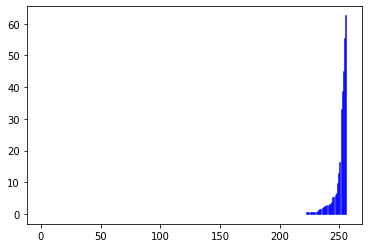

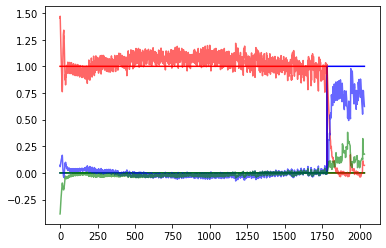

 50%|████████████████████████████████████████████████████████████████████████████▉                                                                              | 1489/3000 [5:03:19<4:28:17, 10.65s/it]

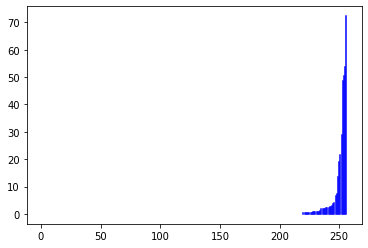

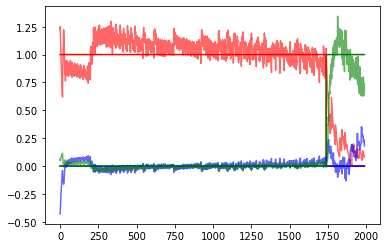

 50%|█████████████████████████████████████████████████████████████████████████████▏                                                                             | 1494/3000 [5:04:16<4:26:06, 10.60s/it]

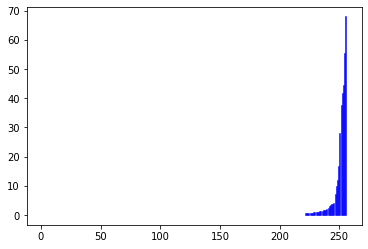

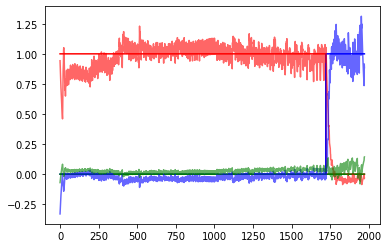

 50%|█████████████████████████████████████████████████████████████████████████████▍                                                                             | 1499/3000 [5:05:13<4:29:07, 10.76s/it]

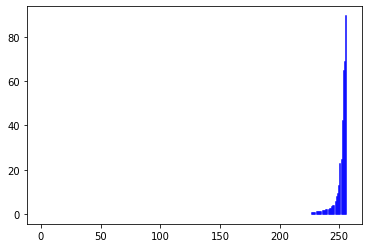

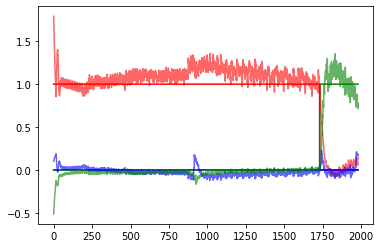

 50%|█████████████████████████████████████████████████████████████████████████████▋                                                                             | 1504/3000 [5:06:59<6:01:17, 14.49s/it]

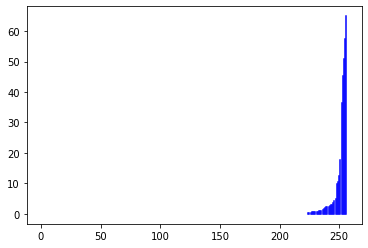

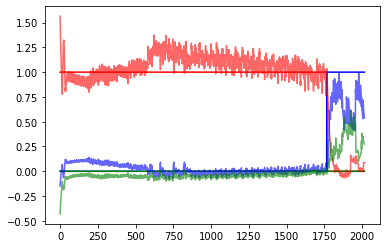

 50%|█████████████████████████████████████████████████████████████████████████████▉                                                                             | 1509/3000 [5:07:51<4:25:42, 10.69s/it]

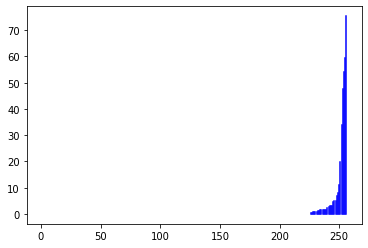

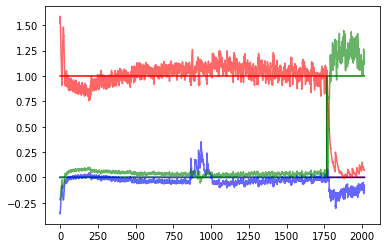

 50%|██████████████████████████████████████████████████████████████████████████████▏                                                                            | 1514/3000 [5:08:49<4:32:37, 11.01s/it]

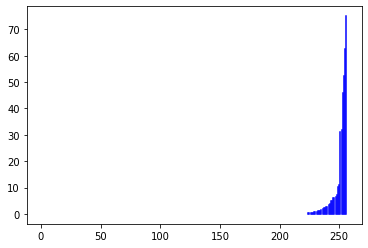

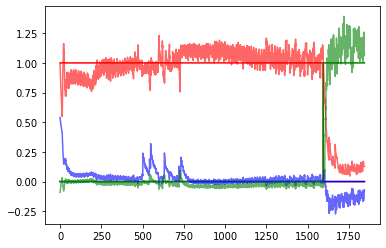

 51%|██████████████████████████████████████████████████████████████████████████████▍                                                                            | 1519/3000 [5:09:44<4:21:53, 10.61s/it]

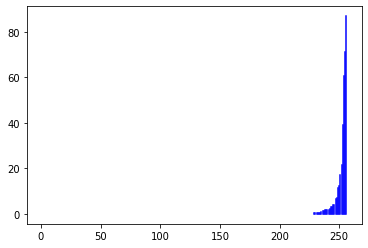

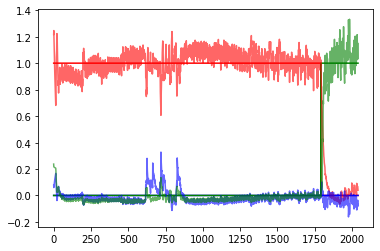

 51%|██████████████████████████████████████████████████████████████████████████████▋                                                                            | 1524/3000 [5:10:41<4:18:51, 10.52s/it]

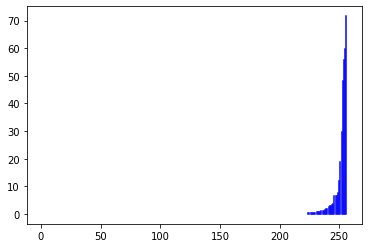

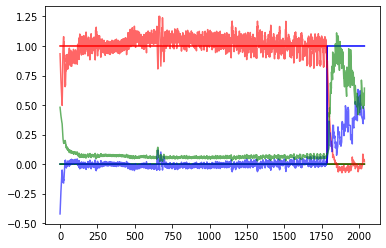

 51%|██████████████████████████████████████████████████████████████████████████████▉                                                                            | 1529/3000 [5:11:37<4:16:40, 10.47s/it]

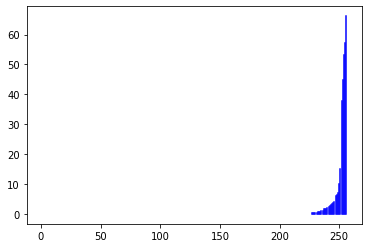

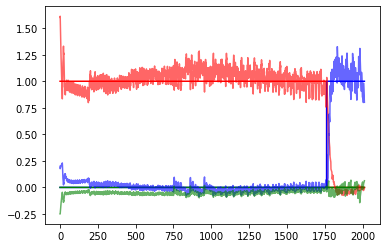

 51%|███████████████████████████████████████████████████████████████████████████████▎                                                                           | 1534/3000 [5:12:32<4:12:09, 10.32s/it]

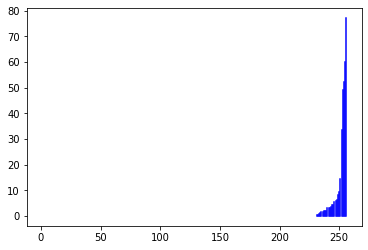

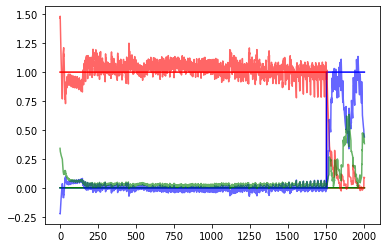

 51%|███████████████████████████████████████████████████████████████████████████████▌                                                                           | 1539/3000 [5:13:29<4:24:00, 10.84s/it]

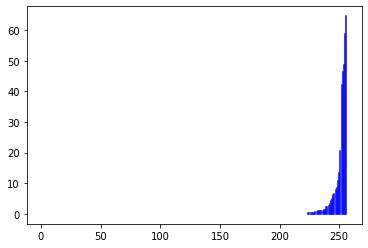

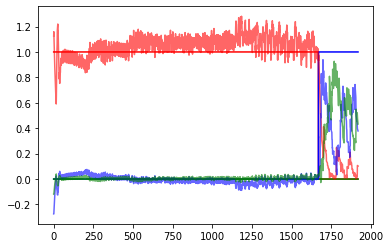

 51%|███████████████████████████████████████████████████████████████████████████████▊                                                                           | 1544/3000 [5:14:22<4:03:45, 10.04s/it]

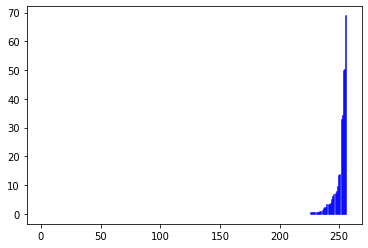

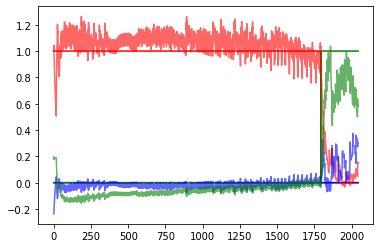

 52%|████████████████████████████████████████████████████████████████████████████████                                                                           | 1549/3000 [5:15:20<4:19:11, 10.72s/it]

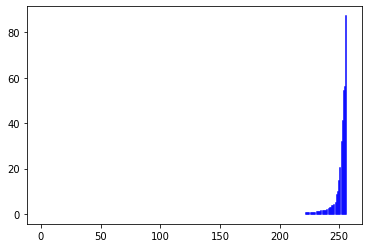

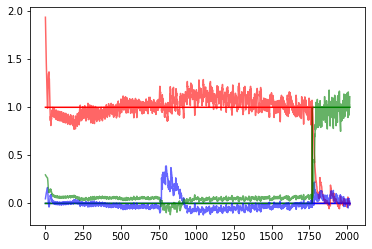

 52%|████████████████████████████████████████████████████████████████████████████████▎                                                                          | 1554/3000 [5:17:03<5:29:56, 13.69s/it]

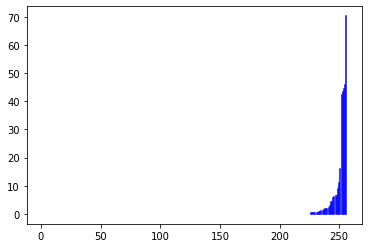

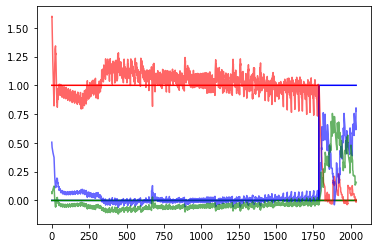

 52%|████████████████████████████████████████████████████████████████████████████████▌                                                                          | 1559/3000 [5:17:59<4:27:04, 11.12s/it]

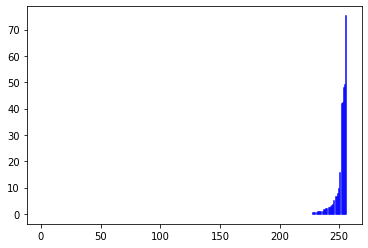

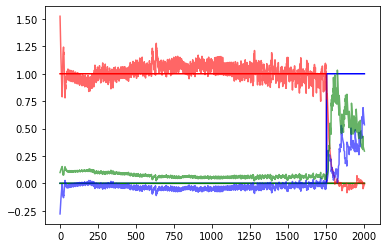

 52%|████████████████████████████████████████████████████████████████████████████████▊                                                                          | 1564/3000 [5:18:55<4:19:47, 10.85s/it]

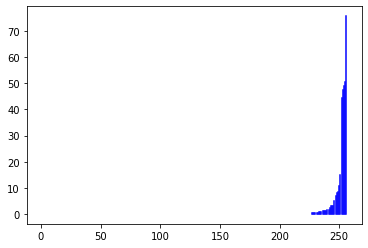

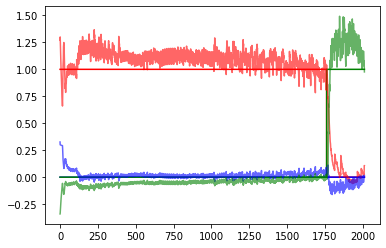

 52%|█████████████████████████████████████████████████████████████████████████████████                                                                          | 1569/3000 [5:19:50<4:14:30, 10.67s/it]

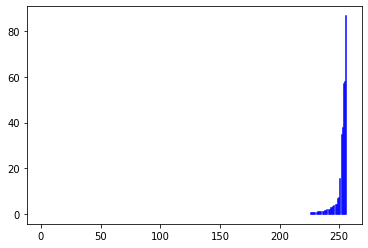

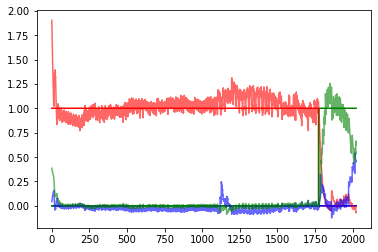

 52%|█████████████████████████████████████████████████████████████████████████████████▎                                                                         | 1574/3000 [5:20:46<4:11:11, 10.57s/it]

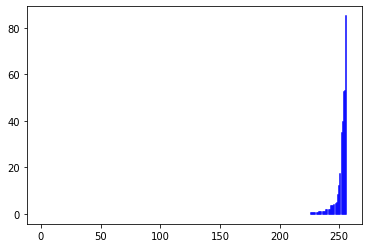

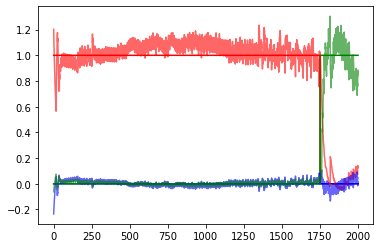

 53%|█████████████████████████████████████████████████████████████████████████████████▌                                                                         | 1579/3000 [5:21:45<4:25:19, 11.20s/it]

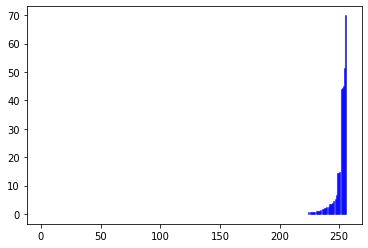

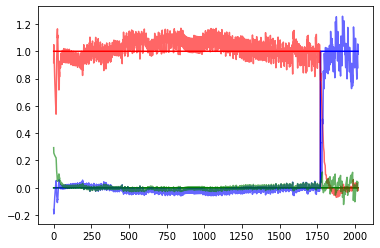

 53%|█████████████████████████████████████████████████████████████████████████████████▊                                                                         | 1584/3000 [5:22:40<4:10:27, 10.61s/it]

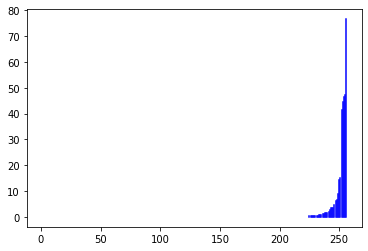

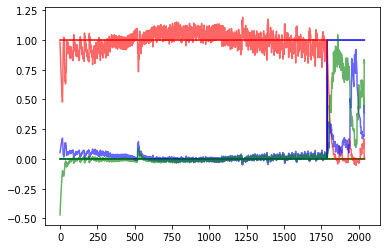

 53%|██████████████████████████████████████████████████████████████████████████████████                                                                         | 1589/3000 [5:23:37<4:15:56, 10.88s/it]

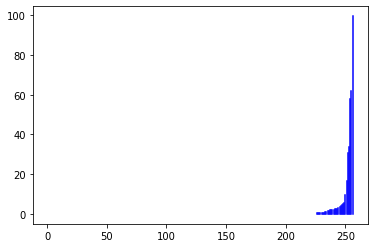

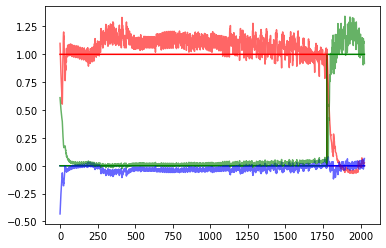

 53%|██████████████████████████████████████████████████████████████████████████████████▎                                                                        | 1594/3000 [5:24:35<4:19:04, 11.06s/it]

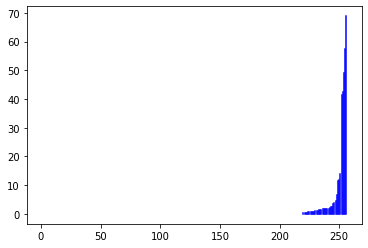

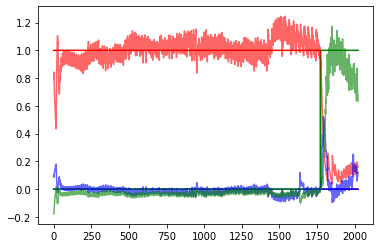

 53%|██████████████████████████████████████████████████████████████████████████████████▌                                                                        | 1599/3000 [5:25:33<4:17:36, 11.03s/it]

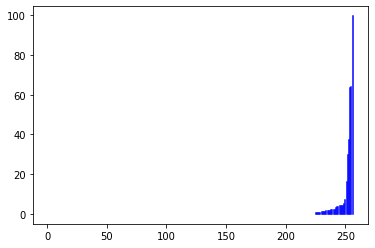

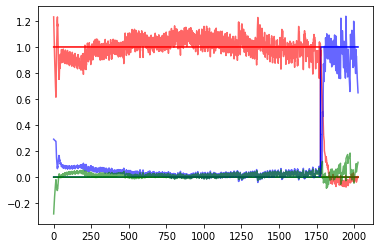

 53%|██████████████████████████████████████████████████████████████████████████████████▊                                                                        | 1604/3000 [5:27:17<5:30:09, 14.19s/it]

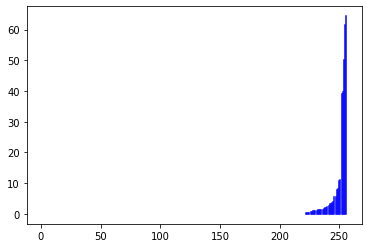

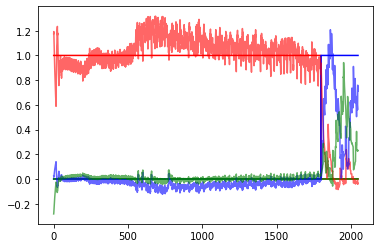

 54%|███████████████████████████████████████████████████████████████████████████████████▏                                                                       | 1609/3000 [5:28:13<4:26:07, 11.48s/it]

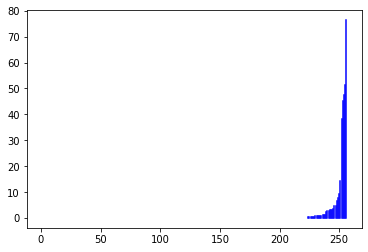

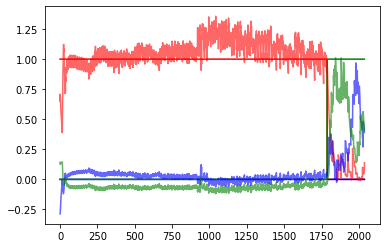

 54%|███████████████████████████████████████████████████████████████████████████████████▍                                                                       | 1614/3000 [5:29:10<4:13:05, 10.96s/it]

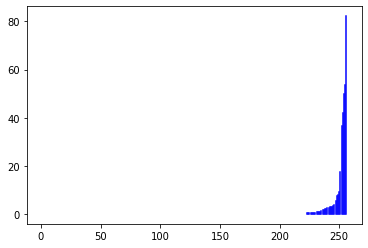

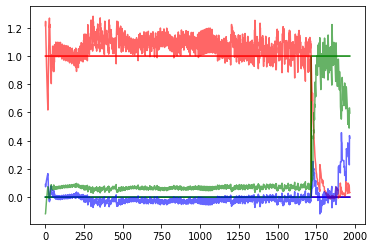

 54%|███████████████████████████████████████████████████████████████████████████████████▋                                                                       | 1619/3000 [5:30:03<3:54:40, 10.20s/it]

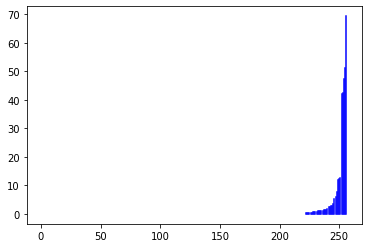

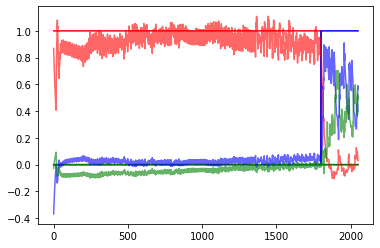

 54%|███████████████████████████████████████████████████████████████████████████████████▉                                                                       | 1624/3000 [5:30:57<3:56:44, 10.32s/it]

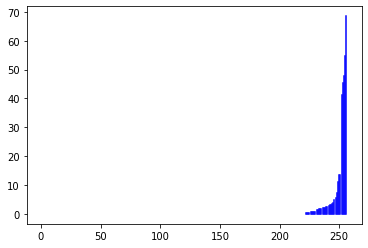

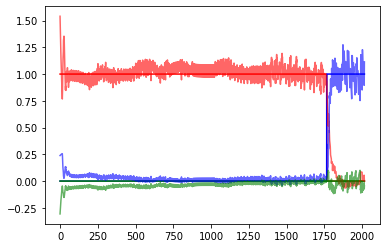

 54%|████████████████████████████████████████████████████████████████████████████████████▏                                                                      | 1629/3000 [5:31:52<3:57:10, 10.38s/it]

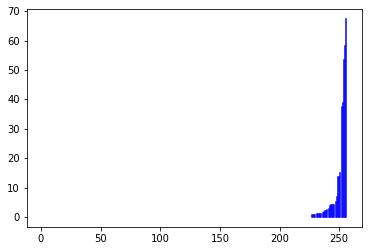

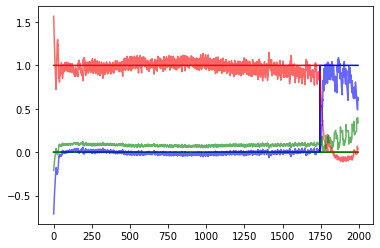

 54%|████████████████████████████████████████████████████████████████████████████████████▍                                                                      | 1634/3000 [5:32:47<3:56:29, 10.39s/it]

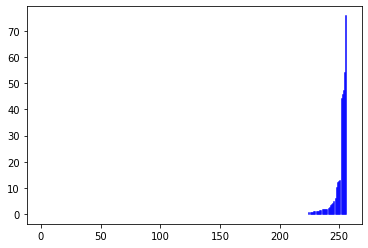

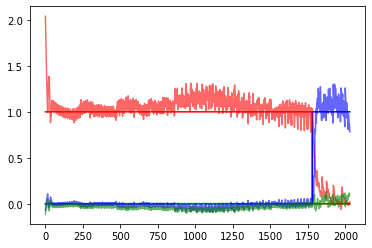

 55%|████████████████████████████████████████████████████████████████████████████████████▋                                                                      | 1639/3000 [5:33:45<4:07:22, 10.91s/it]

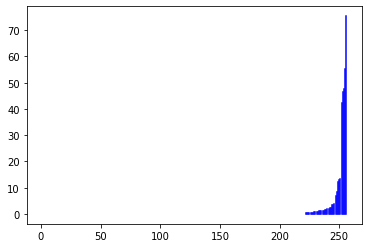

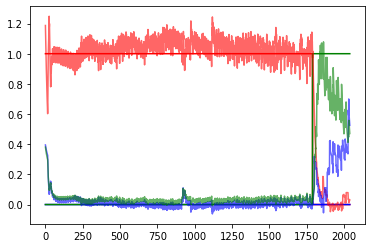

 55%|████████████████████████████████████████████████████████████████████████████████████▉                                                                      | 1644/3000 [5:34:43<4:05:28, 10.86s/it]

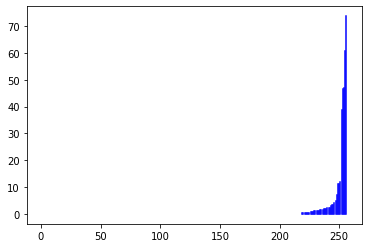

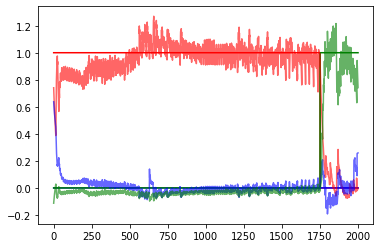

 55%|█████████████████████████████████████████████████████████████████████████████████████▏                                                                     | 1649/3000 [5:35:39<4:05:14, 10.89s/it]

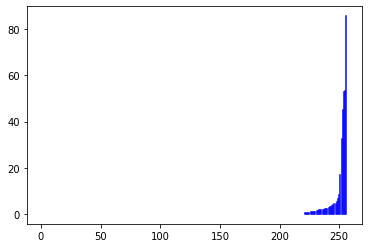

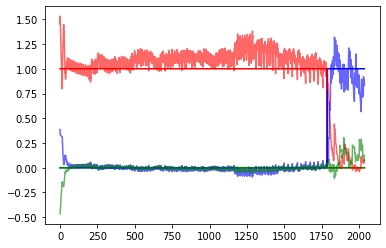

 55%|█████████████████████████████████████████████████████████████████████████████████████▍                                                                     | 1654/3000 [5:37:27<5:34:32, 14.91s/it]

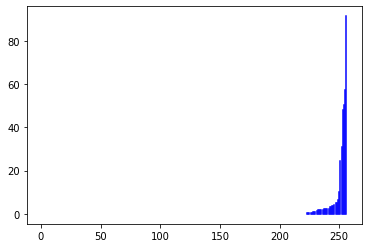

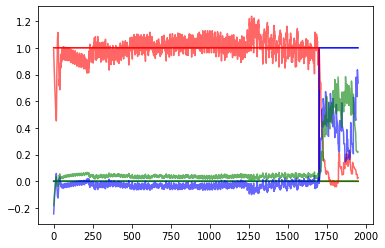

 55%|█████████████████████████████████████████████████████████████████████████████████████▋                                                                     | 1659/3000 [5:38:22<4:14:06, 11.37s/it]

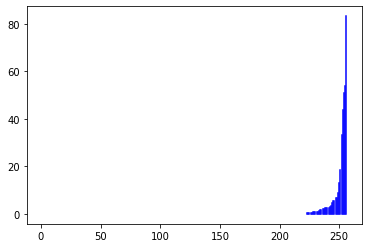

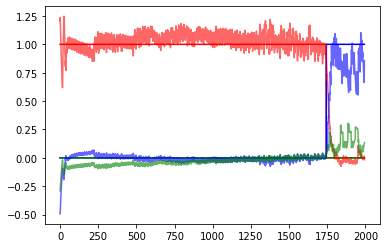

 55%|█████████████████████████████████████████████████████████████████████████████████████▉                                                                     | 1664/3000 [5:39:20<4:06:05, 11.05s/it]

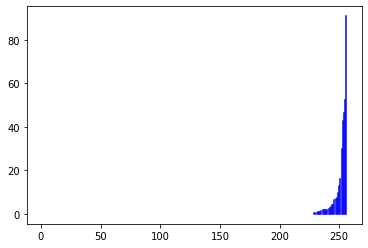

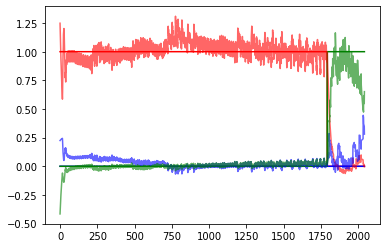

 56%|██████████████████████████████████████████████████████████████████████████████████████▏                                                                    | 1669/3000 [5:40:18<4:11:58, 11.36s/it]

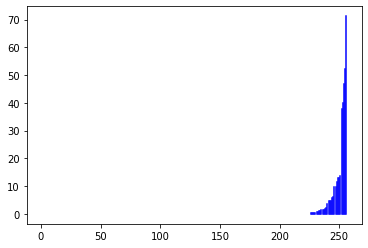

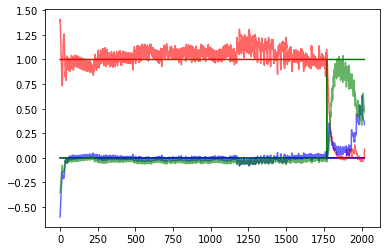

 56%|██████████████████████████████████████████████████████████████████████████████████████▍                                                                    | 1674/3000 [5:41:14<3:58:17, 10.78s/it]

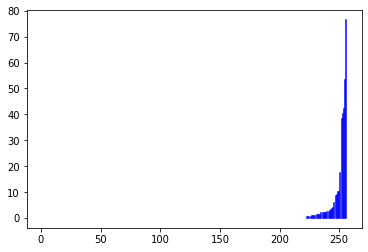

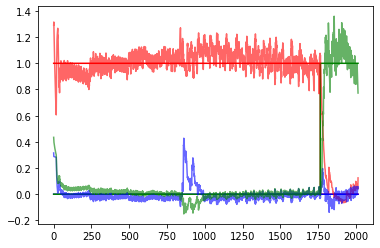

 56%|██████████████████████████████████████████████████████████████████████████████████████▋                                                                    | 1679/3000 [5:42:09<3:54:55, 10.67s/it]

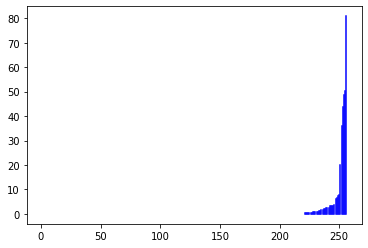

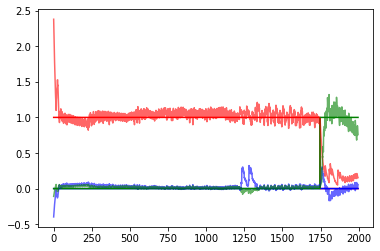

 56%|███████████████████████████████████████████████████████████████████████████████████████                                                                    | 1684/3000 [5:43:05<3:55:23, 10.73s/it]

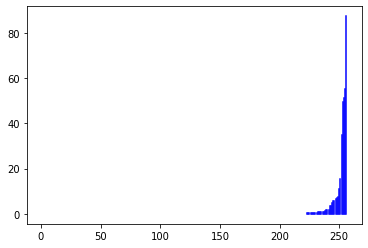

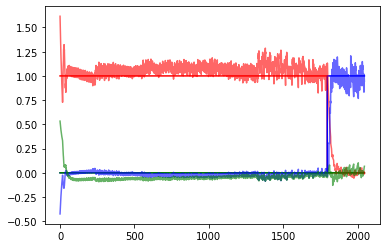

 56%|███████████████████████████████████████████████████████████████████████████████████████▎                                                                   | 1689/3000 [5:44:02<4:00:42, 11.02s/it]

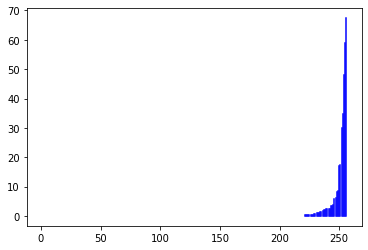

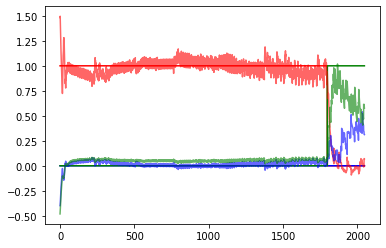

 56%|███████████████████████████████████████████████████████████████████████████████████████▌                                                                   | 1694/3000 [5:45:00<3:54:33, 10.78s/it]

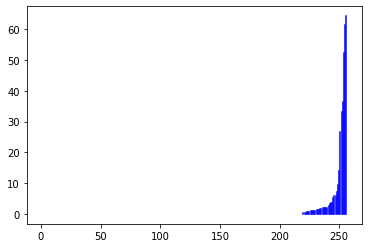

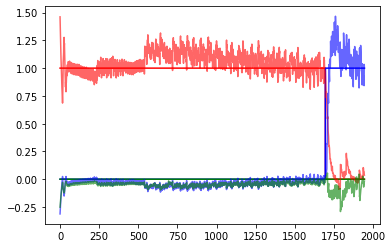

 57%|███████████████████████████████████████████████████████████████████████████████████████▊                                                                   | 1699/3000 [5:45:52<3:41:31, 10.22s/it]

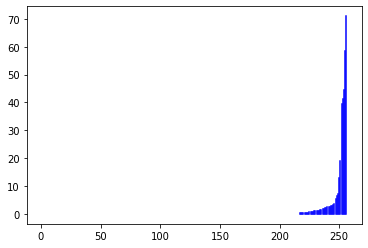

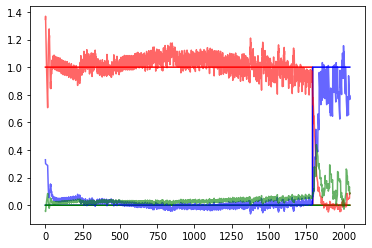

 57%|████████████████████████████████████████████████████████████████████████████████████████                                                                   | 1704/3000 [5:47:35<5:02:20, 14.00s/it]

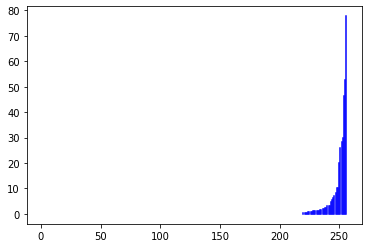

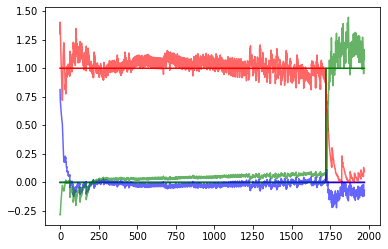

 57%|████████████████████████████████████████████████████████████████████████████████████████▎                                                                  | 1709/3000 [5:48:30<3:56:37, 11.00s/it]

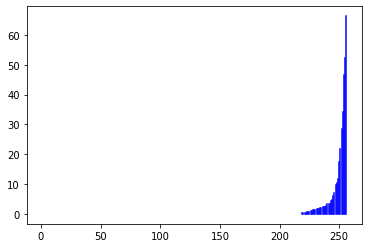

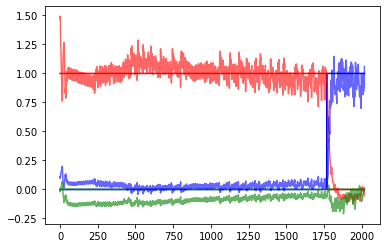

 57%|████████████████████████████████████████████████████████████████████████████████████████▌                                                                  | 1714/3000 [5:49:26<3:49:42, 10.72s/it]

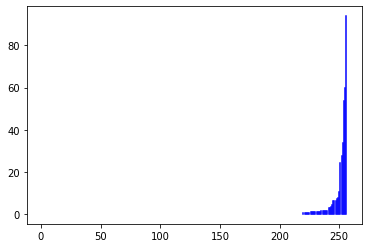

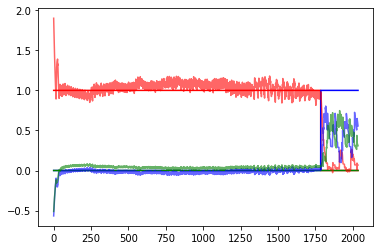

 57%|████████████████████████████████████████████████████████████████████████████████████████▊                                                                  | 1719/3000 [5:50:20<3:37:43, 10.20s/it]

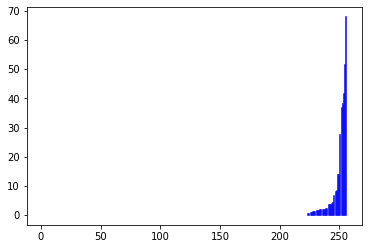

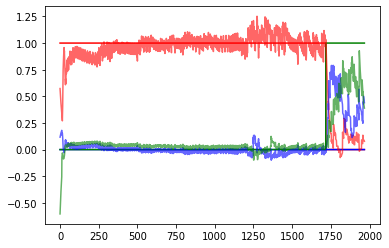

 57%|█████████████████████████████████████████████████████████████████████████████████████████                                                                  | 1724/3000 [5:51:16<3:46:00, 10.63s/it]

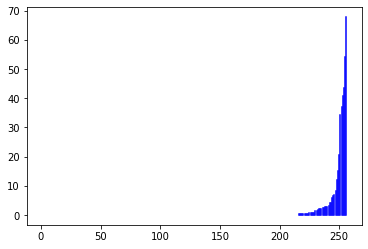

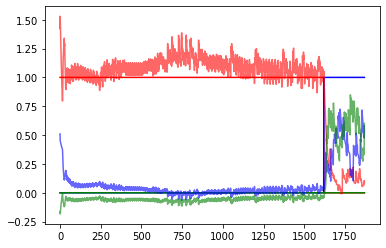

 58%|█████████████████████████████████████████████████████████████████████████████████████████▎                                                                 | 1729/3000 [5:52:13<3:54:34, 11.07s/it]

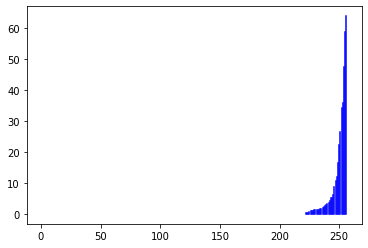

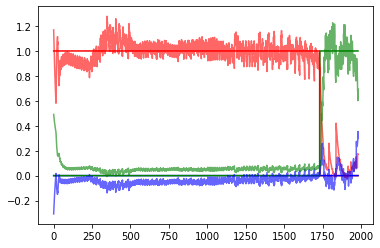

 58%|█████████████████████████████████████████████████████████████████████████████████████████▌                                                                 | 1734/3000 [5:53:09<3:53:13, 11.05s/it]

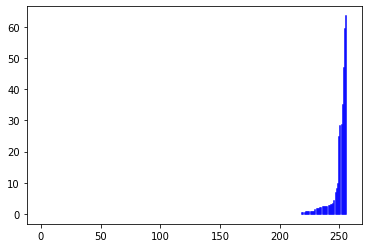

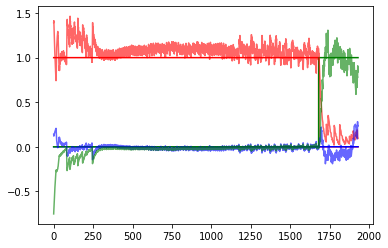

 58%|█████████████████████████████████████████████████████████████████████████████████████████▊                                                                 | 1739/3000 [5:54:05<3:46:11, 10.76s/it]

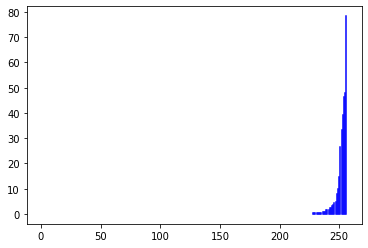

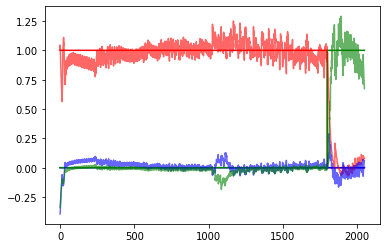

 58%|██████████████████████████████████████████████████████████████████████████████████████████                                                                 | 1744/3000 [5:55:05<3:53:04, 11.13s/it]

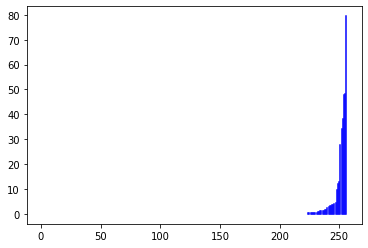

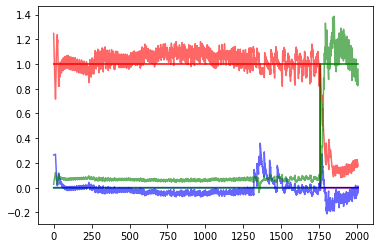

 58%|██████████████████████████████████████████████████████████████████████████████████████████▎                                                                | 1749/3000 [5:55:57<3:31:22, 10.14s/it]

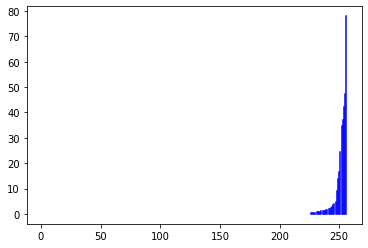

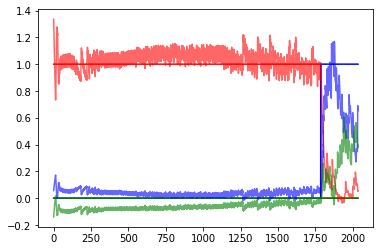

 58%|██████████████████████████████████████████████████████████████████████████████████████████▌                                                                | 1754/3000 [5:57:42<4:54:14, 14.17s/it]

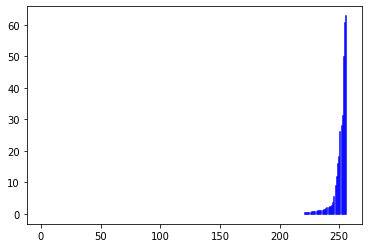

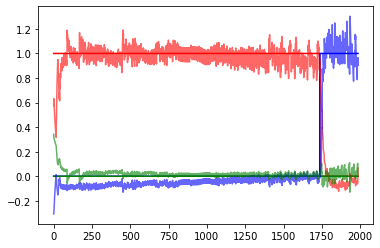

 59%|██████████████████████████████████████████████████████████████████████████████████████████▉                                                                | 1759/3000 [5:58:39<3:58:23, 11.53s/it]

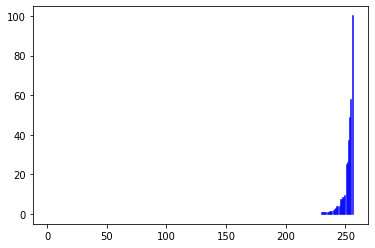

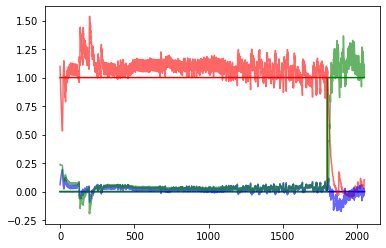

 59%|███████████████████████████████████████████████████████████████████████████████████████████▏                                                               | 1764/3000 [5:59:38<3:54:57, 11.41s/it]

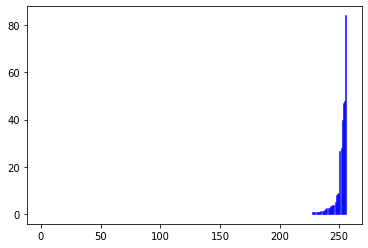

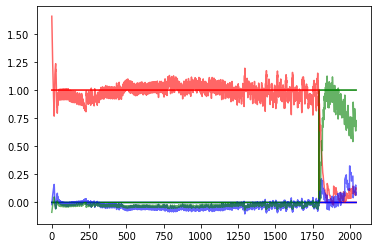

 59%|███████████████████████████████████████████████████████████████████████████████████████████▍                                                               | 1769/3000 [6:00:36<3:48:20, 11.13s/it]

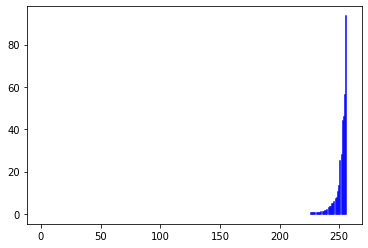

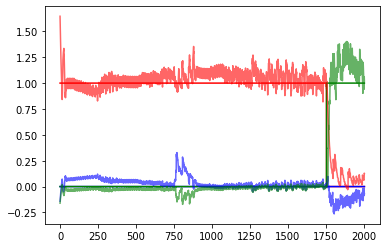

 59%|███████████████████████████████████████████████████████████████████████████████████████████▋                                                               | 1774/3000 [6:01:34<3:50:07, 11.26s/it]

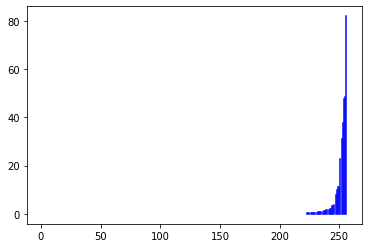

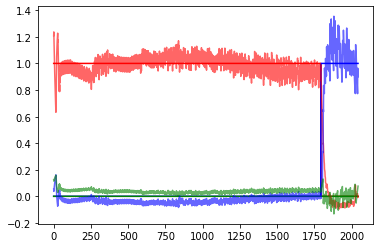

 59%|███████████████████████████████████████████████████████████████████████████████████████████▉                                                               | 1779/3000 [6:02:33<3:50:29, 11.33s/it]

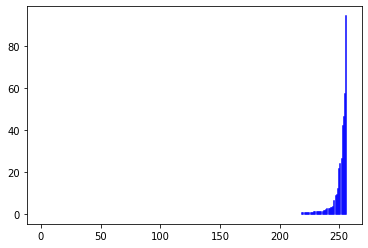

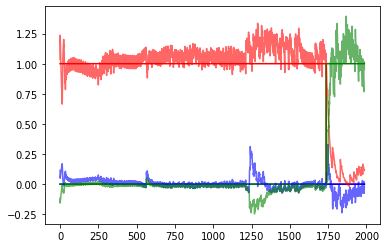

 59%|████████████████████████████████████████████████████████████████████████████████████████████▏                                                              | 1784/3000 [6:03:27<3:33:23, 10.53s/it]

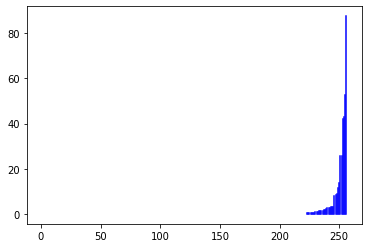

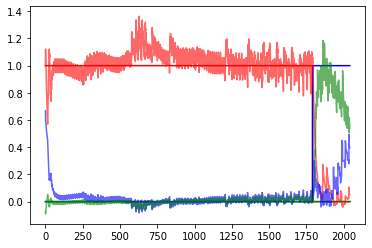

 60%|████████████████████████████████████████████████████████████████████████████████████████████▍                                                              | 1789/3000 [6:04:25<3:41:45, 10.99s/it]

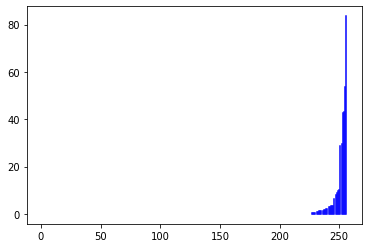

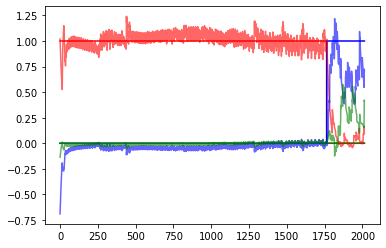

 60%|████████████████████████████████████████████████████████████████████████████████████████████▋                                                              | 1794/3000 [6:05:21<3:34:48, 10.69s/it]

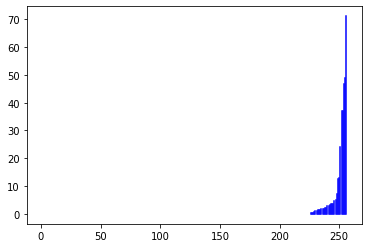

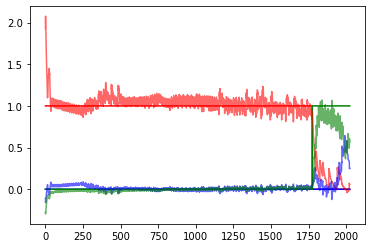

 60%|████████████████████████████████████████████████████████████████████████████████████████████▉                                                              | 1799/3000 [6:06:15<3:34:44, 10.73s/it]

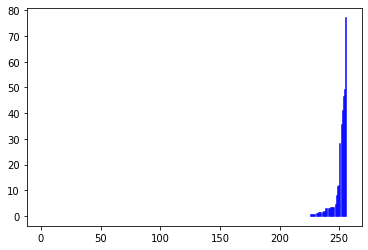

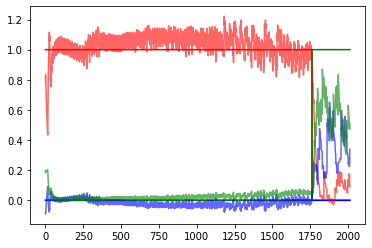

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▏                                                             | 1804/3000 [6:07:57<4:34:25, 13.77s/it]

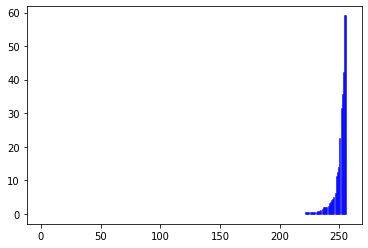

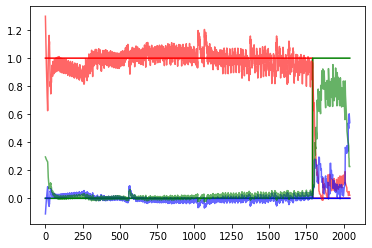

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▍                                                             | 1809/3000 [6:08:55<3:48:22, 11.51s/it]

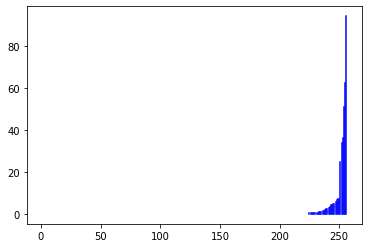

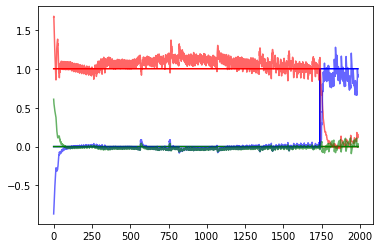

 60%|█████████████████████████████████████████████████████████████████████████████████████████████▋                                                             | 1814/3000 [6:09:48<3:18:53, 10.06s/it]

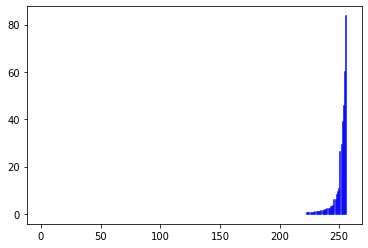

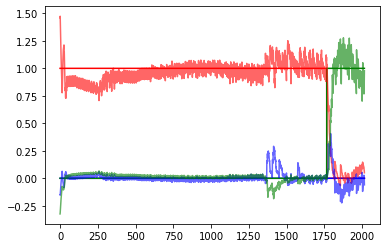

 61%|█████████████████████████████████████████████████████████████████████████████████████████████▉                                                             | 1819/3000 [6:10:47<3:32:46, 10.81s/it]

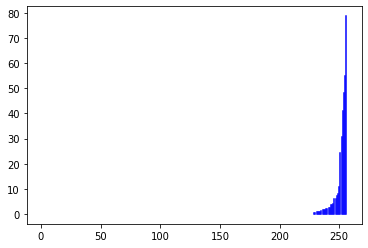

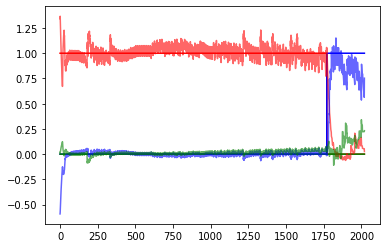

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▏                                                            | 1824/3000 [6:11:40<3:14:40,  9.93s/it]

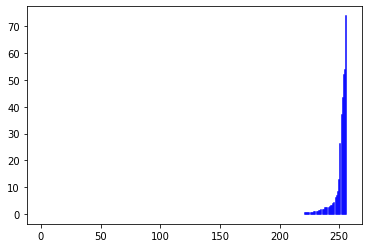

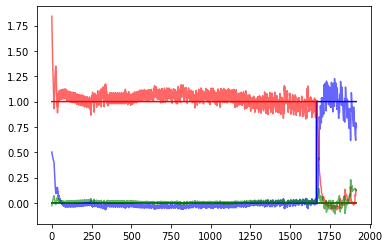

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▍                                                            | 1829/3000 [6:12:37<3:30:07, 10.77s/it]

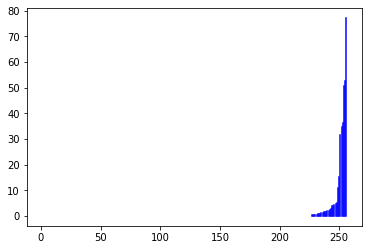

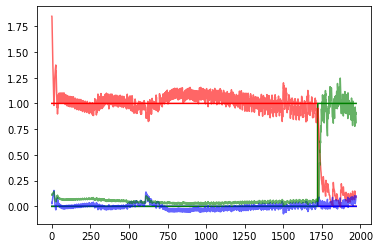

 61%|██████████████████████████████████████████████████████████████████████████████████████████████▊                                                            | 1834/3000 [6:13:32<3:25:45, 10.59s/it]

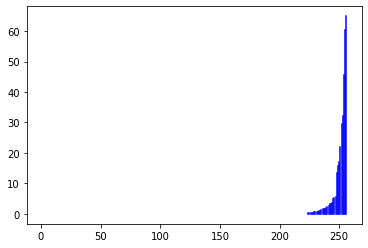

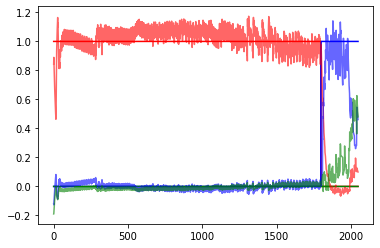

 61%|███████████████████████████████████████████████████████████████████████████████████████████████                                                            | 1839/3000 [6:14:28<3:29:40, 10.84s/it]

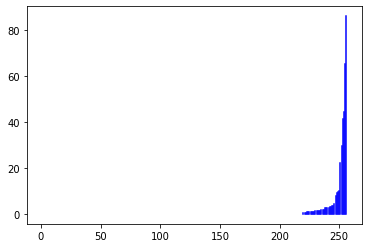

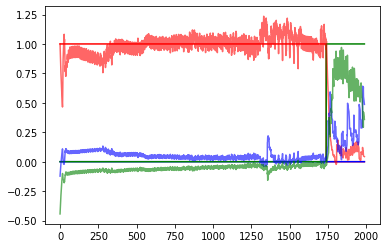

 61%|███████████████████████████████████████████████████████████████████████████████████████████████▎                                                           | 1844/3000 [6:15:23<3:25:12, 10.65s/it]

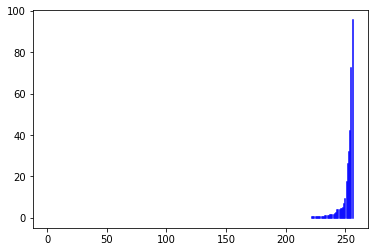

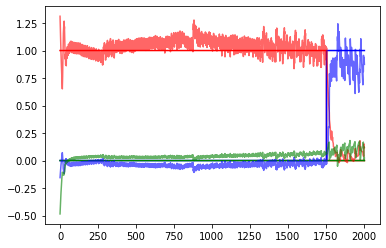

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▌                                                           | 1849/3000 [6:16:20<3:26:40, 10.77s/it]

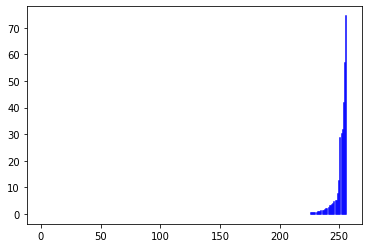

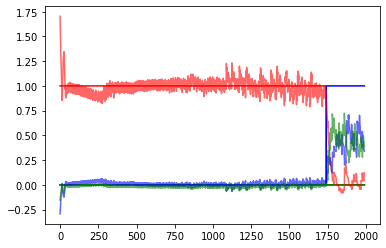

 62%|███████████████████████████████████████████████████████████████████████████████████████████████▊                                                           | 1854/3000 [6:18:09<4:40:01, 14.66s/it]

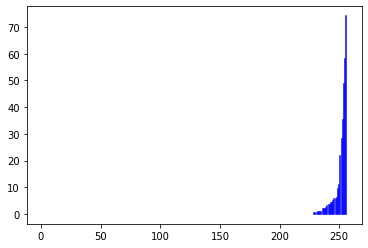

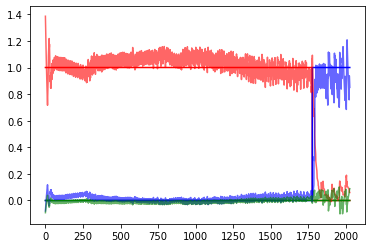

 62%|████████████████████████████████████████████████████████████████████████████████████████████████                                                           | 1859/3000 [6:19:06<3:40:41, 11.61s/it]

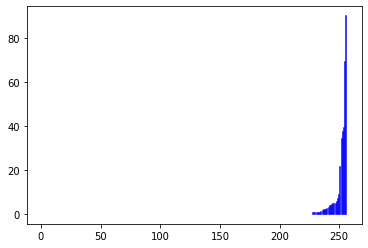

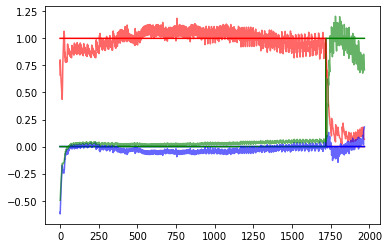

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▎                                                          | 1864/3000 [6:20:04<3:31:58, 11.20s/it]

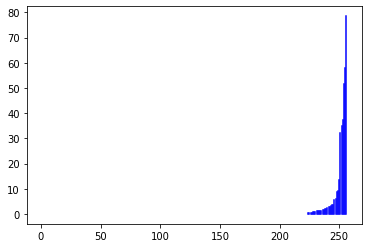

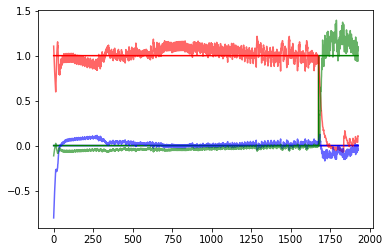

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▌                                                          | 1869/3000 [6:21:01<3:30:01, 11.14s/it]

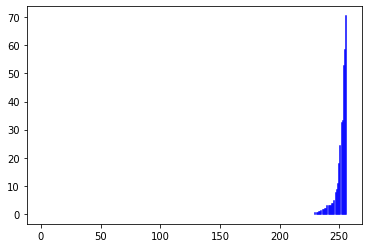

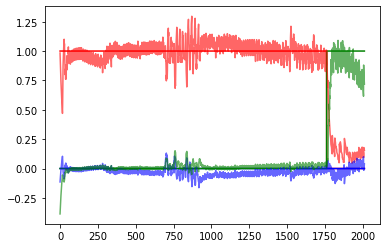

 62%|████████████████████████████████████████████████████████████████████████████████████████████████▊                                                          | 1874/3000 [6:21:56<3:21:44, 10.75s/it]

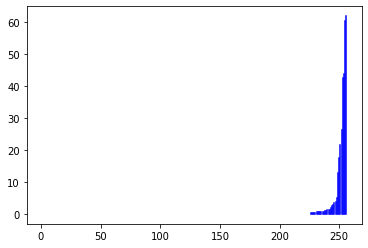

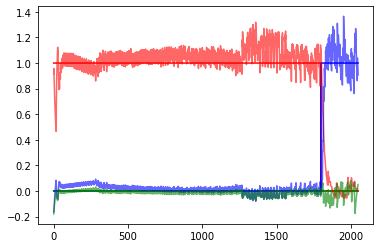

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████                                                          | 1879/3000 [6:22:53<3:26:09, 11.03s/it]

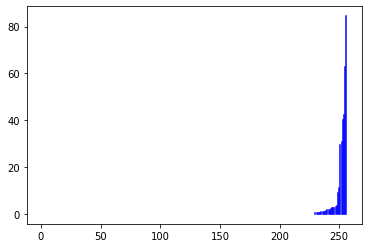

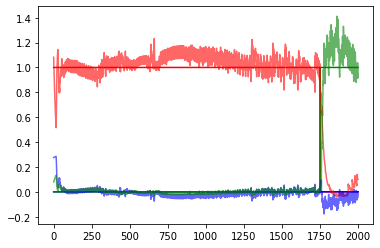

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▎                                                         | 1884/3000 [6:23:51<3:25:00, 11.02s/it]

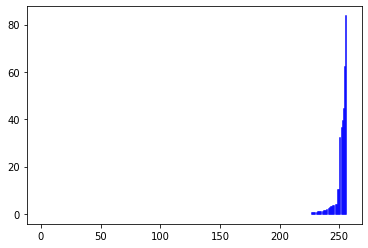

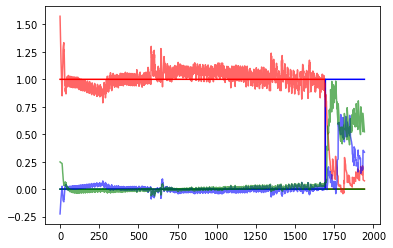

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▌                                                         | 1889/3000 [6:24:49<3:25:15, 11.09s/it]

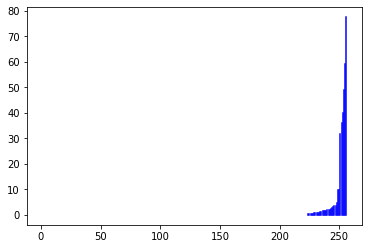

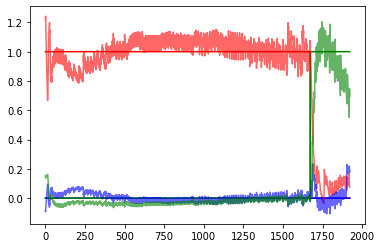

 63%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                                                         | 1894/3000 [6:25:46<3:22:19, 10.98s/it]

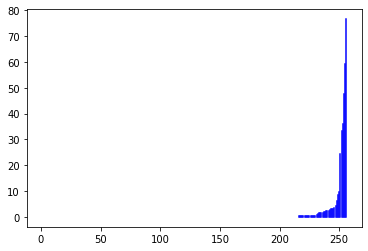

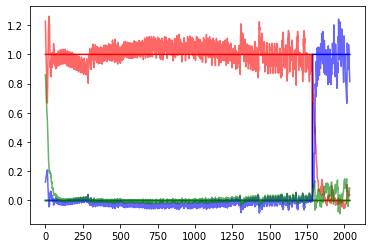

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████                                                         | 1899/3000 [6:26:46<3:29:42, 11.43s/it]

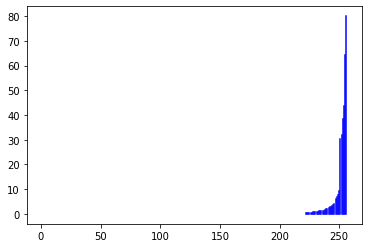

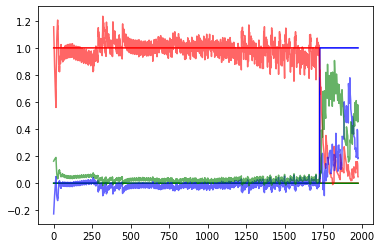

 63%|██████████████████████████████████████████████████████████████████████████████████████████████████▎                                                        | 1904/3000 [6:28:29<4:18:08, 14.13s/it]

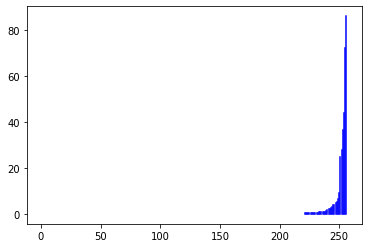

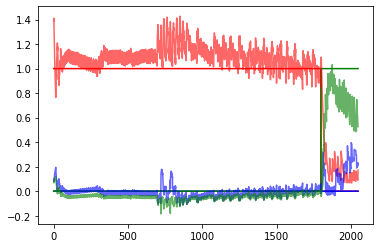

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                                                        | 1909/3000 [6:29:26<3:25:10, 11.28s/it]

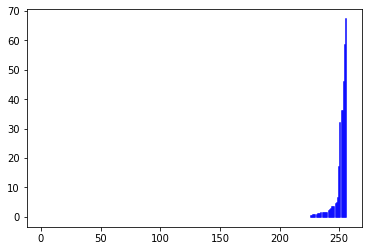

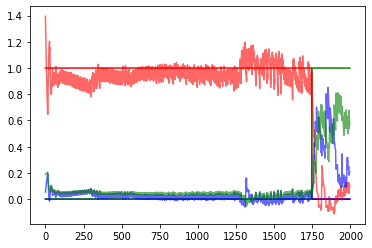

 64%|██████████████████████████████████████████████████████████████████████████████████████████████████▉                                                        | 1914/3000 [6:30:22<3:22:17, 11.18s/it]

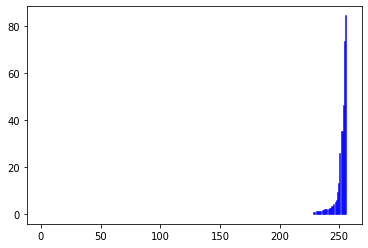

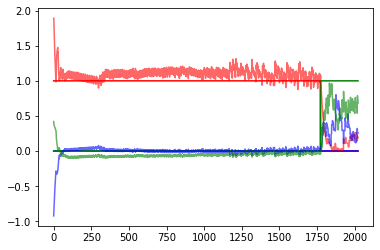

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▏                                                       | 1919/3000 [6:31:19<3:19:22, 11.07s/it]

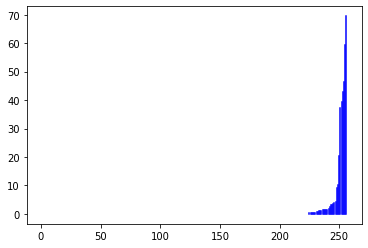

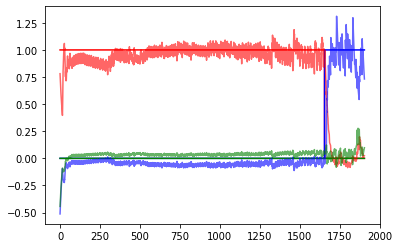

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                                                       | 1924/3000 [6:32:17<3:22:34, 11.30s/it]

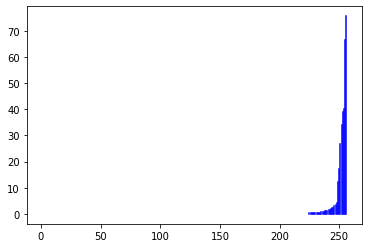

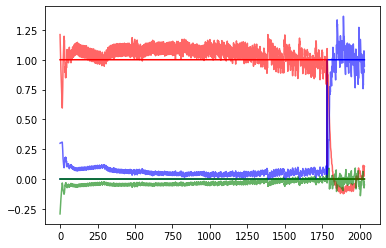

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                                                       | 1929/3000 [6:33:16<3:21:41, 11.30s/it]

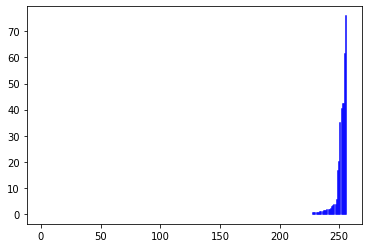

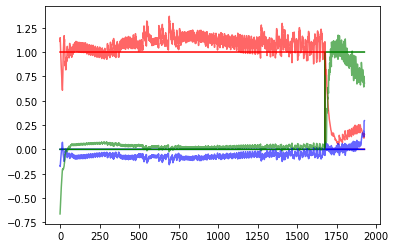

 64%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                                                       | 1934/3000 [6:34:13<3:09:19, 10.66s/it]

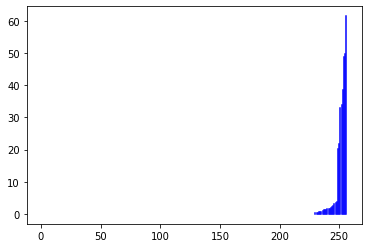

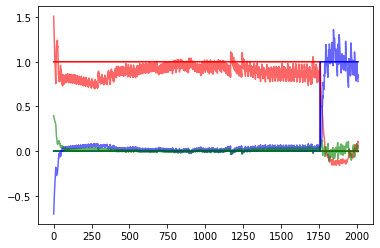

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                      | 1939/3000 [6:35:09<3:13:10, 10.92s/it]

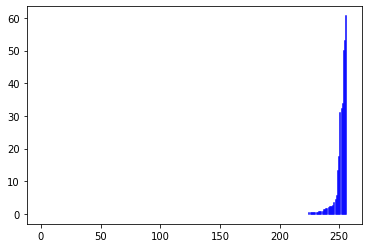

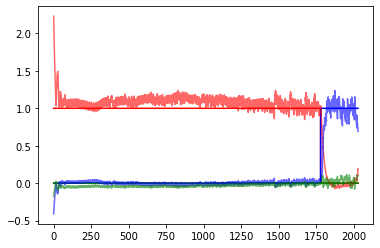

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                      | 1944/3000 [6:36:03<3:04:49, 10.50s/it]

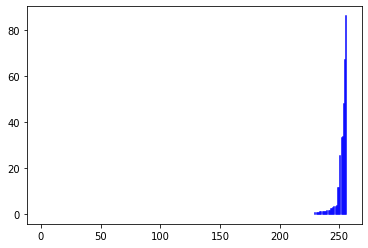

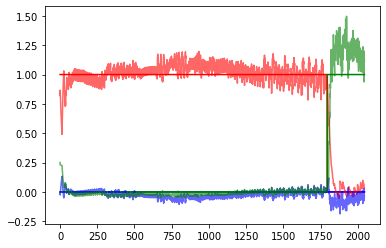

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                      | 1949/3000 [6:36:59<3:10:34, 10.88s/it]

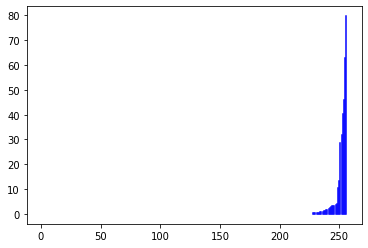

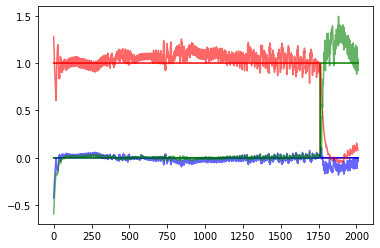

 65%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                      | 1954/3000 [6:38:41<4:00:52, 13.82s/it]

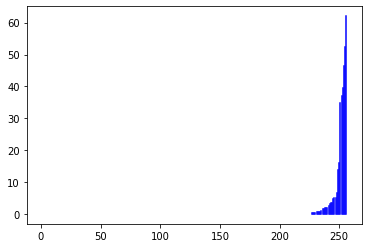

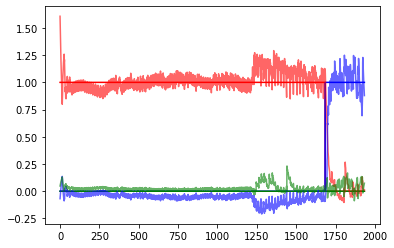

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                     | 1959/3000 [6:39:38<3:22:13, 11.66s/it]

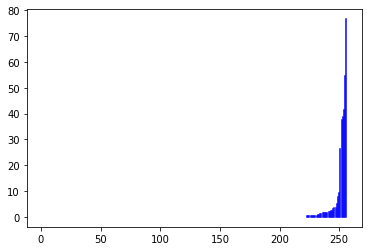

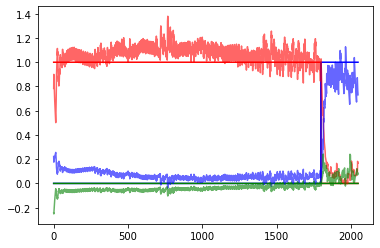

 65%|█████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                     | 1964/3000 [6:40:35<3:05:58, 10.77s/it]

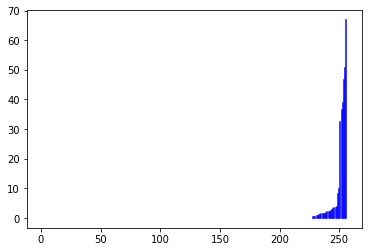

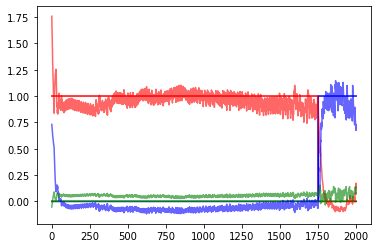

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                     | 1969/3000 [6:41:33<3:11:22, 11.14s/it]

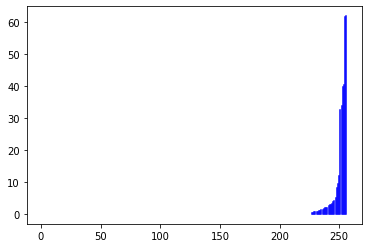

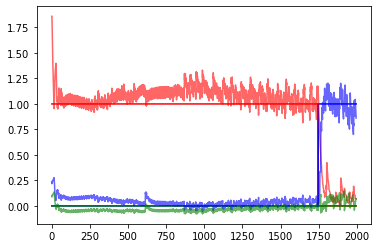

 66%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                     | 1974/3000 [6:42:31<3:08:40, 11.03s/it]

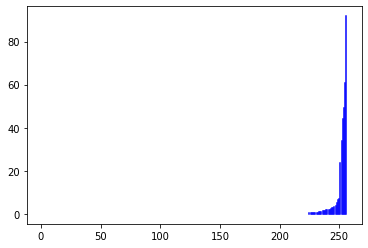

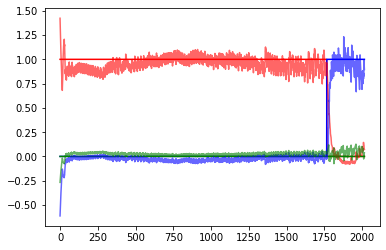

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▏                                                    | 1979/3000 [6:43:28<3:06:38, 10.97s/it]

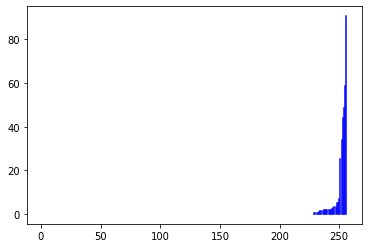

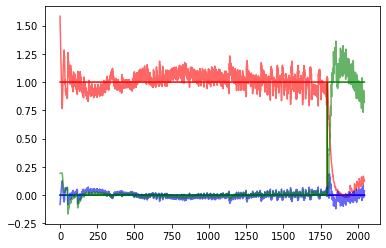

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                    | 1984/3000 [6:44:27<3:12:25, 11.36s/it]

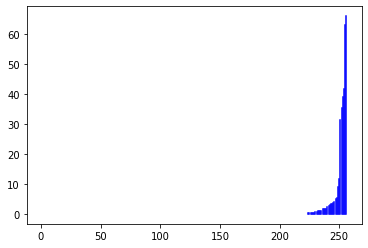

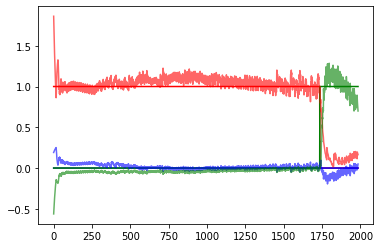

 66%|██████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                    | 1989/3000 [6:45:23<3:03:18, 10.88s/it]

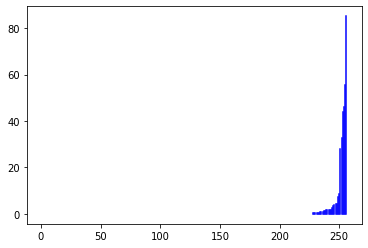

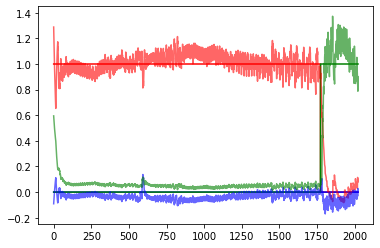

 66%|███████████████████████████████████████████████████████████████████████████████████████████████████████                                                    | 1994/3000 [6:46:18<2:57:13, 10.57s/it]

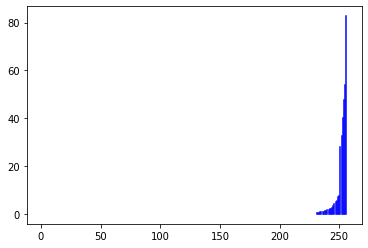

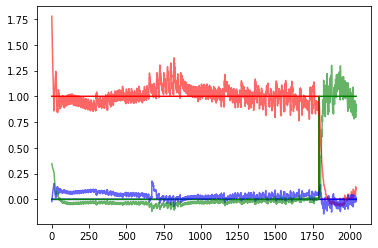

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                   | 1999/3000 [6:47:14<2:59:42, 10.77s/it]

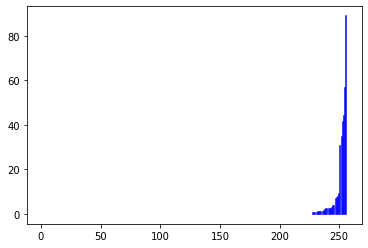

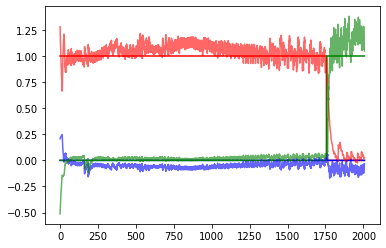

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                   | 2004/3000 [6:48:58<3:59:19, 14.42s/it]

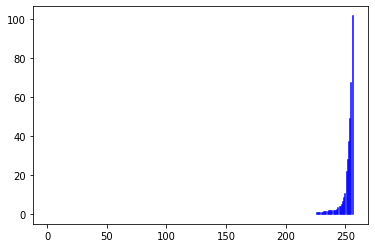

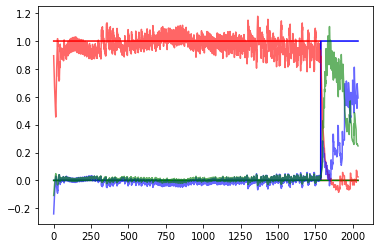

 67%|███████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                   | 2009/3000 [6:49:52<3:01:46, 11.01s/it]

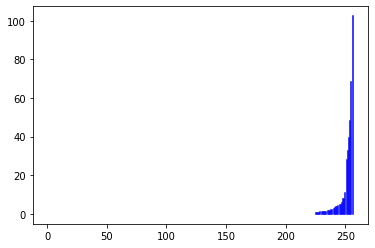

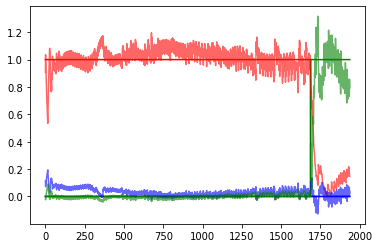

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████                                                   | 2014/3000 [6:50:45<2:46:05, 10.11s/it]

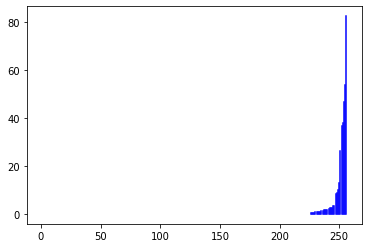

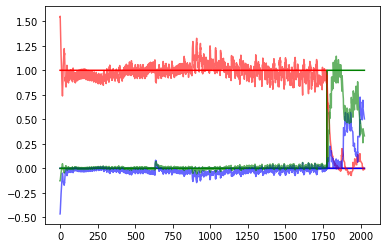

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                  | 2019/3000 [6:51:39<2:51:48, 10.51s/it]

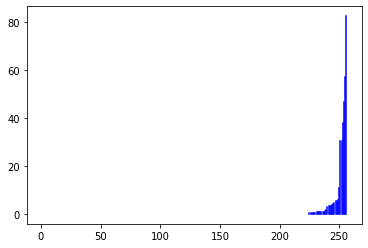

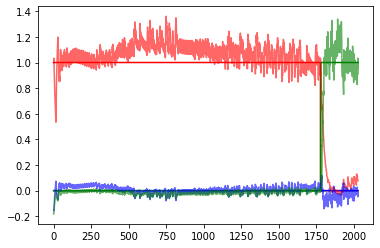

 67%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                  | 2024/3000 [6:52:33<2:52:52, 10.63s/it]

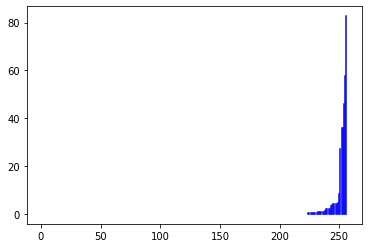

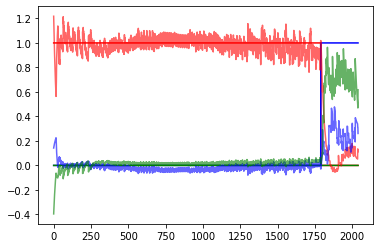

 68%|████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                  | 2029/3000 [6:53:30<2:55:40, 10.86s/it]

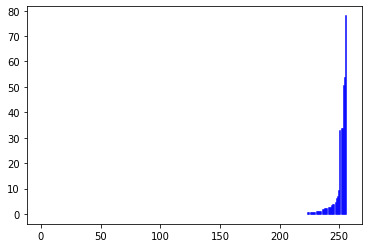

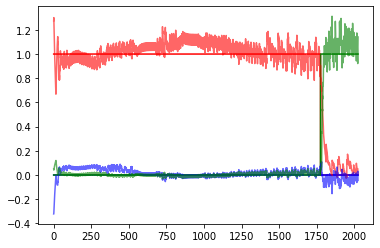

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████                                                  | 2034/3000 [6:54:26<2:53:52, 10.80s/it]

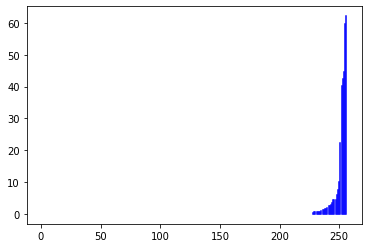

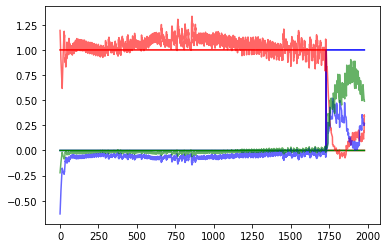

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                                 | 2039/3000 [6:55:23<2:56:55, 11.05s/it]

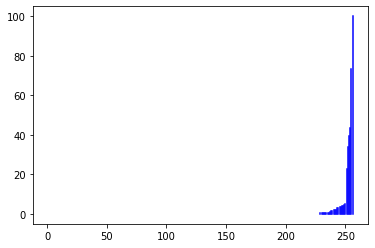

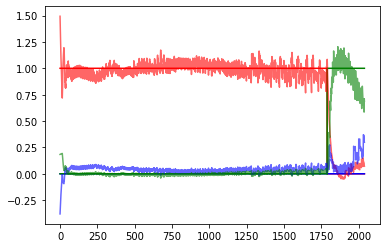

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                                 | 2044/3000 [6:56:19<2:49:16, 10.62s/it]

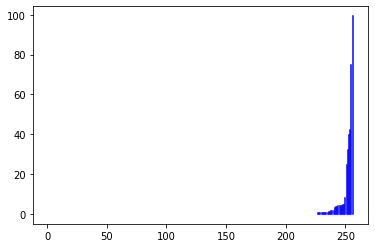

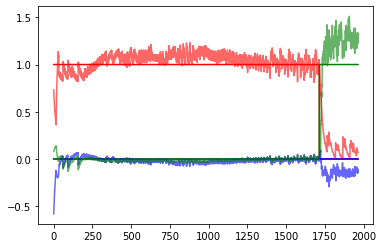

 68%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                                 | 2049/3000 [6:57:14<2:44:58, 10.41s/it]

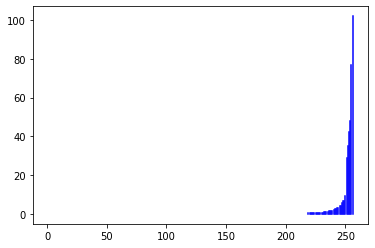

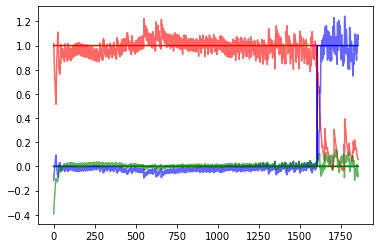

 68%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                                                 | 2054/3000 [6:59:02<3:51:09, 14.66s/it]

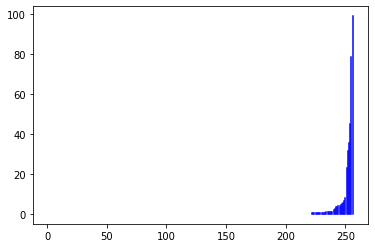

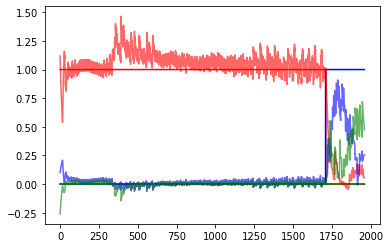

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                                | 2059/3000 [6:59:59<3:04:31, 11.77s/it]

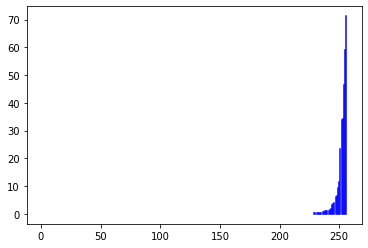

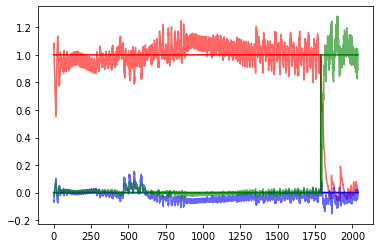

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                                | 2064/3000 [7:00:56<2:50:29, 10.93s/it]

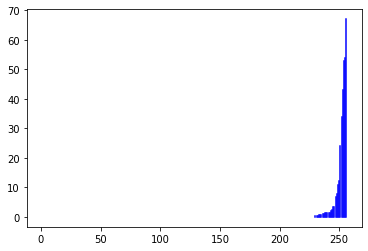

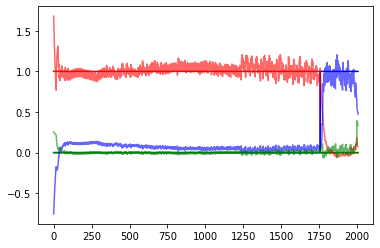

 69%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                                | 2069/3000 [7:01:53<2:50:19, 10.98s/it]

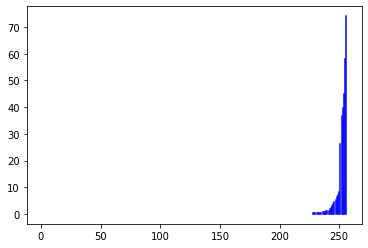

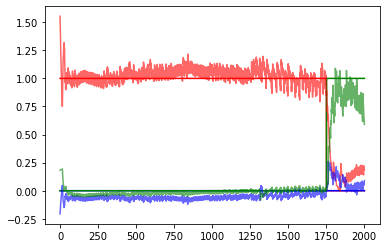

 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                               | 2074/3000 [7:02:49<2:48:37, 10.93s/it]

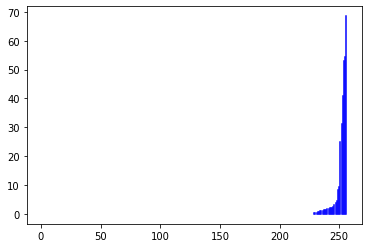

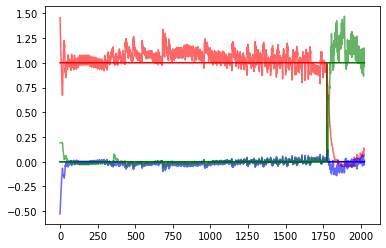

 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                               | 2079/3000 [7:03:49<2:52:04, 11.21s/it]

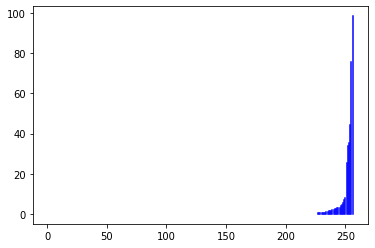

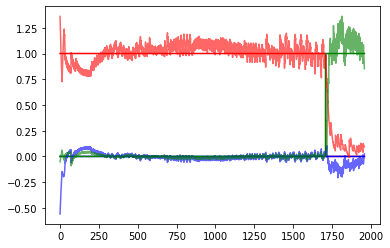

 69%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                               | 2084/3000 [7:04:44<2:40:20, 10.50s/it]

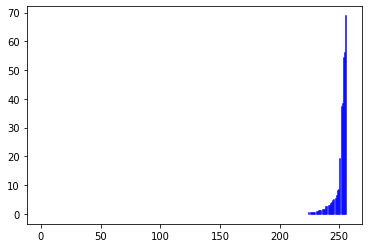

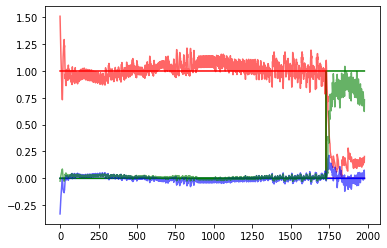

 70%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                               | 2089/3000 [7:05:39<2:38:05, 10.41s/it]

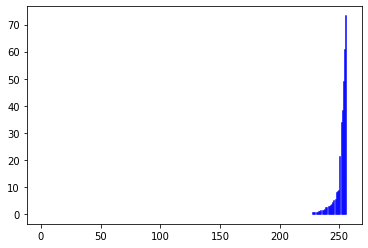

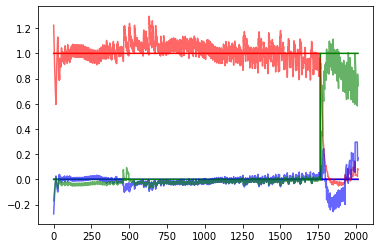

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                              | 2094/3000 [7:06:33<2:34:46, 10.25s/it]

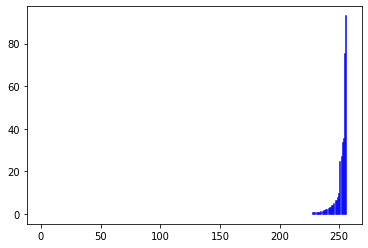

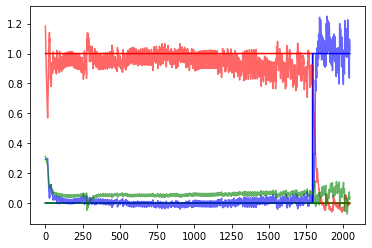

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                              | 2099/3000 [7:07:32<2:48:24, 11.21s/it]

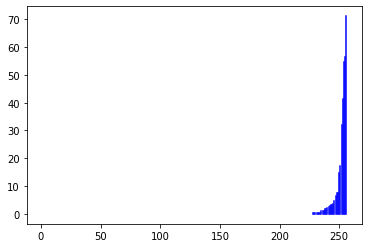

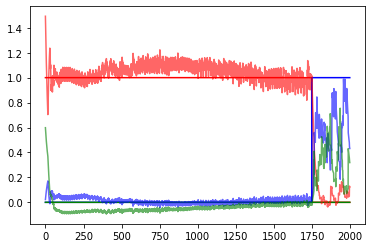

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                              | 2104/3000 [7:09:15<3:30:21, 14.09s/it]

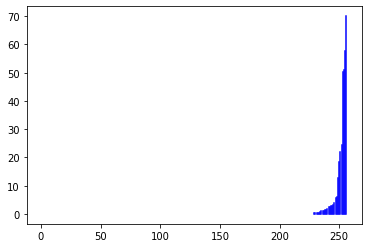

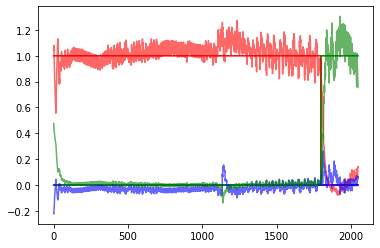

 70%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                              | 2109/3000 [7:10:14<2:57:51, 11.98s/it]

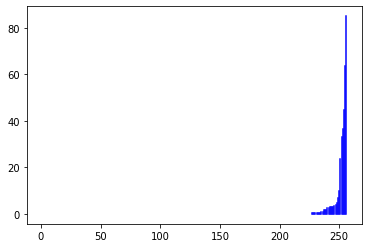

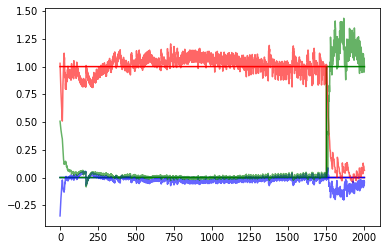

 70%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                             | 2114/3000 [7:11:12<2:47:58, 11.38s/it]

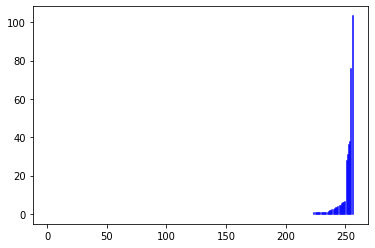

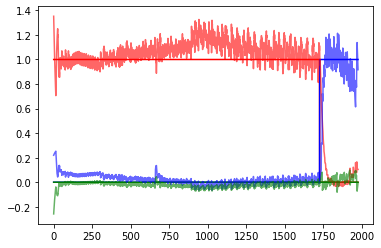

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                             | 2119/3000 [7:12:10<2:45:14, 11.25s/it]

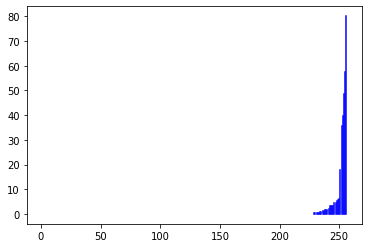

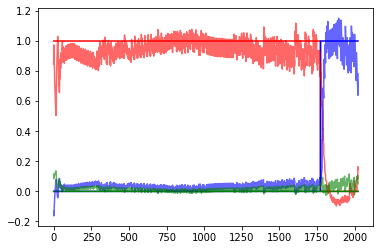

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                             | 2124/3000 [7:13:04<2:30:27, 10.31s/it]

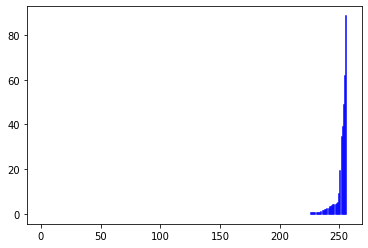

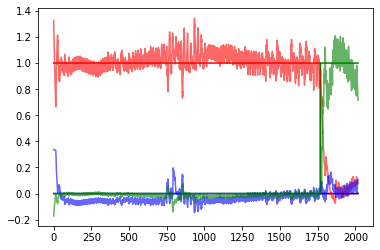

 71%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                             | 2129/3000 [7:13:59<2:34:18, 10.63s/it]

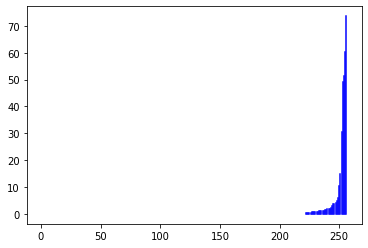

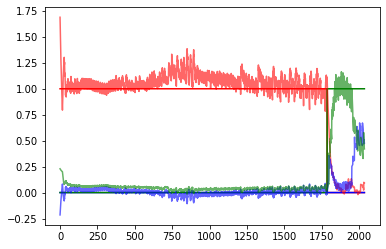

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                            | 2134/3000 [7:14:54<2:32:40, 10.58s/it]

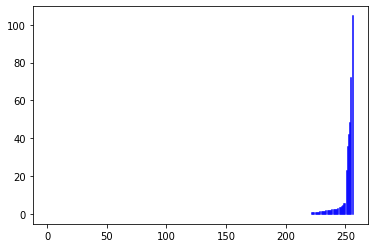

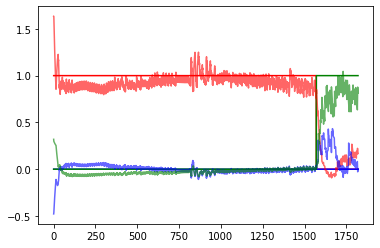

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                            | 2139/3000 [7:15:53<2:39:35, 11.12s/it]

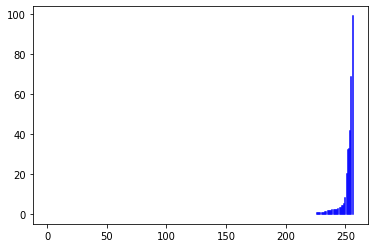

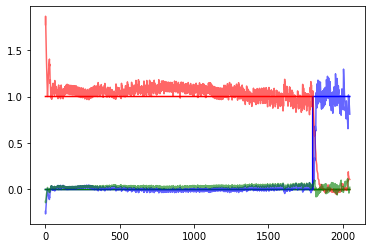

 71%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                            | 2144/3000 [7:16:50<2:37:56, 11.07s/it]

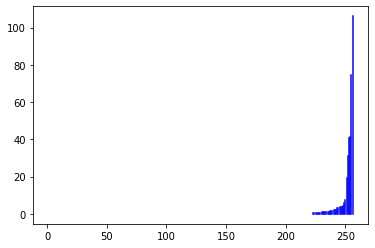

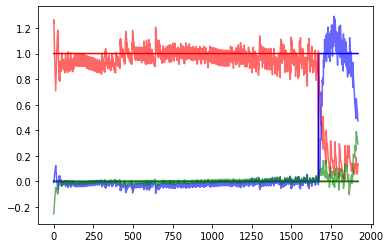

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████                                            | 2149/3000 [7:17:47<2:35:04, 10.93s/it]

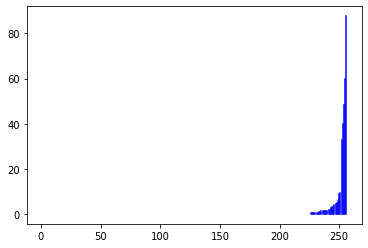

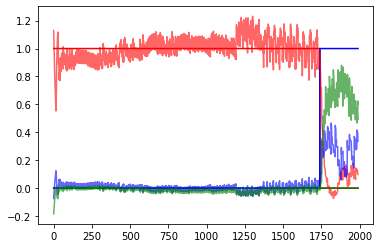

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                           | 2154/3000 [7:19:29<3:12:30, 13.65s/it]

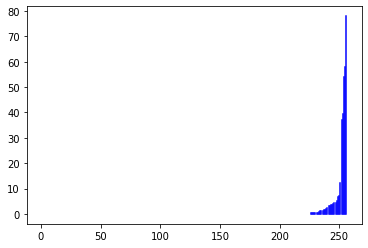

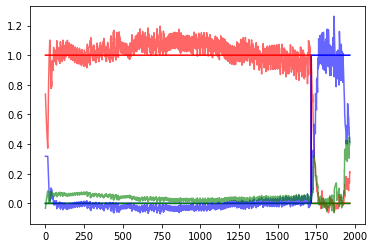

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                           | 2159/3000 [7:20:29<2:45:57, 11.84s/it]

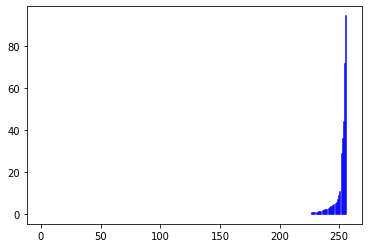

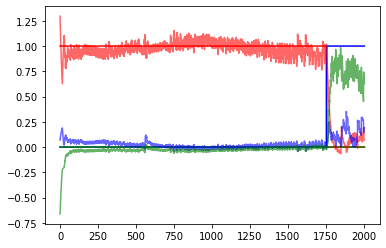

 72%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                           | 2164/3000 [7:21:25<2:32:27, 10.94s/it]

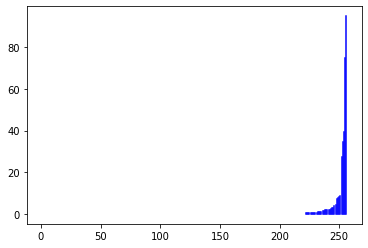

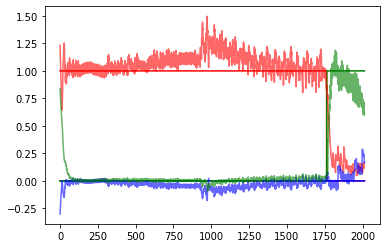

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                           | 2169/3000 [7:22:20<2:27:27, 10.65s/it]

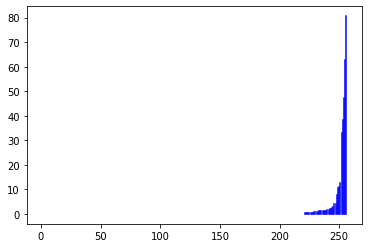

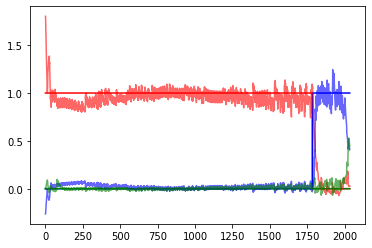

 72%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                          | 2174/3000 [7:23:14<2:27:19, 10.70s/it]

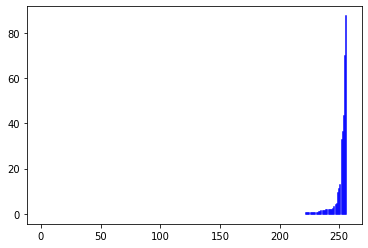

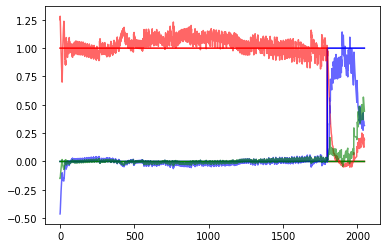

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                          | 2179/3000 [7:24:12<2:31:56, 11.10s/it]

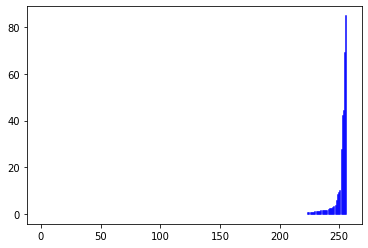

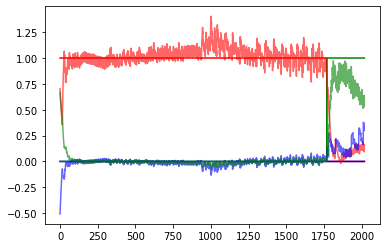

 73%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                          | 2184/3000 [7:25:10<2:33:39, 11.30s/it]

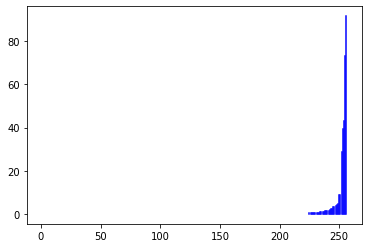

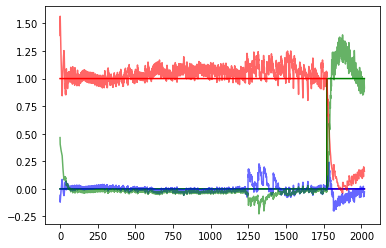

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                          | 2189/3000 [7:26:09<2:32:32, 11.28s/it]

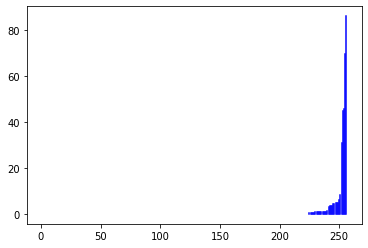

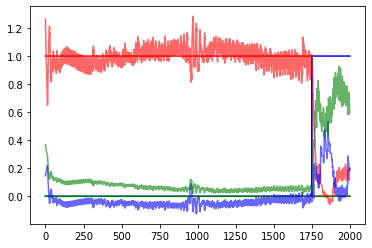

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                         | 2194/3000 [7:27:07<2:28:23, 11.05s/it]

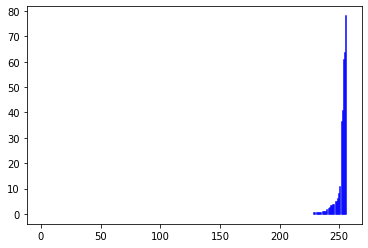

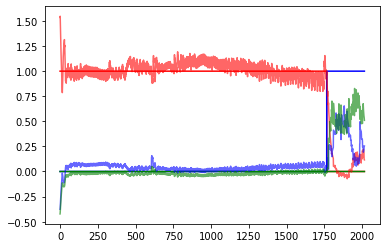

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                         | 2199/3000 [7:28:04<2:27:36, 11.06s/it]

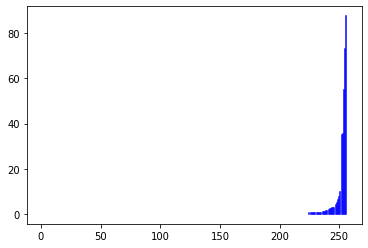

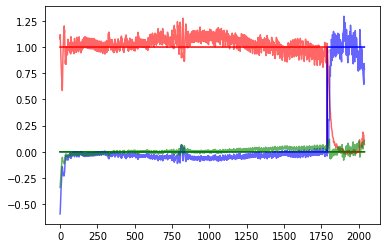

 73%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                         | 2204/3000 [7:29:51<3:12:19, 14.50s/it]

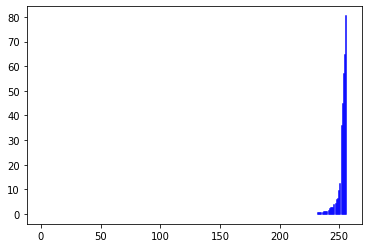

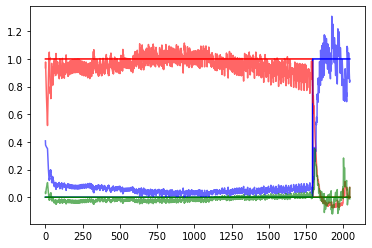

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                        | 2209/3000 [7:30:50<2:32:20, 11.56s/it]

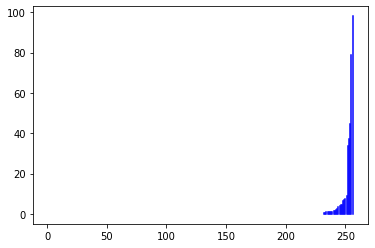

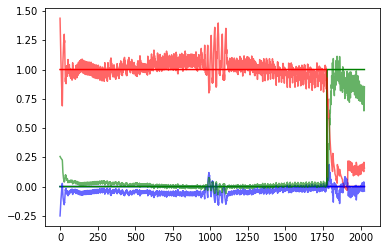

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                        | 2214/3000 [7:31:46<2:25:23, 11.10s/it]

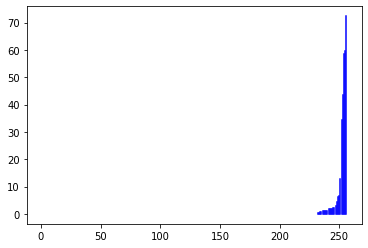

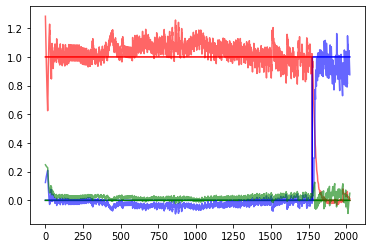

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                        | 2219/3000 [7:32:44<2:23:36, 11.03s/it]

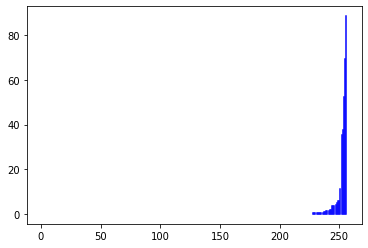

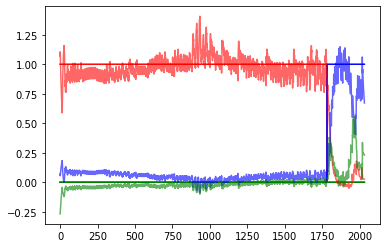

 74%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                        | 2224/3000 [7:33:41<2:23:26, 11.09s/it]

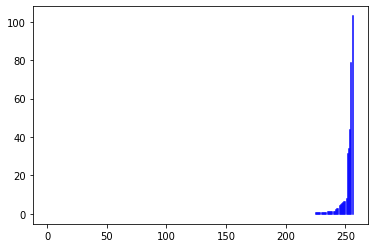

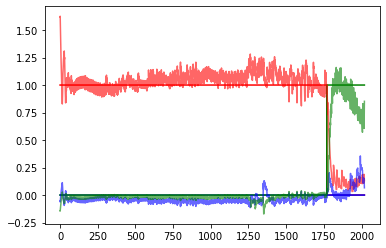

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                       | 2229/3000 [7:34:35<2:14:21, 10.46s/it]

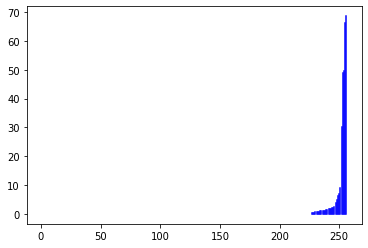

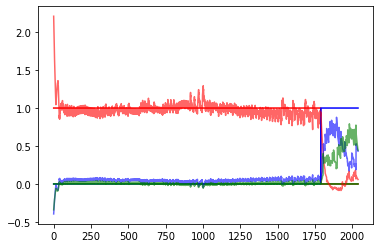

 74%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                       | 2234/3000 [7:35:28<2:10:16, 10.20s/it]

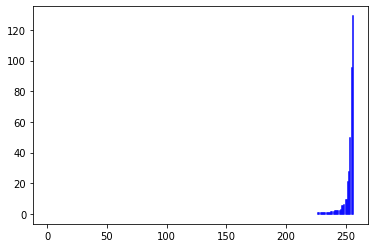

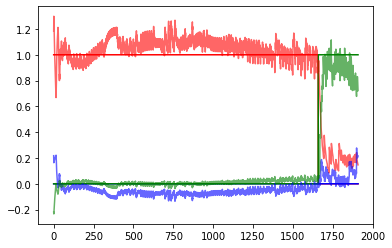

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                       | 2239/3000 [7:36:25<2:13:33, 10.53s/it]

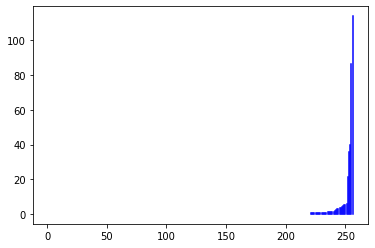

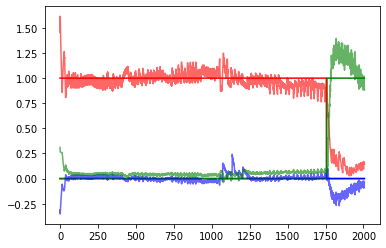

 75%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                       | 2244/3000 [7:37:23<2:21:07, 11.20s/it]

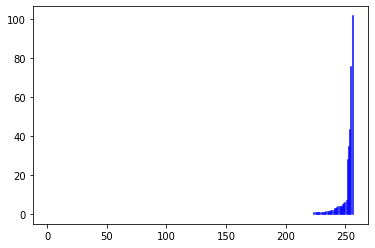

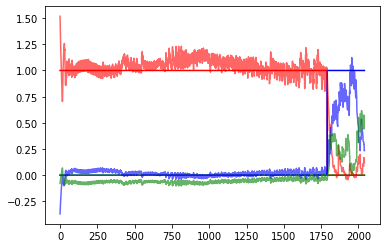

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                      | 2249/3000 [7:38:22<2:20:49, 11.25s/it]

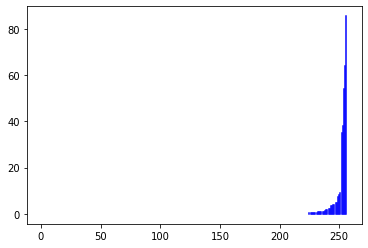

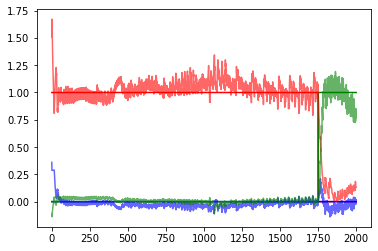

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                      | 2254/3000 [7:40:03<2:54:36, 14.04s/it]

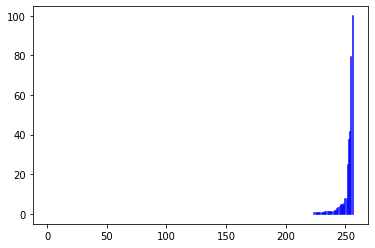

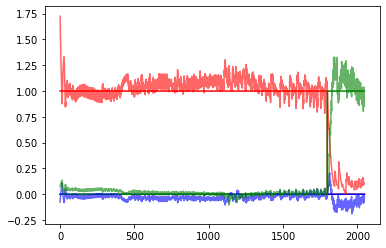

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                      | 2259/3000 [7:41:01<2:22:30, 11.54s/it]

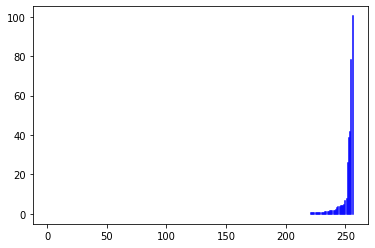

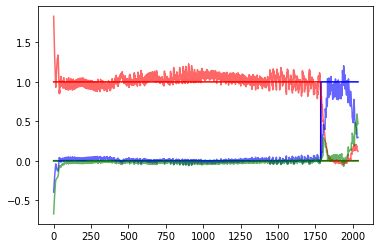

 75%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                      | 2264/3000 [7:41:56<2:11:17, 10.70s/it]

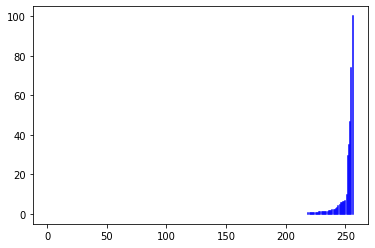

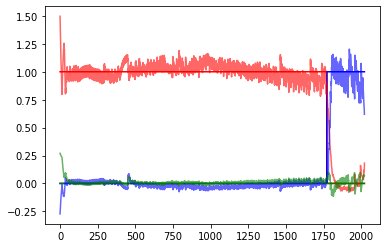

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                     | 2269/3000 [7:42:51<2:03:39, 10.15s/it]

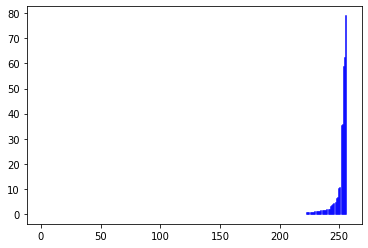

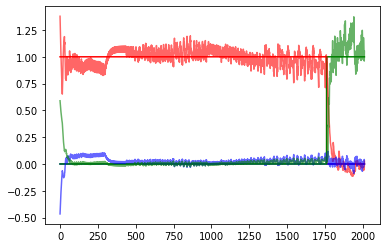

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                     | 2274/3000 [7:43:49<2:12:02, 10.91s/it]

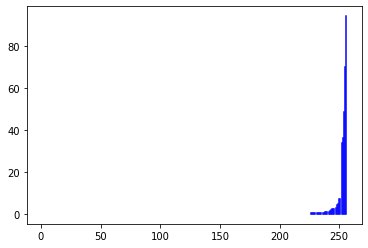

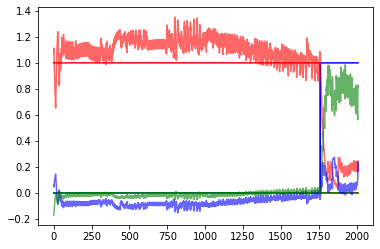

 76%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                     | 2279/3000 [7:44:47<2:14:50, 11.22s/it]

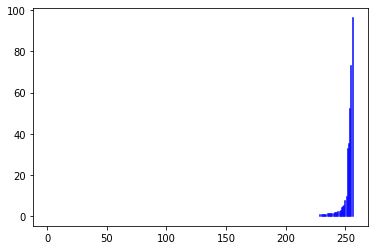

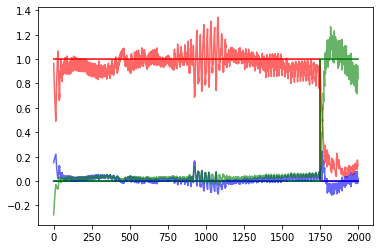

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                     | 2284/3000 [7:45:42<2:06:13, 10.58s/it]

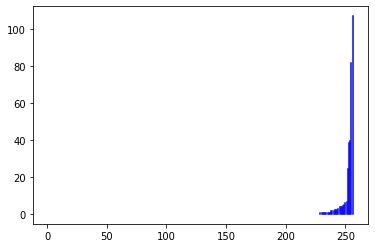

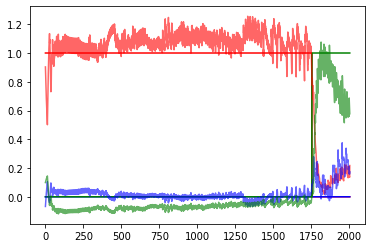

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                    | 2289/3000 [7:46:41<2:12:02, 11.14s/it]

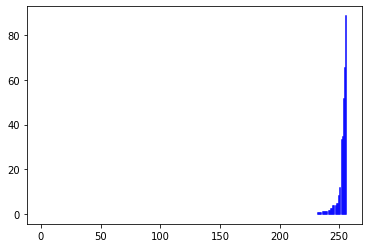

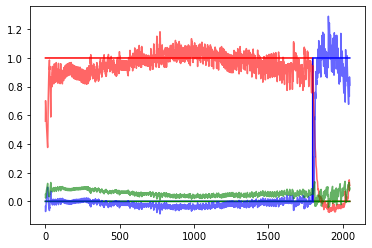

 76%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                    | 2294/3000 [7:47:39<2:09:31, 11.01s/it]

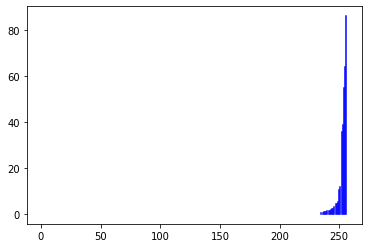

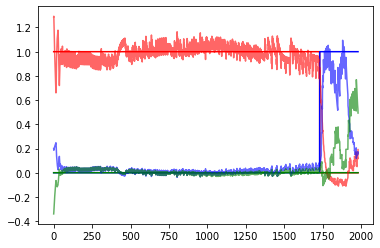

 77%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                    | 2299/3000 [7:48:35<2:08:05, 10.96s/it]

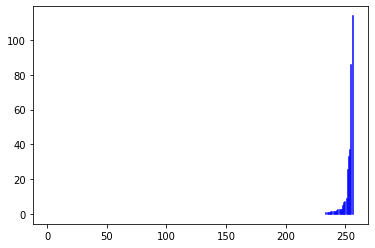

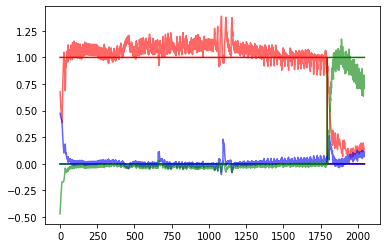

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                    | 2304/3000 [7:50:17<2:38:15, 13.64s/it]

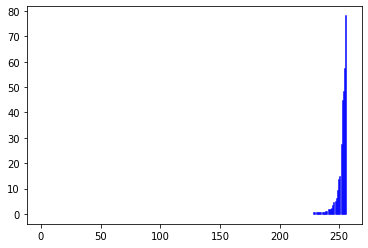

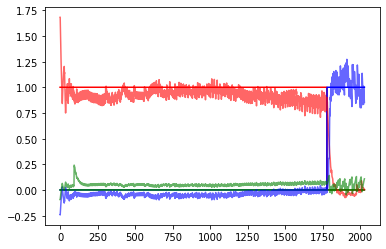

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                   | 2309/3000 [7:51:13<2:10:13, 11.31s/it]

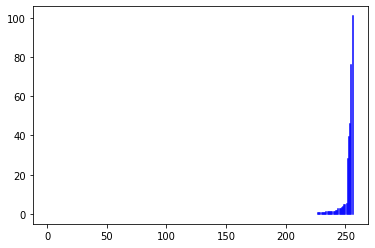

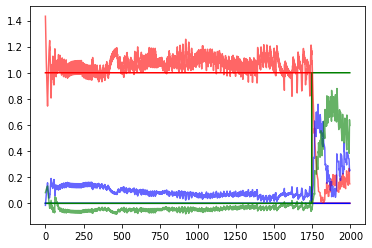

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                   | 2314/3000 [7:52:07<1:57:36, 10.29s/it]

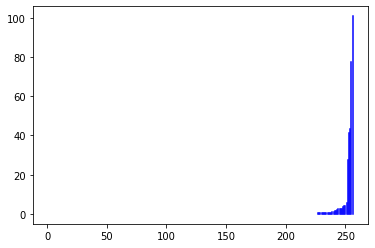

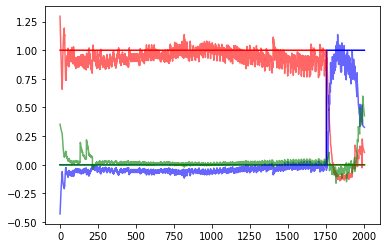

 77%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                   | 2319/3000 [7:53:03<1:59:32, 10.53s/it]

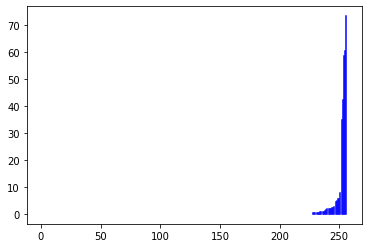

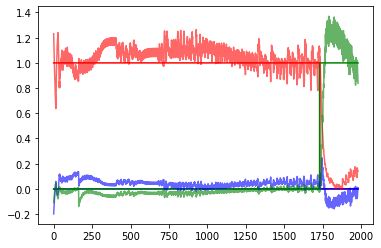

 77%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                   | 2324/3000 [7:54:01<2:04:28, 11.05s/it]

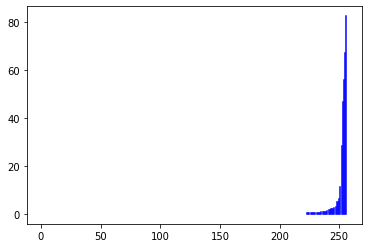

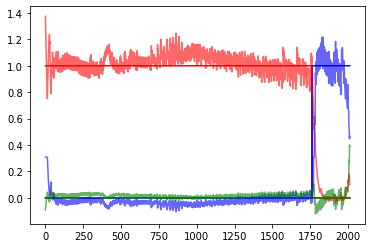

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                  | 2329/3000 [7:54:55<1:53:20, 10.14s/it]

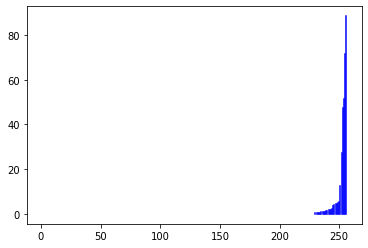

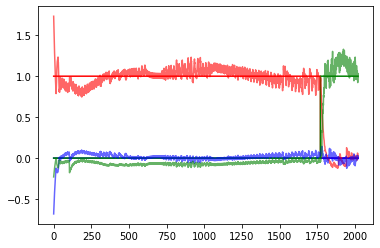

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                  | 2334/3000 [7:55:51<1:54:37, 10.33s/it]

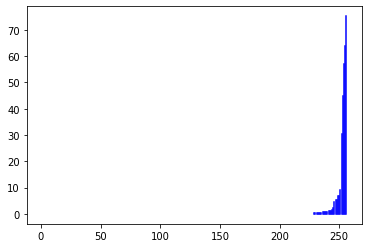

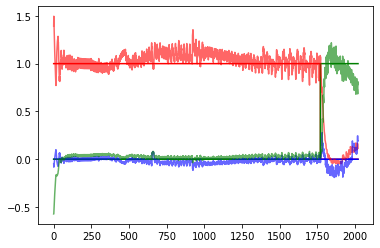

 78%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                                  | 2339/3000 [7:56:47<1:58:40, 10.77s/it]

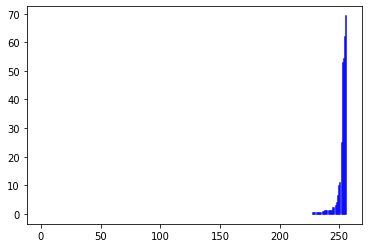

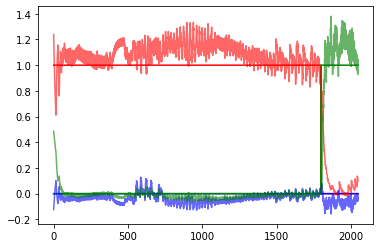

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                                  | 2344/3000 [7:57:41<1:56:07, 10.62s/it]

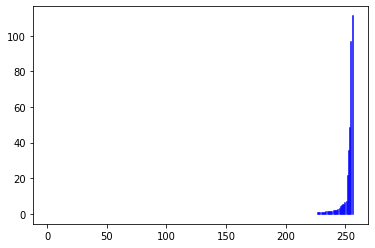

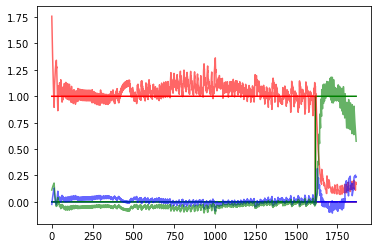

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                                 | 2349/3000 [7:58:40<2:00:32, 11.11s/it]

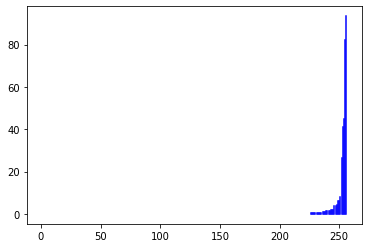

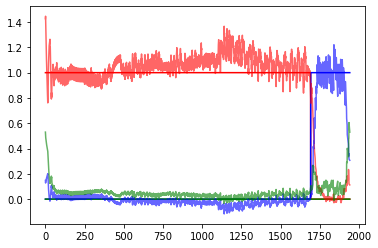

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                                 | 2354/3000 [8:00:24<2:34:16, 14.33s/it]

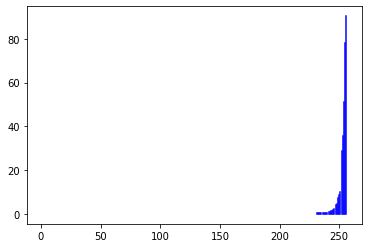

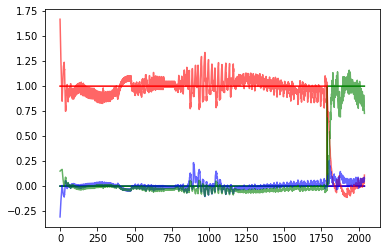

 79%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                 | 2359/3000 [8:01:19<1:57:19, 10.98s/it]

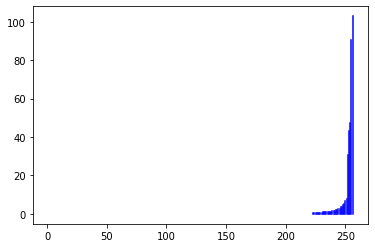

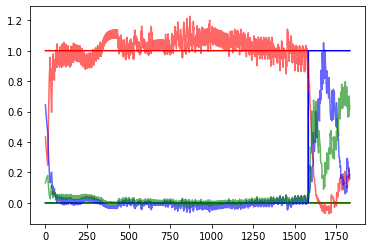

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                                | 2364/3000 [8:02:13<1:51:23, 10.51s/it]

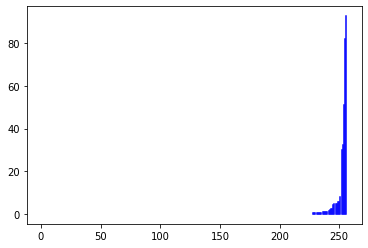

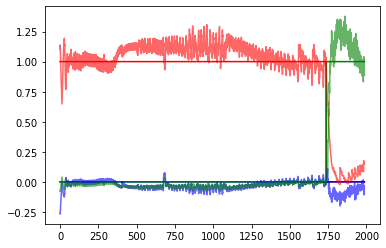

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                                | 2369/3000 [8:03:10<1:55:33, 10.99s/it]

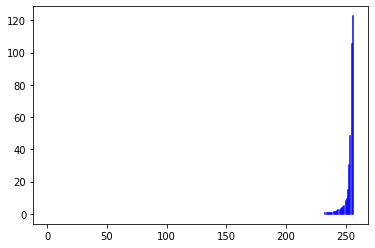

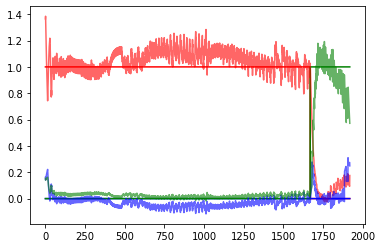

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                                | 2374/3000 [8:04:07<1:53:16, 10.86s/it]

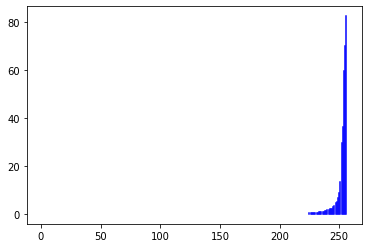

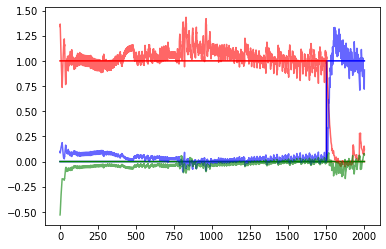

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                                | 2379/3000 [8:05:03<1:50:48, 10.71s/it]

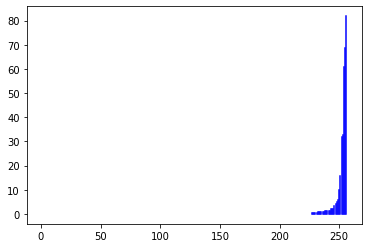

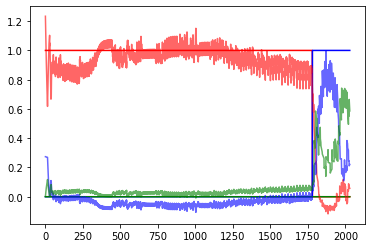

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                               | 2384/3000 [8:06:01<1:52:51, 10.99s/it]

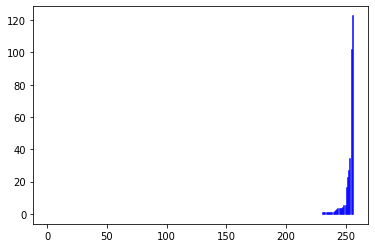

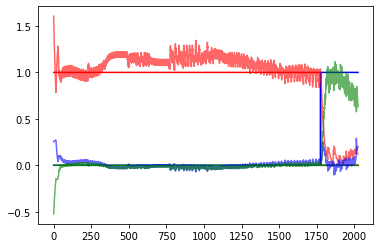

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                               | 2389/3000 [8:06:56<1:51:25, 10.94s/it]

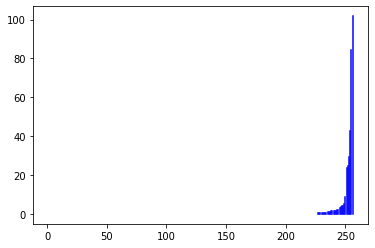

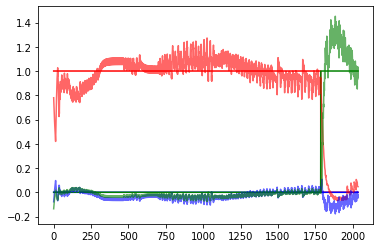

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                               | 2394/3000 [8:07:53<1:52:00, 11.09s/it]

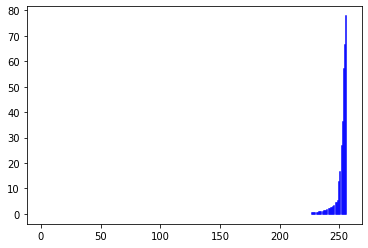

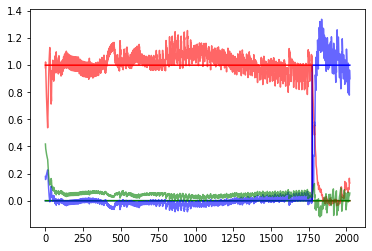

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                               | 2399/3000 [8:08:51<1:49:19, 10.91s/it]

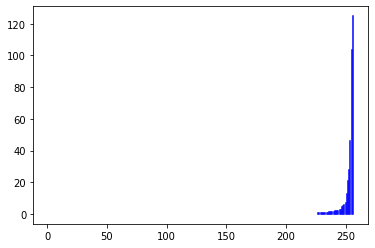

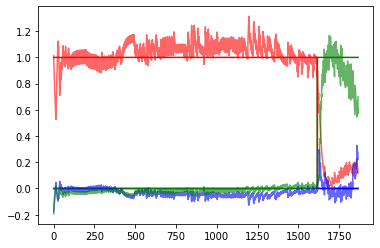

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                              | 2404/3000 [8:10:35<2:24:26, 14.54s/it]

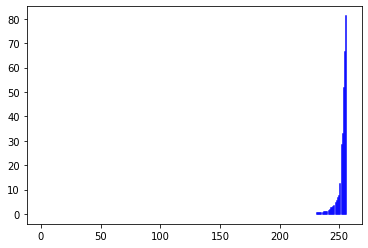

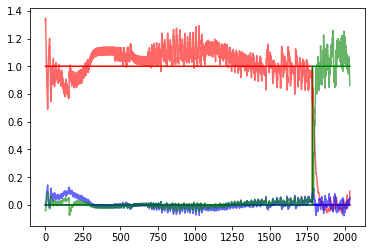

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                              | 2409/3000 [8:11:32<1:55:19, 11.71s/it]

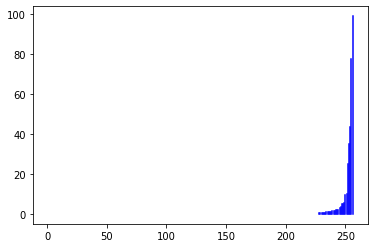

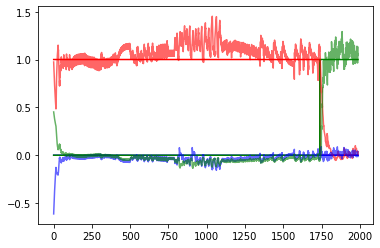

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                              | 2414/3000 [8:12:29<1:49:55, 11.26s/it]

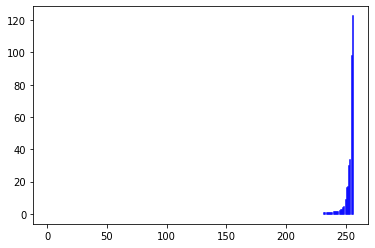

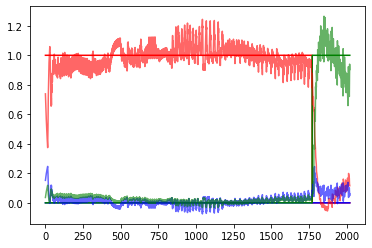

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                              | 2419/3000 [8:13:25<1:43:42, 10.71s/it]

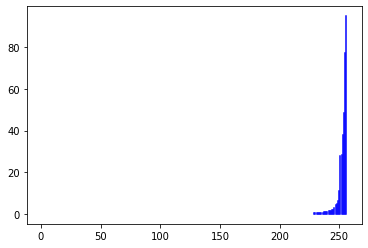

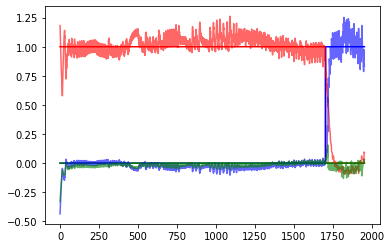

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                             | 2424/3000 [8:14:25<1:48:34, 11.31s/it]

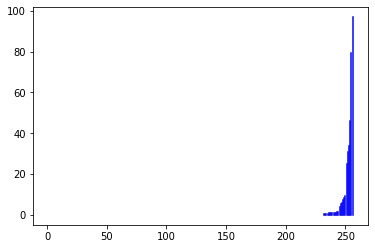

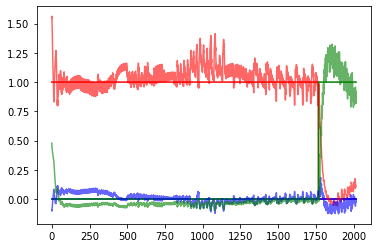

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                             | 2429/3000 [8:15:20<1:41:46, 10.70s/it]

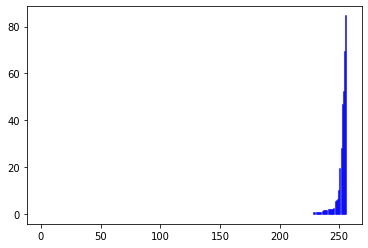

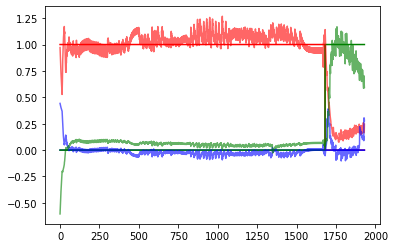

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                             | 2434/3000 [8:16:18<1:42:18, 10.85s/it]

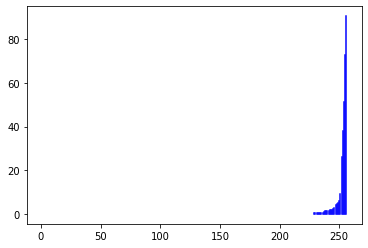

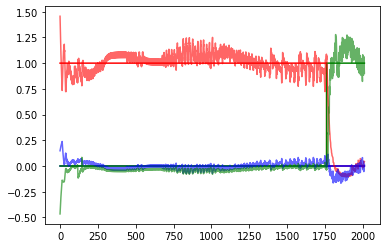

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                             | 2439/3000 [8:17:14<1:41:06, 10.81s/it]

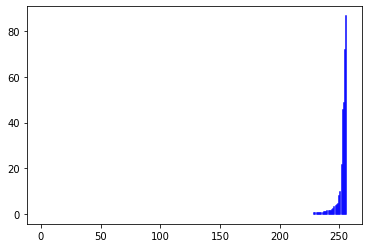

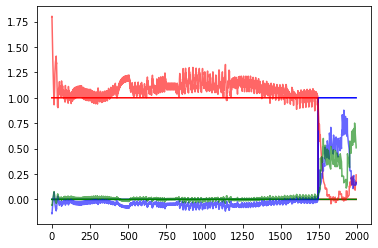

 81%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                            | 2444/3000 [8:18:07<1:38:18, 10.61s/it]

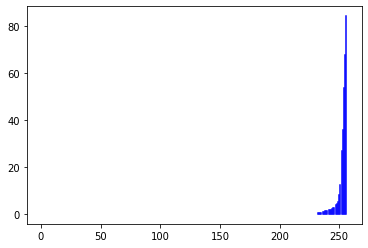

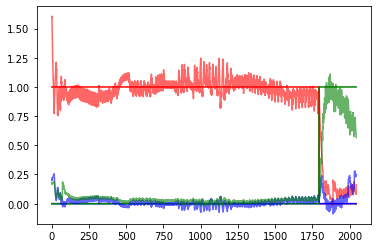

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 2449/3000 [8:19:05<1:40:43, 10.97s/it]

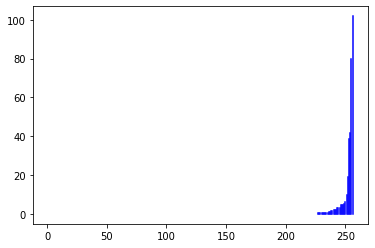

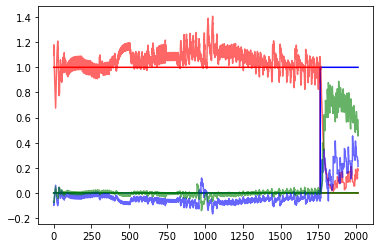

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 2454/3000 [8:20:45<2:06:02, 13.85s/it]

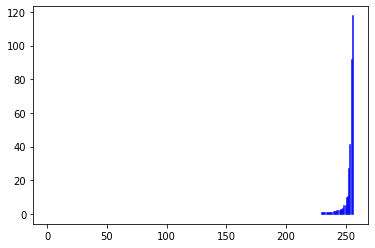

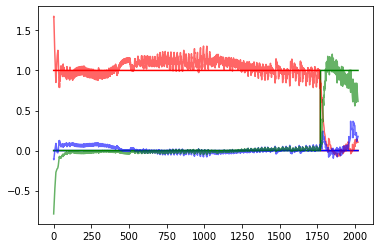

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                            | 2459/3000 [8:21:43<1:44:36, 11.60s/it]

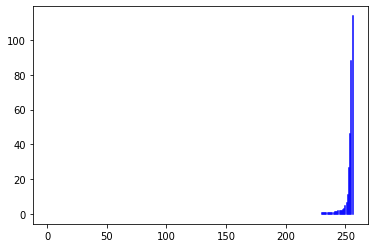

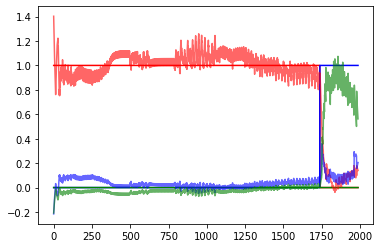

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                           | 2464/3000 [8:22:41<1:38:39, 11.04s/it]

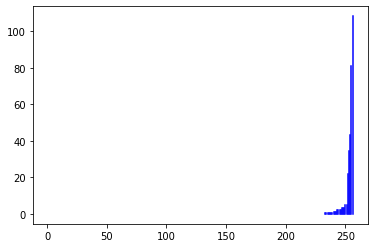

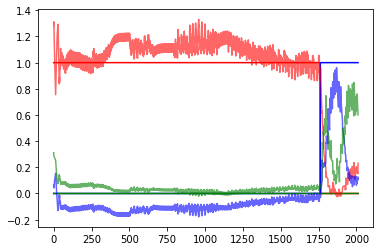

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                           | 2469/3000 [8:23:37<1:35:39, 10.81s/it]

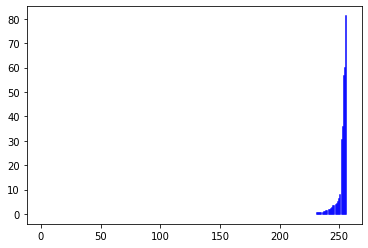

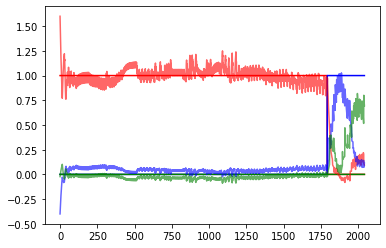

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 2474/3000 [8:24:32<1:34:34, 10.79s/it]

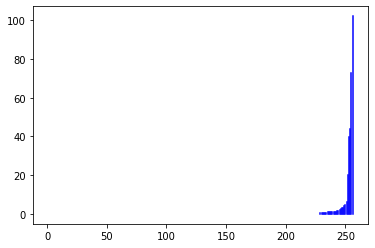

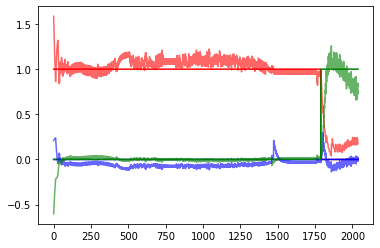

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                           | 2479/3000 [8:25:29<1:34:08, 10.84s/it]

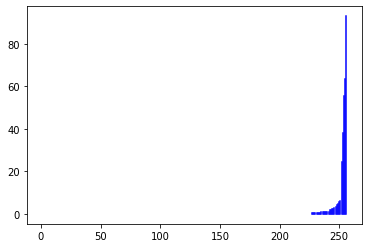

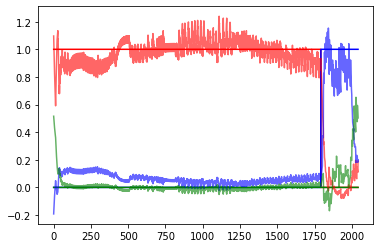

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                          | 2484/3000 [8:26:25<1:33:32, 10.88s/it]

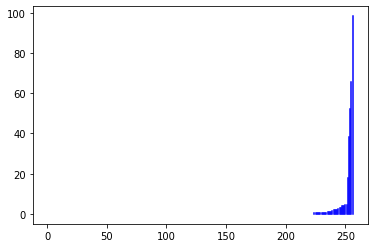

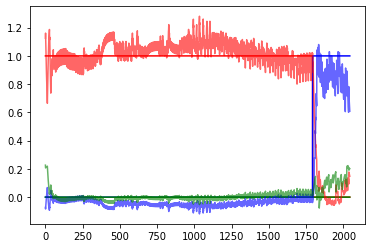

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                          | 2489/3000 [8:27:21<1:31:45, 10.77s/it]

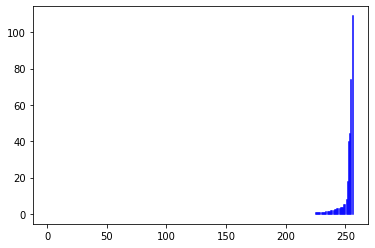

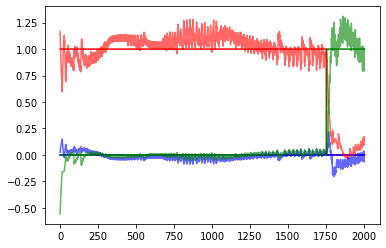

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                          | 2494/3000 [8:28:15<1:29:22, 10.60s/it]

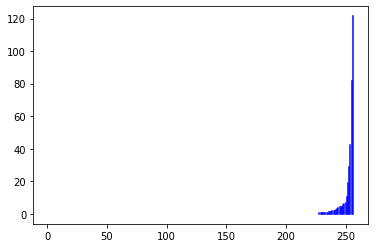

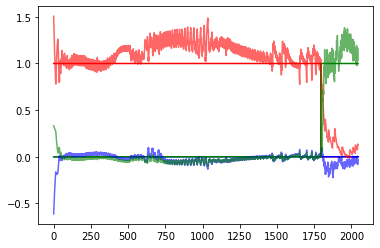

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                          | 2499/3000 [8:29:14<1:33:14, 11.17s/it]

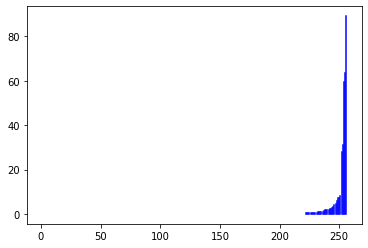

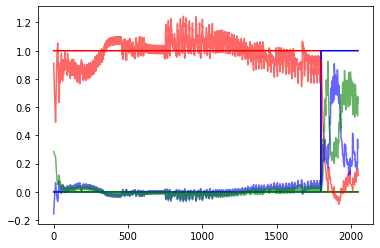

 83%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 2504/3000 [8:30:59<1:58:17, 14.31s/it]

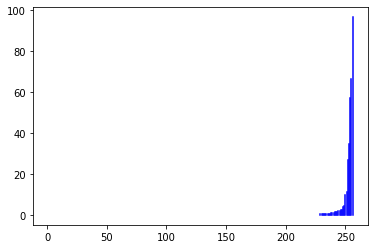

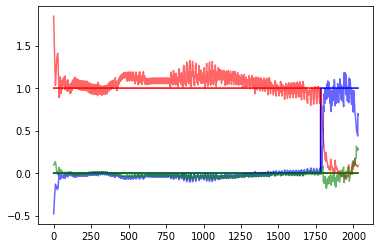

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 2509/3000 [8:31:53<1:29:01, 10.88s/it]

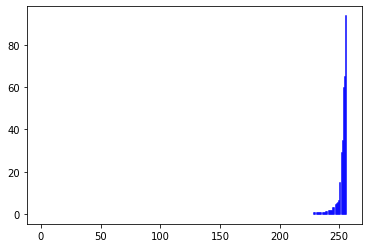

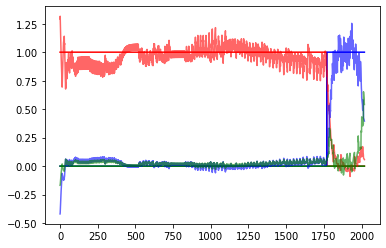

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 2514/3000 [8:32:47<1:25:35, 10.57s/it]

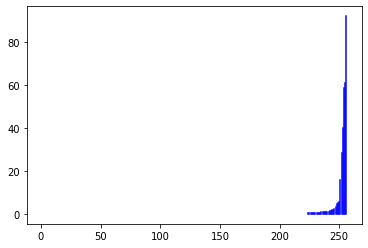

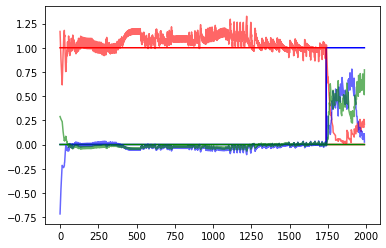

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                        | 2519/3000 [8:33:45<1:28:09, 11.00s/it]

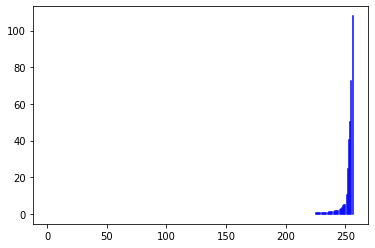

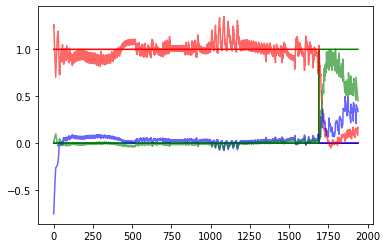

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                        | 2524/3000 [8:34:39<1:20:58, 10.21s/it]

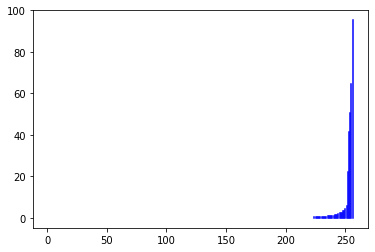

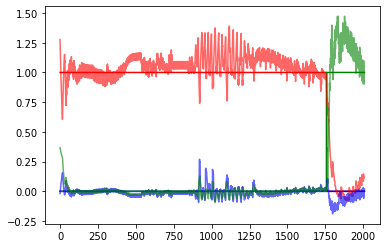

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                        | 2529/3000 [8:35:30<1:17:13,  9.84s/it]

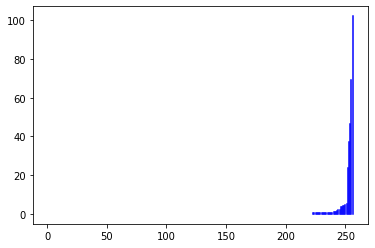

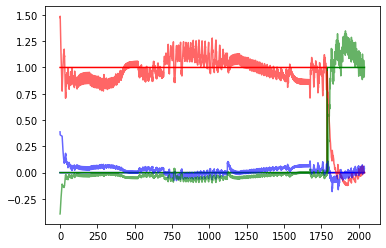

 84%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 2534/3000 [8:36:27<1:23:27, 10.75s/it]

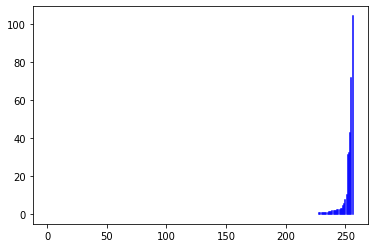

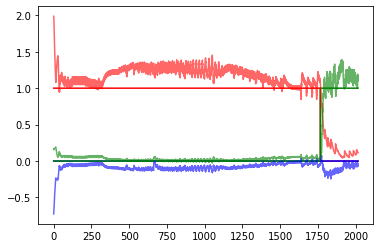

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 2539/3000 [8:37:23<1:24:08, 10.95s/it]

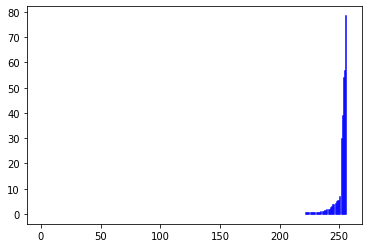

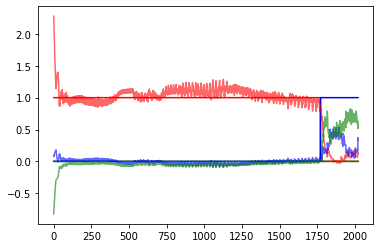

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                       | 2544/3000 [8:38:19<1:19:12, 10.42s/it]

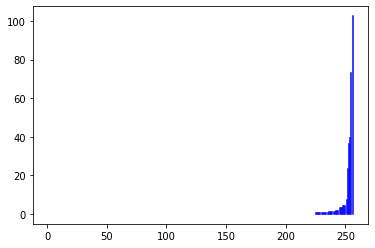

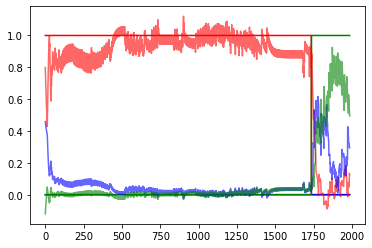

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                       | 2549/3000 [8:39:14<1:20:26, 10.70s/it]

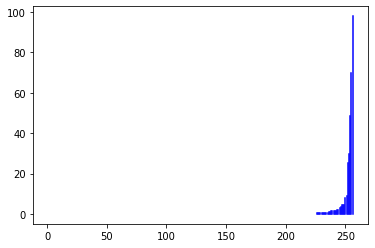

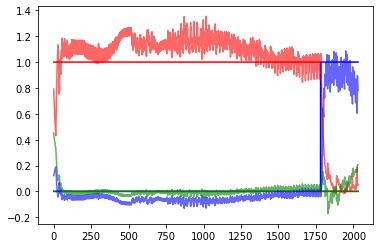

 85%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 2554/3000 [8:40:58<1:43:24, 13.91s/it]

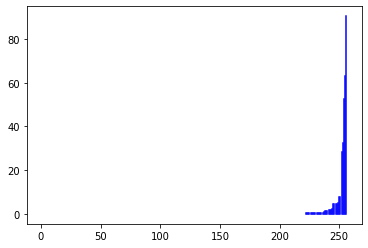

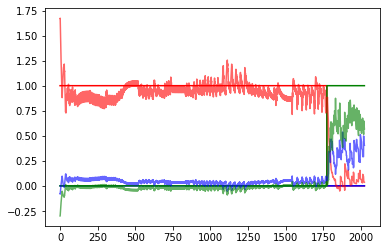

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                      | 2559/3000 [8:41:54<1:22:09, 11.18s/it]

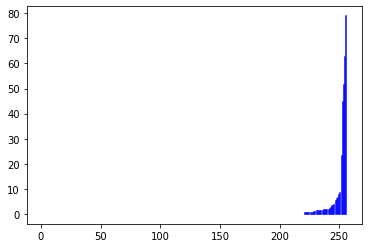

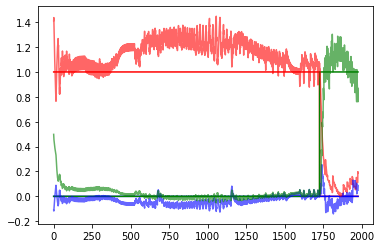

 85%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 2564/3000 [8:42:52<1:21:26, 11.21s/it]

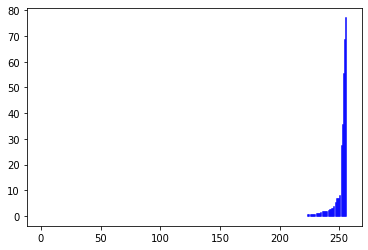

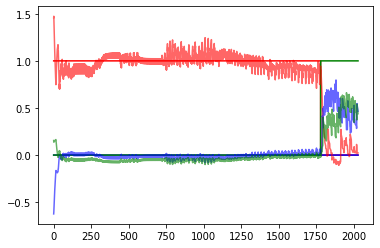

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 2569/3000 [8:43:50<1:20:42, 11.24s/it]

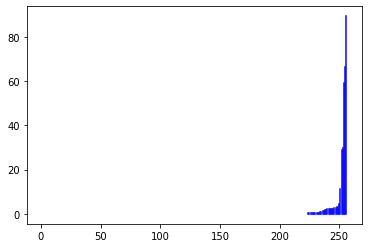

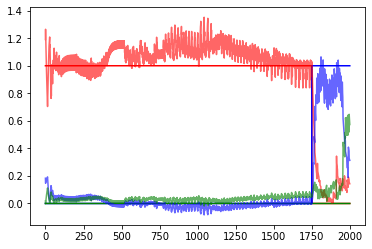

 86%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                      | 2574/3000 [8:44:47<1:16:42, 10.81s/it]

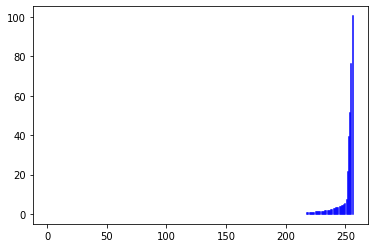

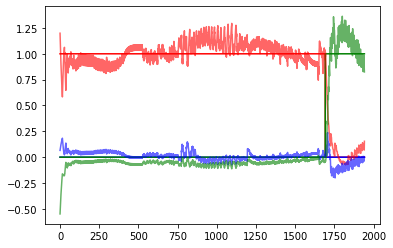

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                     | 2579/3000 [8:45:43<1:17:16, 11.01s/it]

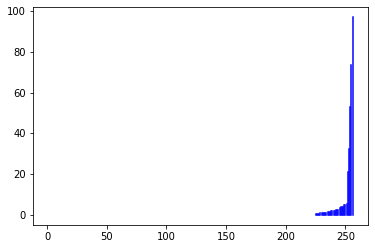

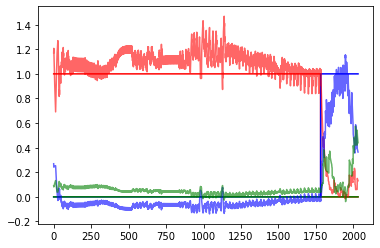

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                     | 2584/3000 [8:46:38<1:12:03, 10.39s/it]

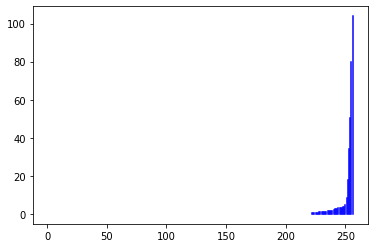

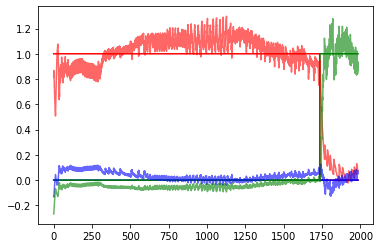

 86%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                     | 2589/3000 [8:47:33<1:12:26, 10.58s/it]

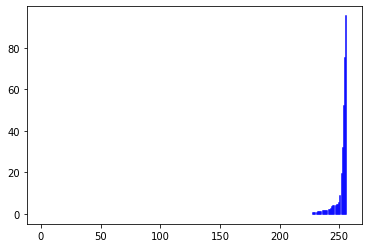

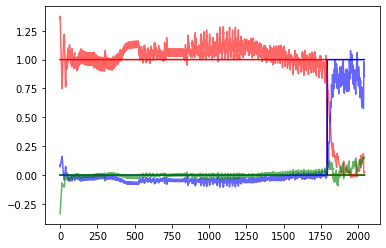

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                     | 2594/3000 [8:48:32<1:15:48, 11.20s/it]

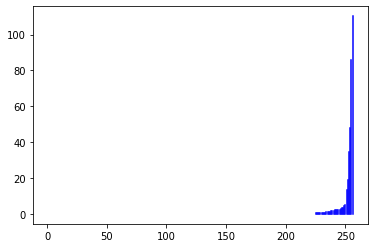

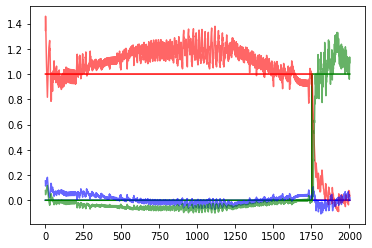

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 2599/3000 [8:49:27<1:10:57, 10.62s/it]

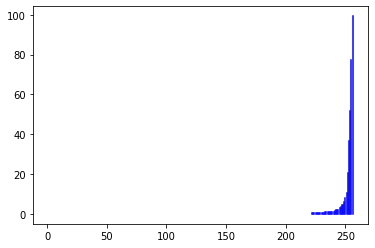

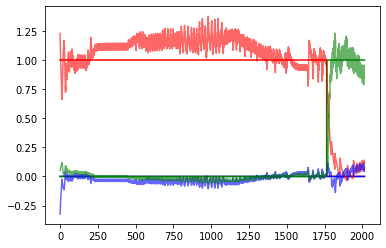

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 2604/3000 [8:51:13<1:35:36, 14.49s/it]

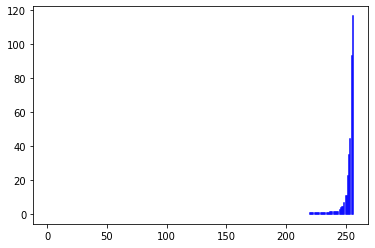

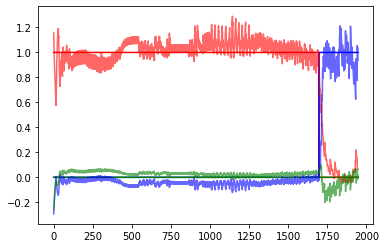

 87%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                    | 2609/3000 [8:52:08<1:14:04, 11.37s/it]

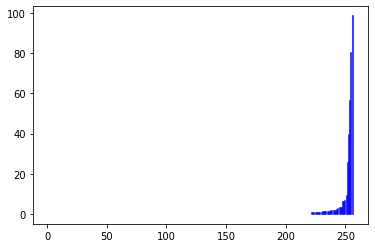

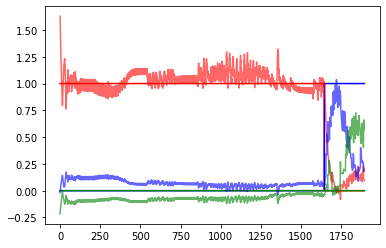

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                    | 2614/3000 [8:53:05<1:08:54, 10.71s/it]

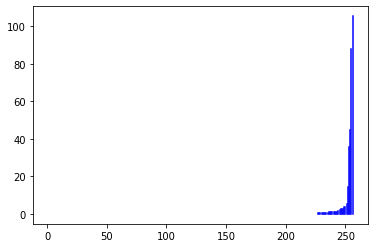

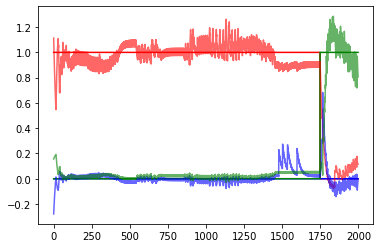

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                   | 2619/3000 [8:54:00<1:05:34, 10.33s/it]

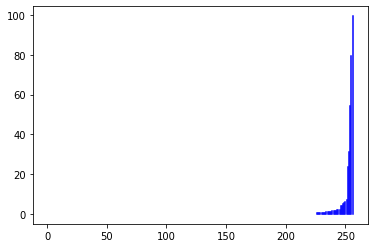

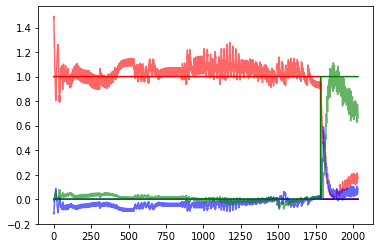

 87%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                   | 2624/3000 [8:54:56<1:06:46, 10.66s/it]

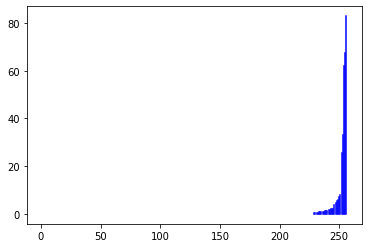

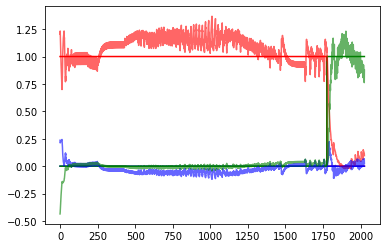

 88%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 2629/3000 [8:55:48<1:01:57, 10.02s/it]

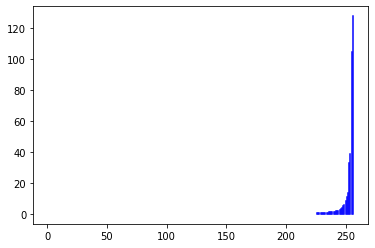

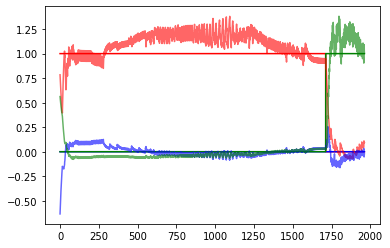

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 2634/3000 [8:56:43<1:04:29, 10.57s/it]

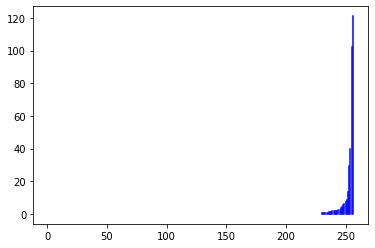

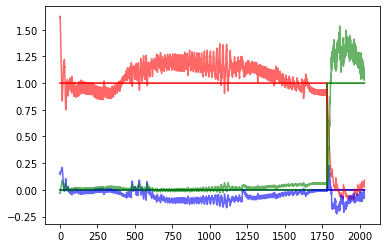

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 2639/3000 [8:57:40<1:06:28, 11.05s/it]

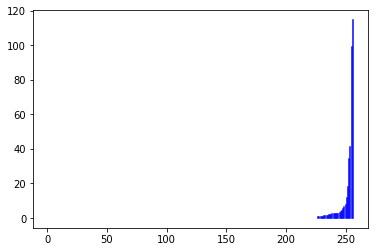

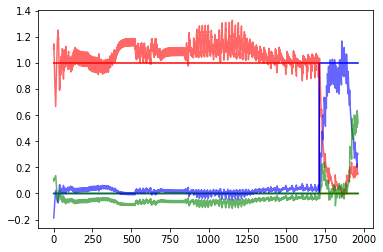

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                  | 2644/3000 [8:58:36<1:04:05, 10.80s/it]

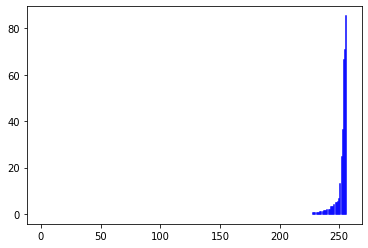

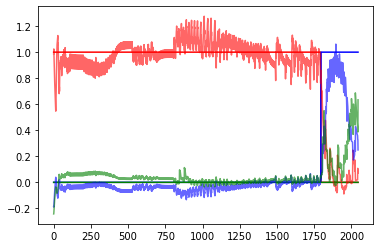

 88%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 2649/3000 [8:59:34<1:05:25, 11.18s/it]

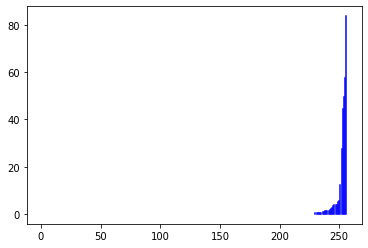

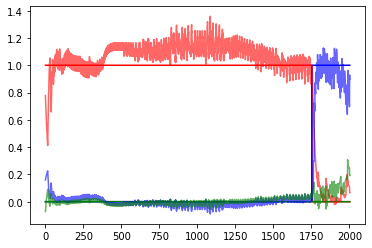

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 2654/3000 [9:01:20<1:24:33, 14.66s/it]

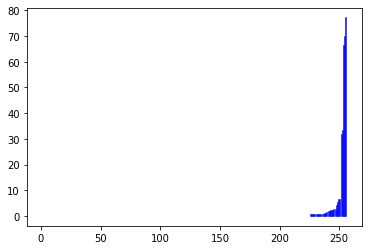

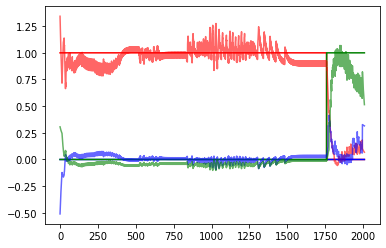

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2659/3000 [9:02:15<1:04:43, 11.39s/it]

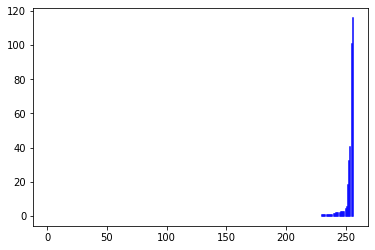

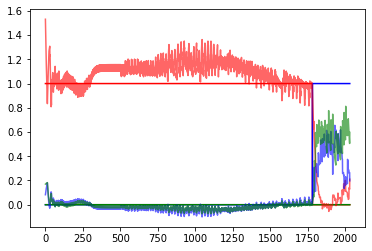

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                 | 2664/3000 [9:03:10<59:40, 10.66s/it]

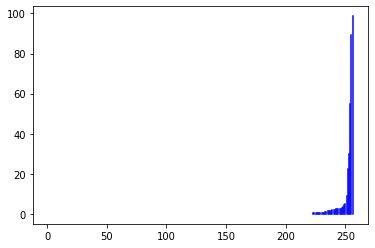

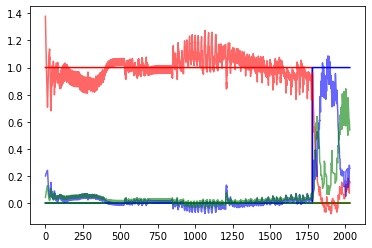

 89%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2669/3000 [9:04:07<1:00:15, 10.92s/it]

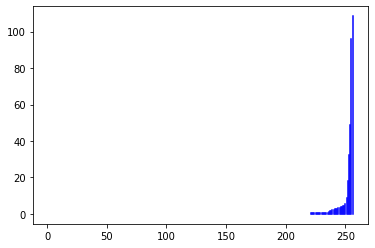

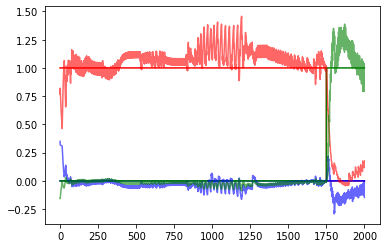

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 2674/3000 [9:05:03<56:41, 10.44s/it]

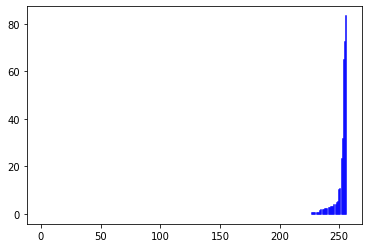

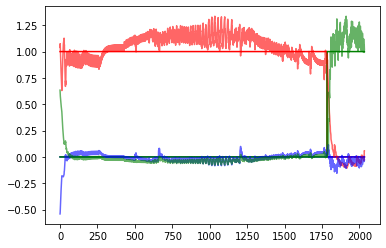

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 2679/3000 [9:06:02<57:54, 10.82s/it]

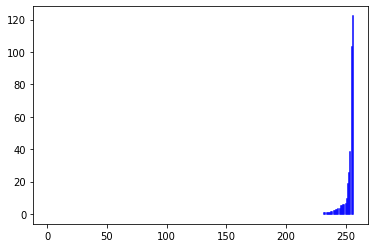

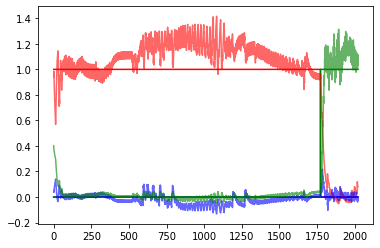

 89%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍                | 2684/3000 [9:06:59<57:49, 10.98s/it]

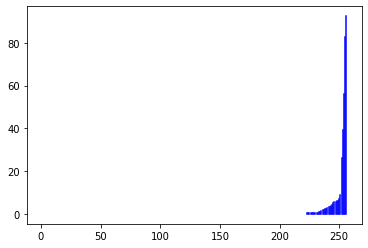

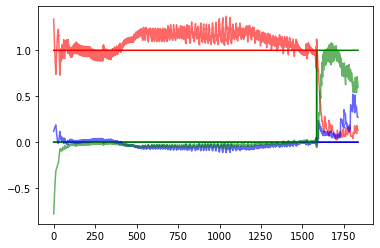

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋                | 2689/3000 [9:07:55<56:41, 10.94s/it]

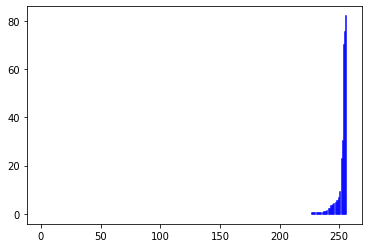

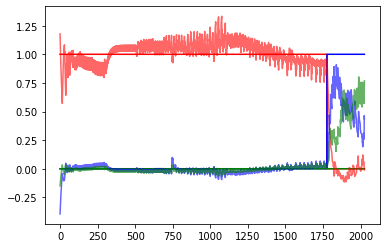

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 2694/3000 [9:08:51<55:23, 10.86s/it]

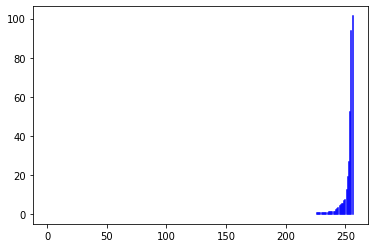

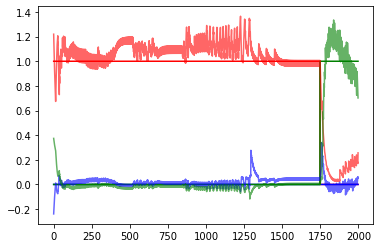

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 2699/3000 [9:09:49<56:04, 11.18s/it]

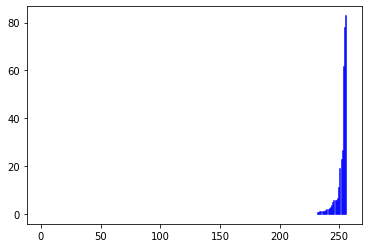

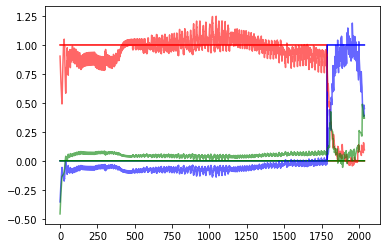

 90%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋               | 2704/3000 [9:11:32<1:09:54, 14.17s/it]

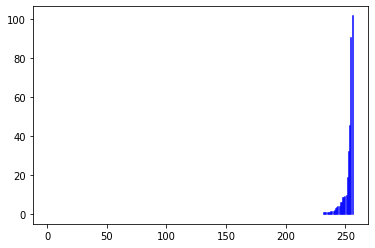

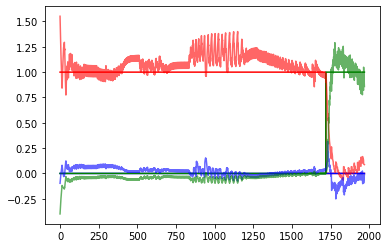

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 2709/3000 [9:12:29<54:38, 11.27s/it]

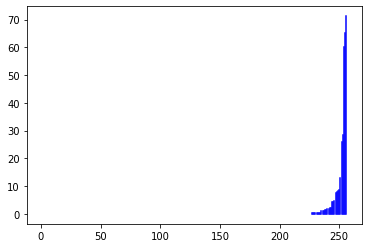

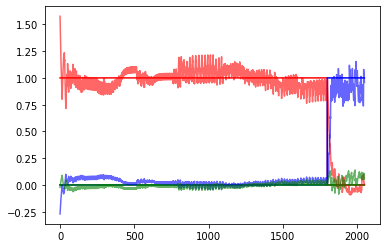

 90%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 2714/3000 [9:13:26<52:09, 10.94s/it]

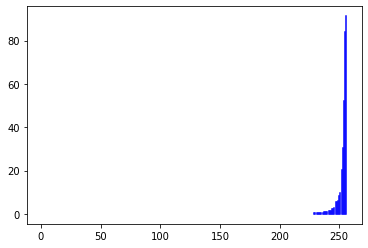

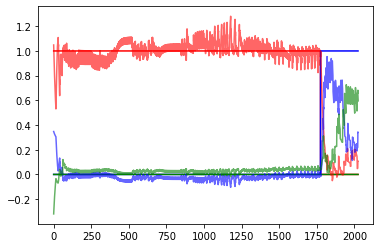

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 2719/3000 [9:14:22<50:09, 10.71s/it]

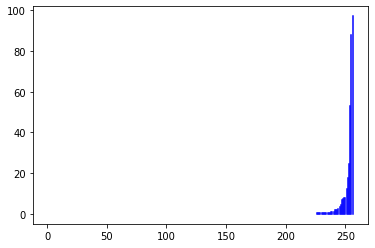

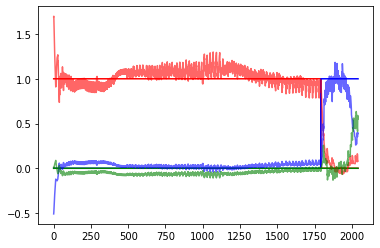

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 2724/3000 [9:15:17<49:49, 10.83s/it]

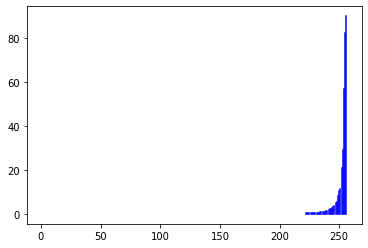

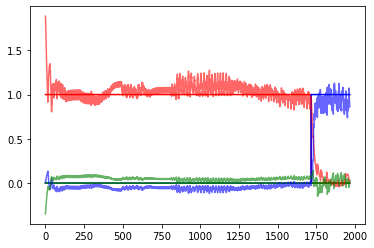

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 2729/3000 [9:16:14<49:05, 10.87s/it]

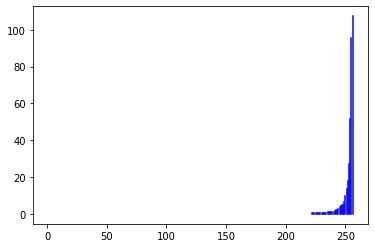

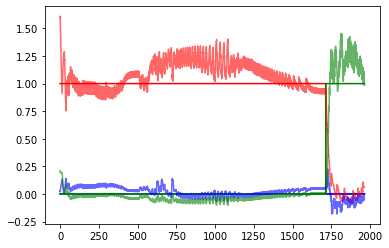

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████              | 2734/3000 [9:17:13<49:17, 11.12s/it]

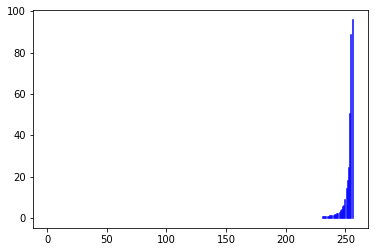

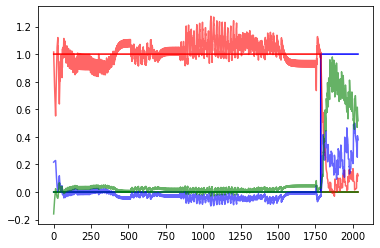

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎             | 2739/3000 [9:18:08<45:33, 10.47s/it]

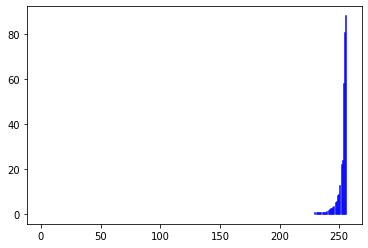

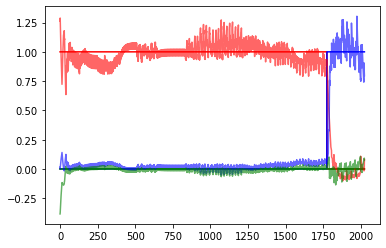

 91%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 2744/3000 [9:19:05<47:01, 11.02s/it]

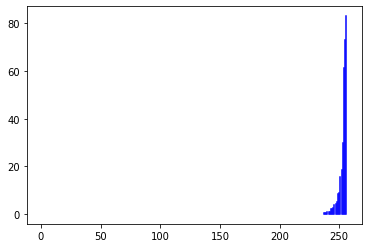

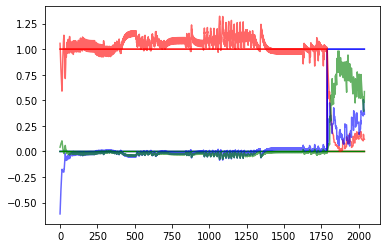

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 2749/3000 [9:19:57<42:39, 10.20s/it]

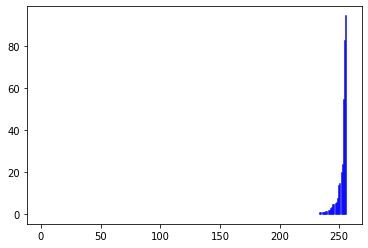

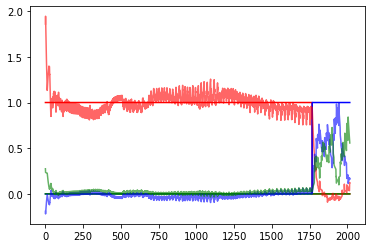

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 2754/3000 [9:21:41<57:41, 14.07s/it]

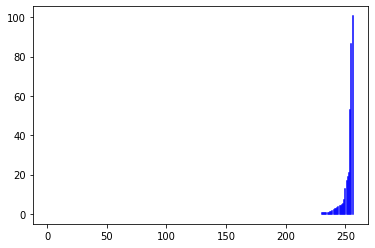

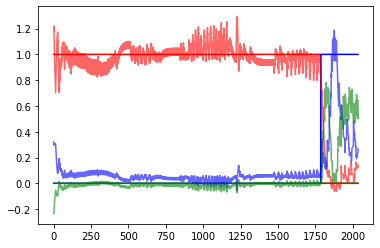

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 2759/3000 [9:22:39<46:56, 11.69s/it]

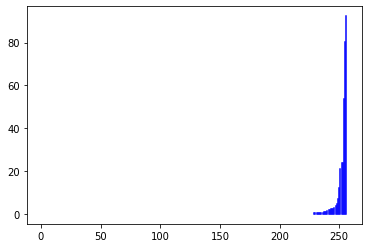

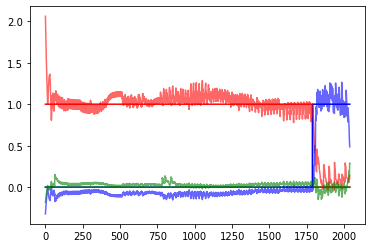

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 2764/3000 [9:23:36<43:58, 11.18s/it]

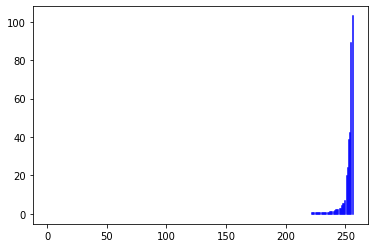

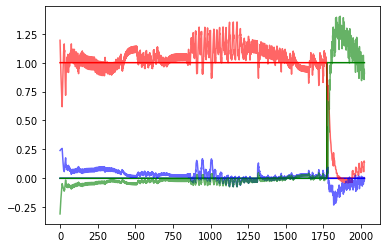

 92%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉            | 2769/3000 [9:24:34<42:06, 10.94s/it]

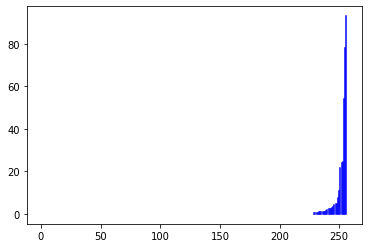

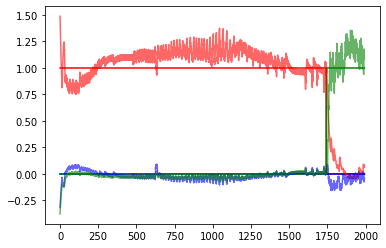

 92%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏           | 2774/3000 [9:25:32<41:42, 11.07s/it]

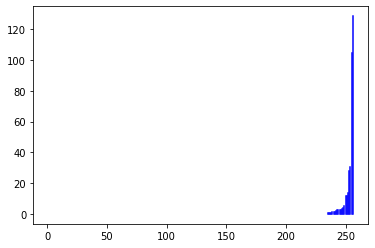

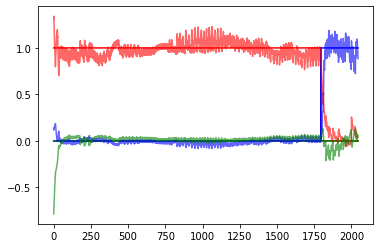

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 2779/3000 [9:26:27<38:14, 10.38s/it]

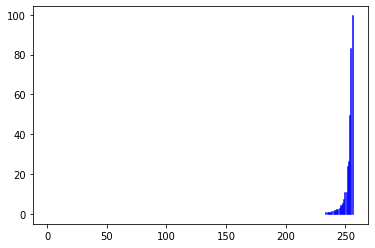

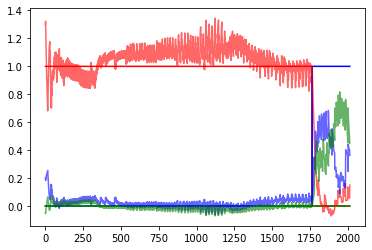

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 2784/3000 [9:27:18<36:31, 10.14s/it]

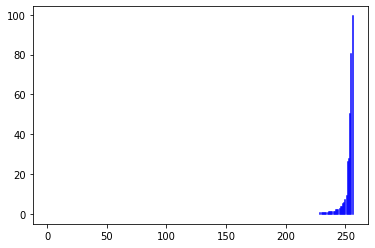

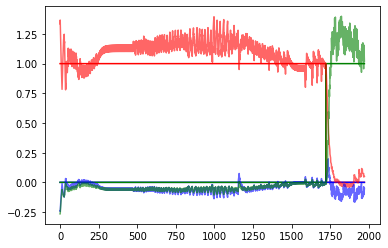

 93%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           | 2789/3000 [9:28:14<37:29, 10.66s/it]

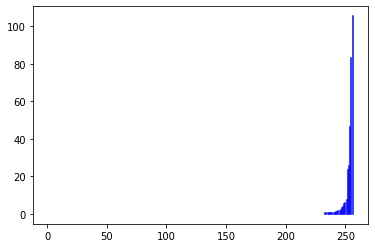

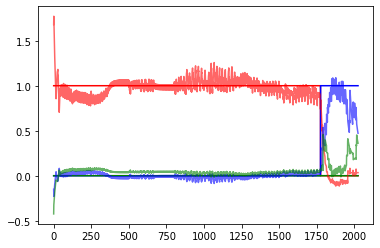

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 2794/3000 [9:29:07<34:22, 10.01s/it]

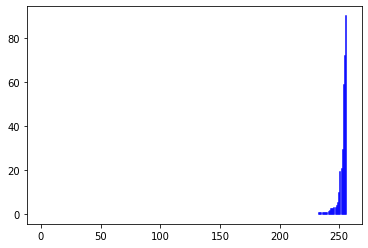

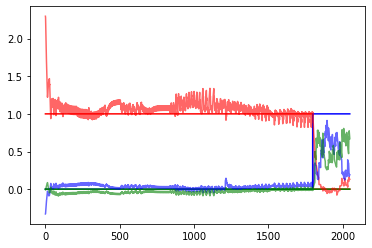

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 2799/3000 [9:30:02<34:19, 10.25s/it]

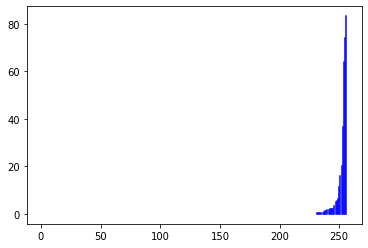

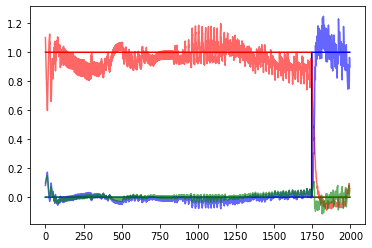

 93%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋          | 2804/3000 [9:31:48<47:54, 14.67s/it]

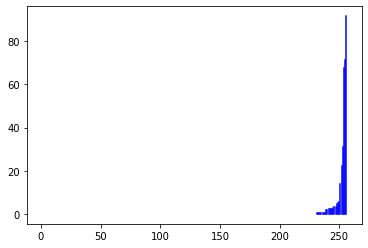

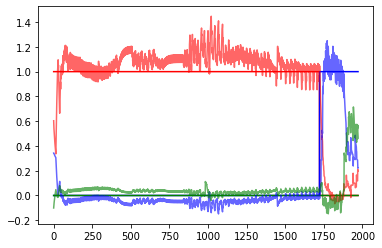

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 2809/3000 [9:32:42<34:50, 10.94s/it]

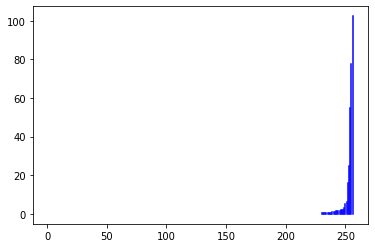

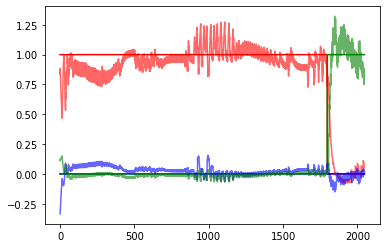

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎         | 2814/3000 [9:33:37<32:29, 10.48s/it]

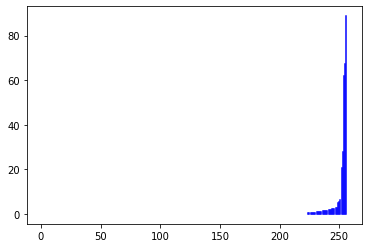

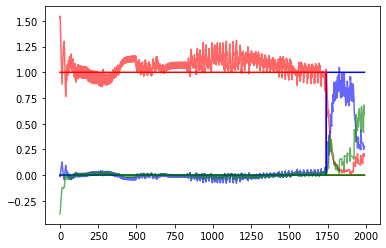

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         | 2819/3000 [9:34:33<31:54, 10.58s/it]

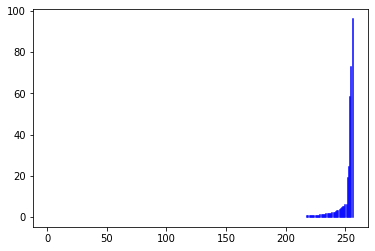

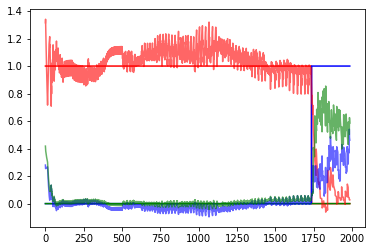

 94%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊         | 2824/3000 [9:35:29<31:26, 10.72s/it]

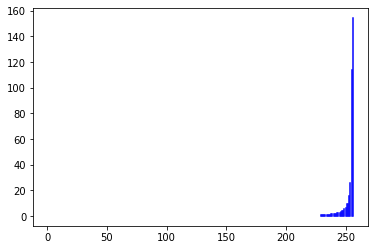

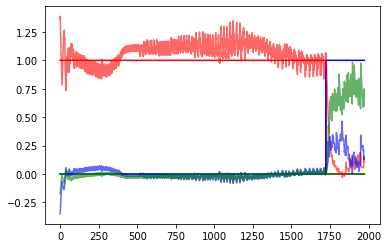

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 2829/3000 [9:36:29<32:29, 11.40s/it]

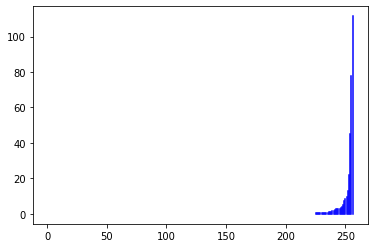

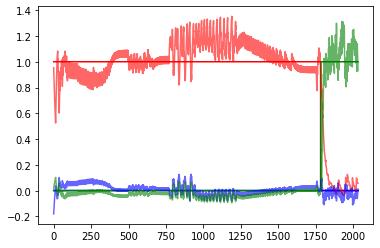

 94%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎        | 2834/3000 [9:37:26<30:49, 11.14s/it]

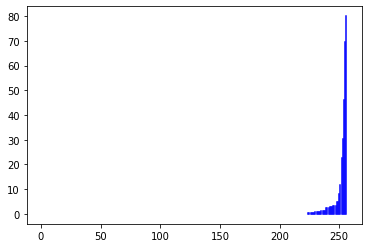

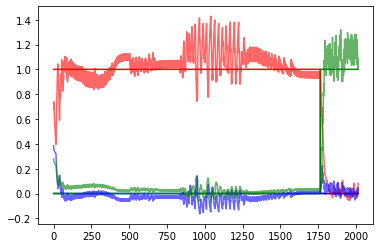

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        | 2839/3000 [9:38:23<29:22, 10.95s/it]

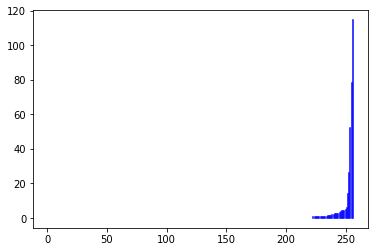

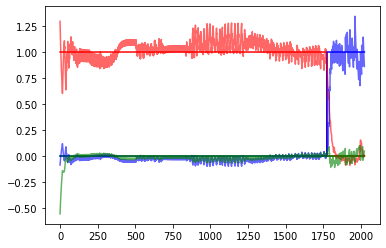

 95%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 2844/3000 [9:39:16<26:42, 10.27s/it]

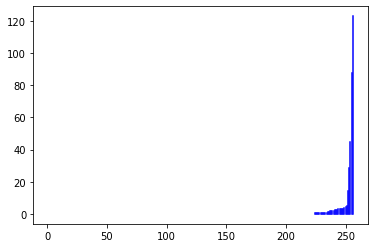

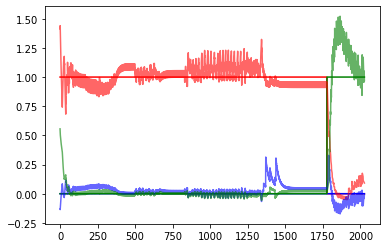

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 2849/3000 [9:40:15<28:06, 11.17s/it]

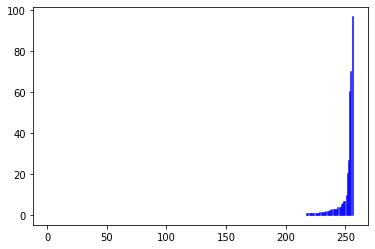

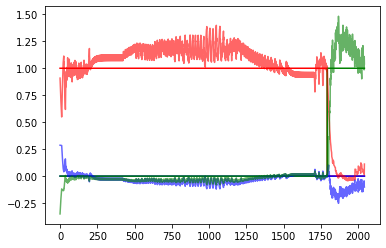

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 2854/3000 [9:42:00<35:10, 14.46s/it]

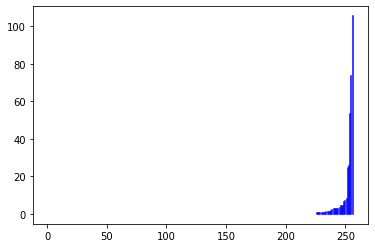

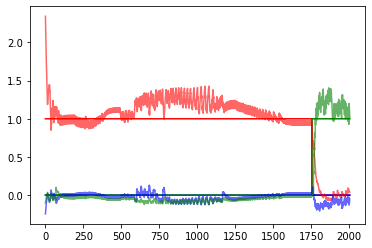

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌       | 2859/3000 [9:42:59<27:50, 11.85s/it]

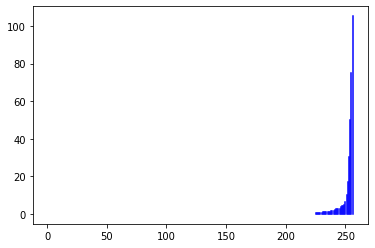

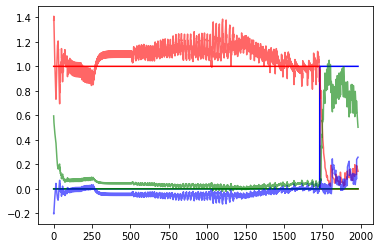

 95%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 2864/3000 [9:43:58<25:43, 11.35s/it]

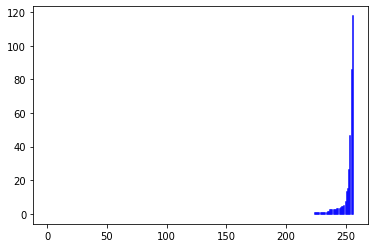

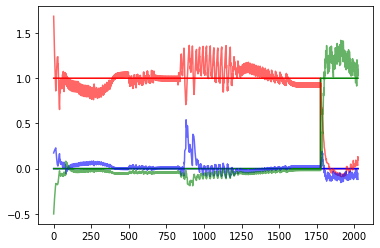

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏      | 2869/3000 [9:44:53<23:09, 10.61s/it]

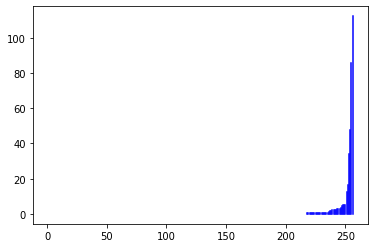

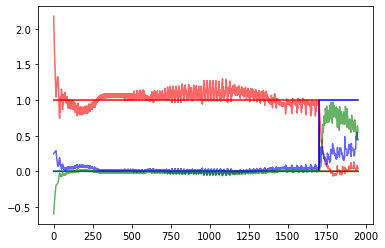

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      | 2874/3000 [9:45:46<21:34, 10.27s/it]

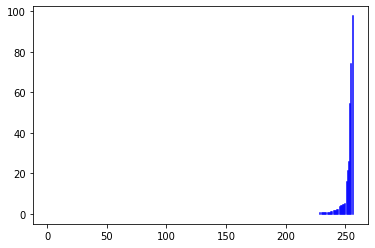

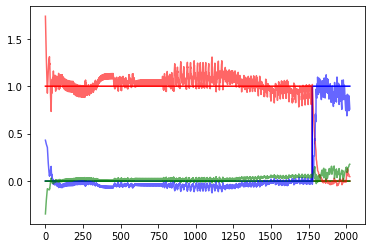

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 2879/3000 [9:46:43<22:18, 11.06s/it]

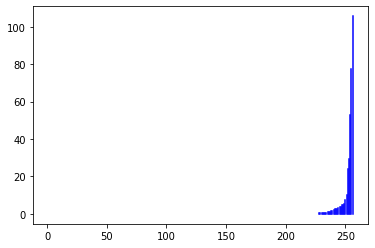

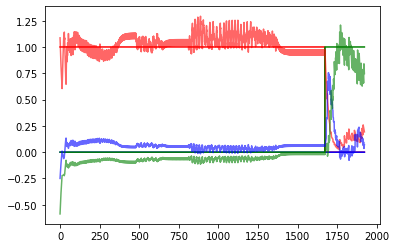

 96%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 2884/3000 [9:47:44<22:25, 11.60s/it]

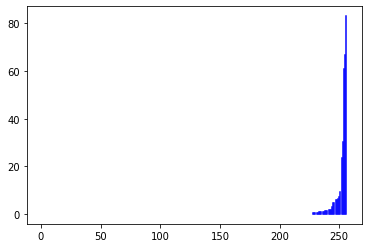

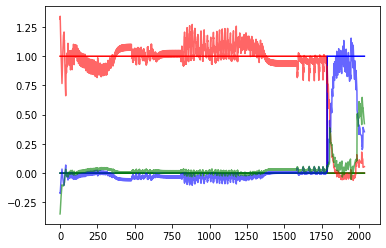

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     | 2889/3000 [9:48:43<21:09, 11.44s/it]

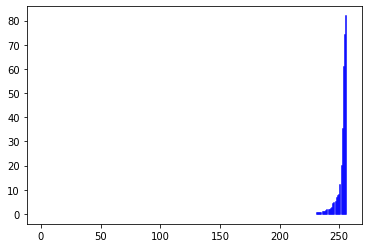

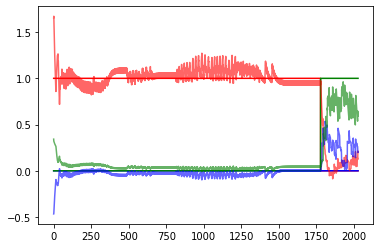

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     | 2894/3000 [9:49:42<20:02, 11.35s/it]

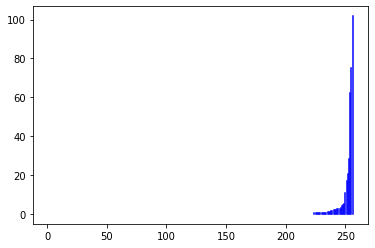

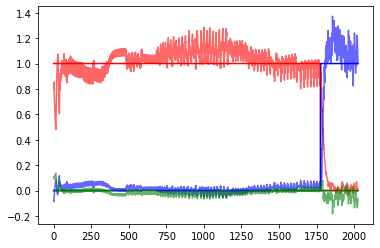

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 2899/3000 [9:50:40<18:36, 11.05s/it]

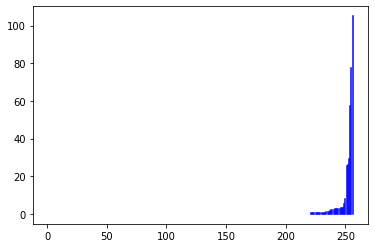

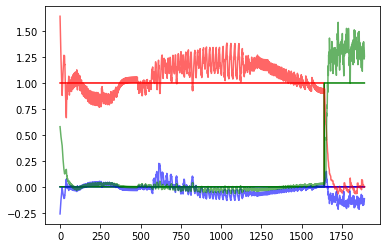

 97%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 2904/3000 [9:52:21<21:33, 13.47s/it]

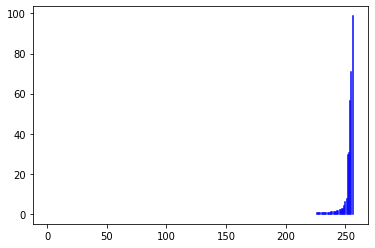

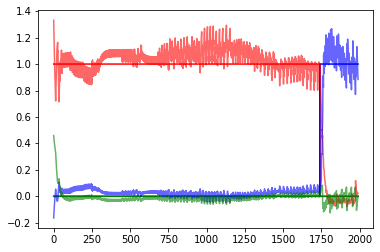

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 2909/3000 [9:53:18<16:59, 11.20s/it]

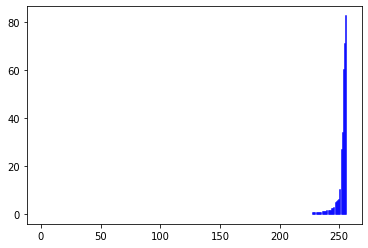

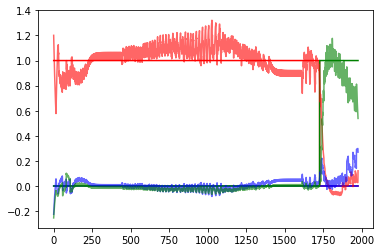

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    | 2914/3000 [9:54:16<15:57, 11.13s/it]

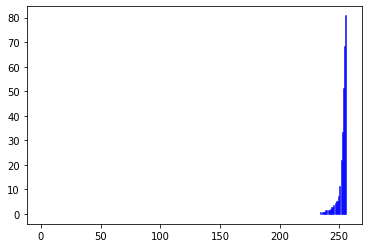

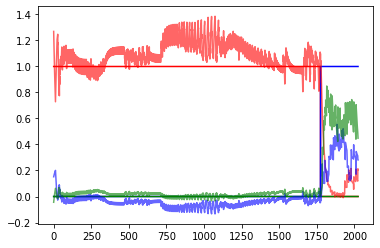

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 2919/3000 [9:55:14<14:56, 11.07s/it]

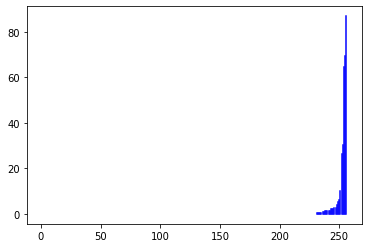

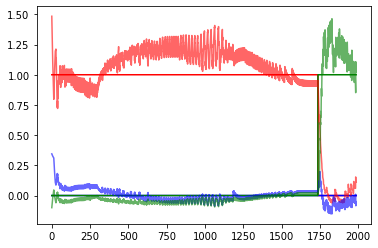

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    | 2924/3000 [9:56:05<12:26,  9.82s/it]

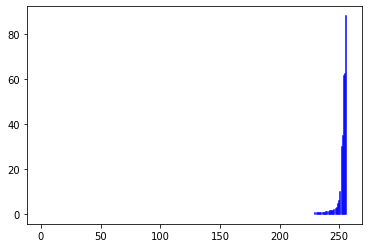

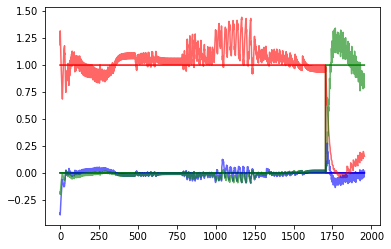

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎   | 2929/3000 [9:57:03<12:57, 10.96s/it]

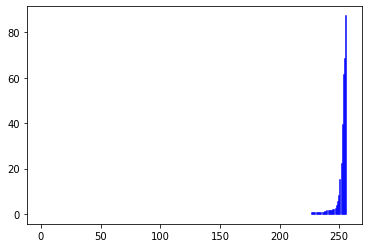

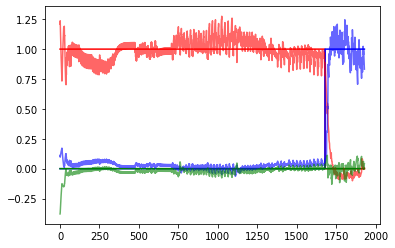

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 2934/3000 [9:57:56<11:30, 10.46s/it]

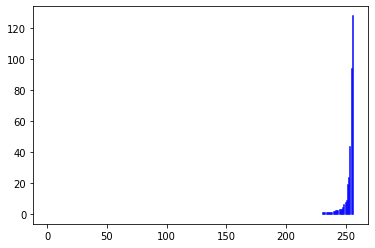

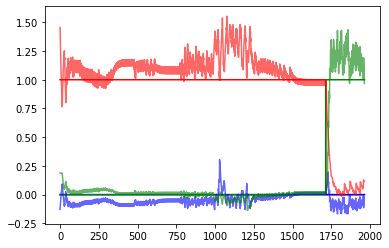

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 2939/3000 [9:58:55<11:10, 10.99s/it]

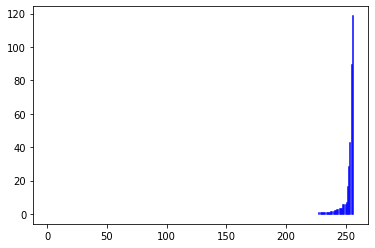

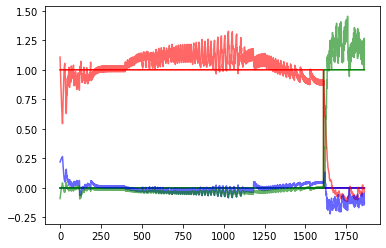

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 2944/3000 [9:59:53<10:33, 11.31s/it]

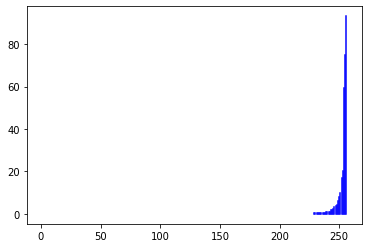

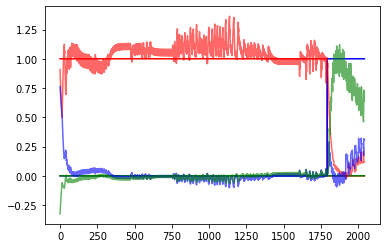

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎  | 2949/3000 [10:00:50<09:23, 11.05s/it]

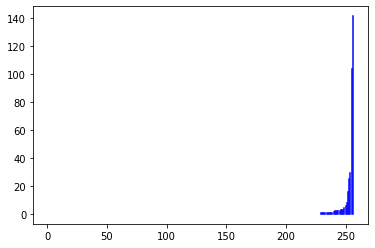

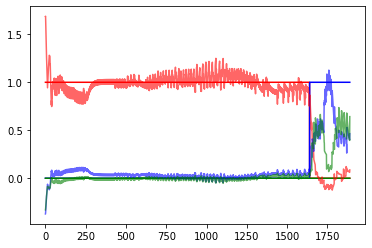

 98%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌  | 2954/3000 [10:02:38<11:15, 14.69s/it]

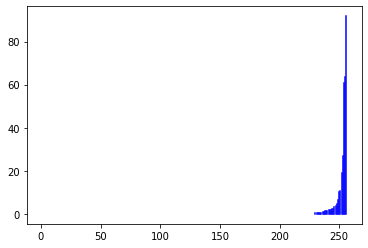

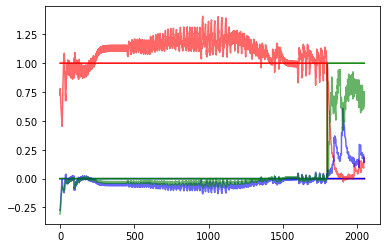

 99%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 2959/3000 [10:03:36<08:07, 11.88s/it]

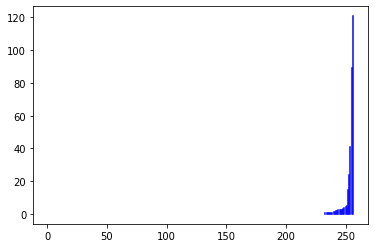

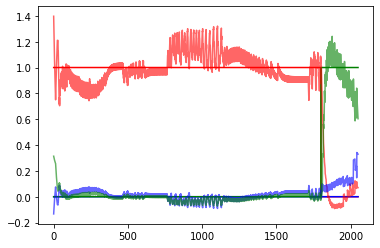

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏ | 2964/3000 [10:04:30<06:10, 10.28s/it]

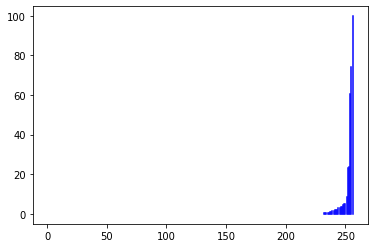

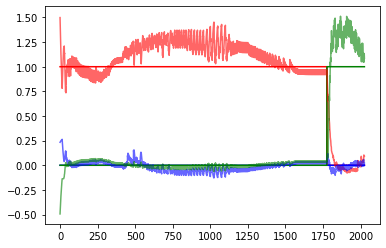

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 2969/3000 [10:05:27<05:42, 11.04s/it]

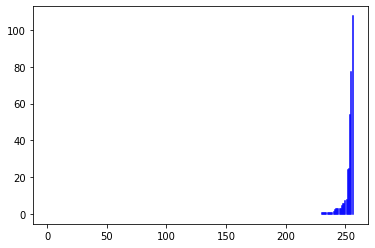

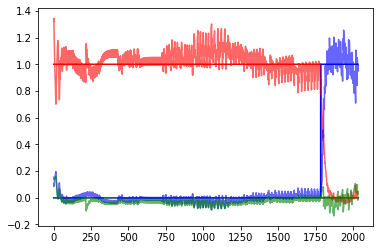

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 2974/3000 [10:06:22<04:38, 10.70s/it]

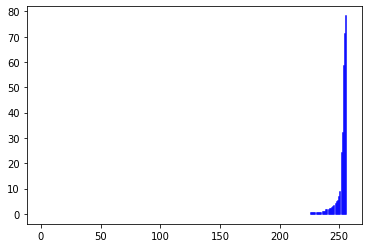

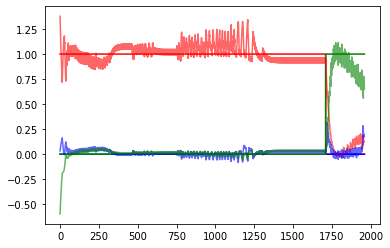

 99%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 2979/3000 [10:07:18<03:43, 10.63s/it]

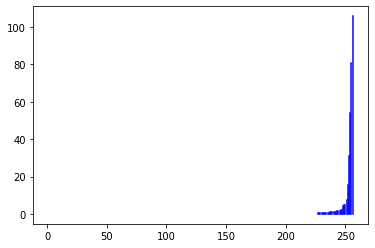

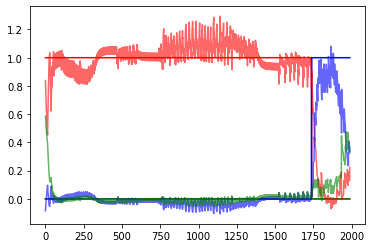

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏| 2984/3000 [10:08:11<02:44, 10.28s/it]

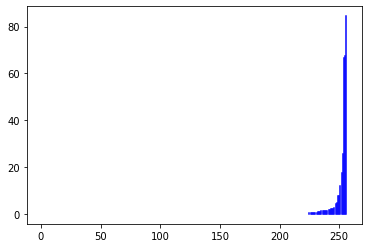

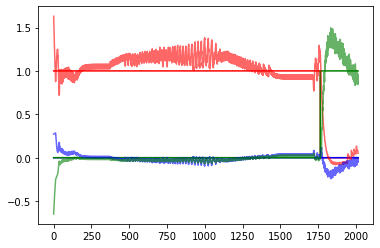

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍| 2989/3000 [10:09:08<02:00, 10.95s/it]

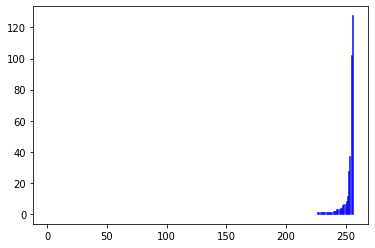

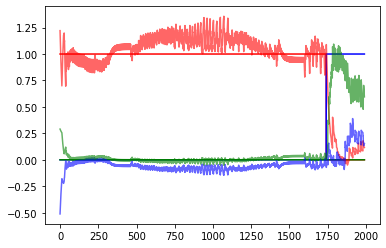

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋| 2994/3000 [10:10:06<01:06, 11.00s/it]

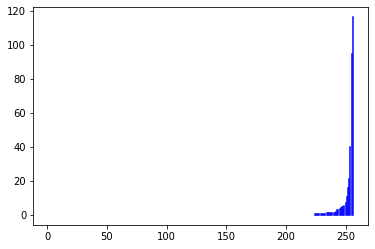

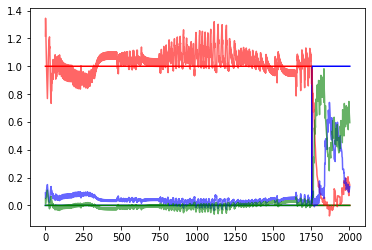

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 2999/3000 [10:11:03<00:10, 11.00s/it]

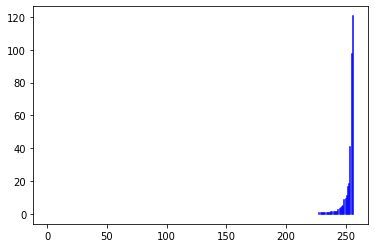

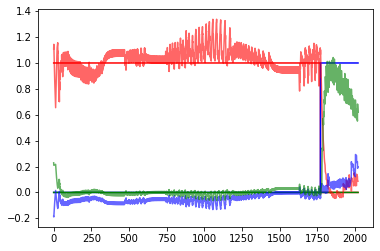

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3000/3000 [10:12:07<00:00, 12.24s/it]

Finished Training


In [14]:
from cgtasknet.instruments.instrument_accuracy_network import correct_answer

name = f"weights/weights_{neuron_parameters.alpha}_N_{hidden_size}_without_square"

running_loss = 0
sigma = 0

for i in tqdm(range(number_of_epochs)):
    if i == 500:
        sigma = 0.2
    if i == 1000:
        sigma = 0.5
    inputs, target_outputs = Task.dataset(number_of_tasks)

    inputs[:, :, 1:3] += every_bath_generator(
        0, sigma, inputs.shape[0], inputs.shape[1], 2
    )
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    loss_mask = torch.zeros_like(target_outputs)
    mask_indexes_signes = torch.where(target_outputs[:, :, 0] == 1)
    mask_indexes_zeros = torch.where(target_outputs[:, :, 0] == 0)
    loss_mask[mask_indexes_signes[0], mask_indexes_signes[1], :] = .1
    loss_mask[mask_indexes_zeros[0], mask_indexes_zeros[1], :] = 1
    optimizer.zero_grad()
    init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
    # forward + backward + optimize
    outputs, _, state = model(
        inputs,
        init_state,
    )

    loss = criterion(outputs, target_outputs, loss_mask, state)
    loss.backward()
    optimizer.step()

    # print statistics
    running_loss = loss.item()
    if i % 50 == 49:
        with open("log_multy.txt", "a") as f:
            f.write("epoch: {:d} loss: {:0.5f}\n".format(i + 1, running_loss / 10))
        running_loss = 0.0
        with torch.no_grad():
            torch.save(
                model.state_dict(),
                name + f'_{i}_',
            )
    if i % 50== 49:

        result = 0
        for j in range(10):
            try:
                del inputs
            except:
                pass
            try:
                del target_outputs
            except:
                pass
            try:
                del outputs
            except:
                pass
            torch.cuda.empty_cache()
            inputs, target_outputs = Task.dataset(1, delay_between=0)
            inputs[:, :, 1:3] += every_bath_generator(
                0, 0.01, inputs.shape[0], inputs.shape[1], 2
            )
            inputs = torch.from_numpy(inputs).type(torch.float).to(device)
            target_outputs = (
                torch.from_numpy(target_outputs).type(torch.float).to(device)
            )
            outputs = model(
                inputs,
                init_state,
            )[0]
            type_tasks = list(
                np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1]
            )
            answers = can.run(
                target_outputs[50:, :, 0].cpu(),
                outputs[50:, :, 0].cpu(),
                target_outputs[50:, :, 1:].cpu(),
                outputs[50:, :, 1:].cpu(),
                type_tasks,
            )
            result += answers

        accuracy = result / batch_size / 10 * 100
        with open("accuracy_multy.txt", "a") as f:
            f.write(f"ecpoch = {i}; correct/all = {accuracy}\n")
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
        del states
    except:
        pass
    
    if i % 5 == 4:
        check_mean_fr()
    torch.cuda.empty_cache()
    
print("Finished Training")

In [15]:
model.save_states = True
sorted_tasks = sorted(tasks)
re_word = "Go"
choices_tasks = []
values_tasks = []
for i in range(len(sorted_tasks)):
    if re_word in sorted_tasks[i]:
        values_tasks.append(i)
    else:
        choices_tasks.append(i)
can = CorrectAnswerNetwork(choices_tasks, values_tasks, 0.15)
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs[:, :, 1:3] += every_bath_generator(0, 0.01, inputs.shape[0], inputs.shape[1], 2)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
outputs, states = model(
    inputs,
    init_state,
    additional_current=additional_current_generate(
        len(inputs),
        batch_size,
        hidden_size,
    ).to(device),
)
type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
answers = can.run(
    target_outputs[:, :, 0].cpu(),
    outputs[:, :, 0].cpu(),
    target_outputs[:, :, 1:].cpu(),
    outputs[:, :, 1:].cpu(),
    type_tasks,
)
result += answers

NameError: name 'additional_current_generate' is not defined

In [ ]:
inputs, target_outputs = Task.dataset(1, delay_between=0)
inputs = torch.from_numpy(inputs).type(torch.float).to(device)# * 0
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
outputs, states, _ = model(
    inputs,
    init_state,
        
    )
task_number = sorted_tasks.index('RomoTask1')

outputs = outputs.cpu().detach()
target_outputs = target_outputs.detach().cpu()
s = []
for i in range(len(states)):
    s.append(states[i].z)
s = torch.stack(s).detach().cpu()

plt.plot(target_outputs[:, task_number, 0].cpu())
plt.plot(outputs[:, task_number, 0].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 1].cpu())
plt.plot(outputs[:, task_number, 1].detach().cpu())
plt.show()
plt.close()
plt.plot(target_outputs[:, task_number, 2].cpu())
plt.plot(outputs[:, task_number, 2].detach().cpu())
plt.show()
plt.close()
plt.figure(figsize=(20, 10))
plt.imshow(s[:, task_number, :].T, aspect="auto", interpolation="nearest")

In [ ]:
for_sort = torch.sort(torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).indices
s_new = torch.zeros_like(s)
for i in range(hidden_size):
    s_new[:, :, i] = s[:, :, for_sort[i]]
plt.imshow(s_new[:, task_number, :].T, aspect="auto", interpolation="nearest", origin='lower',)

In [ ]:
# spike_sequence = torch.stack(spike_sequence)
freq_sequence = torch.mean(torch.mean(spike_sequence, axis=0), axis=0)

# freq_sequence = sort_elemnts_by_another (freq_sequence, freq_sequence)
print(f"{spike_sequence.shape=}")
print(f"{freq_sequence.shape=}")
for i in range(len(freq_sequence)):
    plt.plot([i + 1] * 2, [0, freq_sequence[i]], c="b")
plt.show()
plt.close()
model.save_states = False

In [ ]:
from cgtasknet.instruments.instrument_subgroups import sort_elemnts_by_another

frequency = torch.mean(torch.mean(s, axis=0), axis=0) * 1e3
frequency = sort_elemnts_by_another(freq_sequence, frequency)
for i in range(len(frequency)):
    plt.plot([i + 1] * 2, [0, frequency[i]], c="b")

In [ ]:
result

In [ ]:
list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])

# Тестовая функция

In [ ]:
def test_network(
        test_sigma: float, number_of_trials: int = 100, plot_data: bool = True
):
    result = 0
    for j in tqdm(range(number_of_trials)):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, :3] += every_bath_generator(
            0, test_sigma, inputs.shape[0], inputs.shape[1], 3
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        answers = correct_answer(
            outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
        )
        result += torch.sum(answers).item()

    accuracy = result / batch_size / number_of_trials * 100
    if plot_data:
        plot_results(inputs, target_outputs, outputs)
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    return accuracy

# Тестирование
```  np.random.normal(0, 0.01, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.01, 1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.05, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.05, 10)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.1, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.1)
print(accuracy)

# Тестирование
```  np.random.normal(0, 0.5, size=(inputs.shape)) ```

In [ ]:
accuracy = test_network(0.5)
print(accuracy)

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.5, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
result = 0
for j in tqdm(range(1)):
    try:
        del inputs
    except:
        pass
    try:
        del target_outputs
    except:
        pass
    try:
        del outputs
    except:
        pass
    torch.cuda.empty_cache()
    inputs, target_outputs = Task.dataset(1, delay_between=0)
    inputs[:, :, :3] += np.random.normal(0, 0.7, size=inputs[:, :, :3].shape)
    inputs = torch.from_numpy(inputs).type(torch.float).to(device)
    target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
    outputs = model(inputs)[0]
    answers = correct_answer(
        outputs[:, :, 1:], target_outputs[:, :, 1:], target_outputs[:, :, 0]
    )
    result += torch.sum(answers).item()

accuracy = result / batch_size / 100 * 100
print(accuracy)
plot_results(inputs, target_outputs, outputs)
try:
    del inputs
except:
    pass
try:
    del target_outputs
except:
    pass
try:
    del outputs
except:
    pass
torch.cuda.empty_cache()

In [ ]:
inputs = 0
outputs = 0

In [ ]:
lines = []
with open("accuracy_multy.txt", "r") as f:
    while line := f.readline():
        lines.append(float(line.split("=")[2]))

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 5))
plt.plot([*range(9, 3000, 50)], lines, ".", linestyle="--", markersize=5)
plt.ylabel(r"Accuracy%")
plt.xlabel(r"Epochs")

In [ ]:
start_sigma = 0
stop_sigma = 2
step_sigma = 0.05
sigma_array = np.arange(start_sigma, stop_sigma, step_sigma)
for test_sigma in tqdm(sigma_array):
    result = 0
    for j in range(20):
        try:
            del inputs
        except:
            pass
        try:
            del target_outputs
        except:
            pass
        try:
            del outputs
        except:
            pass
        torch.cuda.empty_cache()
        inputs, target_outputs = Task.dataset(1, delay_between=0)
        inputs[:, :, 1:3] += np.random.normal(
            0, test_sigma, size=inputs[:, :, 1:3].shape
        )
        inputs = torch.from_numpy(inputs).type(torch.float).to(device)
        target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
        outputs = model(inputs)[0]
        type_tasks = list(np.where(inputs[-1, :, 3:].detach().cpu().numpy() == 1)[1])
        answers = can.run(
            target_outputs[50:, :, 0].cpu(),
            outputs[50:, :, 0].cpu(),
            target_outputs[50:, :, 1:].cpu(),
            outputs[50:, :, 1:].cpu(),
            type_tasks,
        )
        result += answers
    accuracy = result / batch_size / 20 * 100
    with open("accuracy_vs_noise.txt", "a") as f:
        f.write(f"noise={test_sigma}:accuracy={accuracy}\n")

In [ ]:
import matplotlib.patches as patches

plt.style.use("ggplot")


def parser(line_text: str) -> tuple:
    """
    Function parses text in form:
    ```v_name_1=v1:v_name_2:v2```
    and return (v1, v2)
    :param line_text:
    :return: (v1, v2)
    """
    line_text = line_text.split(":")
    print(line_text)
    v1 = line_text[0].split("=")[1]
    v2 = line_text[1].split("=")[1]
    return float(v1), float(v2)


x, y = [], []
# with open('accuracy_vs_noise.txt', 'r') as f:
with open(
        r"accuracy_vs_noise.txt",
        "r",
) as f:
    while line := f.readline():
        t_x, t_y = parser(line)
        x.append(t_x)
        y.append(t_y)

fig, ax = plt.subplots()
ax.plot(x, y, ".", linestyle="--")
# ax.plot([.5]*2, [50, 100])
ax.set_ylabel("Accuracy,%")
ax.set_xlabel(r"$\sigma$")
ax.add_patch(
    patches.Rectangle(
        (0, 50), 0.5, 50, edgecolor="grey", facecolor="grey", alpha=0.5, fill=True
    )
)

plt.show()
plt.close()

In [ ]:
batch_size = 1
number_of_tasks = 1
romo_parameters = RomoTaskRandomModParameters(
    romo=RomoTaskParameters(
        delay=0.6,
        positive_shift_delay_time=0.0,
        trial_time=0.1,
        positive_shift_trial_time=0.2,
    ),
)
dm_parameters = DMTaskRandomModParameters(
    dm=DMTaskParameters(trial_time=0.6, positive_shift_trial_time=0.0)
)
ctx_parameters = CtxDMTaskParameters(dm=dm_parameters.dm)
go_parameters = GoTaskRandomModParameters(
    go=GoTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
gort_parameters = GoRtTaskRandomModParameters(
    go=GoRtTaskParameters(
        trial_time=0.1,
        positive_shift_trial_time=0.8,
    )
)
godl_parameters = GoDlTaskRandomModParameters(
    go_dl=GoDlTaskParameters(
        go=GoTaskParameters(trial_time=0.1, positive_shift_trial_time=0.2),
        delay=0.1,
        positive_shift_delay_time=1.4,
    )
)
sigma = 0.5
tasks = [
    "RomoTask1",
    "RomoTask2",
    "DMTask1",
    "DMTask2",
    "CtxDMTask1",
    "CtxDMTask2",
    "GoTask1",
    "GoTask2",
    "GoRtTask1",
    "GoRtTask2",
    "GoDlTask1",
    "GoDlTask2",
]
task_dict = {
    tasks[0]: romo_parameters,
    tasks[1]: romo_parameters,
    tasks[2]: dm_parameters,
    tasks[3]: dm_parameters,
    tasks[4]: ctx_parameters,
    tasks[5]: ctx_parameters,
    tasks[6]: go_parameters,
    tasks[7]: go_parameters,
    tasks[8]: gort_parameters,
    tasks[9]: gort_parameters,
    tasks[10]: godl_parameters,
    tasks[11]: godl_parameters,
}

tasks_sequence = [
    MultyReduceTasks(
        tasks=task_dict,
        batch_size=batch_size,
        delay_between=0,
        enable_fixation_delay=True,
        task_number=i,
    )
    for i in range(len(tasks))
]

In [ ]:
tasks_and_names = dict([*zip(sorted(tasks), tasks_sequence)])
chosed_tasks = ["CtxDMTask1", "GoTask1", "GoRtTask1", "GoDlTask1", "RomoTask1"]
chosed_tasks_dict = {}
for key, item in tasks_and_names.items():
    if key in chosed_tasks:
        chosed_tasks_dict[key] = item
print("Tasks for PCA")
print(chosed_tasks_dict)

In [ ]:
import matplotlib.pyplot as plt
from cgtasknet.instruments.instrument_accuracy_network import correct_answer
from cgtasknet.net.states import LIFAdExInitState

name = f"Train_dm_and_romo_task_reduce_lif_adex_without_refrac_random_delay_long_a_alpha_{neuron_parameters.alpha}_N_{hidden_size}"
init_state = LIFAdExInitState(batch_size, hidden_size, device=device)
data, t_outputs = tasks_and_names["DMTask1"].dataset(2, delay_between=0)
data[:, :, 1:3] += every_bath_generator(0, sigma, data.shape[0], data.shape[1], 2)
data = torch.from_numpy(data).type(torch.float).to(device)
out, states = model(data, init_state.random_state())
out = out.detach().cpu().numpy()
plt.figure()
plt.plot(t_outputs[:, 0, 0])
plt.plot(t_outputs[:, 0, 1])
plt.plot(t_outputs[:, 0, 2])

plt.figure()
plt.plot(out[:, 0, 0])
plt.plot(out[:, 0, 1])
plt.plot(out[:, 0, 2])

In [ ]:

for name, param in model.named_parameters():
    if name == 'alif.recurrent_weights':
        final_parameters = torch.clone(param.detach().cpu())


In [ ]:
eigs_final = torch.eig(final_parameters)[0]
eigs_initial = torch.eig(initial_parameters)[0]

In [ ]:
x_final = eigs_final[:, 0]
y_final = eigs_final[:, 1]

x_initial = eigs_initial[:, 0]
y_initial = eigs_initial[:, 1]

In [ ]:
plt.scatter(x_initial, y_initial)
plt.scatter(x_final, y_final)

In [ ]:
model.save_states = True
Task_test = MultyReduceTasks(
    tasks=task_dict,
    batch_size=batch_size,
    delay_between=0,
    enable_fixation_delay=True,
    mode="random",
    task_number=0
)

In [ ]:
model.save_states = True
init_state = LIFAdExState(
        torch.zeros(batch_size, hidden_size).to(device),
        torch.rand(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
        torch.zeros(batch_size, hidden_size).to(device),
    )
inputs, target_outputs = Task.dataset(1)

inputs = torch.from_numpy(inputs).type(torch.float).to(device)
target_outputs = torch.from_numpy(target_outputs).type(torch.float).to(device)
result = model(inputs, init_state,)
#del inputs, init_state
torch.cuda.empty_cache()
states = result[-1]
spikes = []
for state in states:
    spikes.append(state.detach().cpu())
    
last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
s = torch.stack(spikes)[:last_fix, ...]
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")
plt.show()
index=10

plt.plot(target_outputs[:, index, 0].detach().cpu(), c='r')
plt.plot(target_outputs[:, index, 1].detach().cpu(), c='b')
plt.plot(target_outputs[:, index, 2].detach().cpu(), c='g')

plt.plot(result[0][:, index, 0].detach().cpu(), c='r', alpha=.6
        )
plt.plot(result[0][:, index, 1].detach().cpu(), c='b', alpha=.6
        )
plt.plot(result[0][:, index, 2].detach().cpu(), c='g', alpha=.6
        )


plt.plot(inputs[:, index, 0].detach().cpu() + 1.5)

plt.plot(inputs[:, index, 1].detach().cpu() + 1.5)
plt.plot(inputs[:, index, 2].detach().cpu() + 1.5)
plt.yticks([])

In [ ]:
last_fix = torch.where(inputs[:, :, 0] == 1)[0][-1].item()
s = torch.stack(spikes)[last_fix:, ...]
freq_sequence_new = torch.sort(
    torch.mean(torch.mean(s, axis=0), axis=0), dim=0
).values
for i in range(len(freq_sequence_new)):
    plt.plot([i + 1] * 2, [0, freq_sequence_new[i] * 1e3], c="b")

In [ ]:
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)

In [ ]:
torch.mean(final_parameters, axis=1).shape

In [ ]:
torch.sort(torch.mean(final_parameters, axis=1))

In [ ]:
torch.mean(torch.zeros((10, 20)), axis=1).shape

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)
plt.plot(torch.sort(torch.mean(final_parameters, axis=1)).values)

In [ ]:
plt.plot(torch.sort(torch.mean(initial_parameters, axis=1)).values)